<a href="https://colab.research.google.com/github/mehrotrasan16/time-series-anomaly-detection-methods/blob/comparison_checkin/STL_Decomposition_for_Time_Series_Anomalous_Record_Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Imports" data-toc-modified-id="Imports-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Imports</a></span></li><li><span><a href="#Loading-and-Reading-the-data-files" data-toc-modified-id="Loading-and-Reading-the-data-files-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Loading and Reading the data files</a></span><ul class="toc-item"><li><span><a href="#Additive-STL-Decomposition-using-Seasonal_Decompose" data-toc-modified-id="Additive-STL-Decomposition-using-Seasonal_Decompose-2.1"><span class="toc-item-num">2.1&nbsp;&nbsp;</span>Additive STL Decomposition using Seasonal_Decompose</a></span></li></ul></li><li><span><a href="#For-other-time-series" data-toc-modified-id="For-other-time-series-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>For other time series</a></span><ul class="toc-item"><li><span><a href="#A2-folder---Synthetic-Time-series-data-with-inserted-outliers" data-toc-modified-id="A2-folder---Synthetic-Time-series-data-with-inserted-outliers-3.1"><span class="toc-item-num">3.1&nbsp;&nbsp;</span>A2 folder - Synthetic Time-series data with inserted outliers</a></span><ul class="toc-item"><li><span><a href="#Standardizing-the-Time-series-and-applying" data-toc-modified-id="Standardizing-the-Time-series-and-applying-3.1.1"><span class="toc-item-num">3.1.1&nbsp;&nbsp;</span>Standardizing the Time series and applying</a></span></li><li><span><a href="#Changing-Manual-threshold-to-k-std-devs" data-toc-modified-id="Changing-Manual-threshold-to-k-std-devs-3.1.2"><span class="toc-item-num">3.1.2&nbsp;&nbsp;</span>Changing Manual threshold to k std devs</a></span></li></ul></li><li><span><a href="#A1-Folder---real-Yahoo-server-traffic-dataset" data-toc-modified-id="A1-Folder---real-Yahoo-server-traffic-dataset-3.2"><span class="toc-item-num">3.2&nbsp;&nbsp;</span>A1 Folder - real Yahoo server traffic dataset</a></span></li><li><span><a href="#A3-Folder---Synthetic-data-with-outliers-specified" data-toc-modified-id="A3-Folder---Synthetic-data-with-outliers-specified-3.3"><span class="toc-item-num">3.3&nbsp;&nbsp;</span>A3 Folder - Synthetic data with outliers specified</a></span></li><li><span><a href="#A4-Folder---Synthetic-data-with-outliers,-changepoints-and-seasonalities." data-toc-modified-id="A4-Folder---Synthetic-data-with-outliers,-changepoints-and-seasonalities.-3.4"><span class="toc-item-num">3.4&nbsp;&nbsp;</span>A4 Folder - Synthetic data with outliers, changepoints and seasonalities.</a></span></li></ul></li><li><span><a href="#Extracting-useful-features-from-Time-Series" data-toc-modified-id="Extracting-useful-features-from-Time-Series-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>Extracting useful features from Time-Series</a></span></li></ul></div>

# Imports

In [1]:
import pandas as pd
from matplotlib import pyplot as plt
import os
from statsmodels.tsa.seasonal import seasonal_decompose
import glob
from datetime import datetime
from sklearn.preprocessing import StandardScaler,MinMaxScaler
from math import sqrt

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


# Loading and Reading the data files

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import shutil
if not os.path.exists('./data'):
    shutil.copytree('/content/drive/My Drive/Colab Notebooks/tImeSeries-files/data/yahoo','./data')
else:
    pass

In [ ]:
start_time = datetime.now()
all_csv = glob.glob(f'/content/data/dataset/ydata-labeled-time-series-anomalies-v1_0/A2Benchmark/**/*.csv', recursive=True)
end_time = datetime.now()
print(f'Loaded the paths of {len(all_csv)} files from disk. Took {end_time-start_time}')

Loaded the paths of 100 files from disk. Took 0:00:00.001294


In [ ]:
all_csv[0]

'/content/data/dataset/ydata-labeled-time-series-anomalies-v1_0/A2Benchmark/synthetic_40.csv'

In [ ]:
all_csv[0].split("/")[6].replace('\\','').split(".")[0]

'synthetic_40'

In [ ]:
df= pd.read_csv(all_csv[0])
df

,timestamp,value,is_anomaly
0,1416726000,508.681619,0
1,1416729600,-52.044324,0
2,1416733200,688.353631,0
3,1416736800,741.258885,0
4,1416740400,472.570612,0
...,...,...,...
1416,1421823600,3049.616790,0
1417,1421827200,1840.013232,0
1418,1421830800,3083.214258,0
1419,1421834400,3763.025910,0


In [ ]:
df.describe()

,timestamp,value,is_anomaly
count,1.421000e+03,1421.000000,1421.000000
mean,1.419282e+09,1588.069123,0.002815
std,1.477266e+06,1365.165258,0.053000
min,1.416726e+09,-1614.060247,0.000000
25%,1.418004e+09,603.316107,0.000000
50%,1.419282e+09,1582.277091,0.000000
75%,1.420560e+09,2577.417077,0.000000
max,1.421838e+09,5063.411673,1.000000


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1421 entries, 0 to 1420
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   timestamp   1421 non-null   int64  
 1   value       1421 non-null   float64
 2   is_anomaly  1421 non-null   int64  
dtypes: float64(1), int64(2)
memory usage: 33.4 KB


Now we change the timestamp colump from unix seconds after epoch to a human readable date-time stamp   

In [ ]:
df['timestamp'] = pd.to_datetime(df['timestamp'],unit='s')#format='%f' if formatting required upto nanoseconds
df.index.freq = 'MS'

In [ ]:
df

,timestamp,value,is_anomaly
0,2014-11-23 07:00:00,508.681619,0
1,2014-11-23 08:00:00,-52.044324,0
2,2014-11-23 09:00:00,688.353631,0
3,2014-11-23 10:00:00,741.258885,0
4,2014-11-23 11:00:00,472.570612,0
...,...,...,...
1416,2015-01-21 07:00:00,3049.616790,0
1417,2015-01-21 08:00:00,1840.013232,0
1418,2015-01-21 09:00:00,3083.214258,0
1419,2015-01-21 10:00:00,3763.025910,0


In [ ]:
df_indexed = df.set_index('timestamp')

print(df_indexed.info())


<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1421 entries, 2014-11-23 07:00:00 to 2015-01-21 11:00:00
Data columns (total 2 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   value       1421 non-null   float64
 1   is_anomaly  1421 non-null   int64  
dtypes: float64(1), int64(1)
memory usage: 33.3 KB
None


## Additive STL Decomposition using Seasonal_Decompose 

These series have the presence of 0 or negative values, which would make them unsuitable for multiplicative decomposition wiout some sort of preprocessing or normalization.

In [ ]:
# Additive Decomposition
result_add = seasonal_decompose(df_indexed['value'], model='additive', extrapolate_trend='freq')

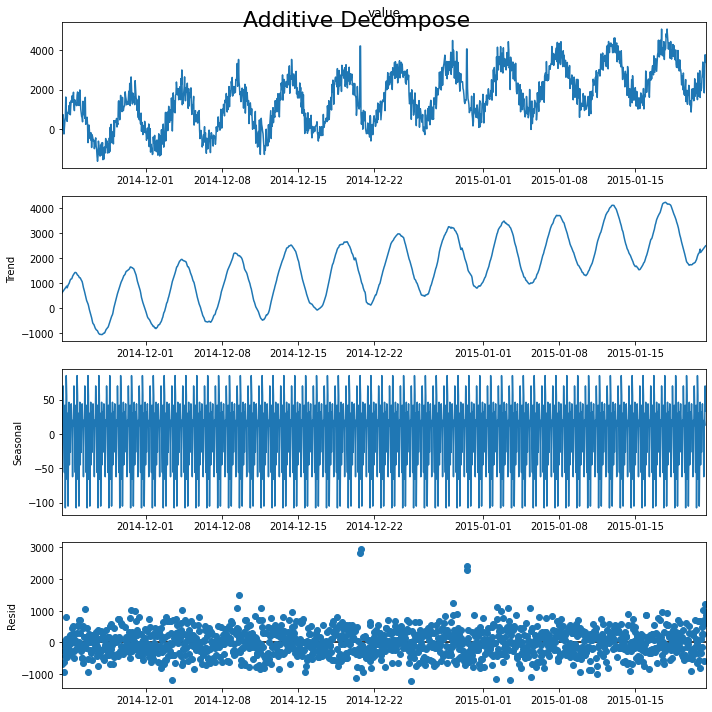

In [ ]:
# Plot
plt.rcParams.update({'figure.figsize': (10,10)})
#result_mul.plot().suptitle('Multiplicative Decompose', fontsize=22)
result_add.plot().suptitle('Additive Decompose', fontsize=22)
plt.show()

In [ ]:
threshold=500
residualdf = result_add.resid
outliers = residualdf[residualdf > threshold]
print(f"File: {all_csv[0]}")
print("threshold: 500")
print("Outliers:")
print(outliers)

File: /content/data/dataset/ydata-labeled-time-series-anomalies-v1_0/A2Benchmark/synthetic_40.csv
threshold: 500
Outliers:
timestamp
2014-11-23 16:00:00     815.984690
2014-11-24 09:00:00     516.622453
2014-11-24 18:00:00     506.219570
2014-11-24 19:00:00     551.924920
2014-11-24 21:00:00     697.489269
                          ...     
2015-01-21 05:00:00    1028.898609
2015-01-21 07:00:00     716.873820
2015-01-21 09:00:00     627.569807
2015-01-21 10:00:00    1225.297907
2015-01-21 11:00:00     856.651039
Name: resid, Length: 158, dtype: float64


In [ ]:
outliers = residualdf[residualdf > threshold]
not_outliers = residualdf[residualdf < threshold]
print(outliers,not_outliers)

timestamp
2014-11-23 16:00:00     815.984690
2014-11-24 09:00:00     516.622453
2014-11-24 18:00:00     506.219570
2014-11-24 19:00:00     551.924920
2014-11-24 21:00:00     697.489269
                          ...     
2015-01-21 05:00:00    1028.898609
2015-01-21 07:00:00     716.873820
2015-01-21 09:00:00     627.569807
2015-01-21 10:00:00    1225.297907
2015-01-21 11:00:00     856.651039
Name: resid, Length: 158, dtype: float64 timestamp
2014-11-23 07:00:00    -29.129860
2014-11-23 08:00:00   -697.905169
2014-11-23 09:00:00     24.618781
2014-11-23 10:00:00     -6.070462
2014-11-23 11:00:00   -263.932102
                          ...    
2015-01-21 02:00:00   -145.460238
2015-01-21 03:00:00    270.022311
2015-01-21 04:00:00    479.581369
2015-01-21 06:00:00    262.199653
2015-01-21 08:00:00   -599.268158
Name: resid, Length: 1263, dtype: float64


In [ ]:
df_indexed, outliers

(                           value  is_anomaly
 timestamp                                   
 2014-11-23 07:00:00   508.681619           0
 2014-11-23 08:00:00   -52.044324           0
 2014-11-23 09:00:00   688.353631           0
 2014-11-23 10:00:00   741.258885           0
 2014-11-23 11:00:00   472.570612           0
 ...                          ...         ...
 2015-01-21 07:00:00  3049.616790           0
 2015-01-21 08:00:00  1840.013232           0
 2015-01-21 09:00:00  3083.214258           0
 2015-01-21 10:00:00  3763.025910           0
 2015-01-21 11:00:00  3382.041463           0
 
 [1421 rows x 2 columns], timestamp
 2014-11-23 16:00:00     815.984690
 2014-11-24 09:00:00     516.622453
 2014-11-24 18:00:00     506.219570
 2014-11-24 19:00:00     551.924920
 2014-11-24 21:00:00     697.489269
                           ...     
 2015-01-21 05:00:00    1028.898609
 2015-01-21 07:00:00     716.873820
 2015-01-21 09:00:00     627.569807
 2015-01-21 10:00:00    1225.297907
 201

In [ ]:
anomalies = df_indexed.join(outliers,on='timestamp',how='inner',lsuffix='df_index')
not_anomalies = df_indexed.join(not_outliers,on='timestamp',how='inner',lsuffix='df_index')
print(anomalies),print(not_anomalies)

                           value  is_anomaly        resid
timestamp                                                
2014-11-23 16:00:00  1630.487421           0   815.984690
2014-11-24 09:00:00  1870.526877           0   516.622453
2014-11-24 18:00:00  1884.940998           0   506.219570
2014-11-24 19:00:00  1800.149168           0   551.924920
2014-11-24 21:00:00  1846.307079           0   697.489269
...                          ...         ...          ...
2015-01-21 05:00:00  3396.355855           0  1028.898609
2015-01-21 07:00:00  3049.616790           0   716.873820
2015-01-21 09:00:00  3083.214258           0   627.569807
2015-01-21 10:00:00  3763.025910           0  1225.297907
2015-01-21 11:00:00  3382.041463           0   856.651039

[158 rows x 3 columns]
                           value  is_anomaly       resid
timestamp                                               
2014-11-23 07:00:00   508.681619           0  -29.129860
2014-11-23 08:00:00   -52.044324           0 -697.9

(None, None)

In [ ]:
p = df_indexed.loc[df_indexed['is_anomaly'] == 1]

n = df_indexed.loc[df_indexed['is_anomaly'] == 0]

In [ ]:
print(p,n)

                           value  is_anomaly
timestamp                                   
2014-12-20 17:00:00  4205.406804           1
2014-12-20 18:00:00  4205.406804           1
2014-12-30 12:00:00  4055.339210           1
2014-12-30 13:00:00  4055.339210           1                            value  is_anomaly
timestamp                                   
2014-11-23 07:00:00   508.681619           0
2014-11-23 08:00:00   -52.044324           0
2014-11-23 09:00:00   688.353631           0
2014-11-23 10:00:00   741.258885           0
2014-11-23 11:00:00   472.570612           0
...                          ...         ...
2015-01-21 07:00:00  3049.616790           0
2015-01-21 08:00:00  1840.013232           0
2015-01-21 09:00:00  3083.214258           0
2015-01-21 10:00:00  3763.025910           0
2015-01-21 11:00:00  3382.041463           0

[1417 rows x 2 columns]


In [ ]:
truepositives = anomalies.loc[anomalies['is_anomaly'] == 1]

falsepositives = anomalies.loc[anomalies['is_anomaly'] == 0]

In [ ]:
print(truepositives,falsepositives,sep="\n")

                           value  is_anomaly        resid
timestamp                                                
2014-12-20 17:00:00  4205.406804           1  2838.732401
2014-12-20 18:00:00  4205.406804           1  2952.342103
2014-12-30 12:00:00  4055.339210           1  2300.517239
2014-12-30 13:00:00  4055.339210           1  2411.184879
                           value  is_anomaly        resid
timestamp                                                
2014-11-23 16:00:00  1630.487421           0   815.984690
2014-11-24 09:00:00  1870.526877           0   516.622453
2014-11-24 18:00:00  1884.940998           0   506.219570
2014-11-24 19:00:00  1800.149168           0   551.924920
2014-11-24 21:00:00  1846.307079           0   697.489269
...                          ...         ...          ...
2015-01-21 05:00:00  3396.355855           0  1028.898609
2015-01-21 07:00:00  3049.616790           0   716.873820
2015-01-21 09:00:00  3083.214258           0   627.569807
2015-01-21 10:

In [ ]:
truenegatives = not_anomalies.loc[not_anomalies['is_anomaly'] == 0]

falsenegatives = not_anomalies.loc[not_anomalies['is_anomaly'] == 1]

In [ ]:
print(truenegatives,falsenegatives,sep="\n")

                           value  is_anomaly       resid
timestamp                                               
2014-11-23 07:00:00   508.681619           0  -29.129860
2014-11-23 08:00:00   -52.044324           0 -697.905169
2014-11-23 09:00:00   688.353631           0   24.618781
2014-11-23 10:00:00   741.258885           0   -6.070462
2014-11-23 11:00:00   472.570612           0 -263.932102
...                          ...         ...         ...
2015-01-21 02:00:00  2101.500339           0 -145.460238
2015-01-21 03:00:00  2594.625870           0  270.022311
2015-01-21 04:00:00  2845.485840           0  479.581369
2015-01-21 06:00:00  2641.657888           0  262.199653
2015-01-21 08:00:00  1840.013232           0 -599.268158

[1263 rows x 3 columns]
Empty DataFrame
Columns: [value, is_anomaly, resid]
Index: []


In [ ]:
#Traditional FPR and TPR formmulae
#tpr = truepositives.count()/(truepositives.count() + falsenegatives.count())
#fpr = falsepositives.count()/(falsepositives.count() + truenegatives.count())

#IDEAL Paper based TRP/FPR rates
fpr = len(falsepositives)/len(n)
tpr = len(truepositives)/len(p)
fnr = 1-tpr
tnr = 1-fpr

In [ ]:
print(fpr,tpr,fnr,tnr,sep = "\n")

0.1086803105151729
1.0
0.0
0.8913196894848271


In [ ]:
precision = len(truepositives)/(tpr + fpr)
recall = tpr/(tpr + fnr)

In [ ]:
print(precision,recall,sep="\n")

3.6078930617441123
1.0


In [ ]:
f1 = 2 * ((precision * recall)/(precision + recall))

In [ ]:
print(f1)

1.5659621494681584


Note that the presence of negative and zero values make it such that multiplicative decomposition is not applicable for these time series.

## Trying the new STL API in Stats models v0.12.0

In [ ]:
# https://stackoverflow.com/questions/5226311/installing-specific-package-versions-with-pip
import statsmodels
if not statsmodels.__version__ == '0.12.0':
    print(statsmodels.__version__)
    !pip install -I statsmodels==0.12.0
else:
    pass

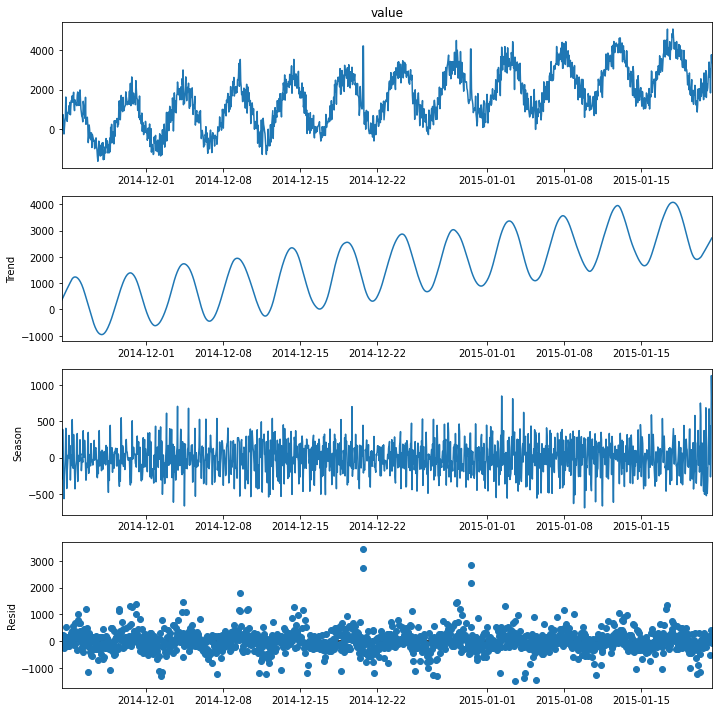

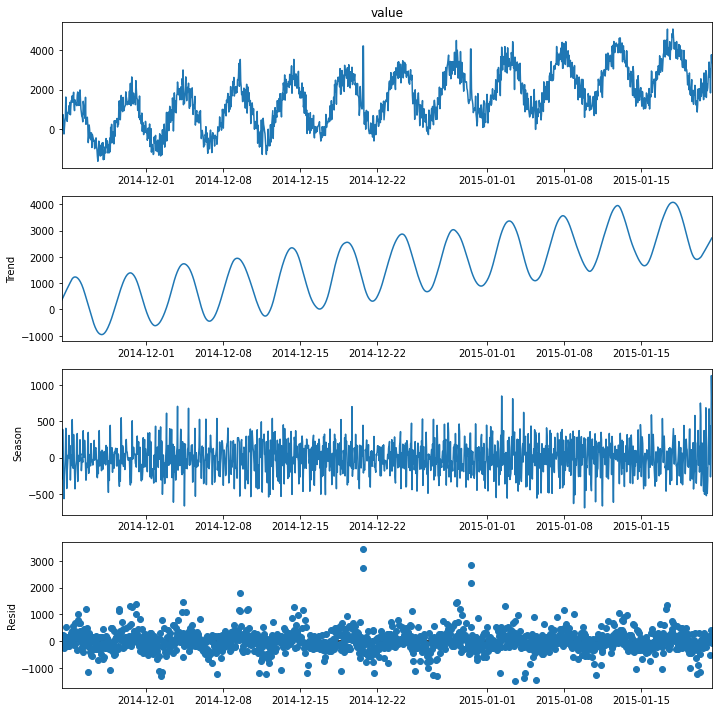

In [ ]:
res = statsmodels.tsa.seasonal.STL(df_indexed['value']).fit(inner_iter=10,outer_iter=20)
res.plot()
# plt.show()

In [ ]:
res.resid

timestamp
2014-11-23 07:00:00    -38.056713
2014-11-23 08:00:00   -144.703797
2014-11-23 09:00:00   -127.183315
2014-11-23 10:00:00    227.565799
2014-11-23 11:00:00    187.571851
                          ...    
2015-01-21 07:00:00     16.702472
2015-01-21 08:00:00   -518.285964
2015-01-21 09:00:00    397.553481
2015-01-21 10:00:00    -53.858791
2015-01-21 11:00:00    -79.809225
Name: resid, Length: 1421, dtype: float64

## TRying the APIs on standardized data

In [ ]:
#df_indexed.index.freq = 'MS'
# prepare data for standardization
values = df_indexed.copy()
values = values.drop(columns=['is_anomaly'],axis=1)
#values = values.reshape((len(values), 1))

# train the standardization
scaler2 = StandardScaler()
scaler2 = scaler2.fit(values)
print('Mean: %f, StandardDeviation: %f' % (scaler2.mean_, sqrt(scaler2.var_)))
# standardize the dataset
standardaized = scaler2.transform(values)
values['std_val'] = standardaized 

Mean: 1588.069123, StandardDeviation: 1364.684820


In [ ]:
values

,value,std_val
timestamp,,
2014-11-23 07:00:00,508.681619,-0.790943
2014-11-23 08:00:00,-52.044324,-1.201826
2014-11-23 09:00:00,688.353631,-0.659284
2014-11-23 10:00:00,741.258885,-0.620517
2014-11-23 11:00:00,472.570612,-0.817404
...,...,...
2015-01-21 07:00:00,3049.616790,1.070978
2015-01-21 08:00:00,1840.013232,0.184617
2015-01-21 09:00:00,3083.214258,1.095597


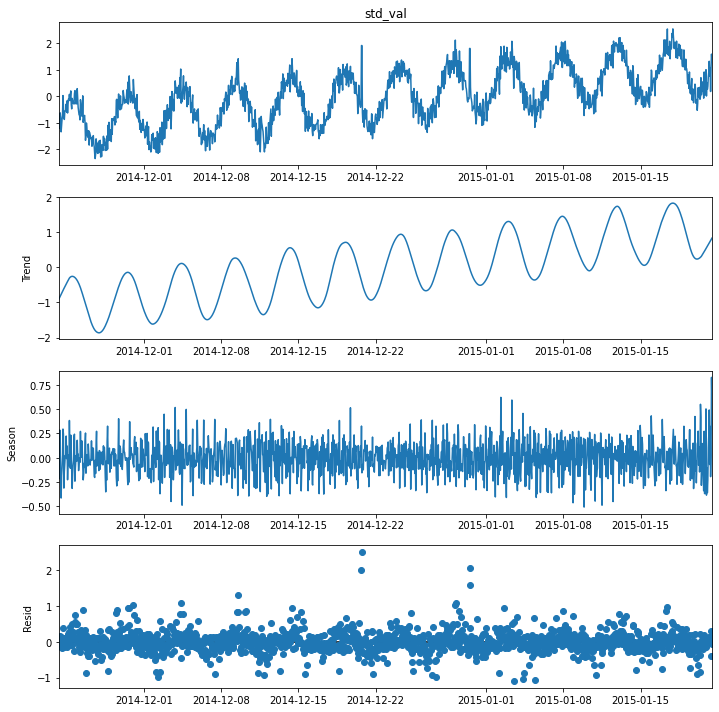

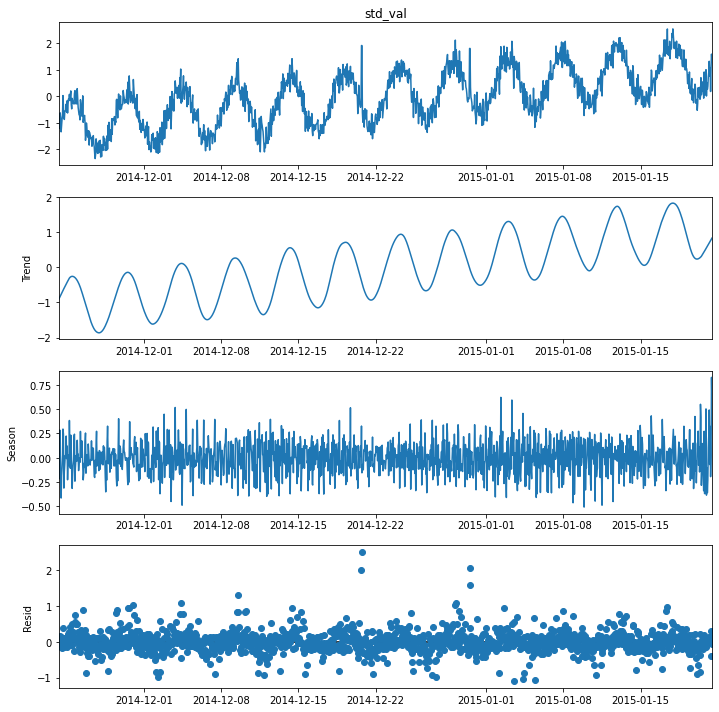

In [ ]:
res = statsmodels.tsa.seasonal.STL(values['std_val']).fit(inner_iter=10,outer_iter=20)
res.plot()
# plt.show()

# For other time series

Now Let's try doing this for all the other 99 time series in a loop

In [ ]:
def calc_stats(truepositives, falsepositives,truenegatives,falsenegatives):
    stats = []
    if(len(truepositives) + len(falsepositives) > 0):
        precision = len(truepositives)/(len(truepositives) + len(falsepositives))
        #print("Precision: ", precision)
    else:
        #print("truepositives + falsepositives = 0")
        precision = 0
    stats.append(precision)
        
    if(len(truepositives) + len(falsenegatives) > 0):
        recall = len(truepositives)/(len(truepositives) + len(falsenegatives))
        #print("Recall:", recall)
    else:
        #print("truepositives + falsenegatives = 0")
        recall = 0
    stats.append(recall)
           
    
    if(precision + recall > 0):
        f1 = 2*(precision * recall)/(precision + recall)
        #print("F1:",f1)
    else:
        #print("precision + recall = 0")
        f1= 0
    stats.append(f1)
        
    return stats

## A2 folder - Synthetic Time-series data with inserted outliers

In [ ]:
all_csv[0].split("/")[6].replace('\\','').split(".")[0]

In [ ]:
df_indexed['value'].plot()

In [ ]:
result_add.resid

### New API Non standardized

In [ ]:
start_time = datetime.now() 
STLf1_plot = []
STLprecision_plot = []
STLrecall_plot = []
for index,file in enumerate(all_csv):
    if index%10 == 0:
        print(f'Processing index: {index} of {len(all_csv)}')
    if index > 1:
        break
    fname = file.split("/")[6].replace('\\','').split(".")[0]
    df = pd.read_csv(file)
    df['timestamp'] = pd.to_datetime(df['timestamp'],unit='s')
    df_indexed = df.set_index('timestamp')
    result_add = statsmodels.tsa.seasonal.STL(df_indexed['value']).fit(inner_iter=10,outer_iter=20)

    threshold=500
    residualdf = result_add.resid
    
    outliers = residualdf[residualdf > threshold]
    anomalies = df_indexed.join(outliers,on='timestamp',how='inner')
    not_anomalies = df_indexed.join(not_outliers,on='timestamp',how='inner')
    not_outliers = residualdf[residualdf < threshold]
    
    p = df_indexed.loc[df_indexed['is_anomaly'] == 1]
    
    n = df_indexed.loc[df_indexed['is_anomaly'] == 0]
    
    truepositives = anomalies.loc[anomalies['is_anomaly'] == 1]
    
    falsepositives = anomalies.loc[anomalies['is_anomaly'] == 0]
    
    truenegatives = not_anomalies.loc[not_anomalies['is_anomaly'] == 0]
    
    falsenegatives = not_anomalies.loc[not_anomalies['is_anomaly'] == 1]
    
    #Traditional FPR and TPR formmulae
    #tpr = truepositives.count()/(truepositives.count() + falsenegatives.count())
    #fpr = falsepositives.count()/(falsepositives.count() + truenegatives.count())
    
    #IDEAL Paper based TRP/FPR rates
    fpr = len(falsepositives)/len(n)
    tpr = len(truepositives)/len(p)
    fnr = 1-tpr
    tnr = 1-fpr
    
    #precision = len(truepositives)/(len(truepositives) + len(falsepositives))
    #recall = len(truepositives)/(len(truepositives) + len(falsenegatives))
    
    #f1 = 2 * (precision * recall)/(precision + recall)
    precision,recall,f1 = calc_stats(truepositives,falsepositives, truenegatives, falsenegatives)
    STLf1_plot.append(f1)
    STLprecision_plot.append(precision)
    STLrecall_plot.append(recall)
    
    with open("/content/drive/My Drive/Colab Notebooks/tImeSeries-files/STLoutput/"+ fname + ".txt", 'w') as file:
        file.write(f"\n\nFile: {fname}")
        file.write("\nthreshold: 500")
        file.write("\nOutliers:\n")
        file.write(outliers.to_csv())
        
        file.write("\n\n\n Statistics:")
        file.write(f"\ntrue positives:{len(truepositives)}")
        file.write(f"\nfalse positives:{len(falsepositives)}")
        file.write(f"\ntrue negatives:{len(truenegatives)}")
        file.write(f"\nfalse negatives:{len(falsenegatives)}")
        file.write(f"\nFPR:{fpr}")
        file.write(f"\nTPR:{tpr}")
        file.write(f"\nFNR:{fnr}")
        file.write(f"\nTNR:{tnr}")
        
        file.write(f"\nPrecision:{precision}")
        file.write(f"\nREcall:{recall}")
        file.write(f"\nF1:{f1}")
        
        
    print(f"\n\nFile: {fname}")
    print("threshold: 500")
    print("Actual Outliers:", len(p))
    print(p)
    print("Detected outliers:", len(outliers))
    print("Outliers:")
    print(outliers)
end_time=datetime.now()
print(STLf1_plot)
plt.plot(STLf1_plot)
plt.show()

In [ ]:
print(f"STL decomposition of Yahoo S5 A2 Benchmark processing complete. Time taken:{end_time-start_time}")

In [ ]:
print(sum(f1_plot)/len(f1_plot))

### Old API Non standardized 

In [ ]:
start_time = datetime.now() 
f1_plot = []
for index,file in enumerate(all_csv):
    if index%10 == 0:
        print(f'Processing index: {index} of {len(all_csv)}')
    if index > 1:
        break
    fname = file.split("/")[6].replace('\\','').split(".")[0]
    df = pd.read_csv(file)
    df['timestamp'] = pd.to_datetime(df['timestamp'],unit='s')
    df_indexed = df.set_index('timestamp')
    result_add = seasonal_decompose(df_indexed['value'], model='additive', extrapolate_trend='freq')
    # Plot
    #plt.rcParams.update({'figure.figsize': (10,10)})
    result_add.plot().suptitle('Additive Decompose', fontsize=22)
    plt.savefig("/content/drive/My Drive/Colab Notebooks/tImeSeries-files/STLoutput/A2Benchmark_" + fname +"add_STL")
    print("\n\n\nA2Benchmark_" + fname +"add_STL")
    plt.show()
    threshold=500
    residualdf = result_add.resid
    
    outliers = residualdf[residualdf > threshold]
    anomalies = df_indexed.join(outliers,on='timestamp',how='inner')
    not_anomalies = df_indexed.join(not_outliers,on='timestamp',how='inner')
    not_outliers = residualdf[residualdf < threshold]
    
    p = df_indexed.loc[df_indexed['is_anomaly'] == 1]
    
    n = df_indexed.loc[df_indexed['is_anomaly'] == 0]
    
    truepositives = anomalies.loc[anomalies['is_anomaly'] == 1]
    
    falsepositives = anomalies.loc[anomalies['is_anomaly'] == 0]
    
    truenegatives = not_anomalies.loc[not_anomalies['is_anomaly'] == 0]
    
    falsenegatives = not_anomalies.loc[not_anomalies['is_anomaly'] == 1]
    
    #Traditional FPR and TPR formmulae
    #tpr = truepositives.count()/(truepositives.count() + falsenegatives.count())
    #fpr = falsepositives.count()/(falsepositives.count() + truenegatives.count())
    
    #IDEAL Paper based TRP/FPR rates
    fpr = len(falsepositives)/len(n)
    tpr = len(truepositives)/len(p)
    fnr = 1-tpr
    tnr = 1-fpr
    
    precision = len(truepositives)/(len(truepositives) + len(falsepositives))
    recall = len(truepositives)/(len(truepositives) + len(falsenegatives))
    
    f1 = 2 * (precision * recall)/(precision + recall)
    f1_plot.append(f1)
    
    with open("/content/drive/My Drive/Colab Notebooks/tImeSeries-files/STLoutput/"+ fname + ".txt", 'w') as file:
        file.write(f"\n\nFile: {fname}")
        file.write("\nthreshold: 500")
        file.write("\nOutliers:\n")
        file.write(outliers.to_csv())
        
        file.write("\n\n\n Statistics:")
        file.write(f"\ntrue positives:{len(truepositives)}")
        file.write(f"\nfalse positives:{len(falsepositives)}")
        file.write(f"\ntrue negatives:{len(truenegatives)}")
        file.write(f"\nfalse negatives:{len(falsenegatives)}")
        file.write(f"\nFPR:{fpr}")
        file.write(f"\nTPR:{tpr}")
        file.write(f"\nFNR:{fnr}")
        file.write(f"\nTNR:{tnr}")
        
        file.write(f"\nPrecision:{precision}")
        file.write(f"\nREcall:{recall}")
        file.write(f"\nF1:{f1}")
        
        
    print(f"\n\nFile: {fname}")
    print("threshold: 500")
    print("Actual Outliers:", len(p))
    print(p)
    print("Detected outliers:", len(outliers))
    print("Outliers:")
    print(outliers)
end_time=datetime.now()
print(f"Additive decomposition of Yahoo S5 A2 Benchmark processing complete. Time taken:{end_time-start_time}")
print(f1_plot)
plt.plot(f1_plot)

In [ ]:
print(f"Additive decomposition of Yahoo S5 A2 Benchmark processing complete. Time taken:{end_time-start_time}")

In [ ]:
print(sum(f1_plot)/len(f1_plot))

In [ ]:
f1_plot[:10]

### Standardizing the Time series and applying

In [ ]:
from sklearn.preprocessing import StandardScaler
from math import sqrt

In [ ]:
df_indexed

### Old API standardized


  0%|          | 0/100 [00:00<?, ?it/s]

Processing index: 0 of 100
Mean: 1588.069123, StandardDeviation: 1364.684820
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   508.681619           0
1    2014-11-23 08:00:00   -52.044324           0
2    2014-11-23 09:00:00   688.353631           0
3    2014-11-23 10:00:00   741.258885           0
4    2014-11-23 11:00:00   472.570612           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  3049.616790           0
1417 2015-01-21 08:00:00  1840.013232           0
1418 2015-01-21 09:00:00  3083.214258           0
1419 2015-01-21 10:00:00  3763.025910           0
1420 2015-01-21 11:00:00  3382.041463           0

[1421 rows x 3 columns]



A2Benchmark_A2Benchmarkadd_STL


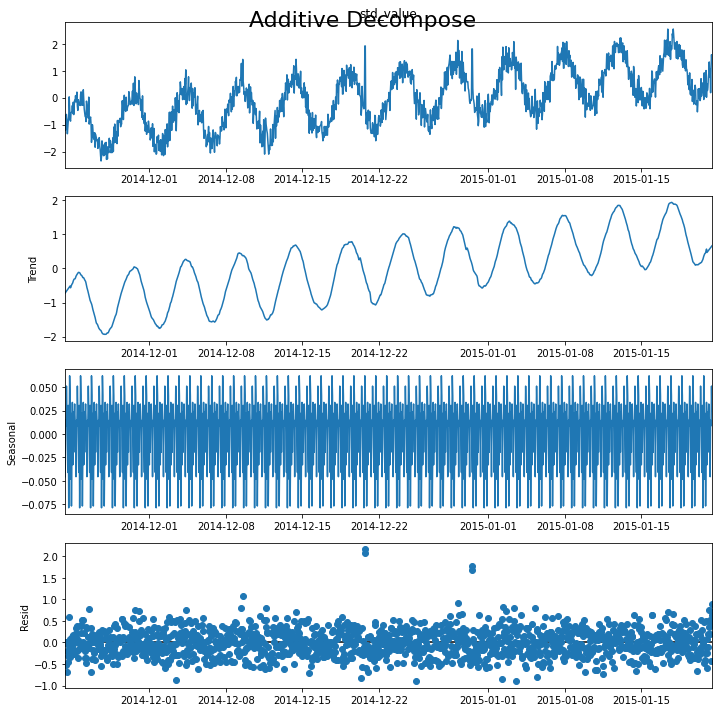


  1%|          | 1/100 [00:01<01:49,  1.10s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 4
                           value  is_anomaly  std_value
timestamp                                              
2014-12-20 17:00:00  4205.406804           1   1.917906
2014-12-20 18:00:00  4205.406804           1   1.917906
2014-12-30 12:00:00  4055.339210           1   1.807941
2014-12-30 13:00:00  4055.339210           1   1.807941
Detected outliers: 75
Outliers:
               timestamp     resid
9    2014-11-23 16:00:00  0.597929
38   2014-11-24 21:00:00  0.511099
40   2014-11-24 23:00:00  0.527958
52   2014-11-25 11:00:00  0.771118
125  2014-11-28 12:00:00  0.534173
...                  ...       ...
1407 2015-01-20 22:00:00  0.501789
1414 2015-01-21 05:00:00  0.753946
1416 2015-01-21 07:00:00  0.525304
1419 2015-01-21 10:00:00  0.897861
1420 2015-01-21 11:00:00  0.627728

[75 rows x 2 columns]
--------------------
Mean: 9558.249333, StandardDeviation: 5634.500670
               timestamp         value  is_anomaly
0    2014-11-2

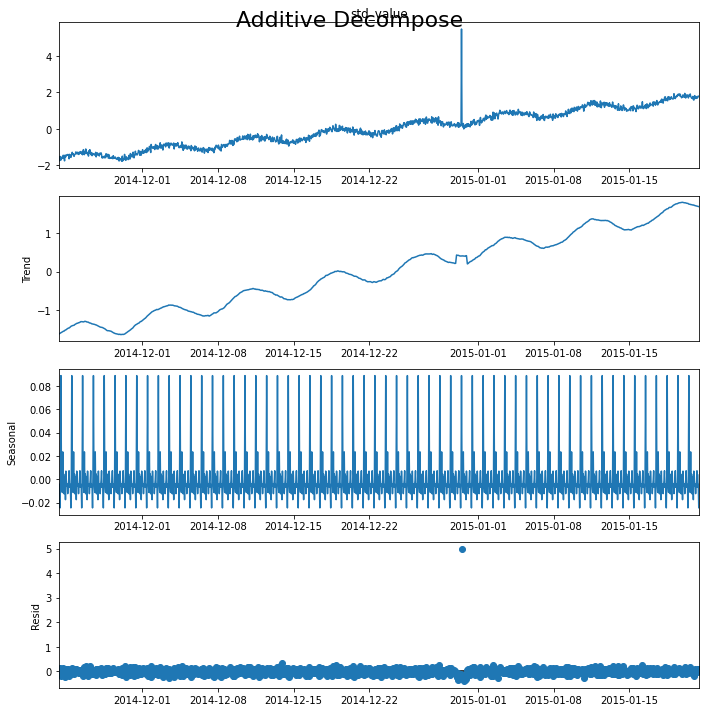


  2%|▏         | 2/100 [00:02<01:45,  1.08s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 1
                            value  is_anomaly  std_value
timestamp                                               
2014-12-30 12:00:00  40447.022399           1   5.482078
Detected outliers: 1
Outliers:
              timestamp     resid
893 2014-12-30 12:00:00  4.984939
--------------------
Mean: 556.168299, StandardDeviation: 1032.250432
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   -93.812494           0
1    2014-11-23 08:00:00   103.595557           0
2    2014-11-23 09:00:00    24.559448           0
3    2014-11-23 10:00:00   466.082451           0
4    2014-11-23 11:00:00   348.780473           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00   824.045104           0
1417 2015-01-21 08:00:00  1051.258792           0
1418 2015-01-21 09:00:00  1156.487387           0
1419 2015-01-21 10:00:00  1229.842666           0
1420 2015-01-21 11:00:00  1259.104318           0

[1421 

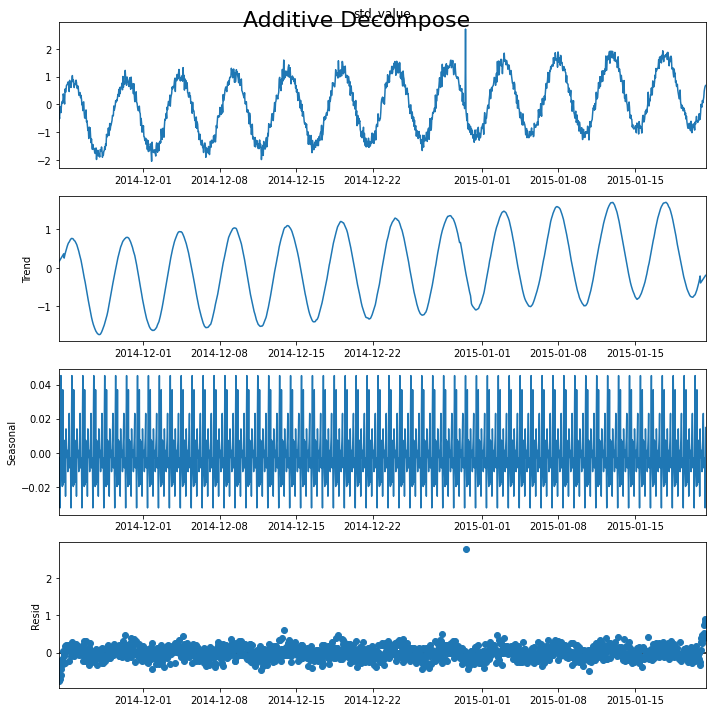


  3%|▎         | 3/100 [00:03<01:45,  1.09s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 1
                           value  is_anomaly  std_value
timestamp                                              
2014-12-30 12:00:00  3364.381794           1   2.720477
Detected outliers: 7
Outliers:
               timestamp     resid
494  2014-12-13 21:00:00  0.607741
893  2014-12-30 12:00:00  2.771429
1416 2015-01-21 07:00:00  0.536637
1417 2015-01-21 08:00:00  0.733114
1418 2015-01-21 09:00:00  0.818871
1419 2015-01-21 10:00:00  0.900011
1420 2015-01-21 11:00:00  0.863473
--------------------
Mean: 3493.558825, StandardDeviation: 2366.714471
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   700.730093           0
1    2014-11-23 08:00:00   -86.491432           0
2    2014-11-23 09:00:00   914.105274           0
3    2014-11-23 10:00:00   970.021956           0
4    2014-11-23 11:00:00   584.018188           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  7433.275477          

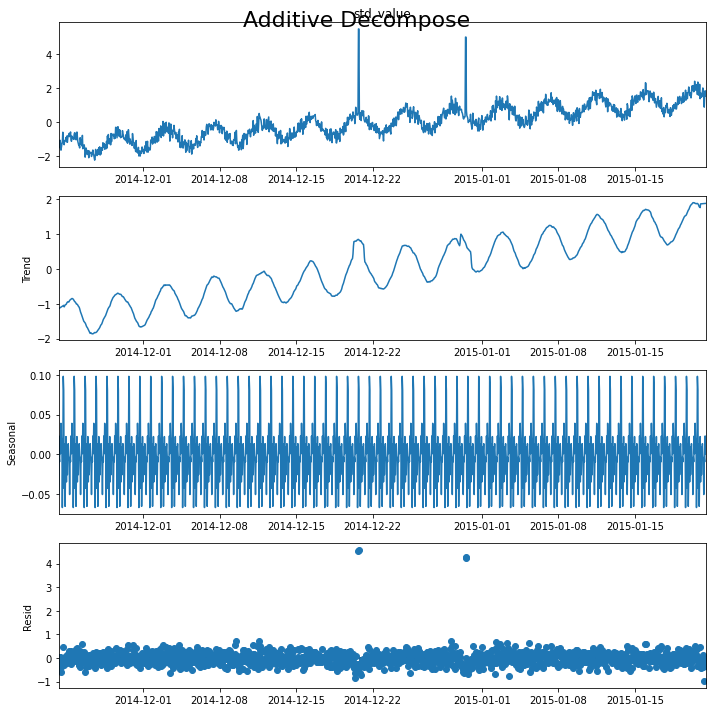


  4%|▍         | 4/100 [00:04<01:42,  1.07s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 4
                            value  is_anomaly  std_value
timestamp                                               
2014-12-20 17:00:00  16488.904916           1   5.490880
2014-12-20 18:00:00  16488.904916           1   5.490880
2014-12-30 12:00:00  15354.072990           1   5.011384
2014-12-30 13:00:00  15354.072990           1   5.011384
Detected outliers: 31
Outliers:
               timestamp     resid
52   2014-11-25 11:00:00  0.611138
153  2014-11-29 16:00:00  0.558424
162  2014-11-30 01:00:00  0.540182
229  2014-12-02 20:00:00  0.534600
265  2014-12-04 08:00:00  0.550964
387  2014-12-09 10:00:00  0.551967
390  2014-12-09 13:00:00  0.713434
427  2014-12-11 02:00:00  0.540336
436  2014-12-11 11:00:00  0.515998
440  2014-12-11 15:00:00  0.731517
441  2014-12-11 16:00:00  0.510460
658  2014-12-20 17:00:00  4.548751
659  2014-12-20 18:00:00  4.579718
862  2014-12-29 05:00:00  0.736234
864  2014-12-29 07:00:00  0.508527
871  2014-12-

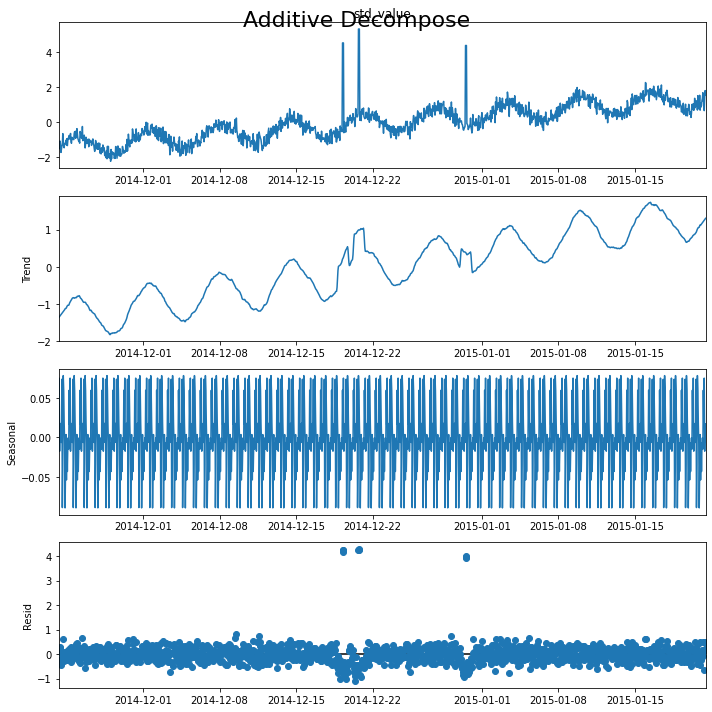


  5%|▌         | 5/100 [00:05<01:40,  1.06s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 9
                            value  is_anomaly  std_value
timestamp                                               
2014-12-19 06:00:00  14321.055903           1   4.508653
2014-12-19 07:00:00  14321.055903           1   4.508653
2014-12-19 08:00:00  14321.055903           1   4.508653
2014-12-20 17:00:00  16218.073649           1   5.300077
2014-12-20 18:00:00  16218.073649           1   5.300077
2014-12-20 19:00:00  16218.073649           1   5.300077
2014-12-30 12:00:00  13972.268474           1   4.363141
2014-12-30 13:00:00  13972.268474           1   4.363141
2014-12-30 14:00:00  13972.268474           1   4.363141
Detected outliers: 34
Outliers:
               timestamp     resid
9    2014-11-23 16:00:00  0.609562
52   2014-11-25 11:00:00  0.671540
153  2014-11-29 16:00:00  0.590933
162  2014-11-30 01:00:00  0.605589
229  2014-12-02 20:00:00  0.545916
303  2014-12-05 22:00:00  0.520841
387  2014-12-09 10:00:00  0.645562
390  201

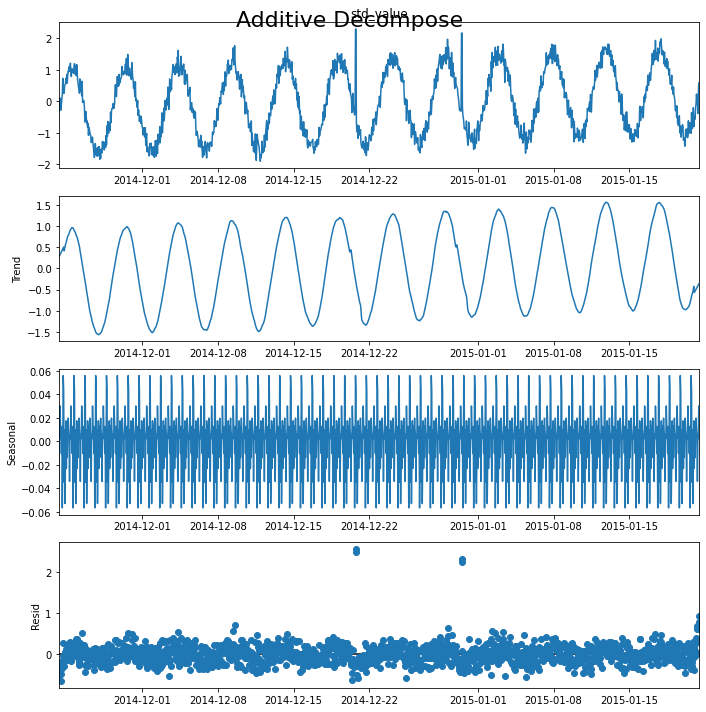


  6%|▌         | 6/100 [00:06<01:39,  1.06s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 4
                           value  is_anomaly  std_value
timestamp                                              
2014-12-20 17:00:00  2701.113338           1   2.290352
2014-12-20 18:00:00  2701.113338           1   2.290352
2014-12-30 12:00:00  2570.985949           1   2.162908
2014-12-30 13:00:00  2570.985949           1   2.162908
Detected outliers: 19
Outliers:
               timestamp     resid
52   2014-11-25 11:00:00  0.510236
153  2014-11-29 16:00:00  0.528006
162  2014-11-30 01:00:00  0.505150
265  2014-12-04 08:00:00  0.530395
387  2014-12-09 10:00:00  0.558331
390  2014-12-09 13:00:00  0.723112
658  2014-12-20 17:00:00  2.490710
659  2014-12-20 18:00:00  2.576010
862  2014-12-29 05:00:00  0.633068
893  2014-12-30 12:00:00  2.255597
894  2014-12-30 13:00:00  2.340555
961  2015-01-02 08:00:00  0.557982
968  2015-01-02 15:00:00  0.519019
985  2015-01-03 08:00:00  0.549966
1414 2015-01-21 05:00:00  0.690044
1416 2015-01-21 07:

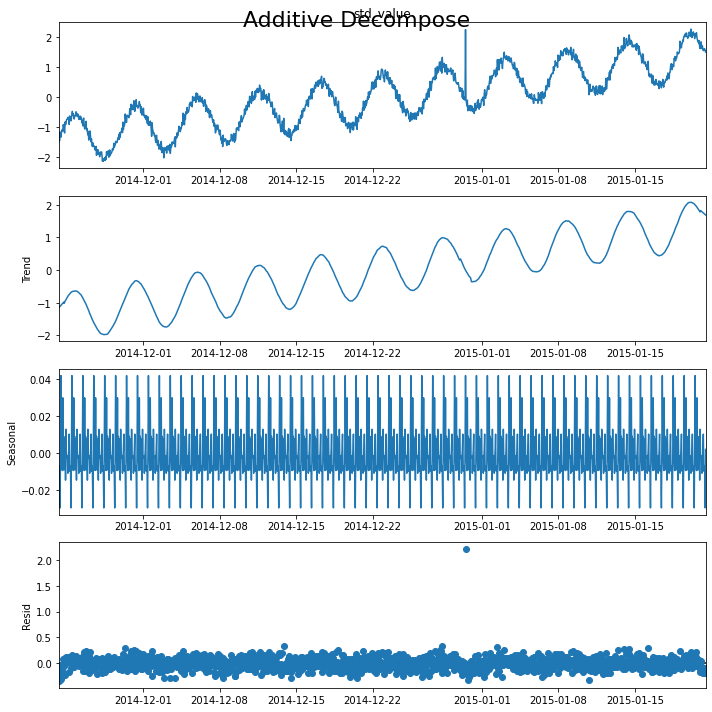


  7%|▋         | 7/100 [00:07<01:37,  1.05s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 1
                           value  is_anomaly  std_value
timestamp                                              
2014-12-30 12:00:00  6622.489879           1   2.254806
Detected outliers: 1
Outliers:
              timestamp     resid
893 2014-12-30 12:00:00  2.214789
--------------------
Mean: 4471.669226, StandardDeviation: 2925.391670
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   297.829102           0
1    2014-11-23 08:00:00   -16.734937           0
2    2014-11-23 09:00:00   418.295754           0
3    2014-11-23 10:00:00   457.428204           0
4    2014-11-23 11:00:00   311.510876           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  8910.889559           0
1417 2015-01-21 08:00:00  8130.658688           0
1418 2015-01-21 09:00:00  8762.876253           0
1419 2015-01-21 10:00:00  9070.204621           0
1420 2015-01-21 11:00:00  8766.279151           0

[1421 ro

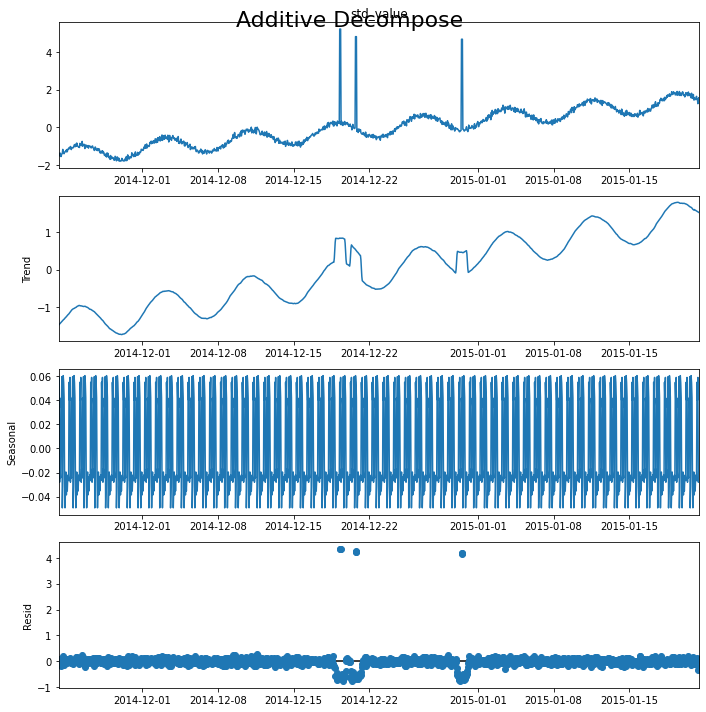


  8%|▊         | 8/100 [00:08<01:35,  1.04s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 9
                            value  is_anomaly  std_value
timestamp                                               
2014-12-19 06:00:00  19740.188389           1   5.219308
2014-12-19 07:00:00  19740.188389           1   5.219308
2014-12-19 08:00:00  19740.188389           1   5.219308
2014-12-20 17:00:00  18553.830928           1   4.813770
2014-12-20 18:00:00  18553.830928           1   4.813770
2014-12-20 19:00:00  18553.830928           1   4.813770
2014-12-30 12:00:00  18153.623148           1   4.676965
2014-12-30 13:00:00  18153.623148           1   4.676965
2014-12-30 14:00:00  18153.623148           1   4.676965
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  4.328168
624 2014-12-19 07:00:00  4.345846
625 2014-12-19 08:00:00  4.327784
658 2014-12-20 17:00:00  4.220636
659 2014-12-20 18:00:00  4.244184
660 2014-12-20 19:00:00  4.273628
893 2014-12-30 12:00:00  4.174008
894 2014-12-30 13

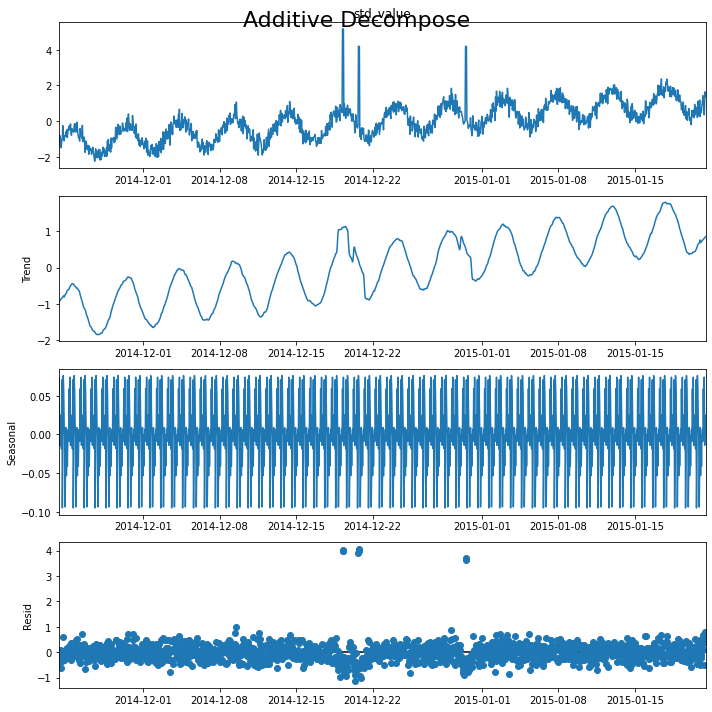


  9%|▉         | 9/100 [00:09<01:37,  1.07s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 9
                            value  is_anomaly  std_value
timestamp                                               
2014-12-19 06:00:00  11165.814595           1   5.157476
2014-12-19 07:00:00  11165.814595           1   5.157476
2014-12-19 08:00:00  11165.814595           1   5.157476
2014-12-20 17:00:00   9480.120535           1   4.184423
2014-12-20 18:00:00   9480.120535           1   4.184423
2014-12-20 19:00:00   9480.120535           1   4.184423
2014-12-30 12:00:00   9484.057504           1   4.186696
2014-12-30 13:00:00   9484.057504           1   4.186696
2014-12-30 14:00:00   9484.057504           1   4.186696
Detected outliers: 56
Outliers:
               timestamp     resid
9    2014-11-23 16:00:00  0.596117
40   2014-11-24 23:00:00  0.502973
52   2014-11-25 11:00:00  0.732557
153  2014-11-29 16:00:00  0.704518
162  2014-11-30 01:00:00  0.696623
170  2014-11-30 09:00:00  0.552875
229  2014-12-02 20:00:00  0.568391
253  201

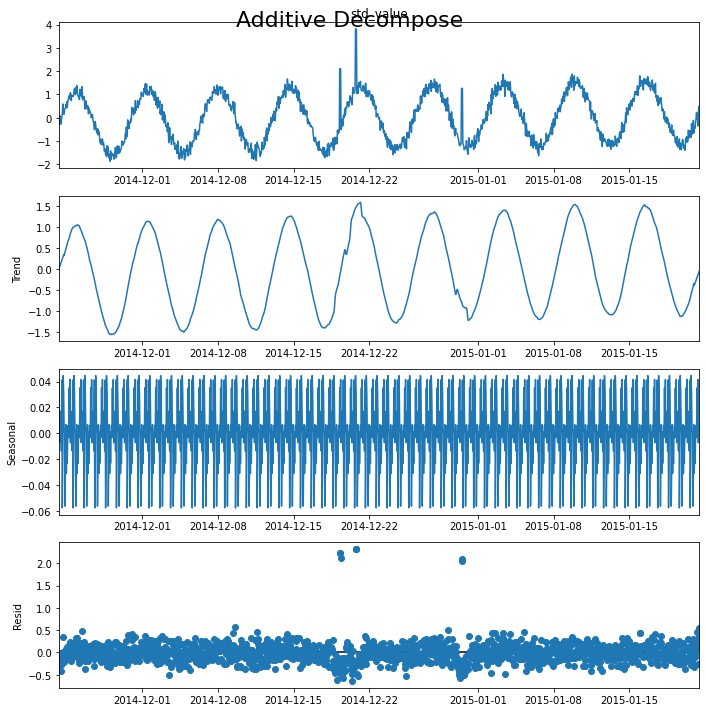


 10%|█         | 10/100 [00:10<01:35,  1.07s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 9
                           value  is_anomaly  std_value
timestamp                                              
2014-12-19 06:00:00  2455.065872           1   2.103996
2014-12-19 07:00:00  2455.065872           1   2.103996
2014-12-19 08:00:00  2455.065872           1   2.103996
2014-12-20 17:00:00  4206.886469           1   3.814266
2014-12-20 18:00:00  4206.886469           1   3.814266
2014-12-20 19:00:00  4206.886469           1   3.814266
2014-12-30 12:00:00  1591.137711           1   1.260559
2014-12-30 13:00:00  1591.137711           1   1.260559
2014-12-30 14:00:00  1591.137711           1   1.260559
Detected outliers: 12
Outliers:
               timestamp     resid
390  2014-12-09 13:00:00  0.580740
623  2014-12-19 06:00:00  2.233107
624  2014-12-19 07:00:00  2.217607
625  2014-12-19 08:00:00  2.123253
658  2014-12-20 17:00:00  2.310747
659  2014-12-20 18:00:00  2.308735
660  2014-12-20 19:00:00  2.320300
862  2014-12-29 05:

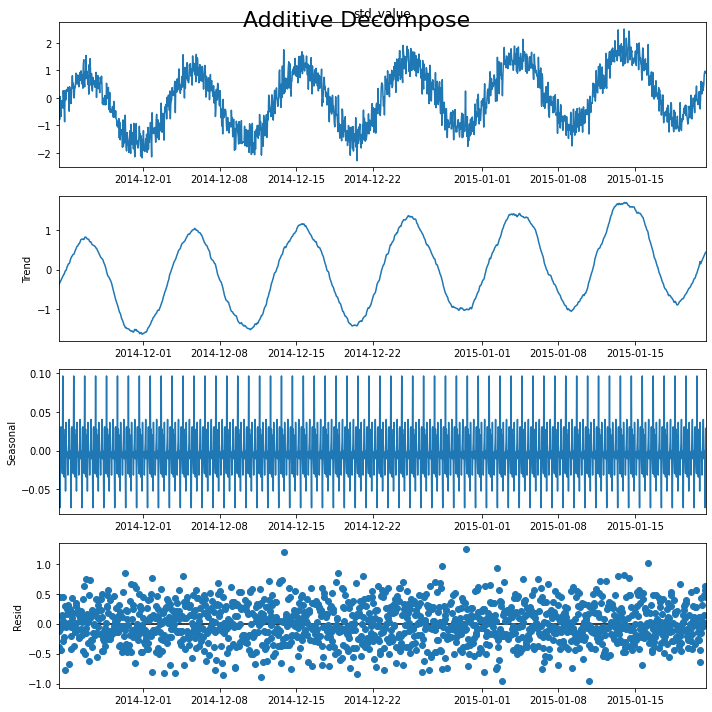


 11%|█         | 11/100 [00:11<01:34,  1.07s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 1
                          value  is_anomaly  std_value
timestamp                                             
2014-12-30 12:00:00  908.522117           1   0.250416
Detected outliers: 93
Outliers:
               timestamp     resid
55   2014-11-25 14:00:00  0.634176
60   2014-11-25 19:00:00  0.753635
69   2014-11-26 04:00:00  0.723792
109  2014-11-27 20:00:00  0.567187
141  2014-11-29 04:00:00  0.522568
...                  ...       ...
1364 2015-01-19 03:00:00  0.663696
1388 2015-01-20 03:00:00  0.530601
1400 2015-01-20 15:00:00  0.569722
1418 2015-01-21 09:00:00  0.560921
1419 2015-01-21 10:00:00  0.631954

[93 rows x 2 columns]
--------------------
Mean: 2496.588623, StandardDeviation: 1712.264206
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   636.233589           0
1    2014-11-23 08:00:00  -119.292156           0
2    2014-11-23 09:00:00   751.011260           0
3    2014-11-23 10:00:00   762.84762

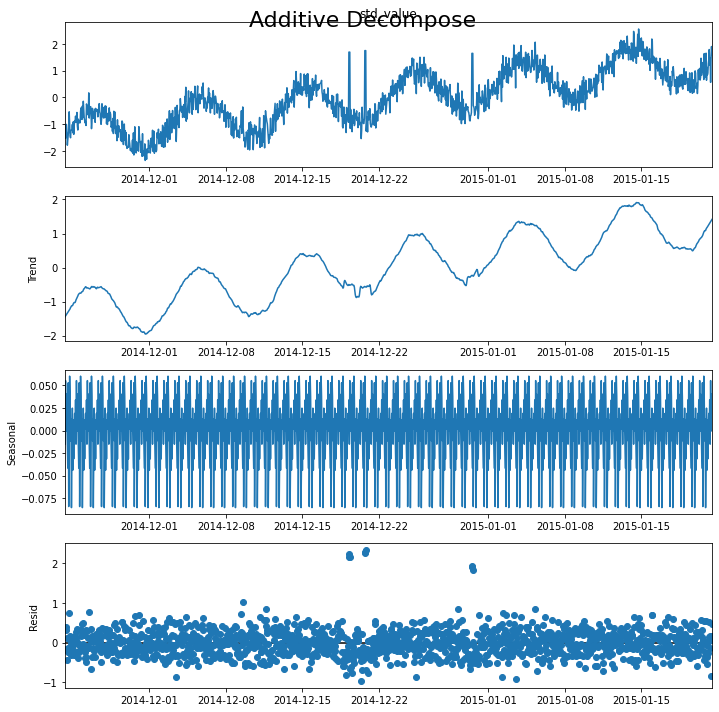


 12%|█▏        | 12/100 [00:12<01:33,  1.06s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 9
                           value  is_anomaly  std_value
timestamp                                              
2014-12-19 06:00:00  5392.806050           1   1.691455
2014-12-19 07:00:00  5392.806050           1   1.691455
2014-12-19 08:00:00  5392.806050           1   1.691455
2014-12-20 17:00:00  5489.383786           1   1.747858
2014-12-20 18:00:00  5489.383786           1   1.747858
2014-12-20 19:00:00  5489.383786           1   1.747858
2014-12-30 12:00:00  5313.477228           1   1.645125
2014-12-30 13:00:00  5313.477228           1   1.645125
2014-12-30 14:00:00  5313.477228           1   1.645125
Detected outliers: 69
Outliers:
               timestamp     resid
9    2014-11-23 16:00:00  0.732870
52   2014-11-25 11:00:00  0.767853
125  2014-11-28 12:00:00  0.505287
126  2014-11-28 13:00:00  0.510937
153  2014-11-29 16:00:00  0.673927
...                  ...       ...
1359 2015-01-18 22:00:00  0.515965
1396 2015-01-20 11:

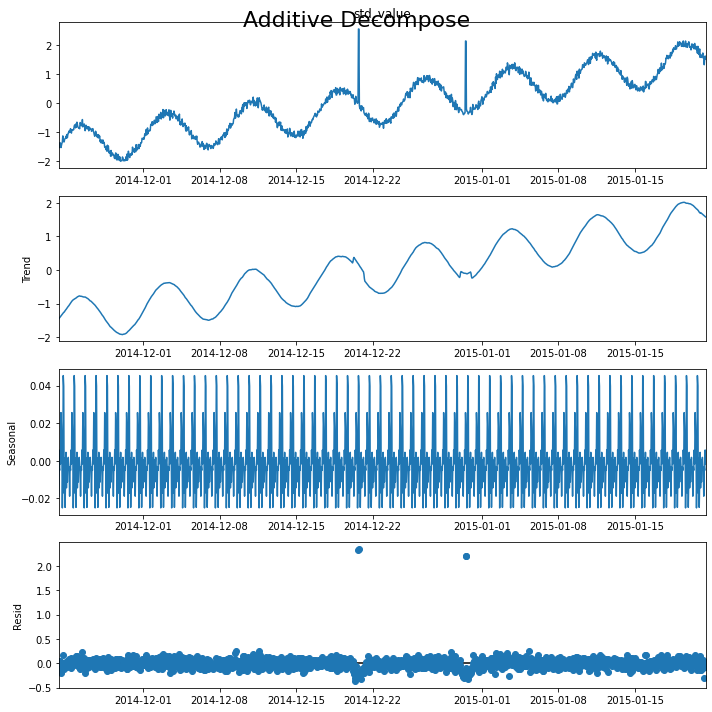


 13%|█▎        | 13/100 [00:13<01:31,  1.05s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 4
                           value  is_anomaly  std_value
timestamp                                              
2014-12-20 17:00:00  8470.624612           1   2.544810
2014-12-20 18:00:00  8470.624612           1   2.544810
2014-12-30 12:00:00  7612.932509           1   2.131365
2014-12-30 13:00:00  7612.932509           1   2.131365
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  2.321884
659 2014-12-20 18:00:00  2.351360
893 2014-12-30 12:00:00  2.202763
894 2014-12-30 13:00:00  2.214161
--------------------
Mean: 13721.578066, StandardDeviation: 8515.530982
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00     83.243795           0
1    2014-11-23 08:00:00     67.479998           0
2    2014-11-23 09:00:00    217.171281           0
3    2014-11-23 10:00:00    279.376786           0
4    2014-11-23 11:00:00    300.607742           0
...                  ...        

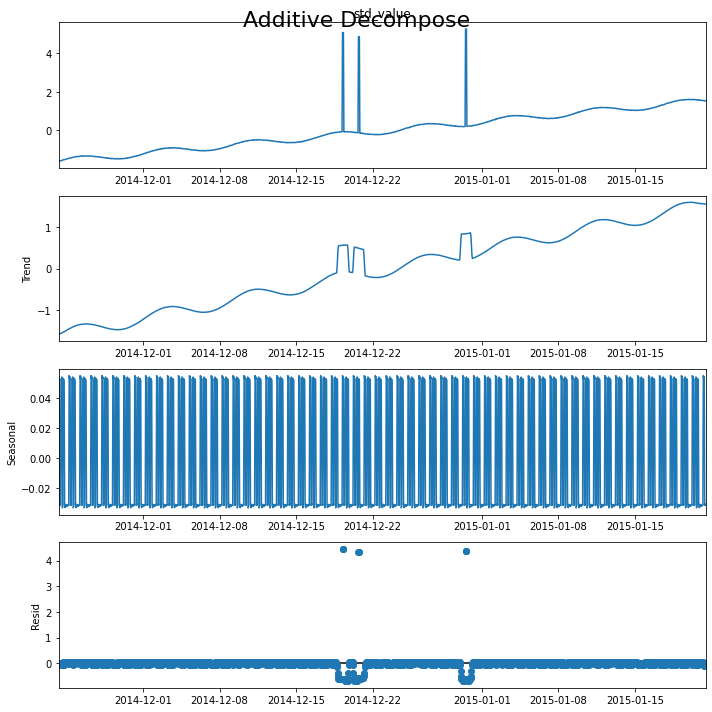


 14%|█▍        | 14/100 [00:14<01:28,  1.03s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 9
                            value  is_anomaly  std_value
timestamp                                               
2014-12-19 06:00:00  56936.569705           1   5.074844
2014-12-19 07:00:00  56936.569705           1   5.074844
2014-12-19 08:00:00  56936.569705           1   5.074844
2014-12-20 17:00:00  55144.032583           1   4.864342
2014-12-20 18:00:00  55144.032583           1   4.864342
2014-12-20 19:00:00  55144.032583           1   4.864342
2014-12-30 12:00:00  58525.873102           1   5.261480
2014-12-30 13:00:00  58525.873102           1   5.261480
2014-12-30 14:00:00  58525.873102           1   5.261480
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  4.453405
624 2014-12-19 07:00:00  4.454976
625 2014-12-19 08:00:00  4.452806
658 2014-12-20 17:00:00  4.315518
659 2014-12-20 18:00:00  4.319296
660 2014-12-20 19:00:00  4.323476
893 2014-12-30 12:00:00  4.368688
894 2014-12-30 13

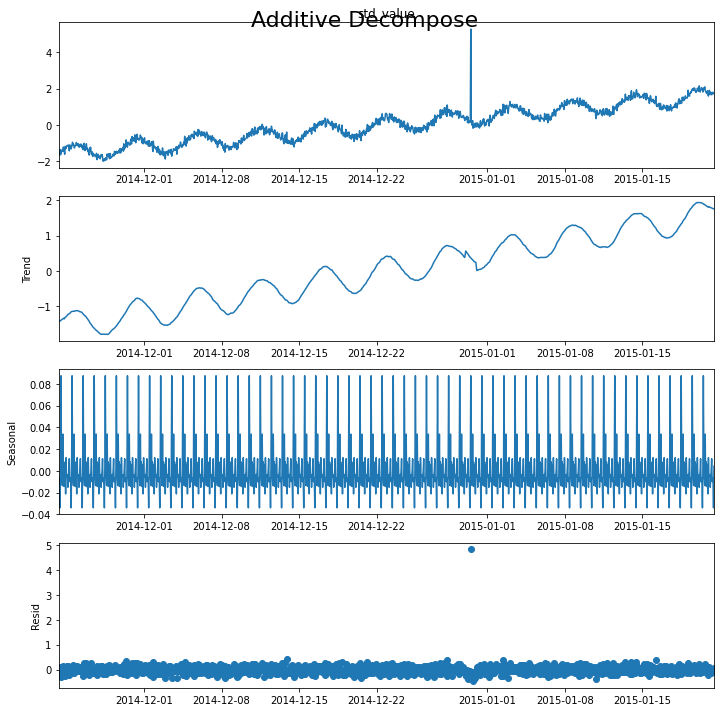


 15%|█▌        | 15/100 [00:15<01:29,  1.06s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 1
                            value  is_anomaly  std_value
timestamp                                               
2014-12-30 12:00:00  21968.419359           1   5.291048
Detected outliers: 1
Outliers:
              timestamp     resid
893 2014-12-30 12:00:00  4.835757
--------------------
Mean: 3224.960580, StandardDeviation: 2265.218133
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   523.484417           0
1    2014-11-23 08:00:00   -41.682913           0
2    2014-11-23 09:00:00   726.637150           0
3    2014-11-23 10:00:00   790.153547           0
4    2014-11-23 11:00:00   523.808007           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  6759.936378           0
1417 2015-01-21 08:00:00  5365.621180           0
1418 2015-01-21 09:00:00  6483.746059           0
1419 2015-01-21 10:00:00  7023.408042           0
1420 2015-01-21 11:00:00  6475.307367           0

[1421

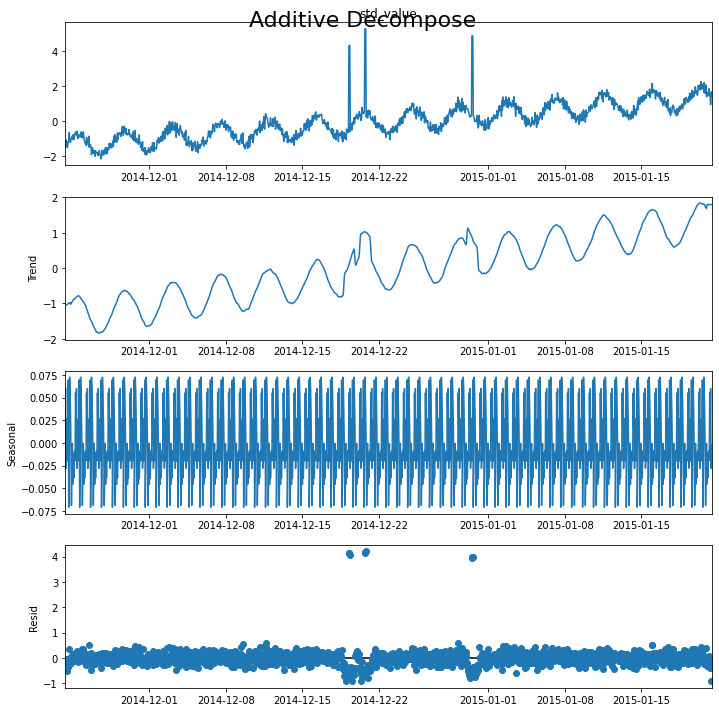


 16%|█▌        | 16/100 [00:16<01:27,  1.05s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 9
                            value  is_anomaly  std_value
timestamp                                               
2014-12-19 06:00:00  12989.167526           1   4.310493
2014-12-19 07:00:00  12989.167526           1   4.310493
2014-12-19 08:00:00  12989.167526           1   4.310493
2014-12-20 17:00:00  15126.731611           1   5.254139
2014-12-20 18:00:00  15126.731611           1   5.254139
2014-12-20 19:00:00  15126.731611           1   5.254139
2014-12-30 12:00:00  14219.817937           1   4.853774
2014-12-30 13:00:00  14219.817937           1   4.853774
2014-12-30 14:00:00  14219.817937           1   4.853774
Detected outliers: 12
Outliers:
              timestamp     resid
390 2014-12-09 13:00:00  0.546895
440 2014-12-11 15:00:00  0.600791
623 2014-12-19 06:00:00  4.150292
624 2014-12-19 07:00:00  4.157572
625 2014-12-19 08:00:00  4.077752
658 2014-12-20 17:00:00  4.149231
659 2014-12-20 18:00:00  4.173470
660 2014-12-20 1

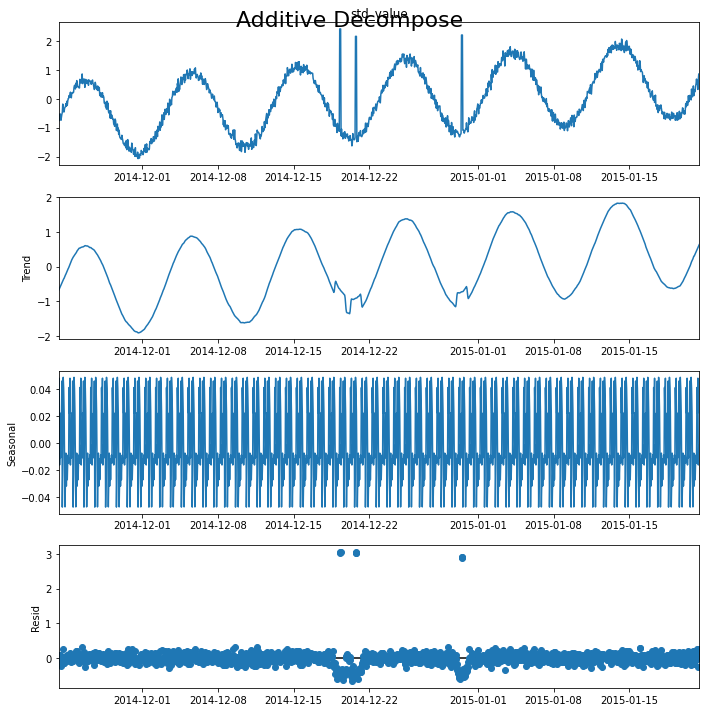


 17%|█▋        | 17/100 [00:17<01:26,  1.04s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 9
                           value  is_anomaly  std_value
timestamp                                              
2014-12-19 06:00:00  3341.560730           1   2.417565
2014-12-19 07:00:00  3341.560730           1   2.417565
2014-12-19 08:00:00  3341.560730           1   2.417565
2014-12-20 17:00:00  3070.390078           1   2.159464
2014-12-20 18:00:00  3070.390078           1   2.159464
2014-12-20 19:00:00  3070.390078           1   2.159464
2014-12-30 12:00:00  3118.860122           1   2.205598
2014-12-30 13:00:00  3118.860122           1   2.205598
2014-12-30 14:00:00  3118.860122           1   2.205598
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  3.024189
624 2014-12-19 07:00:00  3.066176
625 2014-12-19 08:00:00  3.059383
658 2014-12-20 17:00:00  3.023567
659 2014-12-20 18:00:00  3.029733
660 2014-12-20 19:00:00  3.042784
893 2014-12-30 12:00:00  2.911187
894 2014-12-30 13:00:00  2.9

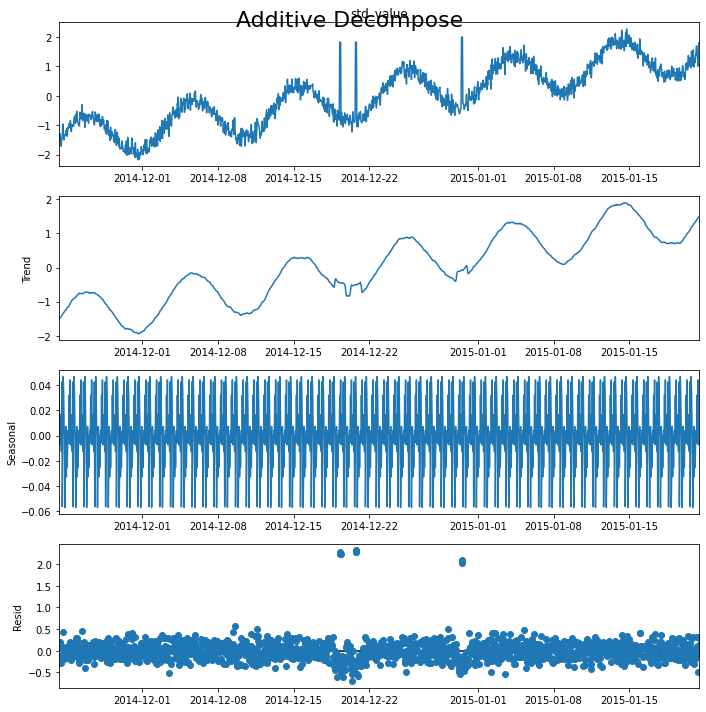


 18%|█▊        | 18/100 [00:18<01:25,  1.04s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 9
                           value  is_anomaly  std_value
timestamp                                              
2014-12-19 06:00:00  6387.282481           1   1.823968
2014-12-19 07:00:00  6387.282481           1   1.823968
2014-12-19 08:00:00  6387.282481           1   1.823968
2014-12-20 17:00:00  6376.335757           1   1.818159
2014-12-20 18:00:00  6376.335757           1   1.818159
2014-12-20 19:00:00  6376.335757           1   1.818159
2014-12-30 12:00:00  6708.892535           1   1.994622
2014-12-30 13:00:00  6708.892535           1   1.994622
2014-12-30 14:00:00  6708.892535           1   1.994622
Detected outliers: 11
Outliers:
              timestamp     resid
390 2014-12-09 13:00:00  0.571870
623 2014-12-19 06:00:00  2.227866
624 2014-12-19 07:00:00  2.269009
625 2014-12-19 08:00:00  2.234616
658 2014-12-20 17:00:00  2.271063
659 2014-12-20 18:00:00  2.287897
660 2014-12-20 19:00:00  2.317132
862 2014-12-29 05:00:00  0.

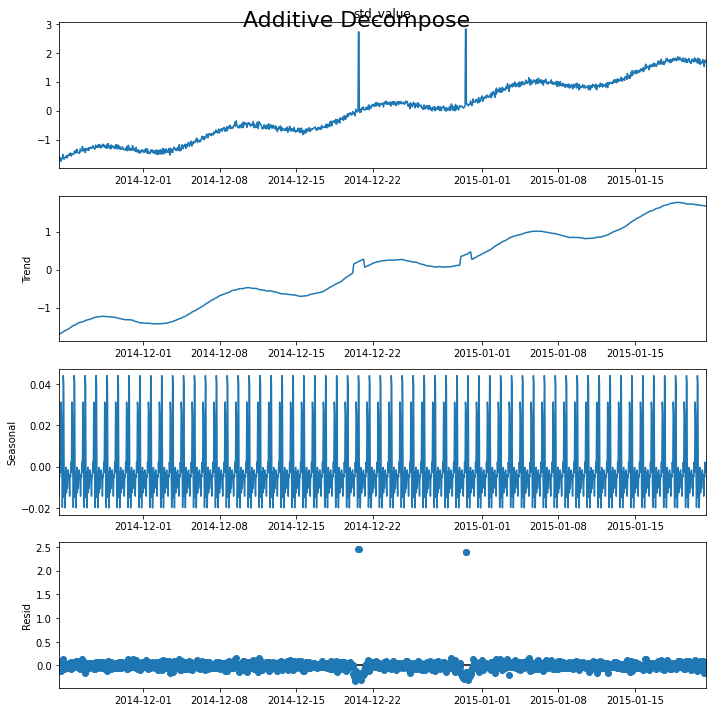


 19%|█▉        | 19/100 [00:19<01:23,  1.03s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 4
                            value  is_anomaly  std_value
timestamp                                               
2014-12-20 17:00:00  23827.991635           1   2.716944
2014-12-20 18:00:00  23827.991635           1   2.716944
2014-12-30 12:00:00  24372.452465           1   2.818085
2014-12-30 13:00:00  24372.452465           1   2.818085
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  2.459186
659 2014-12-20 18:00:00  2.459552
893 2014-12-30 12:00:00  2.391466
894 2014-12-30 13:00:00  2.393025
--------------------
Mean: 2615.639684, StandardDeviation: 1883.715525
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   371.131592           0
1    2014-11-23 08:00:00   -13.408767           0
2    2014-11-23 09:00:00   546.200543           0
3    2014-11-23 10:00:00   606.791435           0
4    2014-11-23 11:00:00   433.834773           0
...                  ...         

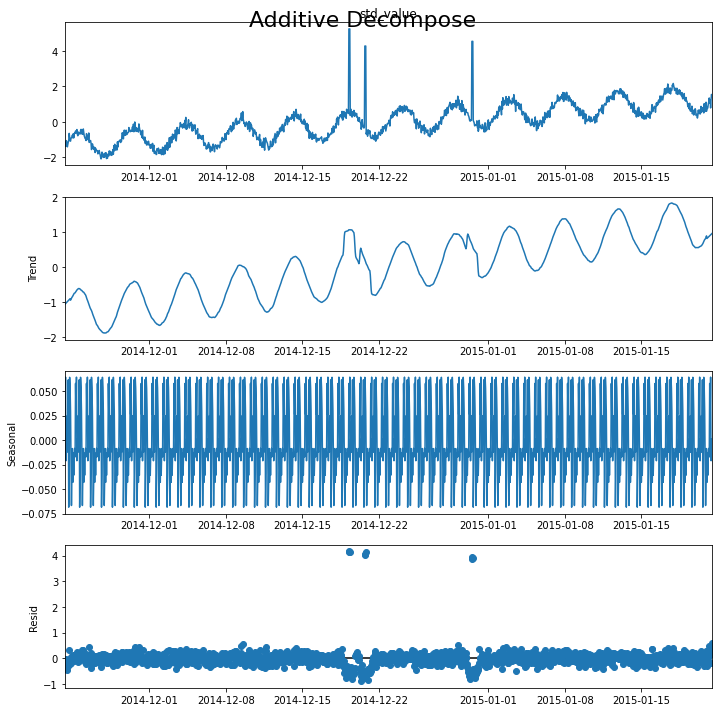


 20%|██        | 20/100 [00:20<01:22,  1.03s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 9
                            value  is_anomaly  std_value
timestamp                                               
2014-12-19 06:00:00  12528.936742           1   5.262630
2014-12-19 07:00:00  12528.936742           1   5.262630
2014-12-19 08:00:00  12528.936742           1   5.262630
2014-12-20 17:00:00  10700.383682           1   4.291913
2014-12-20 18:00:00  10700.383682           1   4.291913
2014-12-20 19:00:00  10700.383682           1   4.291913
2014-12-30 12:00:00  11201.104157           1   4.557729
2014-12-30 13:00:00  11201.104157           1   4.557729
2014-12-30 14:00:00  11201.104157           1   4.557729
Detected outliers: 12
Outliers:
               timestamp     resid
390  2014-12-09 13:00:00  0.553158
623  2014-12-19 06:00:00  4.132266
624  2014-12-19 07:00:00  4.167630
625  2014-12-19 08:00:00  4.130801
658  2014-12-20 17:00:00  4.011156
659  2014-12-20 18:00:00  4.062904
660  2014-12-20 19:00:00  4.124505
862  201

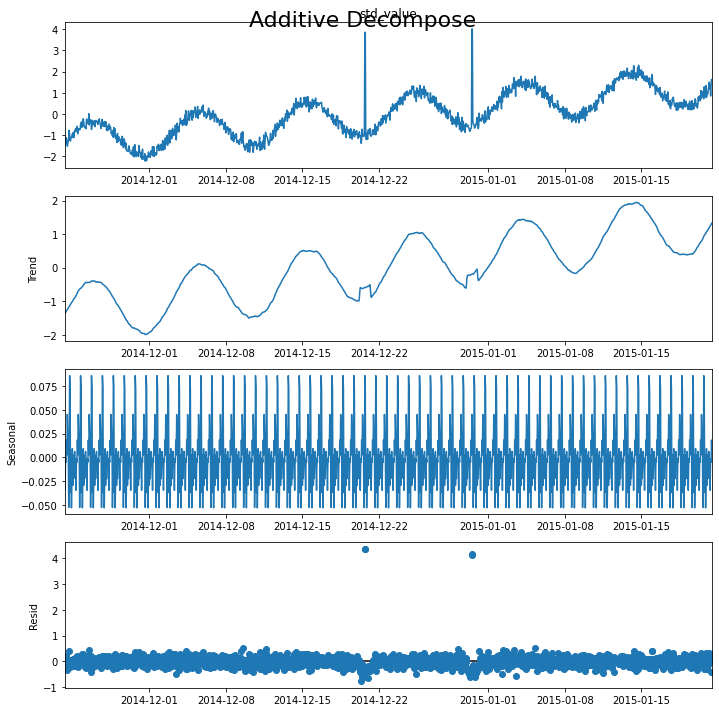


 21%|██        | 21/100 [00:22<01:24,  1.07s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 4
                           value  is_anomaly  std_value
timestamp                                              
2014-12-20 17:00:00  7972.116495           1   3.849825
2014-12-20 18:00:00  7972.116495           1   3.849825
2014-12-30 12:00:00  8210.758177           1   4.007059
2014-12-30 13:00:00  8210.758177           1   4.007059
Detected outliers: 6
Outliers:
               timestamp     resid
390  2014-12-09 13:00:00  0.511608
658  2014-12-20 17:00:00  4.351933
659  2014-12-20 18:00:00  4.367379
893  2014-12-30 12:00:00  4.152770
894  2014-12-30 13:00:00  4.167193
1032 2015-01-05 07:00:00  0.511715
--------------------
Mean: 4525.112368, StandardDeviation: 2816.829308
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00  -295.004142           0
1    2014-11-23 08:00:00   184.551308           0
2    2014-11-23 09:00:00  -216.117903           0
3    2014-11-23 10:00:00  1042.154905           0
4    2014-11-2

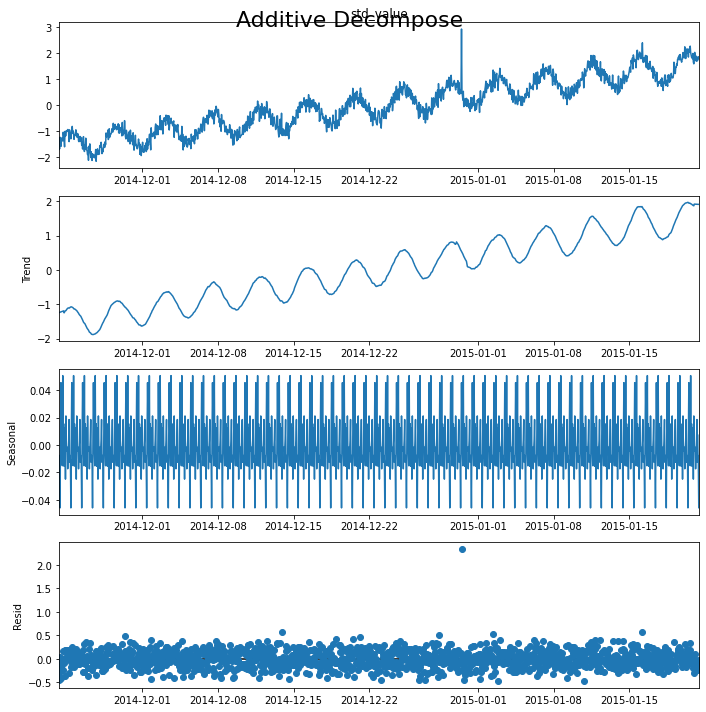


 22%|██▏       | 22/100 [00:23<01:22,  1.06s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 1
                            value  is_anomaly  std_value
timestamp                                               
2014-12-30 12:00:00  12752.431789           1   2.920773
Detected outliers: 5
Outliers:
               timestamp     resid
494  2014-12-13 21:00:00  0.571608
842  2014-12-28 09:00:00  0.509845
893  2014-12-30 12:00:00  2.336030
963  2015-01-02 10:00:00  0.518603
1294 2015-01-16 05:00:00  0.560662
--------------------
Mean: 1594.302942, StandardDeviation: 1417.078635
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00  -355.457640           0
1    2014-11-23 08:00:00   146.519083           0
2    2014-11-23 09:00:00  -396.100127           0
3    2014-11-23 10:00:00  1031.281848           0
4    2014-11-23 11:00:00   347.779642           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  3077.970205           0
1417 2015-01-21 08:00:00  3697.239160           0
1418 2015-01-2

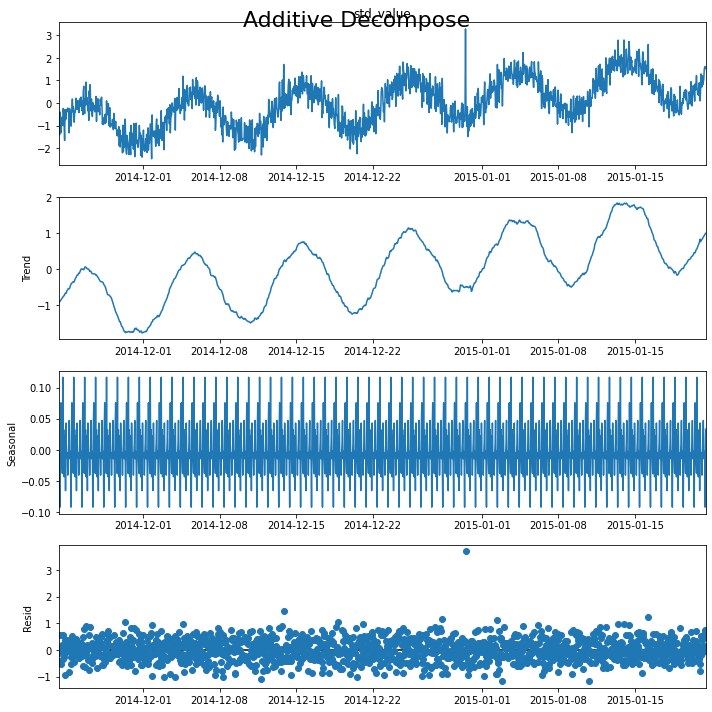


 23%|██▎       | 23/100 [00:24<01:21,  1.05s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 1
                           value  is_anomaly  std_value
timestamp                                              
2014-12-30 12:00:00  6253.308114           1   3.287753
Detected outliers: 161
Outliers:
               timestamp     resid
3    2014-11-23 10:00:00  0.576472
10   2014-11-23 17:00:00  0.551433
30   2014-11-24 13:00:00  0.512823
55   2014-11-25 14:00:00  0.766754
60   2014-11-25 19:00:00  0.913069
...                  ...       ...
1400 2015-01-20 15:00:00  0.702577
1410 2015-01-21 01:00:00  0.512485
1417 2015-01-21 08:00:00  0.549978
1418 2015-01-21 09:00:00  0.647276
1419 2015-01-21 10:00:00  0.730777

[161 rows x 2 columns]
--------------------
Mean: 7244.356891, StandardDeviation: 4338.899363
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00     36.563293           0
1    2014-11-23 08:00:00     96.810192           0
2    2014-11-23 09:00:00    224.908580           0
3    2014-11-23 10:00:00   

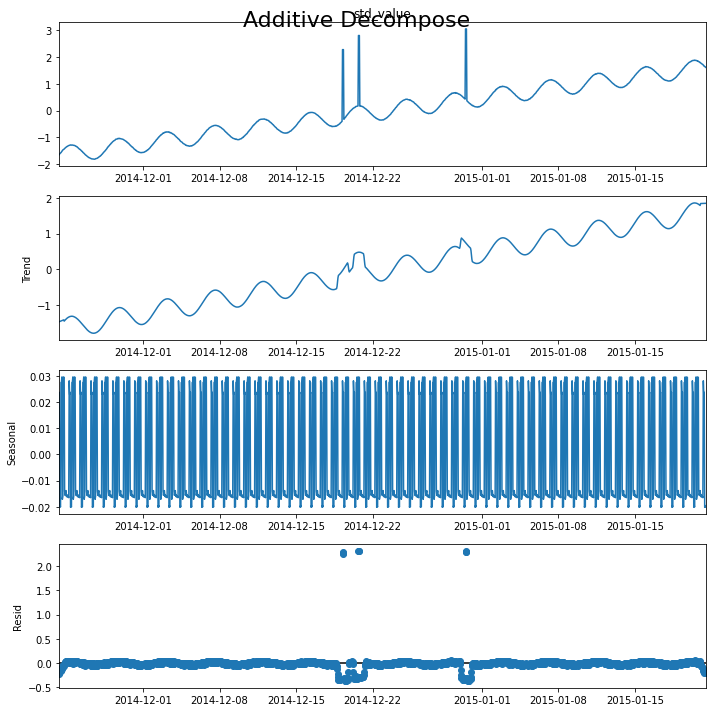


 24%|██▍       | 24/100 [00:25<01:19,  1.04s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 9
                            value  is_anomaly  std_value
timestamp                                               
2014-12-19 06:00:00  17152.953898           1   2.283666
2014-12-19 07:00:00  17152.953898           1   2.283666
2014-12-19 08:00:00  17152.953898           1   2.283666
2014-12-20 17:00:00  19441.549373           1   2.811126
2014-12-20 18:00:00  19441.549373           1   2.811126
2014-12-20 19:00:00  19441.549373           1   2.811126
2014-12-30 12:00:00  20511.199658           1   3.057652
2014-12-30 13:00:00  20511.199658           1   3.057652
2014-12-30 14:00:00  20511.199658           1   3.057652
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  2.289370
624 2014-12-19 07:00:00  2.276430
625 2014-12-19 08:00:00  2.256899
658 2014-12-20 17:00:00  2.301343
659 2014-12-20 18:00:00  2.300645
660 2014-12-20 19:00:00  2.300668
893 2014-12-30 12:00:00  2.281183
894 2014-12-30 13

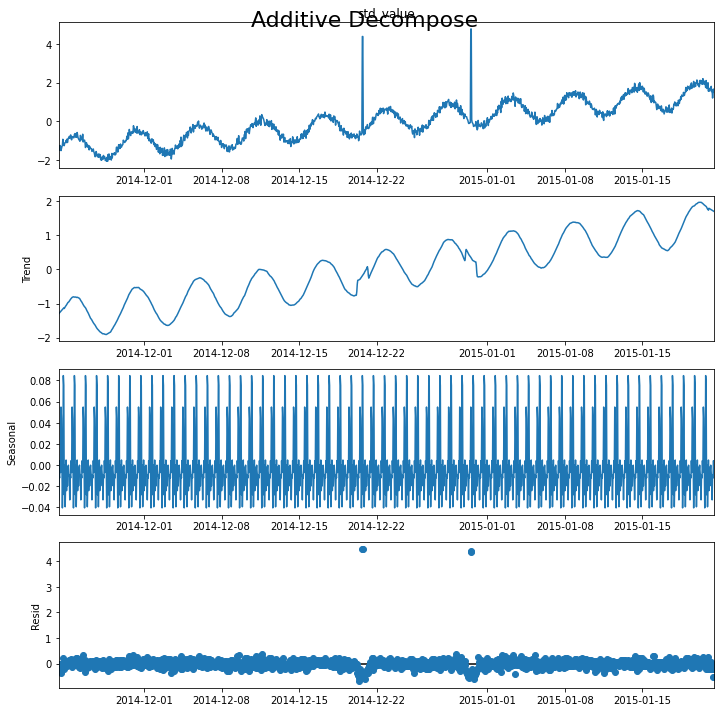


 25%|██▌       | 25/100 [00:26<01:17,  1.04s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 4
                            value  is_anomaly  std_value
timestamp                                               
2014-12-20 17:00:00  12575.790049           1   4.382979
2014-12-20 18:00:00  12575.790049           1   4.382979
2014-12-30 12:00:00  13405.000517           1   4.771106
2014-12-30 13:00:00  13405.000517           1   4.771106
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  4.479447
659 2014-12-20 18:00:00  4.473660
893 2014-12-30 12:00:00  4.357858
894 2014-12-30 13:00:00  4.392092
--------------------
Mean: 1428.809330, StandardDeviation: 1357.598995
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00  -336.894181           0
1    2014-11-23 08:00:00   177.687052           0
2    2014-11-23 09:00:00  -297.629814           0
3    2014-11-23 10:00:00  1093.183161           0
4    2014-11-23 11:00:00   483.465000           0
...                  ...         

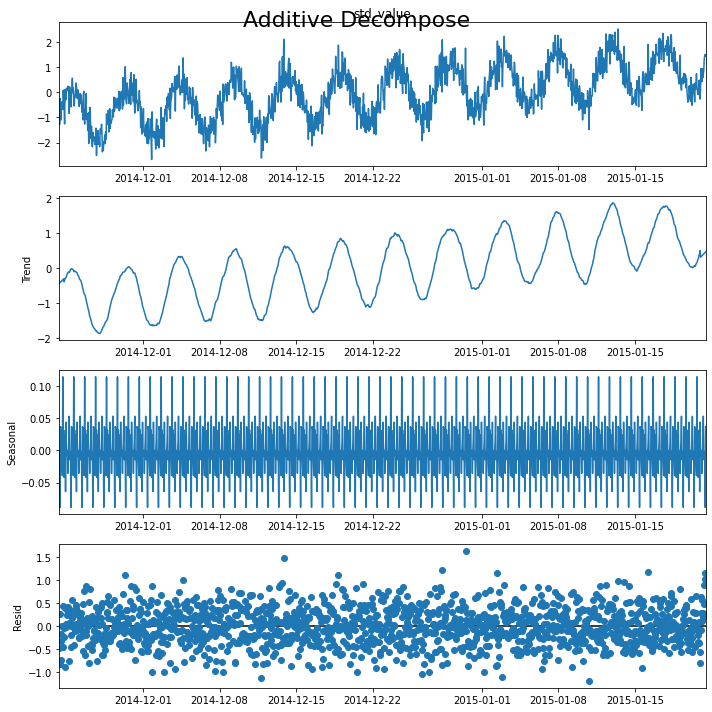


 26%|██▌       | 26/100 [00:27<01:17,  1.05s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 1
                          value  is_anomaly  std_value
timestamp                                             
2014-12-30 12:00:00  3827.43138           1   1.766812
Detected outliers: 154
Outliers:
               timestamp     resid
30   2014-11-24 13:00:00  0.566711
55   2014-11-25 14:00:00  0.759244
60   2014-11-25 19:00:00  0.882254
67   2014-11-26 02:00:00  0.517630
69   2014-11-26 04:00:00  0.812229
...                  ...       ...
1413 2015-01-21 04:00:00  0.574937
1417 2015-01-21 08:00:00  0.902307
1418 2015-01-21 09:00:00  1.032833
1419 2015-01-21 10:00:00  1.149986
1420 2015-01-21 11:00:00  0.946153

[154 rows x 2 columns]
--------------------
Mean: 14842.931340, StandardDeviation: 8603.286780
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00    -55.029096           0
1    2014-11-23 08:00:00    110.216118           0
2    2014-11-23 09:00:00     54.056522           0
3    2014-11-23 10:00:00    4

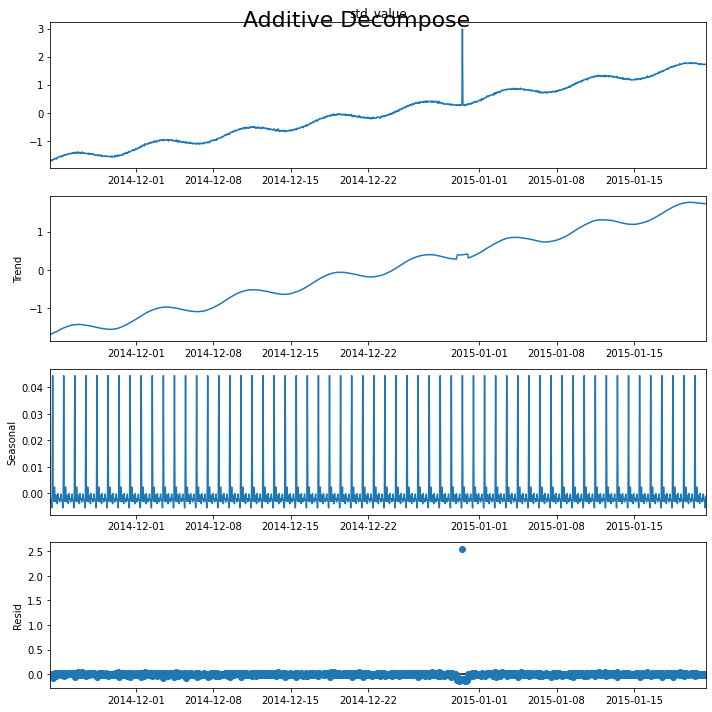


 27%|██▋       | 27/100 [00:28<01:17,  1.06s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 1
                            value  is_anomaly  std_value
timestamp                                               
2014-12-30 12:00:00  40527.023374           1   2.985381
Detected outliers: 1
Outliers:
              timestamp     resid
893 2014-12-30 12:00:00  2.549133
--------------------
Mean: 7829.968809, StandardDeviation: 4650.424410
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00    -46.063862           0
1    2014-11-23 08:00:00    122.176998           0
2    2014-11-23 09:00:00    123.647135           0
3    2014-11-23 10:00:00    438.488564           0
4    2014-11-23 11:00:00    416.041729           0
...                  ...           ...         ...
1416 2015-01-21 07:00:00  15844.827886           0
1417 2015-01-21 08:00:00  15866.412923           0
1418 2015-01-21 09:00:00  15813.216385           0
1419 2015-01-21 10:00:00  15739.964143           0
1420 2015-01-21 11:00:00  15639.714570       

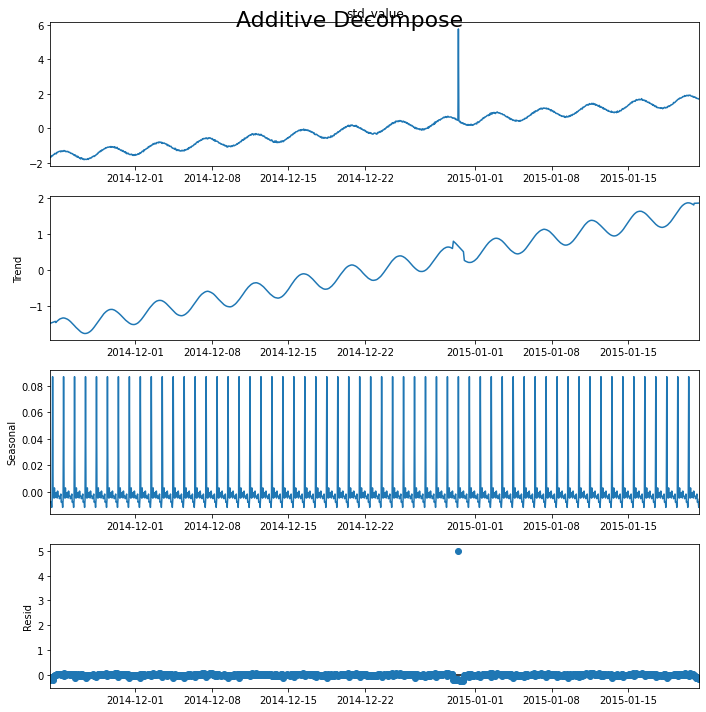


 28%|██▊       | 28/100 [00:29<01:14,  1.04s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 1
                            value  is_anomaly  std_value
timestamp                                               
2014-12-30 12:00:00  34633.495867           1   5.763673
Detected outliers: 1
Outliers:
              timestamp     resid
893 2014-12-30 12:00:00  5.016235
--------------------
Mean: 677.021695, StandardDeviation: 1078.857833
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   330.577449           0
1    2014-11-23 08:00:00    -8.952793           0
2    2014-11-23 09:00:00   498.310024           0
3    2014-11-23 10:00:00   557.956500           0
4    2014-11-23 11:00:00   408.067961           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  1159.791552           0
1417 2015-01-21 08:00:00   397.486829           0
1418 2015-01-21 09:00:00  1231.864469           0
1419 2015-01-21 10:00:00  1699.693308           0
1420 2015-01-21 11:00:00  1477.151920           0

[1421 

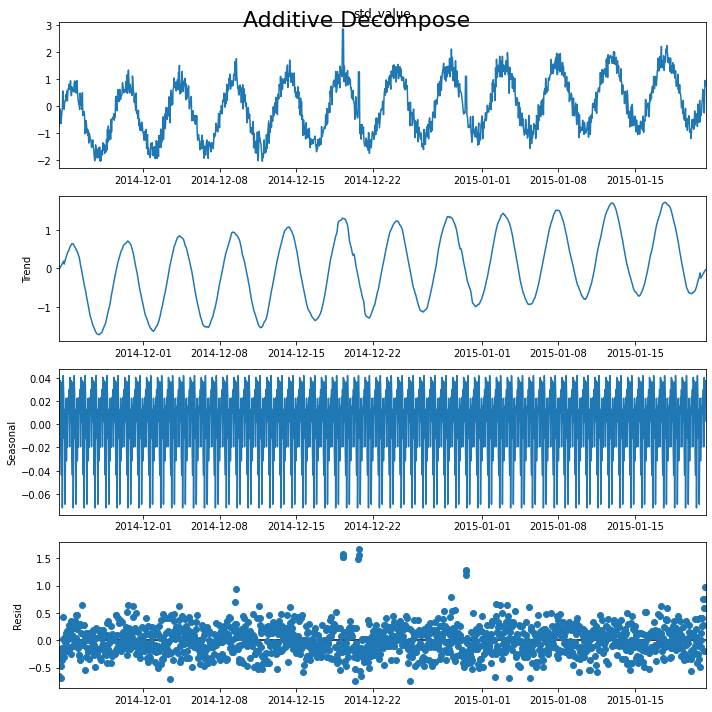


 29%|██▉       | 29/100 [00:30<01:14,  1.05s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 9
                           value  is_anomaly  std_value
timestamp                                              
2014-12-19 06:00:00  3755.844471           1   2.853780
2014-12-19 07:00:00  3755.844471           1   2.853780
2014-12-19 08:00:00  3755.844471           1   2.853780
2014-12-20 17:00:00  2041.956620           1   1.265167
2014-12-20 18:00:00  2041.956620           1   1.265167
2014-12-20 19:00:00  2041.956620           1   1.265167
2014-12-30 12:00:00  1865.879092           1   1.101959
2014-12-30 13:00:00  1865.879092           1   1.101959
2014-12-30 14:00:00  1865.879092           1   1.101959
Detected outliers: 39
Outliers:
               timestamp     resid
52   2014-11-25 11:00:00  0.649922
150  2014-11-29 13:00:00  0.509870
153  2014-11-29 16:00:00  0.651173
162  2014-11-30 01:00:00  0.631780
265  2014-12-04 08:00:00  0.620682
387  2014-12-09 10:00:00  0.691914
390  2014-12-09 13:00:00  0.935120
440  2014-12-11 15:

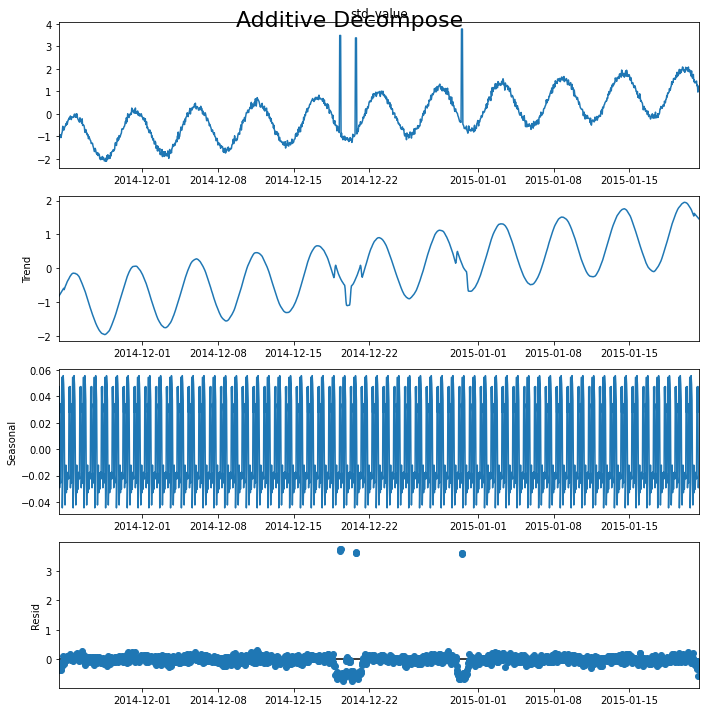


 30%|███       | 30/100 [00:31<01:13,  1.04s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 9
                           value  is_anomaly  std_value
timestamp                                              
2014-12-19 06:00:00  6424.119302           1   3.480926
2014-12-19 07:00:00  6424.119302           1   3.480926
2014-12-19 08:00:00  6424.119302           1   3.480926
2014-12-20 17:00:00  6273.705277           1   3.372082
2014-12-20 18:00:00  6273.705277           1   3.372082
2014-12-20 19:00:00  6273.705277           1   3.372082
2014-12-30 12:00:00  6819.510433           1   3.767044
2014-12-30 13:00:00  6819.510433           1   3.767044
2014-12-30 14:00:00  6819.510433           1   3.767044
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  3.688824
624 2014-12-19 07:00:00  3.741715
625 2014-12-19 08:00:00  3.751663
658 2014-12-20 17:00:00  3.638748
659 2014-12-20 18:00:00  3.617800
660 2014-12-20 19:00:00  3.600371
893 2014-12-30 12:00:00  3.575888
894 2014-12-30 13:00:00  3.6

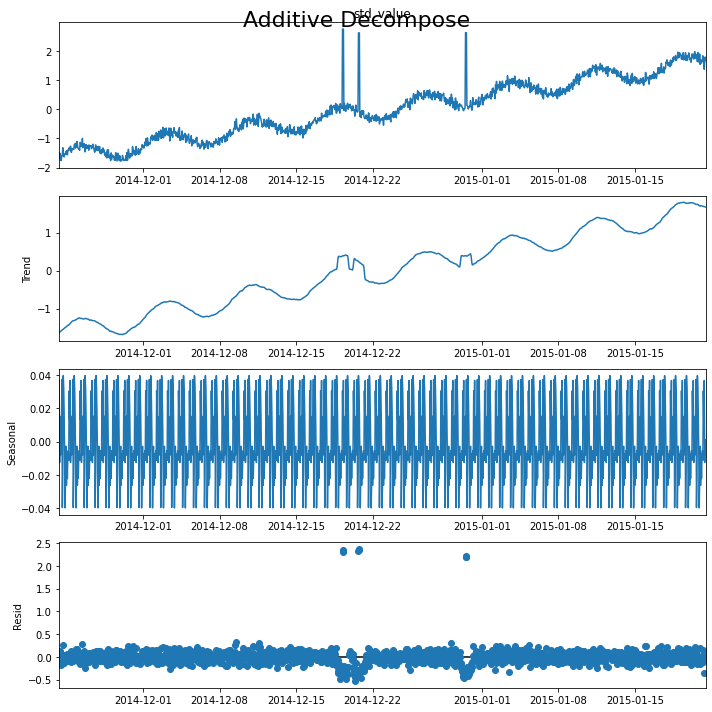


 31%|███       | 31/100 [00:32<01:12,  1.05s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 9
                            value  is_anomaly  std_value
timestamp                                               
2014-12-19 06:00:00  19764.788448           1   2.742542
2014-12-19 07:00:00  19764.788448           1   2.742542
2014-12-19 08:00:00  19764.788448           1   2.742542
2014-12-20 17:00:00  19171.650587           1   2.610071
2014-12-20 18:00:00  19171.650587           1   2.610071
2014-12-20 19:00:00  19171.650587           1   2.610071
2014-12-30 12:00:00  19198.499714           1   2.616068
2014-12-30 13:00:00  19198.499714           1   2.616068
2014-12-30 14:00:00  19198.499714           1   2.616068
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  2.322403
624 2014-12-19 07:00:00  2.340990
625 2014-12-19 08:00:00  2.316033
658 2014-12-20 17:00:00  2.325908
659 2014-12-20 18:00:00  2.346658
660 2014-12-20 19:00:00  2.374863
893 2014-12-30 12:00:00  2.207397
894 2014-12-30 13

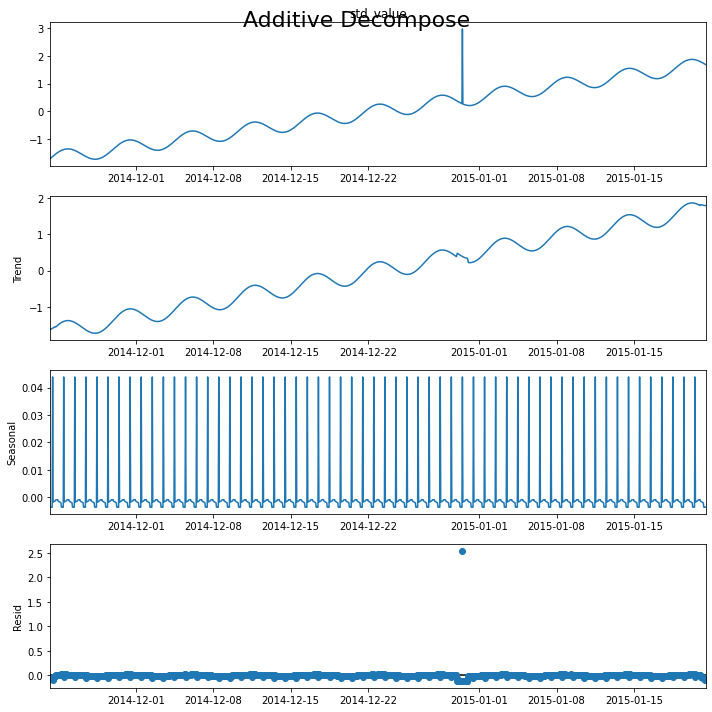


 32%|███▏      | 32/100 [00:33<01:09,  1.02s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 1
                            value  is_anomaly  std_value
timestamp                                               
2014-12-30 12:00:00  24918.563513           1   2.971187
Detected outliers: 1
Outliers:
              timestamp     resid
893 2014-12-30 12:00:00  2.538143
--------------------
Mean: 2534.131404, StandardDeviation: 1760.471141
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00    93.063930           0
1    2014-11-23 08:00:00    11.500044           0
2    2014-11-23 09:00:00   160.335747           0
3    2014-11-23 10:00:00   187.497770           0
4    2014-11-23 11:00:00   157.796984           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  4951.913174           0
1417 2015-01-21 08:00:00  4700.000458           0
1418 2015-01-21 09:00:00  4882.230876           0
1419 2015-01-21 10:00:00  4964.612907           0
1420 2015-01-21 11:00:00  4859.125051           0

[1421

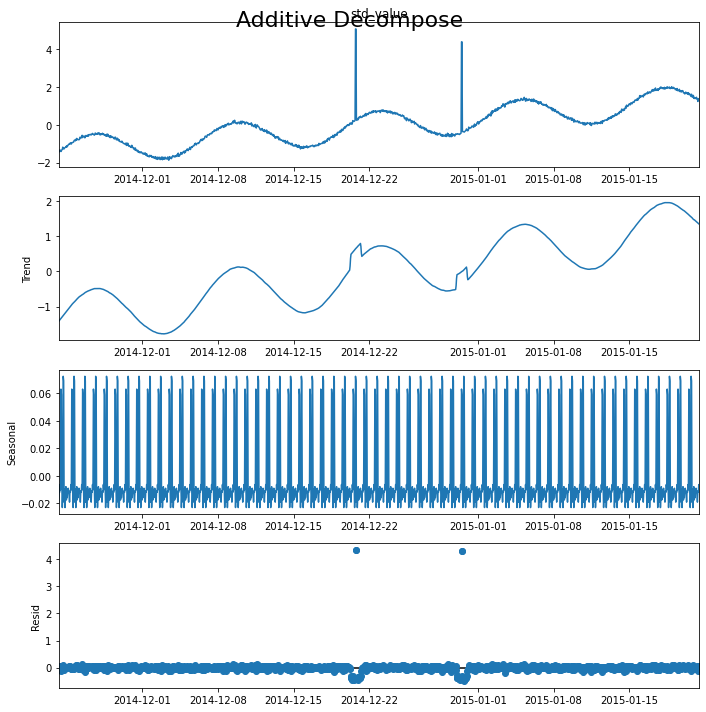


 33%|███▎      | 33/100 [00:34<01:09,  1.04s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 4
                            value  is_anomaly  std_value
timestamp                                               
2014-12-20 17:00:00  11436.755332           1   5.056955
2014-12-20 18:00:00  11436.755332           1   5.056955
2014-12-30 12:00:00  10240.079234           1   4.377208
2014-12-30 13:00:00  10240.079234           1   4.377208
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  4.348569
659 2014-12-20 18:00:00  4.338888
893 2014-12-30 12:00:00  4.327391
894 2014-12-30 13:00:00  4.322832
--------------------
Mean: 9755.358345, StandardDeviation: 5869.980223
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00    103.211620           0
1    2014-11-23 08:00:00     68.942007           0
2    2014-11-23 09:00:00    264.942708           0
3    2014-11-23 10:00:00    339.011479           0
4    2014-11-23 11:00:00    355.830810           0
...                  ...   

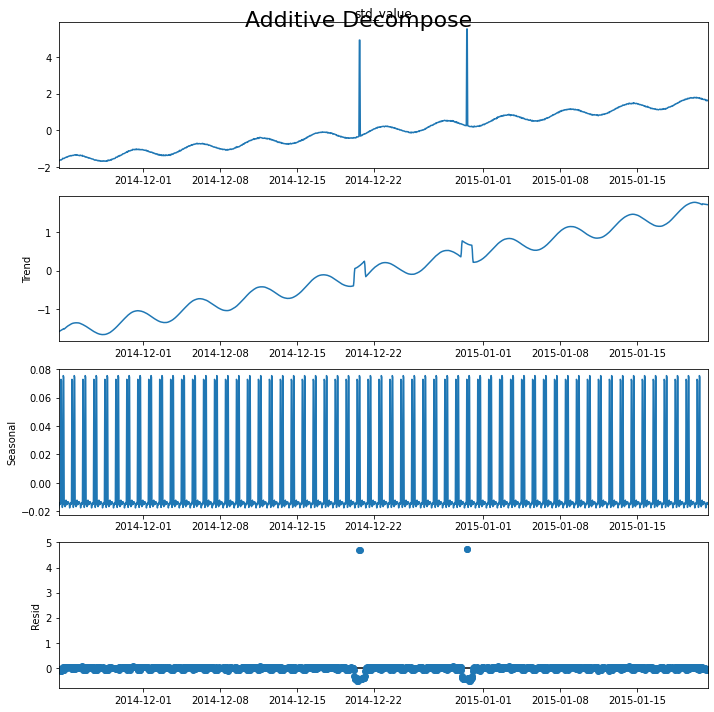


 34%|███▍      | 34/100 [00:35<01:08,  1.04s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 4
                            value  is_anomaly  std_value
timestamp                                               
2014-12-20 17:00:00  38555.070565           1   4.906271
2014-12-20 18:00:00  38555.070565           1   4.906271
2014-12-30 12:00:00  42089.248005           1   5.508347
2014-12-30 13:00:00  42089.248005           1   5.508347
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  4.705997
659 2014-12-20 18:00:00  4.698244
893 2014-12-30 12:00:00  4.735452
894 2014-12-30 13:00:00  4.742644
--------------------
Mean: 691.874740, StandardDeviation: 1044.758674
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00  -112.413242           0
1    2014-11-23 08:00:00    72.353010           0
2    2014-11-23 09:00:00   -74.022732           0
3    2014-11-23 10:00:00   404.031983           0
4    2014-11-23 11:00:00   212.908671           0
...                  ...          

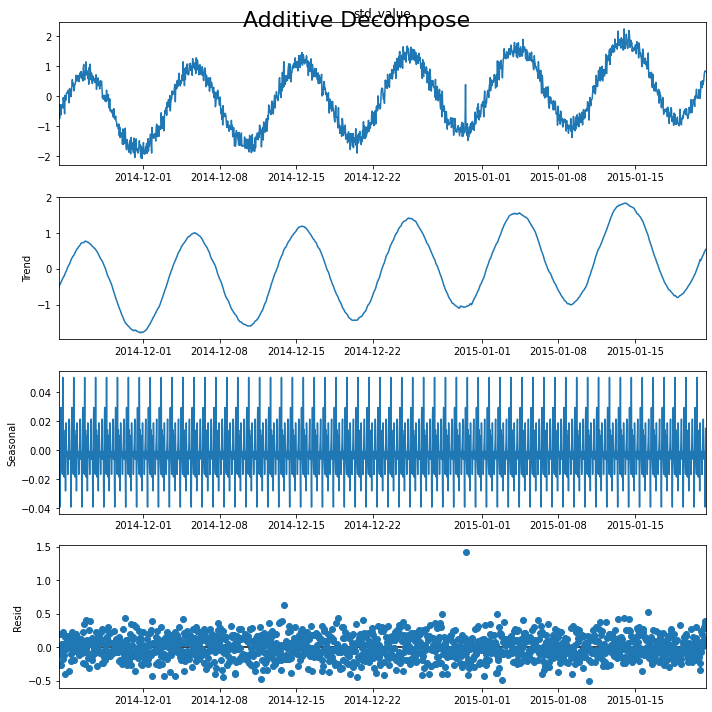


 35%|███▌      | 35/100 [00:36<01:07,  1.04s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 1
                           value  is_anomaly  std_value
timestamp                                              
2014-12-30 12:00:00  1103.506781           1   0.393997
Detected outliers: 4
Outliers:
               timestamp     resid
494  2014-12-13 21:00:00  0.634554
842  2014-12-28 09:00:00  0.500979
893  2014-12-30 12:00:00  1.424752
1294 2015-01-16 05:00:00  0.531650
--------------------
Mean: 11436.166506, StandardDeviation: 6711.247441
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00   -116.188401           0
1    2014-11-23 08:00:00    135.756293           0
2    2014-11-23 09:00:00      1.563787           0
3    2014-11-23 10:00:00    595.079198           0
4    2014-11-23 11:00:00    408.174848           0
...                  ...           ...         ...
1416 2015-01-21 07:00:00  22936.663985           0
1417 2015-01-21 08:00:00  23102.808131           0
1418 2015-01-21 09:00:00  23097.201874    

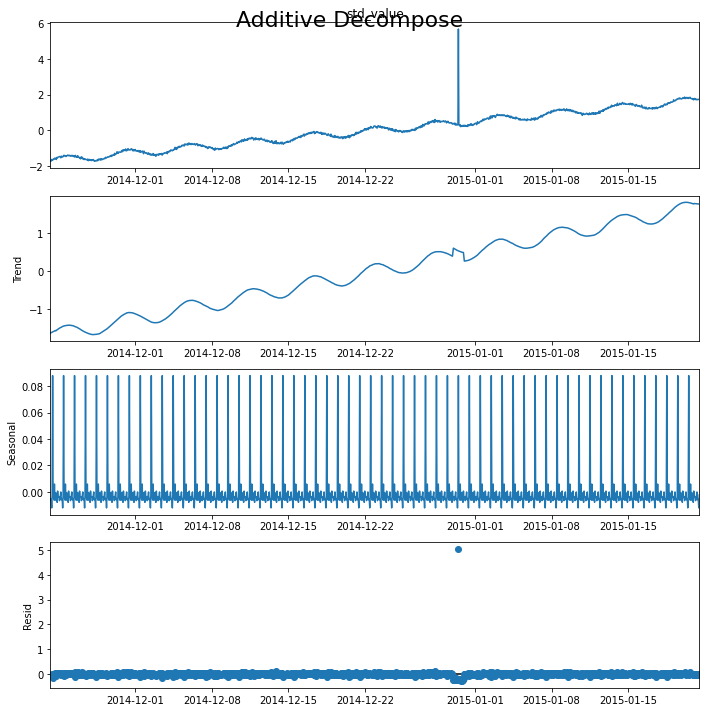


 36%|███▌      | 36/100 [00:37<01:05,  1.02s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 1
                            value  is_anomaly  std_value
timestamp                                               
2014-12-30 12:00:00  49410.638667           1   5.658333
Detected outliers: 1
Outliers:
              timestamp     resid
893 2014-12-30 12:00:00  5.038939
--------------------
Mean: 22214.673041, StandardDeviation: 12919.228619
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00     11.616457           0
1    2014-11-23 08:00:00     95.640255           0
2    2014-11-23 09:00:00    122.942561           0
3    2014-11-23 10:00:00    257.178391           0
4    2014-11-23 11:00:00    276.783930           0
...                  ...           ...         ...
1416 2015-01-21 07:00:00  44092.404981           0
1417 2015-01-21 08:00:00  44127.122946           0
1418 2015-01-21 09:00:00  44136.635975           0
1419 2015-01-21 10:00:00  44139.497508           0
1420 2015-01-21 11:00:00  44133.252661     

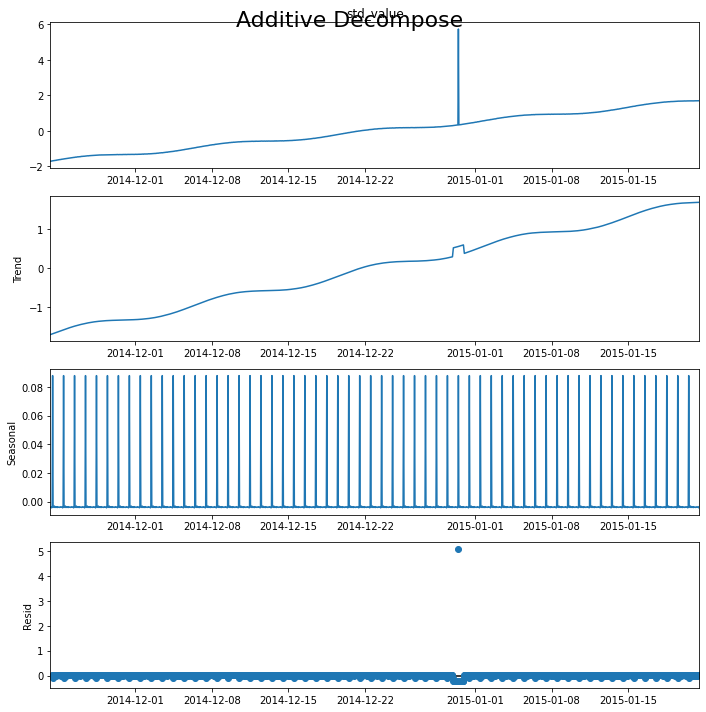


 37%|███▋      | 37/100 [00:38<01:03,  1.02s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 1
                            value  is_anomaly  std_value
timestamp                                               
2014-12-30 12:00:00  96377.011822           1   5.740462
Detected outliers: 1
Outliers:
              timestamp     resid
893 2014-12-30 12:00:00  5.093057
--------------------
Mean: 1844.380800, StandardDeviation: 1439.541406
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   546.917923           0
1    2014-11-23 08:00:00   -98.273553           0
2    2014-11-23 09:00:00   655.198714           0
3    2014-11-23 10:00:00   670.142109           0
4    2014-11-23 11:00:00   340.026865           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  3702.084830           0
1417 2015-01-21 08:00:00  2360.661637           0
1418 2015-01-21 09:00:00  3654.950361           0
1419 2015-01-21 10:00:00  4343.303685           0
1420 2015-01-21 11:00:00  3891.300700           0

[1421

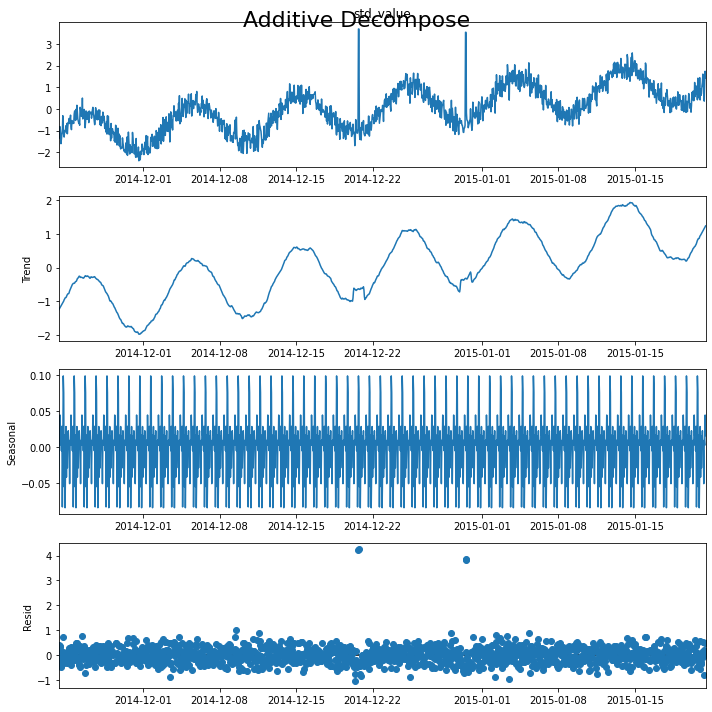


 38%|███▊      | 38/100 [00:39<01:03,  1.02s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 4
                          value  is_anomaly  std_value
timestamp                                             
2014-12-20 17:00:00  7147.29409           1   3.683752
2014-12-20 18:00:00  7147.29409           1   3.683752
2014-12-30 12:00:00  6928.65843           1   3.531873
2014-12-30 13:00:00  6928.65843           1   3.531873
Detected outliers: 65
Outliers:
               timestamp     resid
9    2014-11-23 16:00:00  0.743840
52   2014-11-25 11:00:00  0.785061
153  2014-11-29 16:00:00  0.684954
162  2014-11-30 01:00:00  0.692369
170  2014-11-30 09:00:00  0.552166
...                  ...       ...
1376 2015-01-19 15:00:00  0.501601
1396 2015-01-20 11:00:00  0.586694
1403 2015-01-20 18:00:00  0.507607
1407 2015-01-20 22:00:00  0.556166
1414 2015-01-21 05:00:00  0.518693

[65 rows x 2 columns]
--------------------
Mean: 2873.685166, StandardDeviation: 1957.027297
               timestamp        value  is_anomaly
0    2014-11-23 07:00

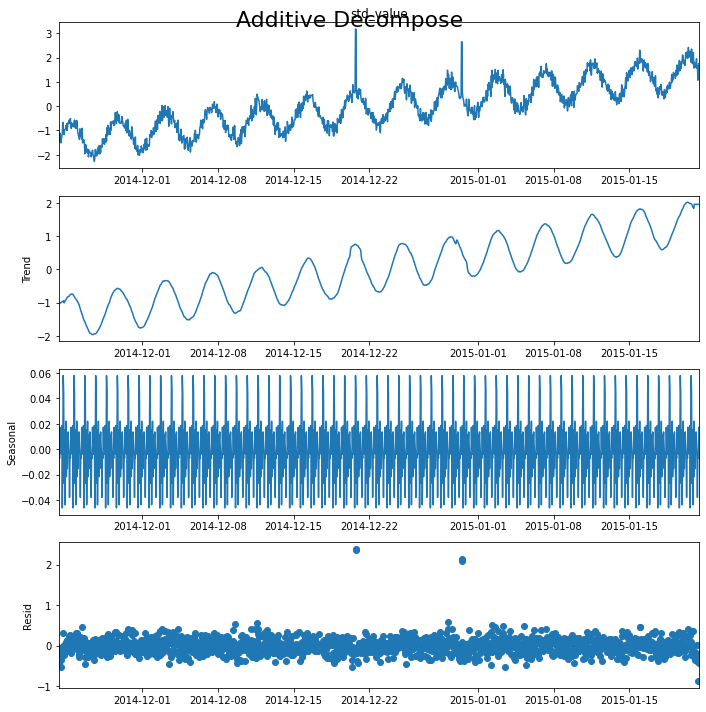


 39%|███▉      | 39/100 [00:40<01:05,  1.07s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 4
                           value  is_anomaly  std_value
timestamp                                              
2014-12-20 17:00:00  9088.466267           1   3.175623
2014-12-20 18:00:00  9088.466267           1   3.175623
2014-12-30 12:00:00  8056.499950           1   2.648310
2014-12-30 13:00:00  8056.499950           1   2.648310
Detected outliers: 8
Outliers:
              timestamp     resid
390 2014-12-09 13:00:00  0.528567
440 2014-12-11 15:00:00  0.564329
658 2014-12-20 17:00:00  2.363915
659 2014-12-20 18:00:00  2.387377
862 2014-12-29 05:00:00  0.569166
893 2014-12-30 12:00:00  2.076552
894 2014-12-30 13:00:00  2.133641
961 2015-01-02 08:00:00  0.513981
--------------------
Mean: 8016.500290, StandardDeviation: 5055.484515
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00    302.753961           0
1    2014-11-23 08:00:00     30.241723           0
2    2014-11-23 09:00:00    507.077230           0

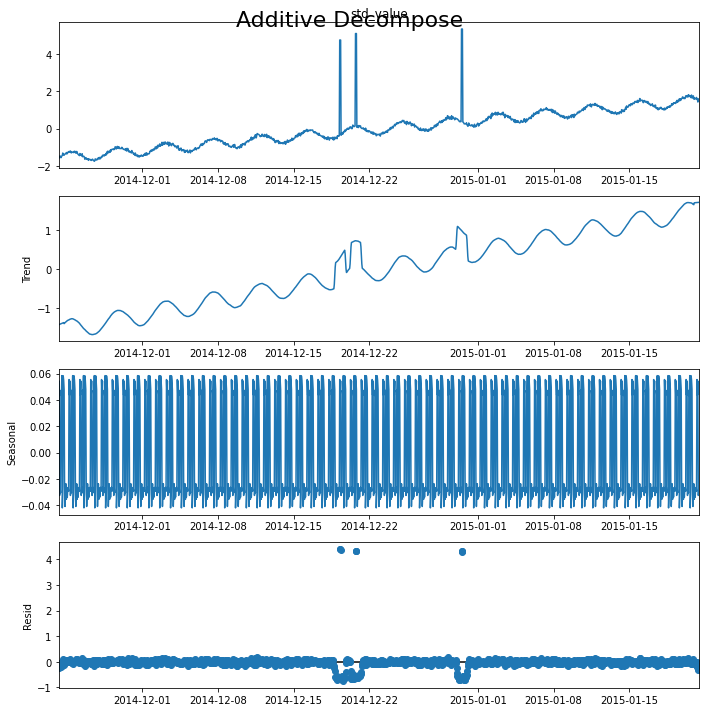


 40%|████      | 40/100 [00:41<01:03,  1.06s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 9
                            value  is_anomaly  std_value
timestamp                                               
2014-12-19 06:00:00  32038.128350           1   4.751598
2014-12-19 07:00:00  32038.128350           1   4.751598
2014-12-19 08:00:00  32038.128350           1   4.751598
2014-12-20 17:00:00  33799.505156           1   5.100007
2014-12-20 18:00:00  33799.505156           1   5.100007
2014-12-20 19:00:00  33799.505156           1   5.100007
2014-12-30 12:00:00  35024.510337           1   5.342319
2014-12-30 13:00:00  35024.510337           1   5.342319
2014-12-30 14:00:00  35024.510337           1   5.342319
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  4.409363
624 2014-12-19 07:00:00  4.405732
625 2014-12-19 08:00:00  4.377959
658 2014-12-20 17:00:00  4.314393
659 2014-12-20 18:00:00  4.319187
660 2014-12-20 19:00:00  4.327791
893 2014-12-30 12:00:00  4.304559
894 2014-12-30 13

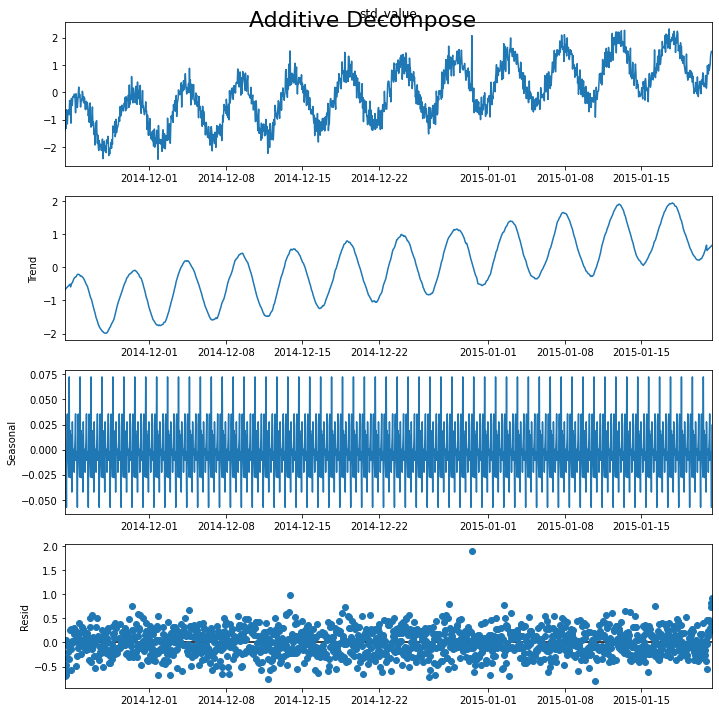


 41%|████      | 41/100 [00:42<01:02,  1.06s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 1
                           value  is_anomaly  std_value
timestamp                                              
2014-12-30 12:00:00  4586.546664           1   2.072946
Detected outliers: 51
Outliers:
               timestamp     resid
55   2014-11-25 14:00:00  0.500673
60   2014-11-25 19:00:00  0.573464
69   2014-11-26 04:00:00  0.516270
146  2014-11-29 09:00:00  0.745202
159  2014-11-29 22:00:00  0.592770
165  2014-11-30 04:00:00  0.568407
170  2014-11-30 09:00:00  0.515306
205  2014-12-01 20:00:00  0.549897
264  2014-12-04 07:00:00  0.501145
273  2014-12-04 16:00:00  0.673513
349  2014-12-07 20:00:00  0.505481
379  2014-12-09 02:00:00  0.551980
461  2014-12-12 12:00:00  0.512755
484  2014-12-13 11:00:00  0.564473
485  2014-12-13 12:00:00  0.587279
491  2014-12-13 18:00:00  0.625519
494  2014-12-13 21:00:00  0.991034
505  2014-12-14 08:00:00  0.521877
608  2014-12-18 15:00:00  0.607739
614  2014-12-18 21:00:00  0.742087
622  2014-12

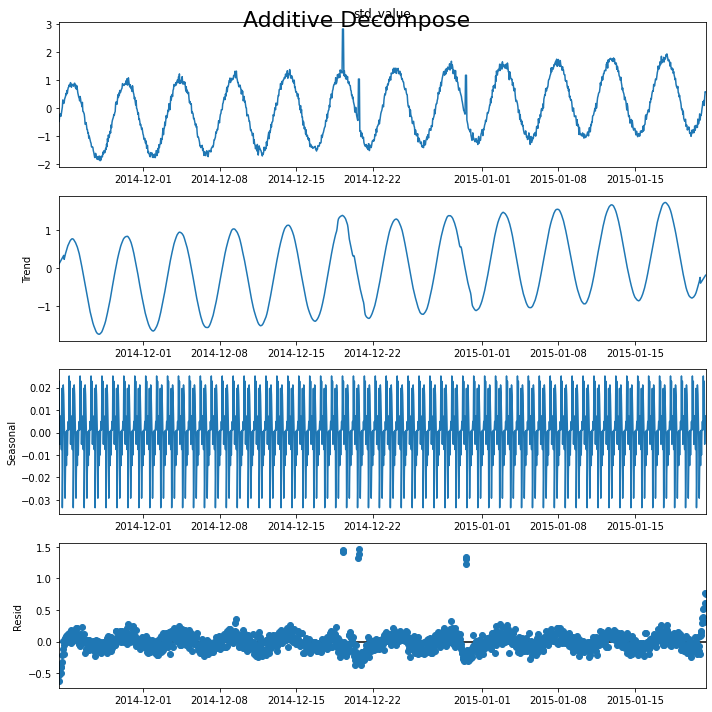


 42%|████▏     | 42/100 [00:43<01:00,  1.05s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 9
                           value  is_anomaly  std_value
timestamp                                              
2014-12-19 06:00:00  3456.069516           1   2.816559
2014-12-19 07:00:00  3456.069516           1   2.816559
2014-12-19 08:00:00  3456.069516           1   2.816559
2014-12-20 17:00:00  1614.961443           1   1.029591
2014-12-20 18:00:00  1614.961443           1   1.029591
2014-12-20 19:00:00  1614.961443           1   1.029591
2014-12-30 12:00:00  1755.033417           1   1.165544
2014-12-30 13:00:00  1755.033417           1   1.165544
2014-12-30 14:00:00  1755.033417           1   1.165544
Detected outliers: 14
Outliers:
               timestamp     resid
623  2014-12-19 06:00:00  1.415977
624  2014-12-19 07:00:00  1.446963
625  2014-12-19 08:00:00  1.435442
658  2014-12-20 17:00:00  1.316042
659  2014-12-20 18:00:00  1.385983
660  2014-12-20 19:00:00  1.458276
893  2014-12-30 12:00:00  1.233155
894  2014-12-30 13:

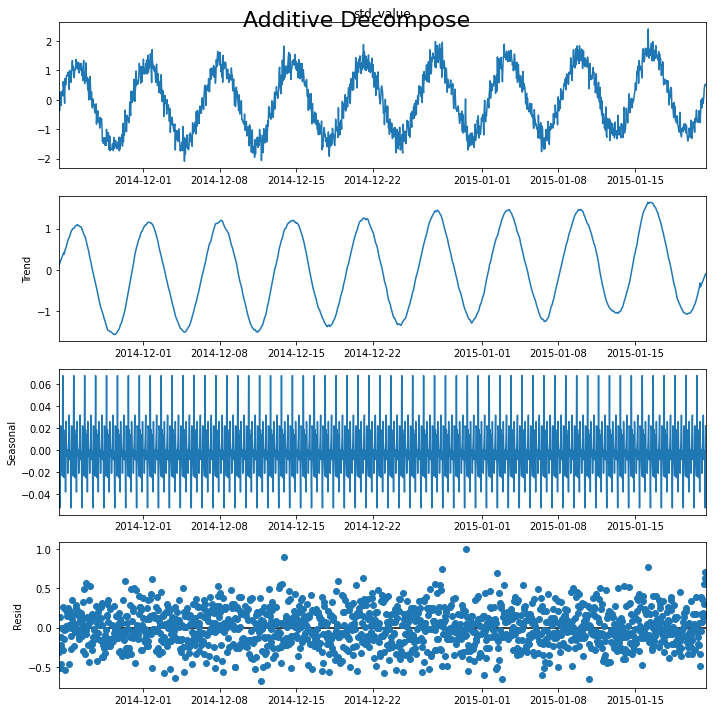


 43%|████▎     | 43/100 [00:44<00:59,  1.04s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 1
                          value  is_anomaly  std_value
timestamp                                             
2014-12-30 12:00:00  313.432529           1     0.0314
Detected outliers: 29
Outliers:
               timestamp     resid
60   2014-11-25 19:00:00  0.563138
69   2014-11-26 04:00:00  0.524147
146  2014-11-29 09:00:00  0.597933
205  2014-12-01 20:00:00  0.613729
273  2014-12-04 16:00:00  0.506717
349  2014-12-07 20:00:00  0.532335
484  2014-12-13 11:00:00  0.506084
485  2014-12-13 12:00:00  0.536728
491  2014-12-13 18:00:00  0.556317
494  2014-12-13 21:00:00  0.891118
614  2014-12-18 21:00:00  0.589770
652  2014-12-20 11:00:00  0.540179
669  2014-12-21 04:00:00  0.632875
827  2014-12-27 18:00:00  0.550286
836  2014-12-28 03:00:00  0.540503
842  2014-12-28 09:00:00  0.741279
893  2014-12-30 12:00:00  0.999042
963  2015-01-02 10:00:00  0.693478
978  2015-01-03 01:00:00  0.540092
1019 2015-01-04 18:00:00  0.543419
1188 2015-01-11

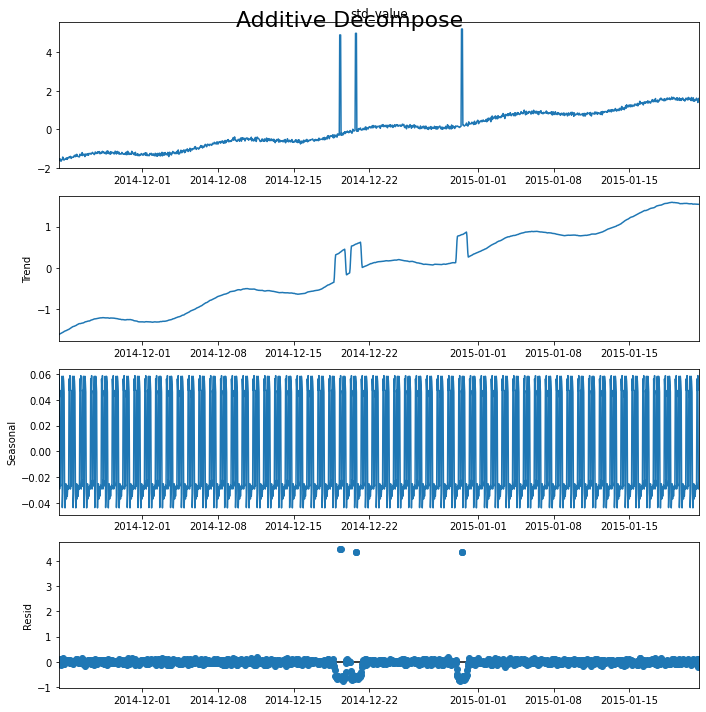


 44%|████▍     | 44/100 [00:46<00:58,  1.04s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 9
                            value  is_anomaly  std_value
timestamp                                               
2014-12-19 06:00:00  45998.101187           1   4.892303
2014-12-19 07:00:00  45998.101187           1   4.892303
2014-12-19 08:00:00  45998.101187           1   4.892303
2014-12-20 17:00:00  46597.041510           1   4.977022
2014-12-20 18:00:00  46597.041510           1   4.977022
2014-12-20 19:00:00  46597.041510           1   4.977022
2014-12-30 12:00:00  48173.999054           1   5.200080
2014-12-30 13:00:00  48173.999054           1   5.200080
2014-12-30 14:00:00  48173.999054           1   5.200080
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  4.465019
624 2014-12-19 07:00:00  4.468640
625 2014-12-19 08:00:00  4.449730
658 2014-12-20 17:00:00  4.346615
659 2014-12-20 18:00:00  4.347828
660 2014-12-20 19:00:00  4.352873
893 2014-12-30 12:00:00  4.349485
894 2014-12-30 13

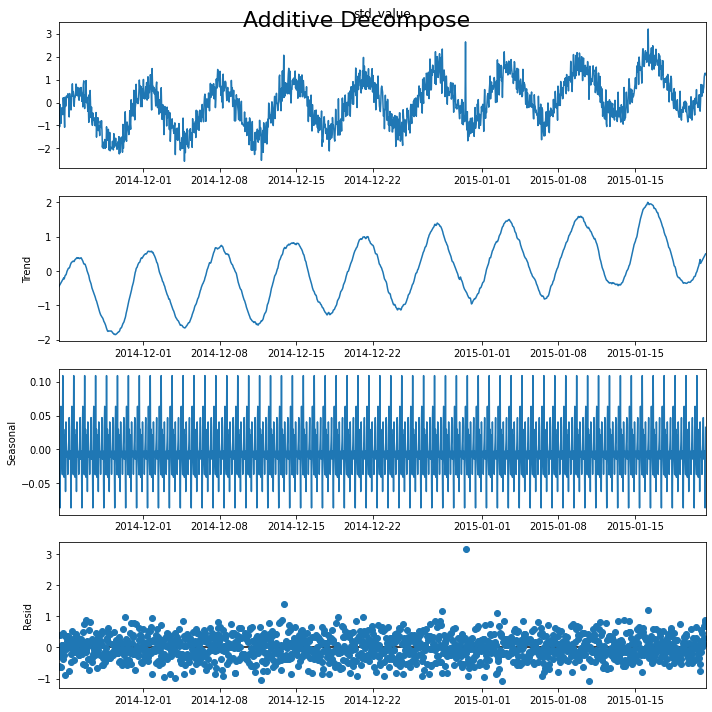


 45%|████▌     | 45/100 [00:47<00:59,  1.07s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 1
                           value  is_anomaly  std_value
timestamp                                              
2014-12-30 12:00:00  4126.027412           1   2.637652
Detected outliers: 145
Outliers:
               timestamp     resid
30   2014-11-24 13:00:00  0.515242
55   2014-11-25 14:00:00  0.744777
60   2014-11-25 19:00:00  0.875062
67   2014-11-26 02:00:00  0.542476
69   2014-11-26 04:00:00  0.826625
...                  ...       ...
1410 2015-01-21 01:00:00  0.546457
1417 2015-01-21 08:00:00  0.690376
1418 2015-01-21 09:00:00  0.797996
1419 2015-01-21 10:00:00  0.892728
1420 2015-01-21 11:00:00  0.681524

[145 rows x 2 columns]
--------------------
Mean: 100.510082, StandardDeviation: 994.197252
               timestamp       value  is_anomaly
0    2014-11-23 07:00:00  127.699238           0
1    2014-11-23 08:00:00   23.069614           0
2    2014-11-23 09:00:00  246.118857           0
3    2014-11-23 10:00:00  295.937818 

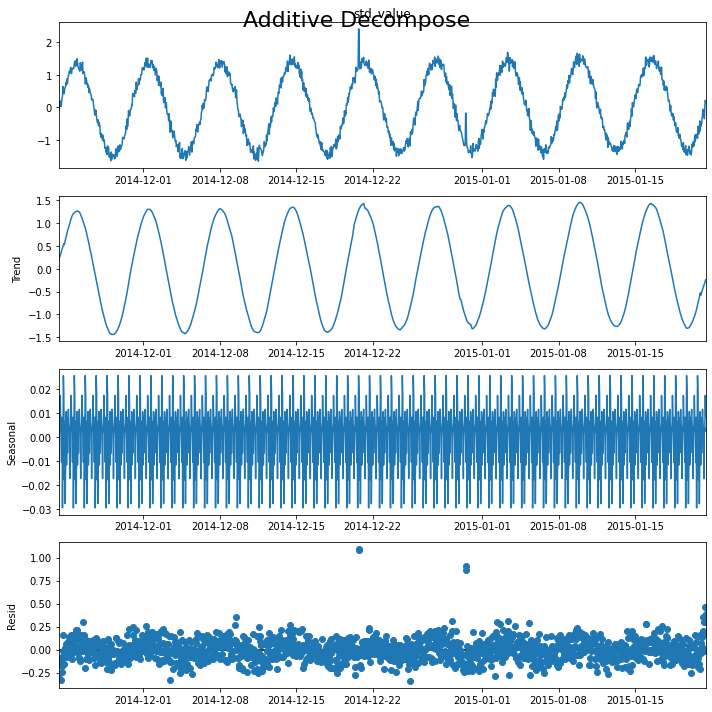


 46%|████▌     | 46/100 [00:48<00:58,  1.08s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 4
                           value  is_anomaly  std_value
timestamp                                              
2014-12-20 17:00:00  2490.312216           1   2.403750
2014-12-20 18:00:00  2490.312216           1   2.403750
2014-12-30 12:00:00   -83.613394           1  -0.185198
2014-12-30 13:00:00   -83.613394           1  -0.185198
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  1.095023
659 2014-12-20 18:00:00  1.083752
893 2014-12-30 12:00:00  0.866077
894 2014-12-30 13:00:00  0.905521
--------------------
Mean: 70.366661, StandardDeviation: 994.123425
               timestamp       value  is_anomaly
0    2014-11-23 07:00:00  -75.700645           0
1    2014-11-23 08:00:00   96.722726           0
2    2014-11-23 09:00:00   47.583009           0
3    2014-11-23 10:00:00  415.496964           0
4    2014-11-23 11:00:00  335.486411           0
...                  ...         ...         ...

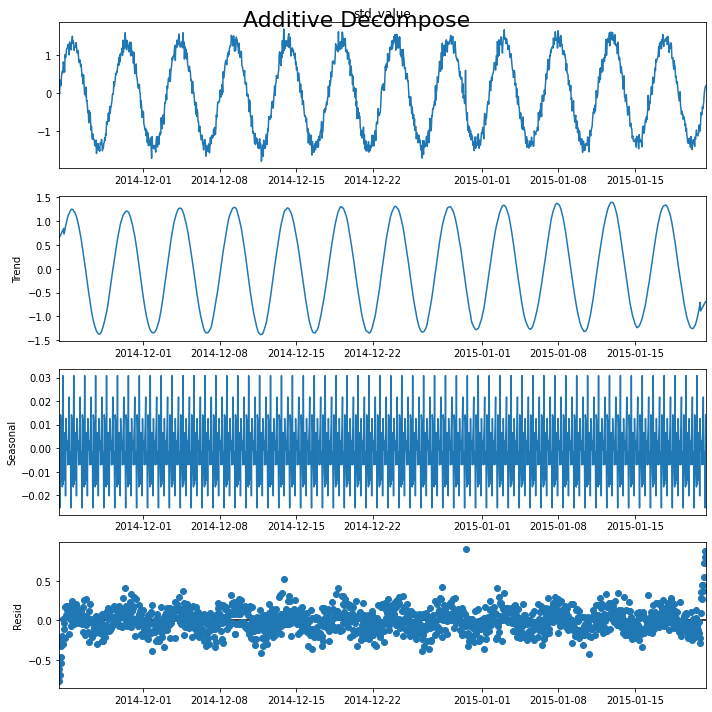


 47%|████▋     | 47/100 [00:49<00:56,  1.07s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 1
                          value  is_anomaly  std_value
timestamp                                             
2014-12-30 12:00:00  670.885798           1   0.604069
Detected outliers: 7
Outliers:
               timestamp     resid
494  2014-12-13 21:00:00  0.521293
893  2014-12-30 12:00:00  0.904908
1416 2015-01-21 07:00:00  0.549320
1417 2015-01-21 08:00:00  0.723506
1418 2015-01-21 09:00:00  0.805690
1419 2015-01-21 10:00:00  0.884116
1420 2015-01-21 11:00:00  0.864671
--------------------
Mean: 1995.674055, StandardDeviation: 1534.256092
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   256.590866           0
1    2014-11-23 08:00:00    23.479791           0
2    2014-11-23 09:00:00   442.359853           0
3    2014-11-23 10:00:00   516.250787           0
4    2014-11-23 11:00:00   428.367553           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  4297.450702           0


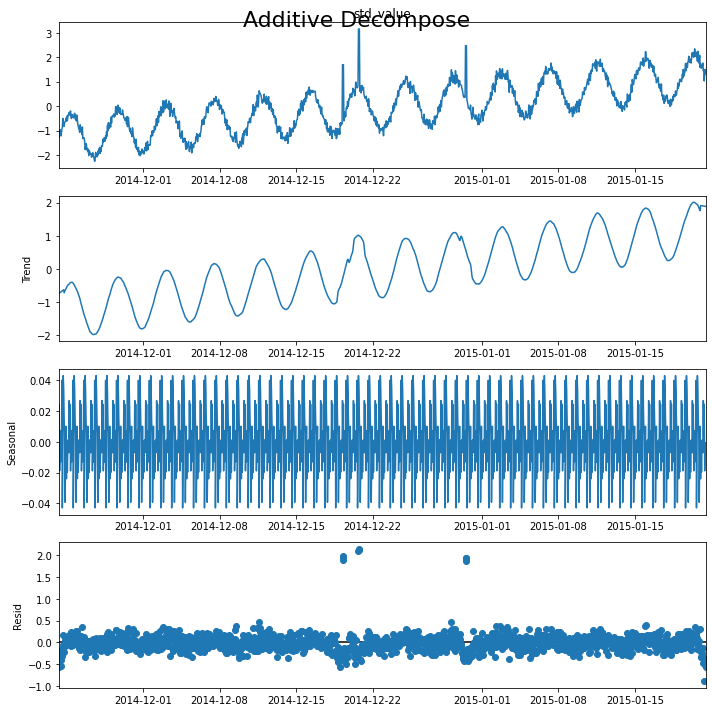


 48%|████▊     | 48/100 [00:50<00:55,  1.06s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 9
                           value  is_anomaly  std_value
timestamp                                              
2014-12-19 06:00:00  4595.357487           1   1.694426
2014-12-19 07:00:00  4595.357487           1   1.694426
2014-12-19 08:00:00  4595.357487           1   1.694426
2014-12-20 17:00:00  6838.500015           1   3.156465
2014-12-20 18:00:00  6838.500015           1   3.156465
2014-12-20 19:00:00  6838.500015           1   3.156465
2014-12-30 12:00:00  5794.273164           1   2.475857
2014-12-30 13:00:00  5794.273164           1   2.475857
2014-12-30 14:00:00  5794.273164           1   2.475857
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  1.976275
624 2014-12-19 07:00:00  1.963655
625 2014-12-19 08:00:00  1.882537
658 2014-12-20 17:00:00  2.099450
659 2014-12-20 18:00:00  2.117918
660 2014-12-20 19:00:00  2.147444
893 2014-12-30 12:00:00  1.876114
894 2014-12-30 13:00:00  1.9

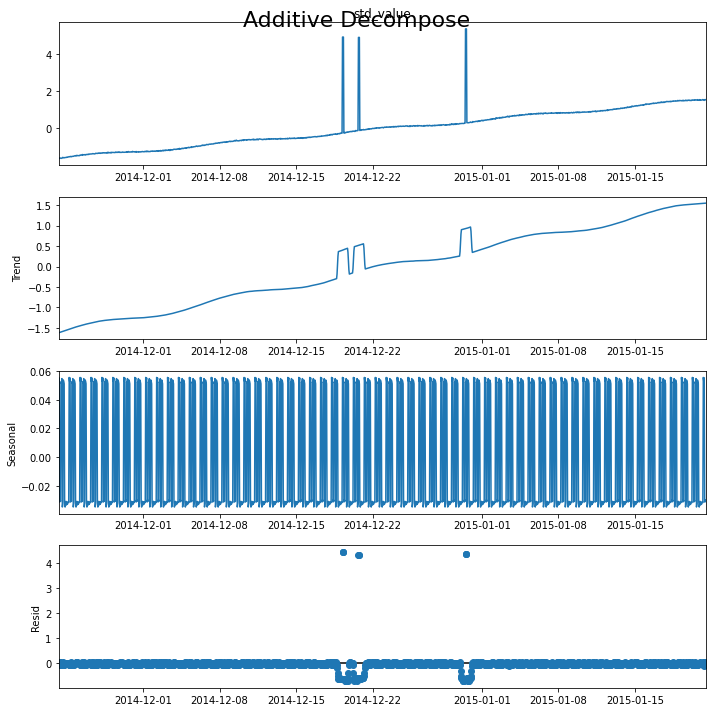


 49%|████▉     | 49/100 [00:51<00:53,  1.05s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 9
                             value  is_anomaly  std_value
timestamp                                                
2014-12-19 06:00:00  106623.213170           1   4.923091
2014-12-19 07:00:00  106623.213170           1   4.923091
2014-12-19 08:00:00  106623.213170           1   4.923091
2014-12-20 17:00:00  106317.137007           1   4.904308
2014-12-20 18:00:00  106317.137007           1   4.904308
2014-12-20 19:00:00  106317.137007           1   4.904308
2014-12-30 12:00:00  113801.826347           1   5.363630
2014-12-30 13:00:00  113801.826347           1   5.363630
2014-12-30 14:00:00  113801.826347           1   5.363630
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  4.468317
624 2014-12-19 07:00:00  4.467260
625 2014-12-19 08:00:00  4.460687
658 2014-12-20 17:00:00  4.333877
659 2014-12-20 18:00:00  4.331673
660 2014-12-20 19:00:00  4.330283
893 2014-12-30 12:00:00  4.385312
894 20

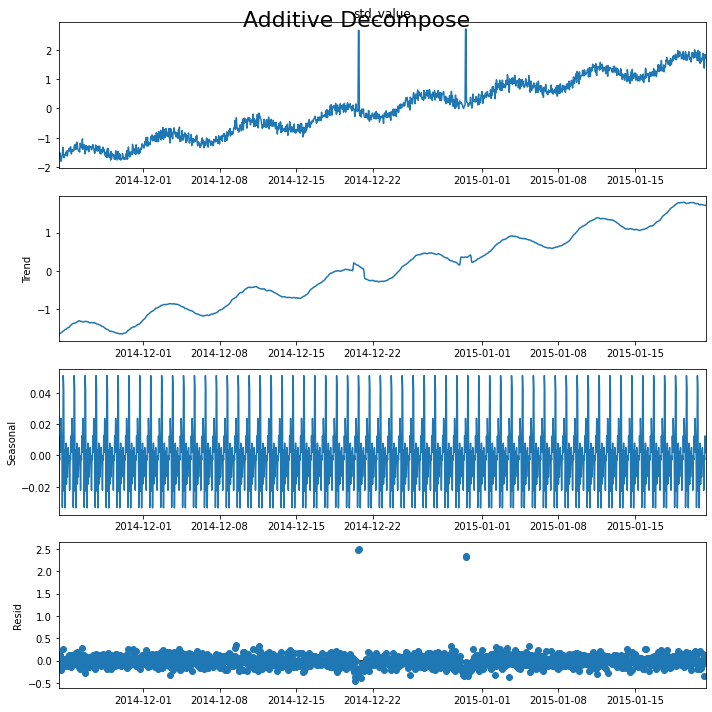


 50%|█████     | 50/100 [00:52<00:51,  1.04s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 4
                            value  is_anomaly  std_value
timestamp                                               
2014-12-20 17:00:00  23114.958768           1   2.663647
2014-12-20 18:00:00  23114.958768           1   2.663647
2014-12-30 12:00:00  23359.052184           1   2.709658
2014-12-30 13:00:00  23359.052184           1   2.709658
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  2.475895
659 2014-12-20 18:00:00  2.496553
893 2014-12-30 12:00:00  2.324577
894 2014-12-30 13:00:00  2.337188
--------------------
Processing index: 50 of 100
Mean: 2841.957725, StandardDeviation: 1929.904148
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00  -165.822369           0
1    2014-11-23 08:00:00   141.239154           0
2    2014-11-23 09:00:00   -47.756479           0
3    2014-11-23 10:00:00   697.651823           0
4    2014-11-23 11:00:00   440.369021           0
...  

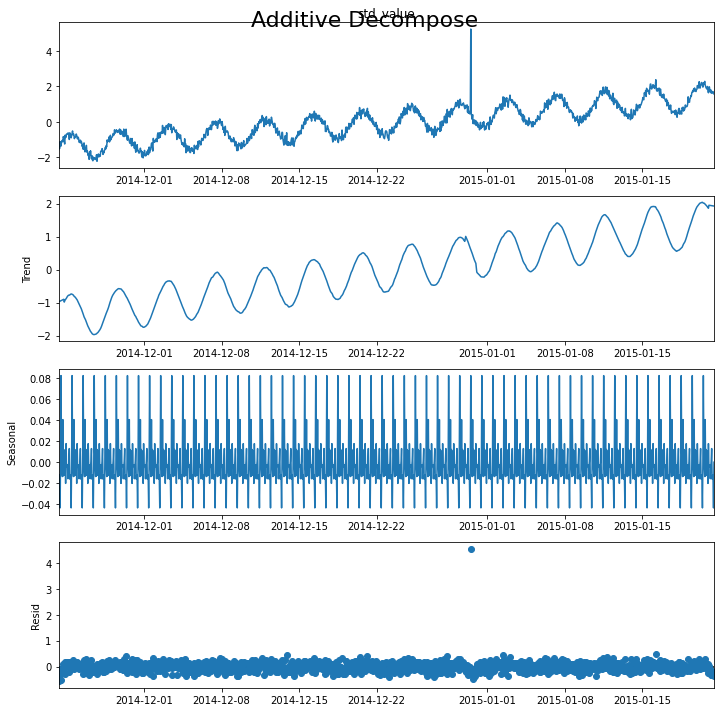


 51%|█████     | 51/100 [00:53<00:52,  1.07s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 1
                            value  is_anomaly  std_value
timestamp                                               
2014-12-30 12:00:00  12933.963939           1   5.229278
Detected outliers: 1
Outliers:
              timestamp     resid
893 2014-12-30 12:00:00  4.541667
--------------------
Mean: 5950.417354, StandardDeviation: 3552.981132
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00   -180.280563           0
1    2014-11-23 08:00:00    118.292354           0
2    2014-11-23 09:00:00   -133.825972           0
3    2014-11-23 10:00:00    652.458040           0
4    2014-11-23 11:00:00    325.887404           0
...                  ...           ...         ...
1416 2015-01-21 07:00:00  11942.906157           0
1417 2015-01-21 08:00:00  12210.795268           0
1418 2015-01-21 09:00:00  12234.121089           0
1419 2015-01-21 10:00:00  12192.975338           0
1420 2015-01-21 11:00:00  12063.465718       

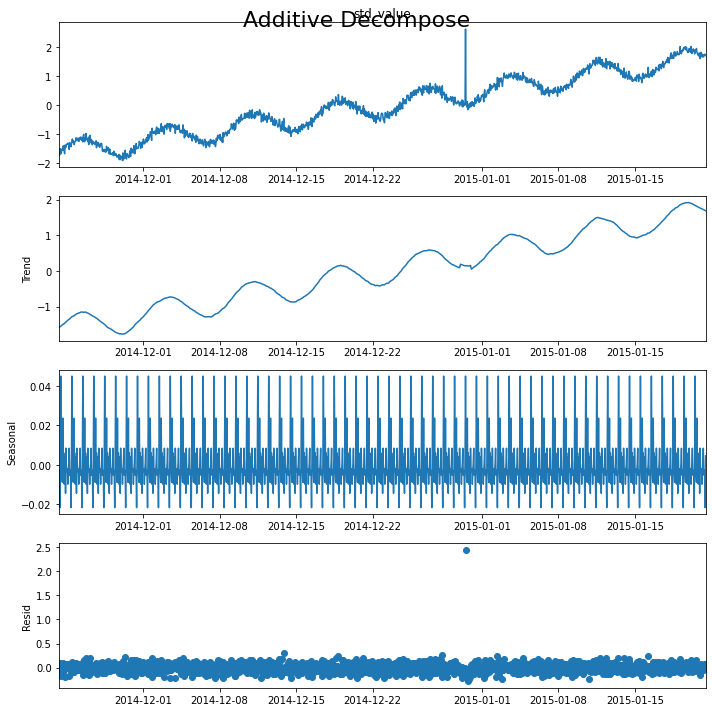


 52%|█████▏    | 52/100 [00:54<00:50,  1.05s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 1
                            value  is_anomaly  std_value
timestamp                                               
2014-12-30 12:00:00  15325.861692           1   2.638754
Detected outliers: 1
Outliers:
              timestamp     resid
893 2014-12-30 12:00:00  2.447457
--------------------
Mean: 1800.062459, StandardDeviation: 1407.250292
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   281.640205           0
1    2014-11-23 08:00:00     7.258396           0
2    2014-11-23 09:00:00   449.860835           0
3    2014-11-23 10:00:00   513.383037           0
4    2014-11-23 11:00:00   399.386940           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  3382.512072           0
1417 2015-01-21 08:00:00  2749.956679           0
1418 2015-01-21 09:00:00  3469.477298           0
1419 2015-01-21 10:00:00  3878.689282           0
1420 2015-01-21 11:00:00  3703.367001           0

[1421

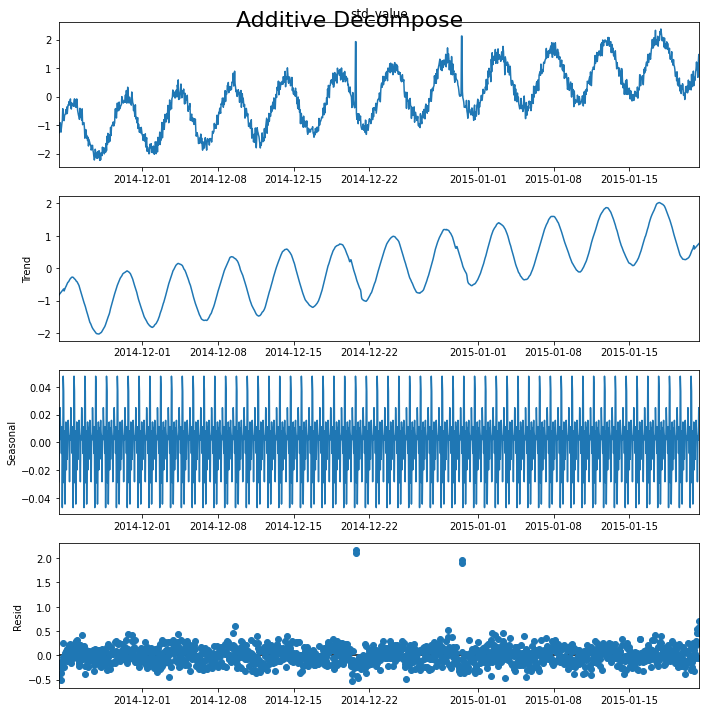


 53%|█████▎    | 53/100 [00:55<00:49,  1.05s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 4
                           value  is_anomaly  std_value
timestamp                                              
2014-12-20 17:00:00  4508.664700           1   1.924748
2014-12-20 18:00:00  4508.664700           1   1.924748
2014-12-30 12:00:00  4786.523684           1   2.122196
2014-12-30 13:00:00  4786.523684           1   2.122196
Detected outliers: 9
Outliers:
               timestamp     resid
390  2014-12-09 13:00:00  0.596376
658  2014-12-20 17:00:00  2.108928
659  2014-12-20 18:00:00  2.172272
862  2014-12-29 05:00:00  0.522110
893  2014-12-30 12:00:00  1.904208
894  2014-12-30 13:00:00  1.967040
1414 2015-01-21 05:00:00  0.534444
1419 2015-01-21 10:00:00  0.700538
1420 2015-01-21 11:00:00  0.573651
--------------------
Mean: 17255.105564, StandardDeviation: 10042.787001
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00    530.537582           0
1    2014-11-23 08:00:00    -36.182104           0
2   

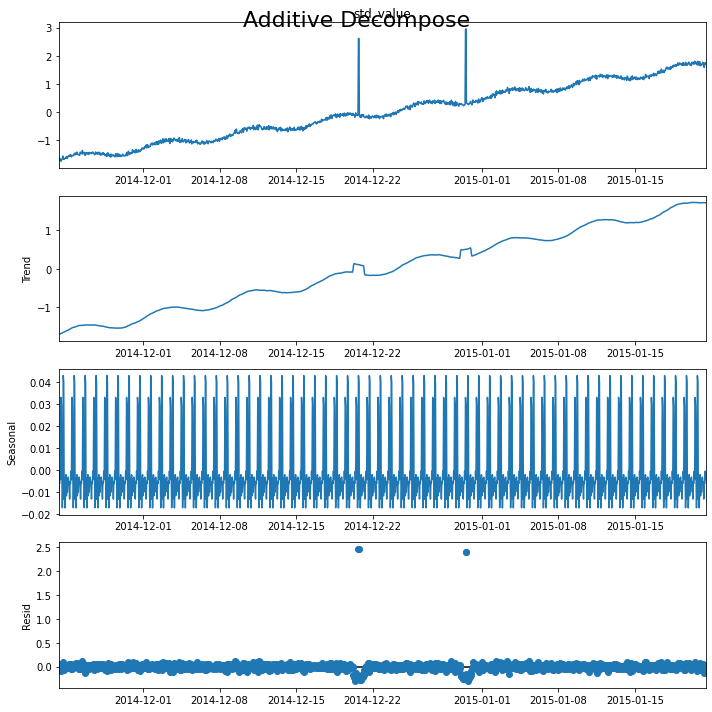


 54%|█████▍    | 54/100 [00:56<00:47,  1.04s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 4
                            value  is_anomaly  std_value
timestamp                                               
2014-12-20 17:00:00  43520.564531           1   2.615356
2014-12-20 18:00:00  43520.564531           1   2.615356
2014-12-30 12:00:00  46884.241246           1   2.950290
2014-12-30 13:00:00  46884.241246           1   2.950290
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  2.459075
659 2014-12-20 18:00:00  2.466446
893 2014-12-30 12:00:00  2.407609
894 2014-12-30 13:00:00  2.410951
--------------------
Mean: 72.285228, StandardDeviation: 991.387749
               timestamp       value  is_anomaly
0    2014-11-23 07:00:00   13.986075           0
1    2014-11-23 08:00:00   70.899941           0
2    2014-11-23 09:00:00  163.301800           0
3    2014-11-23 10:00:00  236.437959           0
4    2014-11-23 11:00:00  300.143589           0
...                  ...         ...      

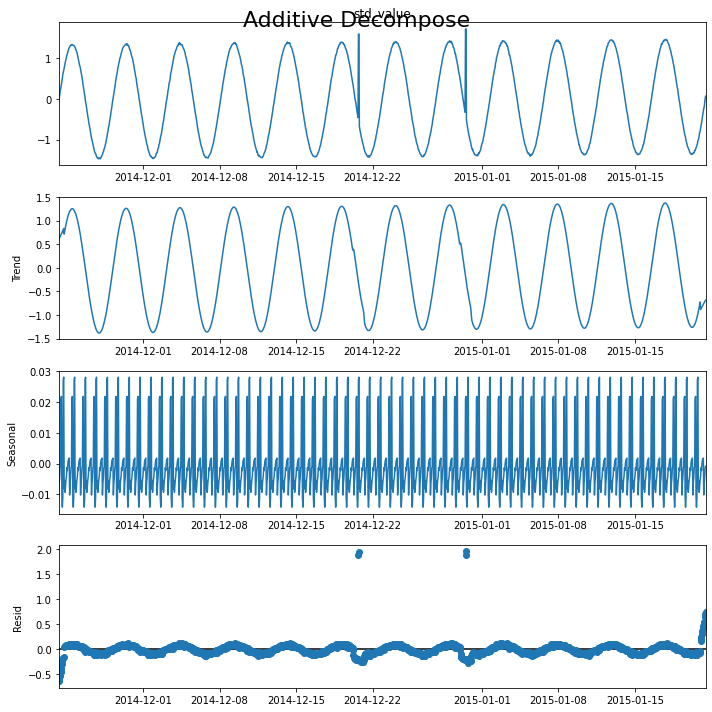


 55%|█████▌    | 55/100 [00:57<00:46,  1.04s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 4
                           value  is_anomaly  std_value
timestamp                                              
2014-12-20 17:00:00  1659.143701           1   1.600644
2014-12-20 18:00:00  1659.143701           1   1.600644
2014-12-30 12:00:00  1785.304499           1   1.727900
2014-12-30 13:00:00  1785.304499           1   1.727900
Detected outliers: 9
Outliers:
               timestamp     resid
658  2014-12-20 17:00:00  1.892400
659  2014-12-20 18:00:00  1.956267
893  2014-12-30 12:00:00  1.896683
894  2014-12-30 13:00:00  1.962440
1416 2015-01-21 07:00:00  0.535378
1417 2015-01-21 08:00:00  0.551513
1418 2015-01-21 09:00:00  0.638618
1419 2015-01-21 10:00:00  0.708726
1420 2015-01-21 11:00:00  0.752307
--------------------
Mean: 7896.721220, StandardDeviation: 4822.223562
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00    479.531049           0
1    2014-11-23 08:00:00    -15.503972           0
2    2

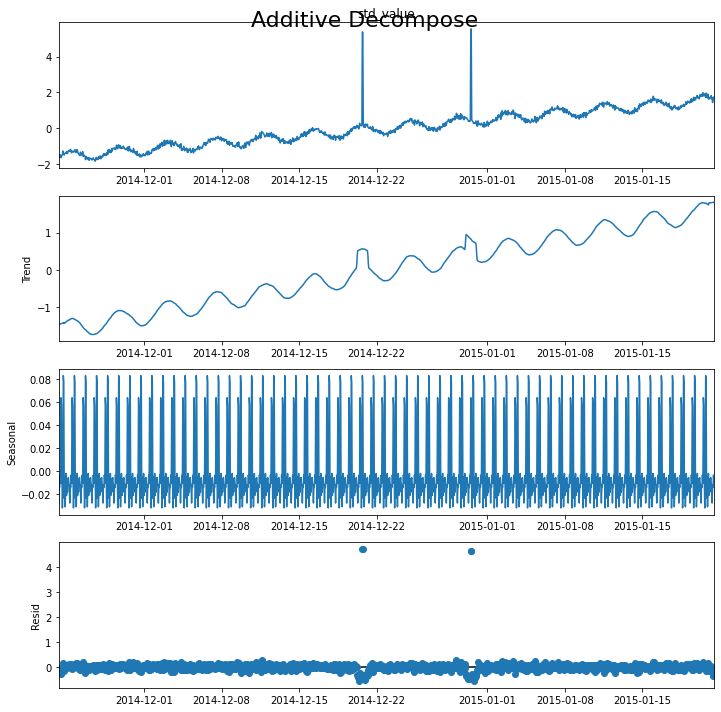


 56%|█████▌    | 56/100 [00:58<00:45,  1.03s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 4
                            value  is_anomaly  std_value
timestamp                                               
2014-12-20 17:00:00  33807.477332           1   5.373197
2014-12-20 18:00:00  33807.477332           1   5.373197
2014-12-30 12:00:00  34610.718324           1   5.539767
2014-12-30 13:00:00  34610.718324           1   5.539767
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  4.723413
659 2014-12-20 18:00:00  4.732347
893 2014-12-30 12:00:00  4.645440
894 2014-12-30 13:00:00  4.667944
--------------------
Mean: 3878.769478, StandardDeviation: 2453.291769
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   410.760396           0
1    2014-11-23 08:00:00   -28.995923           0
2    2014-11-23 09:00:00   572.823138           0
3    2014-11-23 10:00:00   624.359629           0
4    2014-11-23 11:00:00   418.542194           0
...                  ...         

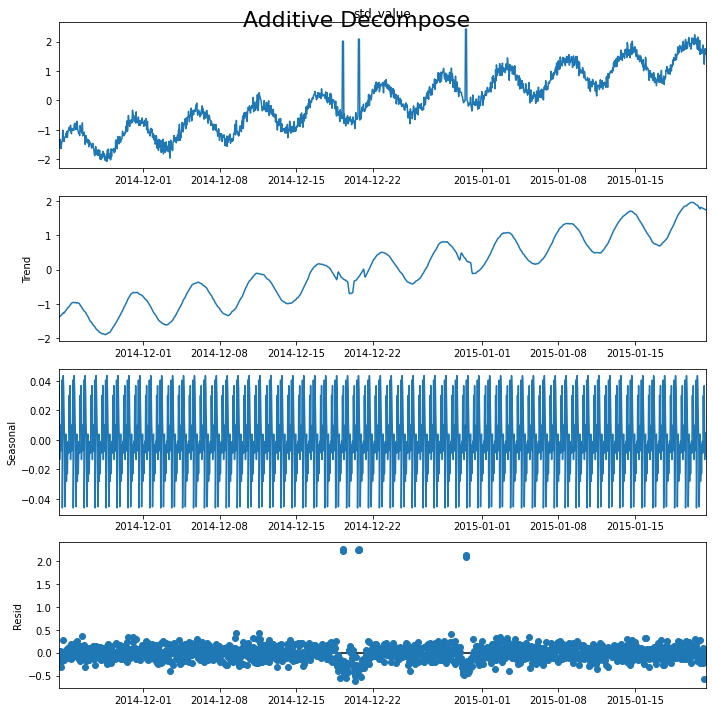


 57%|█████▋    | 57/100 [00:59<00:45,  1.07s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 9
                           value  is_anomaly  std_value
timestamp                                              
2014-12-19 06:00:00  8812.542813           1   2.011083
2014-12-19 07:00:00  8812.542813           1   2.011083
2014-12-19 08:00:00  8812.542813           1   2.011083
2014-12-20 17:00:00  8987.656808           1   2.082462
2014-12-20 18:00:00  8987.656808           1   2.082462
2014-12-20 19:00:00  8987.656808           1   2.082462
2014-12-30 12:00:00  9830.944052           1   2.426199
2014-12-30 13:00:00  9830.944052           1   2.426199
2014-12-30 14:00:00  9830.944052           1   2.426199
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  2.225130
624 2014-12-19 07:00:00  2.268422
625 2014-12-19 08:00:00  2.250446
658 2014-12-20 17:00:00  2.251123
659 2014-12-20 18:00:00  2.249546
660 2014-12-20 19:00:00  2.256528
893 2014-12-30 12:00:00  2.098356
894 2014-12-30 13:00:00  2.1

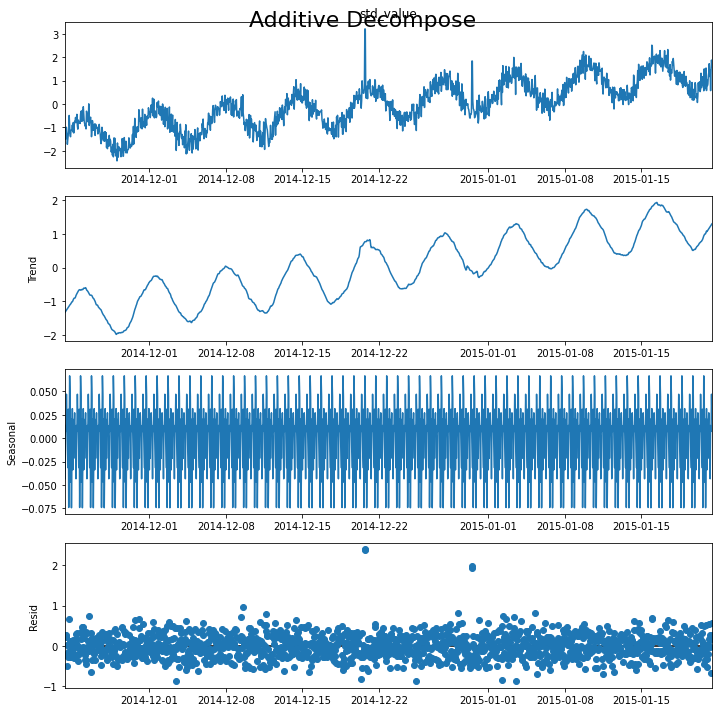


 58%|█████▊    | 58/100 [01:00<00:44,  1.06s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 4
                           value  is_anomaly  std_value
timestamp                                              
2014-12-20 17:00:00  8631.750691           1   3.212436
2014-12-20 18:00:00  8631.750691           1   3.212436
2014-12-30 12:00:00  6089.556807           1   1.839129
2014-12-30 13:00:00  6089.556807           1   1.839129
Detected outliers: 52
Outliers:
               timestamp     resid
9    2014-11-23 16:00:00  0.661785
52   2014-11-25 11:00:00  0.742202
153  2014-11-29 16:00:00  0.646391
162  2014-11-30 01:00:00  0.664063
170  2014-11-30 09:00:00  0.542397
192  2014-12-01 07:00:00  0.602731
224  2014-12-02 15:00:00  0.503347
229  2014-12-02 20:00:00  0.596532
265  2014-12-04 08:00:00  0.629413
303  2014-12-05 22:00:00  0.565272
387  2014-12-09 10:00:00  0.710619
390  2014-12-09 13:00:00  0.977292
427  2014-12-11 02:00:00  0.594470
436  2014-12-11 11:00:00  0.528463
440  2014-12-11 15:00:00  0.795192
441  2014-12-11 16:

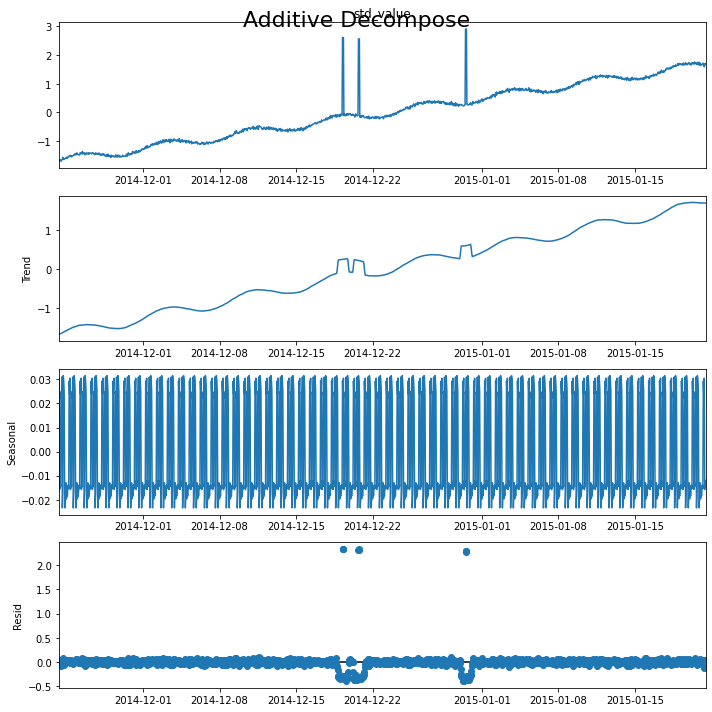


 59%|█████▉    | 59/100 [01:01<00:42,  1.05s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 9
                            value  is_anomaly  std_value
timestamp                                               
2014-12-19 06:00:00  40839.190446           1   2.610746
2014-12-19 07:00:00  40839.190446           1   2.610746
2014-12-19 08:00:00  40839.190446           1   2.610746
2014-12-20 17:00:00  40401.500934           1   2.564485
2014-12-20 18:00:00  40401.500934           1   2.564485
2014-12-20 19:00:00  40401.500934           1   2.564485
2014-12-30 12:00:00  43680.480533           1   2.911057
2014-12-30 13:00:00  43680.480533           1   2.911057
2014-12-30 14:00:00  43680.480533           1   2.911057
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  2.336470
624 2014-12-19 07:00:00  2.340990
625 2014-12-19 08:00:00  2.332884
658 2014-12-20 17:00:00  2.318577
659 2014-12-20 18:00:00  2.324589
660 2014-12-20 19:00:00  2.332668
893 2014-12-30 12:00:00  2.291685
894 2014-12-30 13

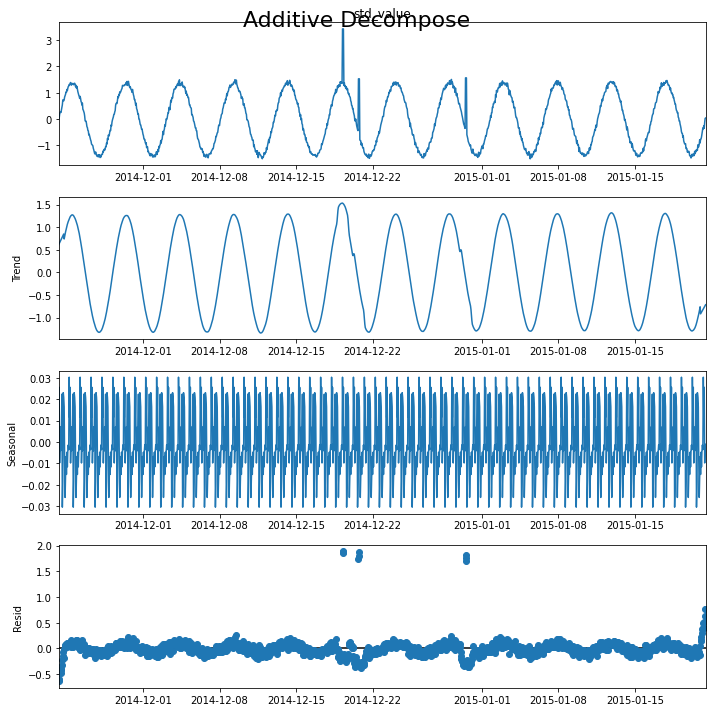


 60%|██████    | 60/100 [01:02<00:42,  1.05s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 9
                           value  is_anomaly  std_value
timestamp                                              
2014-12-19 06:00:00  3476.324022           1   3.422280
2014-12-19 07:00:00  3476.324022           1   3.422280
2014-12-19 08:00:00  3476.324022           1   3.422280
2014-12-20 17:00:00  1571.378918           1   1.526707
2014-12-20 18:00:00  1571.378918           1   1.526707
2014-12-20 19:00:00  1571.378918           1   1.526707
2014-12-30 12:00:00  1608.192594           1   1.563339
2014-12-30 13:00:00  1608.192594           1   1.563339
2014-12-30 14:00:00  1608.192594           1   1.563339
Detected outliers: 13
Outliers:
               timestamp     resid
623  2014-12-19 06:00:00  1.859798
624  2014-12-19 07:00:00  1.887223
625  2014-12-19 08:00:00  1.883905
658  2014-12-20 17:00:00  1.731914
659  2014-12-20 18:00:00  1.800324
660  2014-12-20 19:00:00  1.868853
893  2014-12-30 12:00:00  1.691534
894  2014-12-30 13:

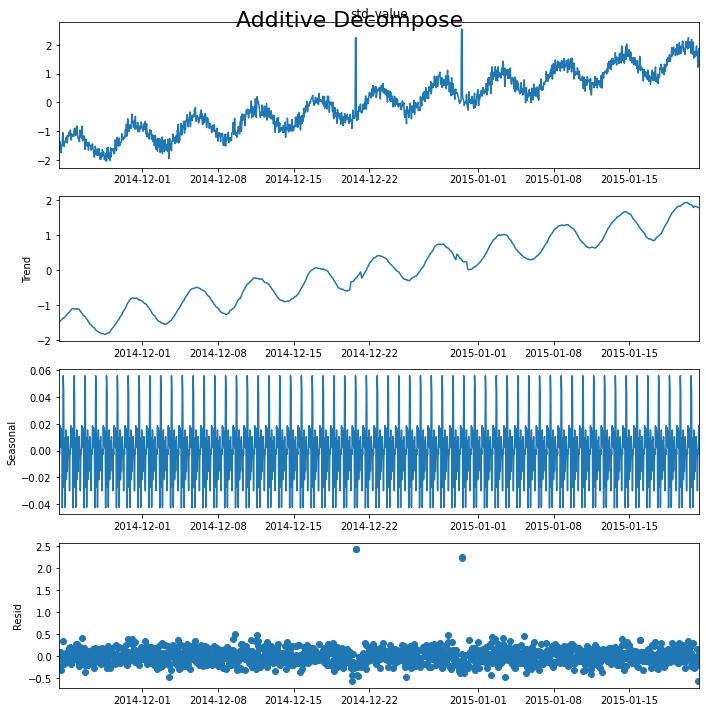


 61%|██████    | 61/100 [01:03<00:40,  1.05s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 4
                            value  is_anomaly  std_value
timestamp                                               
2014-12-20 17:00:00  11631.177393           1   2.247531
2014-12-20 18:00:00  11631.177393           1   2.247531
2014-12-30 12:00:00  12531.576868           1   2.547446
2014-12-30 13:00:00  12531.576868           1   2.547446
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  2.423279
659 2014-12-20 18:00:00  2.427783
893 2014-12-30 12:00:00  2.219730
894 2014-12-30 13:00:00  2.251850
--------------------
Mean: 533.967462, StandardDeviation: 1069.884522
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00  -206.601939           0
1    2014-11-23 08:00:00   136.595836           0
2    2014-11-23 09:00:00  -125.936981           0
3    2014-11-23 10:00:00   753.121958           0
4    2014-11-23 11:00:00   407.953075           0
...                  ...          

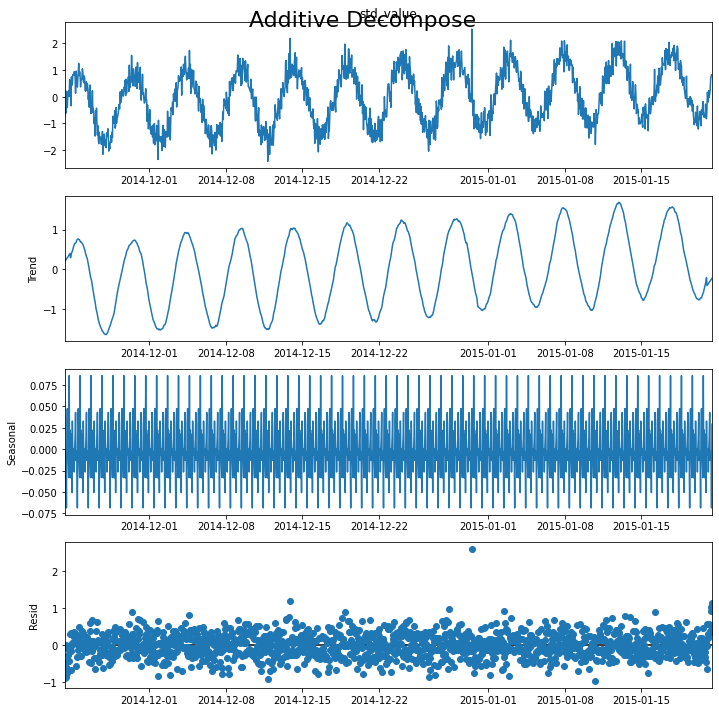


 62%|██████▏   | 62/100 [01:05<00:39,  1.05s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 1
                           value  is_anomaly  std_value
timestamp                                              
2014-12-30 12:00:00  3252.390692           1   2.540857
Detected outliers: 84
Outliers:
               timestamp     resid
55   2014-11-25 14:00:00  0.600060
60   2014-11-25 19:00:00  0.684625
69   2014-11-26 04:00:00  0.612549
141  2014-11-29 04:00:00  0.579407
146  2014-11-29 09:00:00  0.897084
...                  ...       ...
1416 2015-01-21 07:00:00  0.553591
1417 2015-01-21 08:00:00  0.909445
1418 2015-01-21 09:00:00  1.030441
1419 2015-01-21 10:00:00  1.141206
1420 2015-01-21 11:00:00  1.002848

[84 rows x 2 columns]
--------------------
Mean: 1442.278105, StandardDeviation: 1306.683693
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   483.204696           0
1    2014-11-23 08:00:00   -64.519211           0
2    2014-11-23 09:00:00   624.097423           0
3    2014-11-23 10:00:00   659.73

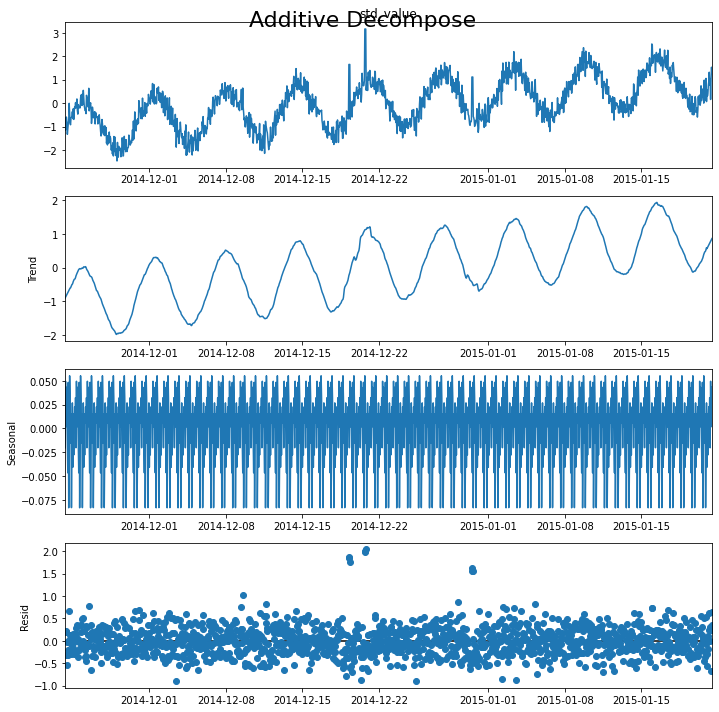


 63%|██████▎   | 63/100 [01:06<00:40,  1.10s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 9
                           value  is_anomaly  std_value
timestamp                                              
2014-12-19 06:00:00  3594.659515           1   1.647209
2014-12-19 07:00:00  3594.659515           1   1.647209
2014-12-19 08:00:00  3594.659515           1   1.647209
2014-12-20 17:00:00  5571.619038           1   3.160169
2014-12-20 18:00:00  5571.619038           1   3.160169
2014-12-20 19:00:00  5571.619038           1   3.160169
2014-12-30 12:00:00  2894.765088           1   1.111583
2014-12-30 13:00:00  2894.765088           1   1.111583
2014-12-30 14:00:00  2894.765088           1   1.111583
Detected outliers: 68
Outliers:
               timestamp     resid
9    2014-11-23 16:00:00  0.670981
40   2014-11-24 23:00:00  0.513385
52   2014-11-25 11:00:00  0.783789
153  2014-11-29 16:00:00  0.673902
162  2014-11-30 01:00:00  0.695242
...                  ...       ...
1396 2015-01-20 11:00:00  0.547288
1403 2015-01-20 18:

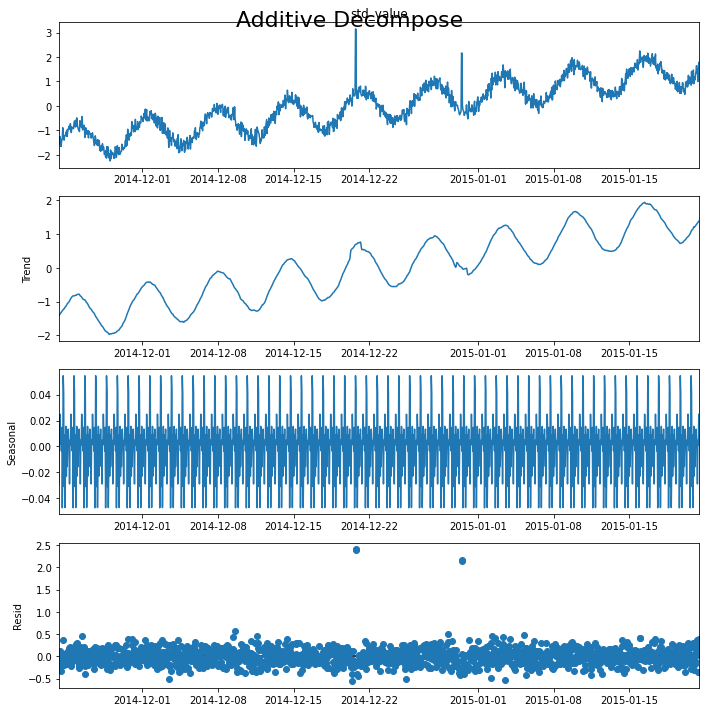


 64%|██████▍   | 64/100 [01:07<00:38,  1.08s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 4
                           value  is_anomaly  std_value
timestamp                                              
2014-12-20 17:00:00  9641.220814           1   3.147495
2014-12-20 18:00:00  9641.220814           1   3.147495
2014-12-30 12:00:00  7622.747082           1   2.163635
2014-12-30 13:00:00  7622.747082           1   2.163635
Detected outliers: 5
Outliers:
              timestamp     resid
390 2014-12-09 13:00:00  0.563655
658 2014-12-20 17:00:00  2.403258
659 2014-12-20 18:00:00  2.411439
893 2014-12-30 12:00:00  2.137486
894 2014-12-30 13:00:00  2.168799
--------------------
Mean: 10261.456181, StandardDeviation: 6043.947087
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00    192.310834           0
1    2014-11-23 08:00:00     47.490501           0
2    2014-11-23 09:00:00    360.105901           0
3    2014-11-23 10:00:00    430.851191           0
4    2014-11-23 11:00:00    388.317785           

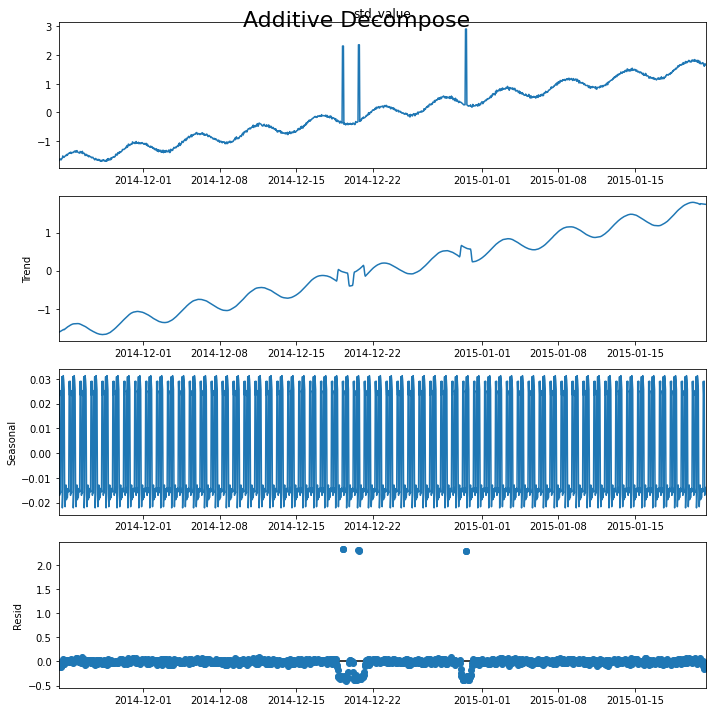


 65%|██████▌   | 65/100 [01:08<00:37,  1.06s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 9
                            value  is_anomaly  std_value
timestamp                                               
2014-12-19 06:00:00  24266.394717           1   2.317184
2014-12-19 07:00:00  24266.394717           1   2.317184
2014-12-19 08:00:00  24266.394717           1   2.317184
2014-12-20 17:00:00  24524.230578           1   2.359844
2014-12-20 18:00:00  24524.230578           1   2.359844
2014-12-20 19:00:00  24524.230578           1   2.359844
2014-12-30 12:00:00  27859.906793           1   2.911748
2014-12-30 13:00:00  27859.906793           1   2.911748
2014-12-30 14:00:00  27859.906793           1   2.911748
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  2.318457
624 2014-12-19 07:00:00  2.329743
625 2014-12-19 08:00:00  2.328760
658 2014-12-20 17:00:00  2.303785
659 2014-12-20 18:00:00  2.297699
660 2014-12-20 19:00:00  2.292798
893 2014-12-30 12:00:00  2.285087
894 2014-12-30 13

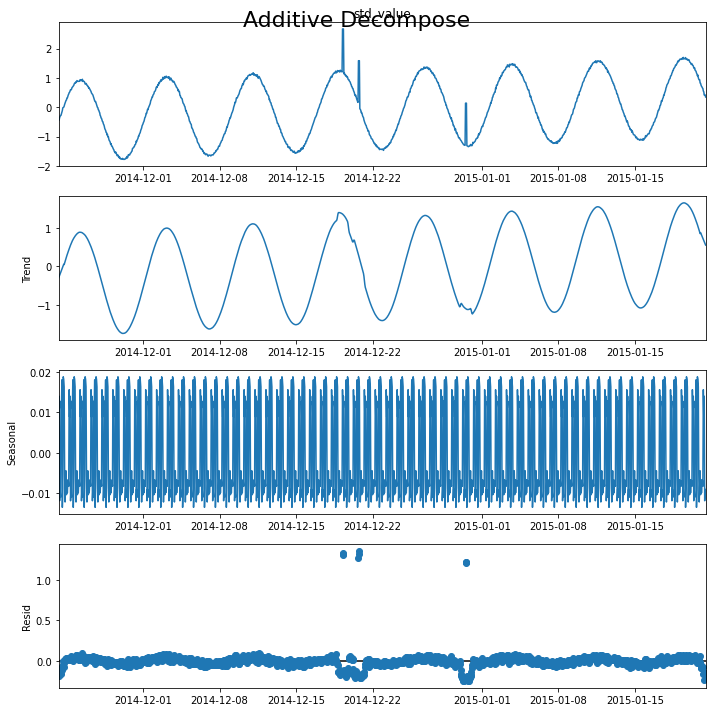


 66%|██████▌   | 66/100 [01:09<00:35,  1.05s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 9
                           value  is_anomaly  std_value
timestamp                                              
2014-12-19 06:00:00  3225.596069           1   2.673989
2014-12-19 07:00:00  3225.596069           1   2.673989
2014-12-19 08:00:00  3225.596069           1   2.673989
2014-12-20 17:00:00  2114.071753           1   1.588931
2014-12-20 18:00:00  2114.071753           1   1.588931
2014-12-20 19:00:00  2114.071753           1   1.588931
2014-12-30 12:00:00   631.206140           1   0.141373
2014-12-30 13:00:00   631.206140           1   0.141373
2014-12-30 14:00:00   631.206140           1   0.141373
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  1.304327
624 2014-12-19 07:00:00  1.322486
625 2014-12-19 08:00:00  1.329592
658 2014-12-20 17:00:00  1.270474
659 2014-12-20 18:00:00  1.315454
660 2014-12-20 19:00:00  1.361520
893 2014-12-30 12:00:00  1.215138
894 2014-12-30 13:00:00  1.2

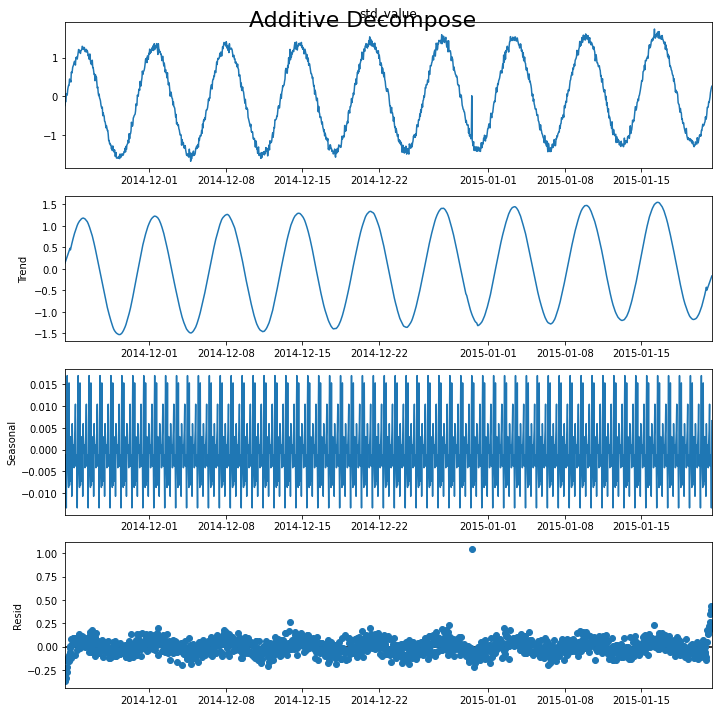


 67%|██████▋   | 67/100 [01:10<00:34,  1.05s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 1
                          value  is_anomaly  std_value
timestamp                                             
2014-12-30 12:00:00  211.466202           1   0.013994
Detected outliers: 1
Outliers:
              timestamp     resid
893 2014-12-30 12:00:00  1.046566
--------------------
Mean: 959.394771, StandardDeviation: 1155.849408
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   394.123324           0
1    2014-11-23 08:00:00   -43.032020           0
2    2014-11-23 09:00:00   528.987760           0
3    2014-11-23 10:00:00   567.962720           0
4    2014-11-23 11:00:00   357.743117           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  1818.849690           0
1417 2015-01-21 08:00:00   878.892797           0
1418 2015-01-21 09:00:00  1841.014851           0
1419 2015-01-21 10:00:00  2366.046251           0
1420 2015-01-21 11:00:00  2068.291420           0

[1421 rows x

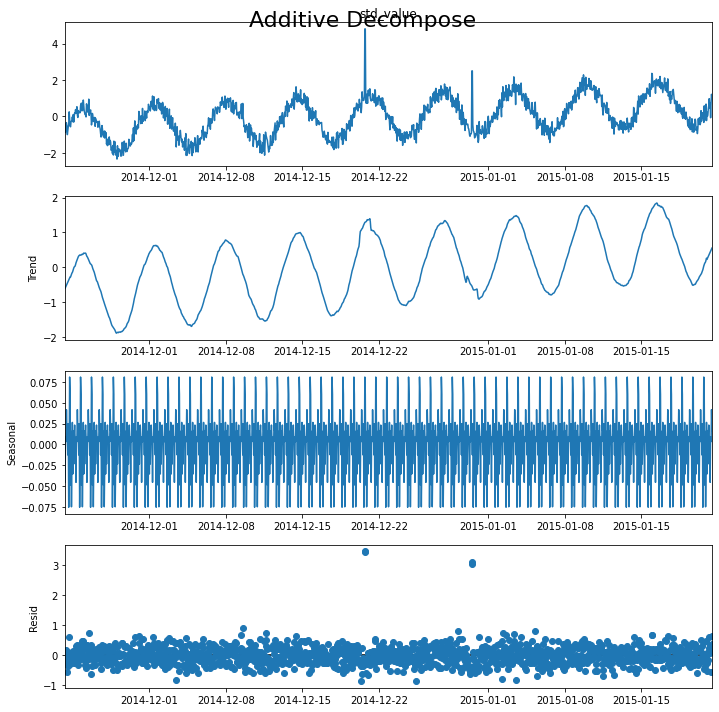


 68%|██████▊   | 68/100 [01:11<00:34,  1.07s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 4
                           value  is_anomaly  std_value
timestamp                                              
2014-12-20 17:00:00  6519.797396           1   4.810664
2014-12-20 18:00:00  6519.797396           1   4.810664
2014-12-30 12:00:00  3853.824702           1   2.504158
2014-12-30 13:00:00  3853.824702           1   2.504158
Detected outliers: 44
Outliers:
               timestamp     resid
9    2014-11-23 16:00:00  0.601638
52   2014-11-25 11:00:00  0.728642
153  2014-11-29 16:00:00  0.618920
162  2014-11-30 01:00:00  0.640955
170  2014-11-30 09:00:00  0.530632
192  2014-12-01 07:00:00  0.598285
229  2014-12-02 20:00:00  0.579578
265  2014-12-04 08:00:00  0.588821
303  2014-12-05 22:00:00  0.535320
387  2014-12-09 10:00:00  0.687937
390  2014-12-09 13:00:00  0.920031
427  2014-12-11 02:00:00  0.553476
440  2014-12-11 15:00:00  0.746885
461  2014-12-12 12:00:00  0.508204
487  2014-12-13 14:00:00  0.513233
507  2014-12-14 10:

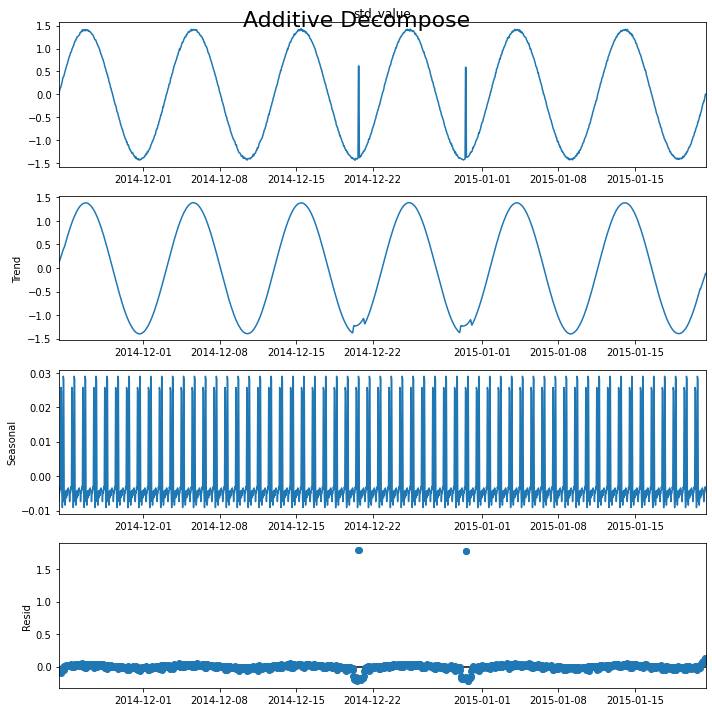


 69%|██████▉   | 69/100 [01:12<00:33,  1.07s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 4
                          value  is_anomaly  std_value
timestamp                                             
2014-12-20 17:00:00  616.412915           1   0.617816
2014-12-20 18:00:00  616.412915           1   0.617816
2014-12-30 12:00:00  587.893627           1   0.588934
2014-12-30 13:00:00  587.893627           1   0.588934
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  1.794800
659 2014-12-20 18:00:00  1.788847
893 2014-12-30 12:00:00  1.782777
894 2014-12-30 13:00:00  1.778251
--------------------
Mean: 16835.838156, StandardDeviation: 9846.453856
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00    731.843953           0
1    2014-11-23 08:00:00   -108.489455           0
2    2014-11-23 09:00:00    871.734657           0
3    2014-11-23 10:00:00    890.717833           0
4    2014-11-23 11:00:00    460.633406           0
...                  ...           ...

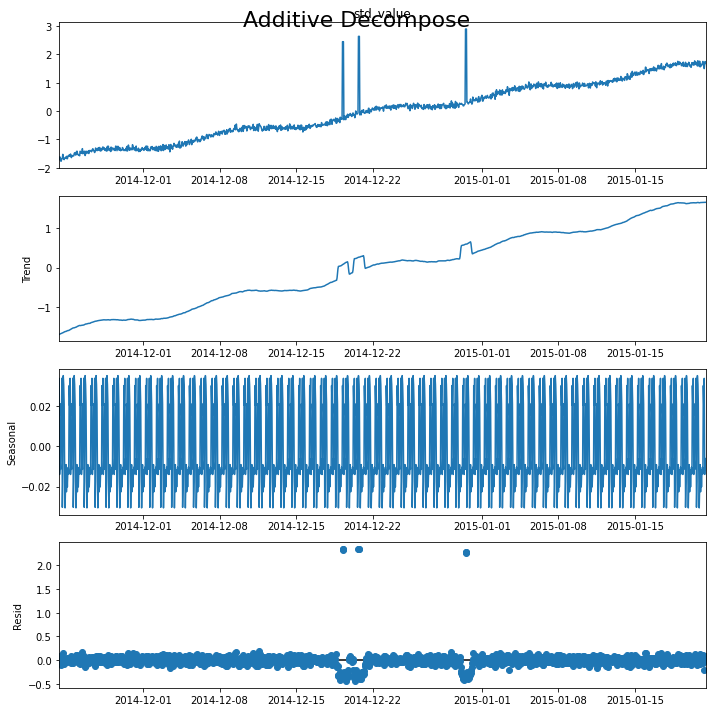


 70%|███████   | 70/100 [01:13<00:31,  1.05s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 9
                            value  is_anomaly  std_value
timestamp                                               
2014-12-19 06:00:00  40955.420912           1   2.449570
2014-12-19 07:00:00  40955.420912           1   2.449570
2014-12-19 08:00:00  40955.420912           1   2.449570
2014-12-20 17:00:00  42818.472509           1   2.638781
2014-12-20 18:00:00  42818.472509           1   2.638781
2014-12-20 19:00:00  42818.472509           1   2.638781
2014-12-30 12:00:00  45369.834825           1   2.897896
2014-12-30 13:00:00  45369.834825           1   2.897896
2014-12-30 14:00:00  45369.834825           1   2.897896
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  2.342217
624 2014-12-19 07:00:00  2.347540
625 2014-12-19 08:00:00  2.327635
658 2014-12-20 17:00:00  2.338676
659 2014-12-20 18:00:00  2.341641
660 2014-12-20 19:00:00  2.348997
893 2014-12-30 12:00:00  2.277670
894 2014-12-30 13

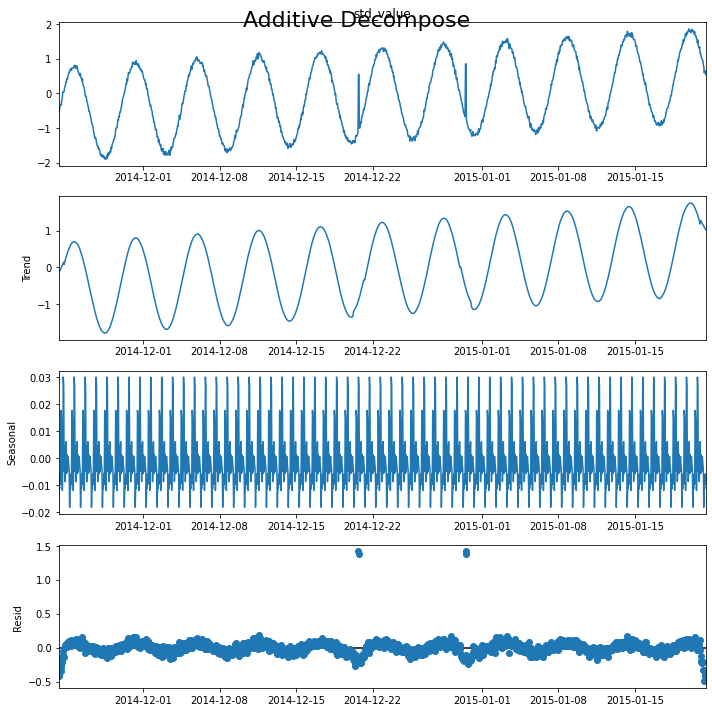


 71%|███████   | 71/100 [01:14<00:30,  1.04s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 4
                           value  is_anomaly  std_value
timestamp                                              
2014-12-20 17:00:00  1200.882156           1   0.544478
2014-12-20 18:00:00  1200.882156           1   0.544478
2014-12-30 12:00:00  1516.702355           1   0.847142
2014-12-30 13:00:00  1516.702355           1   0.847142
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  1.415847
659 2014-12-20 18:00:00  1.380350
893 2014-12-30 12:00:00  1.371544
894 2014-12-30 13:00:00  1.420474
--------------------
Mean: 14015.791325, StandardDeviation: 8113.068457
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00   -244.177135           0
1    2014-11-23 08:00:00    144.307940           0
2    2014-11-23 09:00:00   -237.382415           0
3    2014-11-23 10:00:00    833.431481           0
4    2014-11-23 11:00:00    347.908933           0
...                  ...        

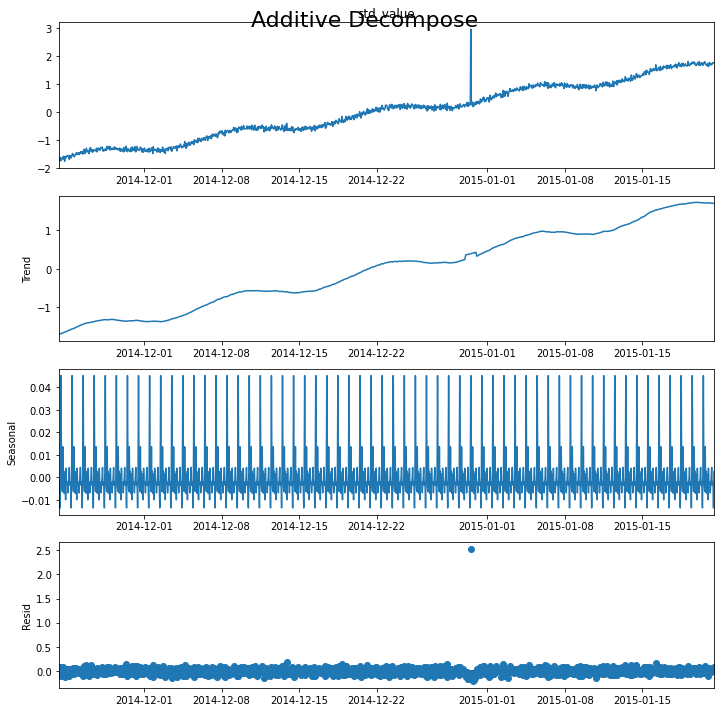


 72%|███████▏  | 72/100 [01:15<00:28,  1.03s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 1
                            value  is_anomaly  std_value
timestamp                                               
2014-12-30 12:00:00  38073.212658           1   2.965268
Detected outliers: 1
Outliers:
              timestamp     resid
893 2014-12-30 12:00:00  2.527949
--------------------
Mean: 28683.962627, StandardDeviation: 16557.612808
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00   -110.811440           0
1    2014-11-23 08:00:00    152.460160           0
2    2014-11-23 09:00:00    -25.157237           0
3    2014-11-23 10:00:00    628.696974           0
4    2014-11-23 11:00:00    391.617580           0
...                  ...           ...         ...
1416 2015-01-21 07:00:00  57041.263032           0
1417 2015-01-21 08:00:00  57298.423811           0
1418 2015-01-21 09:00:00  57359.861010           0
1419 2015-01-21 10:00:00  57369.737884           0
1420 2015-01-21 11:00:00  57308.894853     

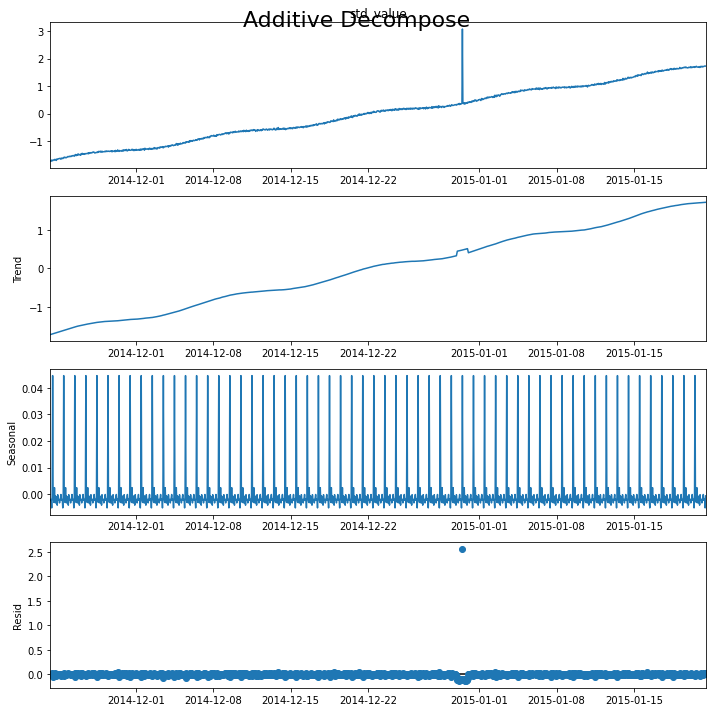


 73%|███████▎  | 73/100 [01:16<00:27,  1.02s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 1
                            value  is_anomaly  std_value
timestamp                                               
2014-12-30 12:00:00  79681.565493           1   3.080009
Detected outliers: 1
Outliers:
              timestamp   resid
893 2014-12-30 12:00:00  2.5588
--------------------
Mean: 4873.417218, StandardDeviation: 2960.351286
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   184.728233           0
1    2014-11-23 08:00:00    -4.821284           0
2    2014-11-23 09:00:00   263.194207           0
3    2014-11-23 10:00:00   289.597838           0
4    2014-11-23 11:00:00   203.109403           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  9598.339840           0
1417 2015-01-21 08:00:00  9125.389925           0
1418 2015-01-21 09:00:00  9514.644255           0
1419 2015-01-21 10:00:00  9705.629910           0
1420 2015-01-21 11:00:00  9523.532745           0

[1421 row

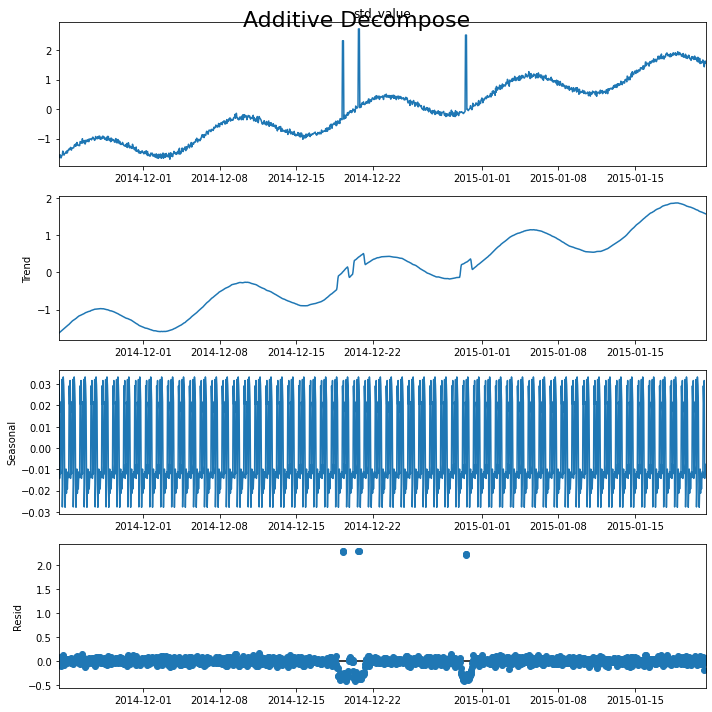


 74%|███████▍  | 74/100 [01:17<00:27,  1.06s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 9
                            value  is_anomaly  std_value
timestamp                                               
2014-12-19 06:00:00  11741.659149           1   2.320077
2014-12-19 07:00:00  11741.659149           1   2.320077
2014-12-19 08:00:00  11741.659149           1   2.320077
2014-12-20 17:00:00  12933.153180           1   2.722561
2014-12-20 18:00:00  12933.153180           1   2.722561
2014-12-20 19:00:00  12933.153180           1   2.722561
2014-12-30 12:00:00  12313.689897           1   2.513307
2014-12-30 13:00:00  12313.689897           1   2.513307
2014-12-30 14:00:00  12313.689897           1   2.513307
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  2.286676
624 2014-12-19 07:00:00  2.284346
625 2014-12-19 08:00:00  2.260638
658 2014-12-20 17:00:00  2.283556
659 2014-12-20 18:00:00  2.279894
660 2014-12-20 19:00:00  2.279935
893 2014-12-30 12:00:00  2.229762
894 2014-12-30 13

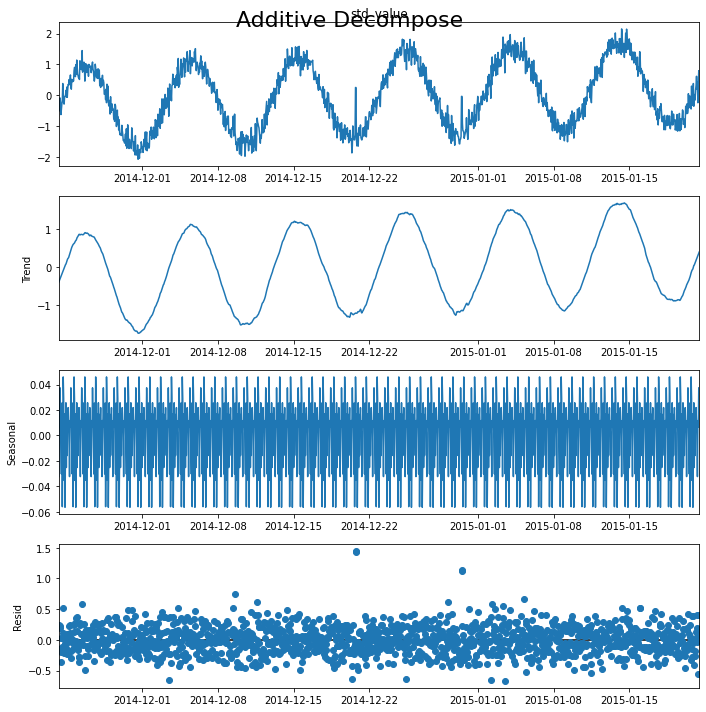


 75%|███████▌  | 75/100 [01:18<00:26,  1.06s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 4
                          value  is_anomaly  std_value
timestamp                                             
2014-12-20 17:00:00  737.743951           1   0.253864
2014-12-20 18:00:00  737.743951           1   0.253864
2014-12-30 12:00:00  446.493838           1  -0.033395
2014-12-30 13:00:00  446.493838           1  -0.033395
Detected outliers: 19
Outliers:
               timestamp     resid
9    2014-11-23 16:00:00  0.520624
52   2014-11-25 11:00:00  0.577330
265  2014-12-04 08:00:00  0.522155
387  2014-12-09 10:00:00  0.525323
390  2014-12-09 13:00:00  0.740203
440  2014-12-11 15:00:00  0.617825
658  2014-12-20 17:00:00  1.426831
659  2014-12-20 18:00:00  1.448206
862  2014-12-29 05:00:00  0.617578
893  2014-12-30 12:00:00  1.125472
894  2014-12-30 13:00:00  1.145680
909  2014-12-31 04:00:00  0.503498
961  2015-01-02 08:00:00  0.579775
968  2015-01-02 15:00:00  0.510930
985  2015-01-03 08:00:00  0.559901
1032 2015-01-05 07:00:00 

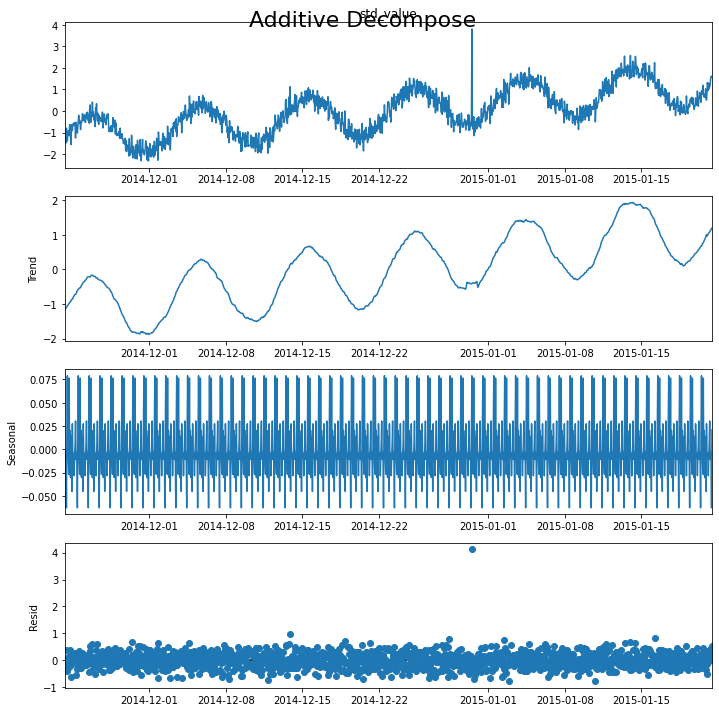


 76%|███████▌  | 76/100 [01:19<00:25,  1.06s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 1
                           value  is_anomaly  std_value
timestamp                                              
2014-12-30 12:00:00  7435.867212           1   3.802306
Detected outliers: 40
Outliers:
               timestamp     resid
55   2014-11-25 14:00:00  0.517567
60   2014-11-25 19:00:00  0.614923
69   2014-11-26 04:00:00  0.590716
146  2014-11-29 09:00:00  0.694524
159  2014-11-29 22:00:00  0.543656
165  2014-11-30 04:00:00  0.536474
205  2014-12-01 20:00:00  0.627948
273  2014-12-04 16:00:00  0.645113
349  2014-12-07 20:00:00  0.549436
379  2014-12-09 02:00:00  0.500597
461  2014-12-12 12:00:00  0.526241
484  2014-12-13 11:00:00  0.556601
485  2014-12-13 12:00:00  0.531224
491  2014-12-13 18:00:00  0.599198
494  2014-12-13 21:00:00  0.975157
608  2014-12-18 15:00:00  0.568389
614  2014-12-18 21:00:00  0.697070
652  2014-12-20 11:00:00  0.555131
669  2014-12-21 04:00:00  0.647428
756  2014-12-24 19:00:00  0.565976
815  2014-12

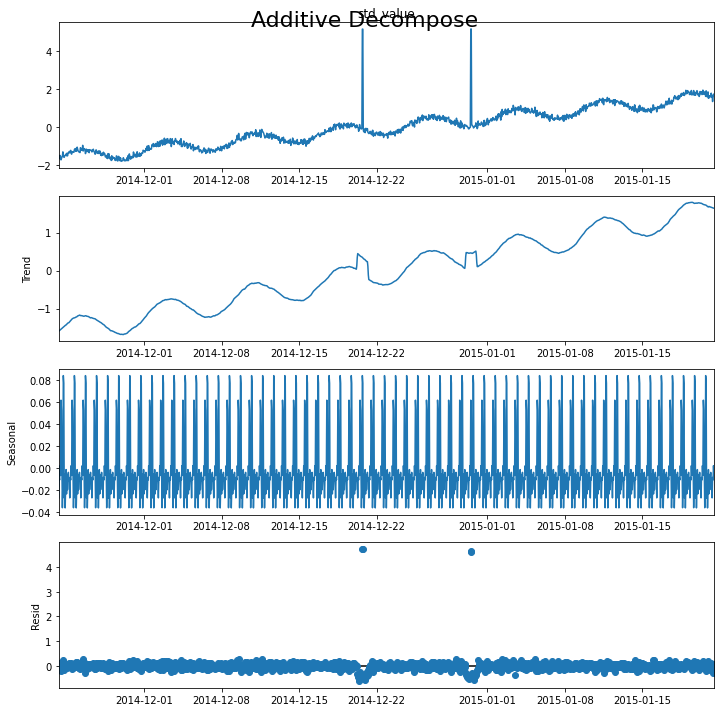


 77%|███████▋  | 77/100 [01:20<00:24,  1.05s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 4
                            value  is_anomaly  std_value
timestamp                                               
2014-12-20 17:00:00  27200.959593           1   5.143563
2014-12-20 18:00:00  27200.959593           1   5.143563
2014-12-30 12:00:00  27220.140302           1   5.148342
2014-12-30 13:00:00  27220.140302           1   5.148342
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  4.710554
659 2014-12-20 18:00:00  4.731673
893 2014-12-30 12:00:00  4.620442
894 2014-12-30 13:00:00  4.631571
--------------------
Mean: 853.154308, StandardDeviation: 1095.773774
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   368.696606           0
1    2014-11-23 08:00:00   -55.416317           0
2    2014-11-23 09:00:00   464.803666           0
3    2014-11-23 10:00:00   486.371135           0
4    2014-11-23 11:00:00   274.938478           0
...                  ...          

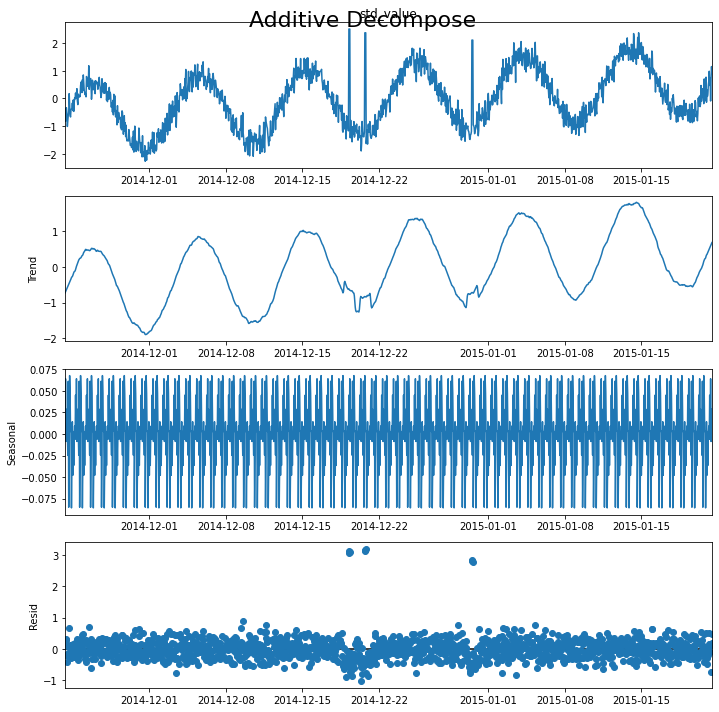


 78%|███████▊  | 78/100 [01:21<00:23,  1.05s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 9
                           value  is_anomaly  std_value
timestamp                                              
2014-12-19 06:00:00  3599.566321           1   2.506368
2014-12-19 07:00:00  3599.566321           1   2.506368
2014-12-19 08:00:00  3599.566321           1   2.506368
2014-12-20 17:00:00  3449.742128           1   2.369639
2014-12-20 18:00:00  3449.742128           1   2.369639
2014-12-20 19:00:00  3449.742128           1   2.369639
2014-12-30 12:00:00  3161.305435           1   2.106412
2014-12-30 13:00:00  3161.305435           1   2.106412
2014-12-30 14:00:00  3161.305435           1   2.106412
Detected outliers: 43
Outliers:
               timestamp     resid
9    2014-11-23 16:00:00  0.660854
52   2014-11-25 11:00:00  0.713651
153  2014-11-29 16:00:00  0.612984
162  2014-11-30 01:00:00  0.618318
229  2014-12-02 20:00:00  0.565982
265  2014-12-04 08:00:00  0.581557
303  2014-12-05 22:00:00  0.583048
387  2014-12-09 10:

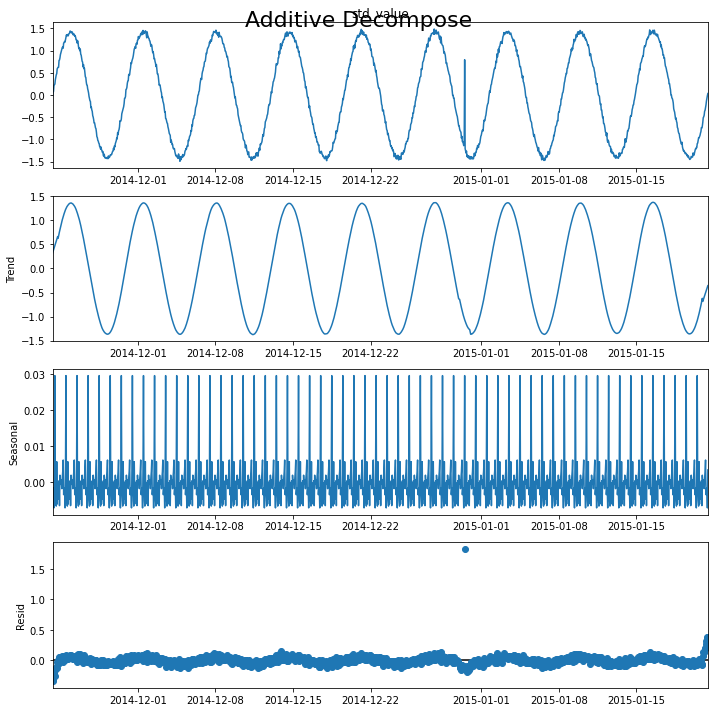


 79%|███████▉  | 79/100 [01:22<00:21,  1.05s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 1
                          value  is_anomaly  std_value
timestamp                                             
2014-12-30 12:00:00  791.823067           1   0.794893
Detected outliers: 1
Outliers:
              timestamp     resid
893 2014-12-30 12:00:00  1.830217
--------------------
Mean: 1157.094306, StandardDeviation: 1176.287387
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00  -168.140907           0
1    2014-11-23 08:00:00   108.760965           0
2    2014-11-23 09:00:00  -110.184562           0
3    2014-11-23 10:00:00   605.692436           0
4    2014-11-23 11:00:00   319.503909           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  2104.695898           0
1417 2015-01-21 08:00:00  2436.810321           0
1418 2015-01-21 09:00:00  2549.139075           0
1419 2015-01-21 10:00:00  2603.690676           0
1420 2015-01-21 11:00:00  2578.819872           0

[1421 rows 

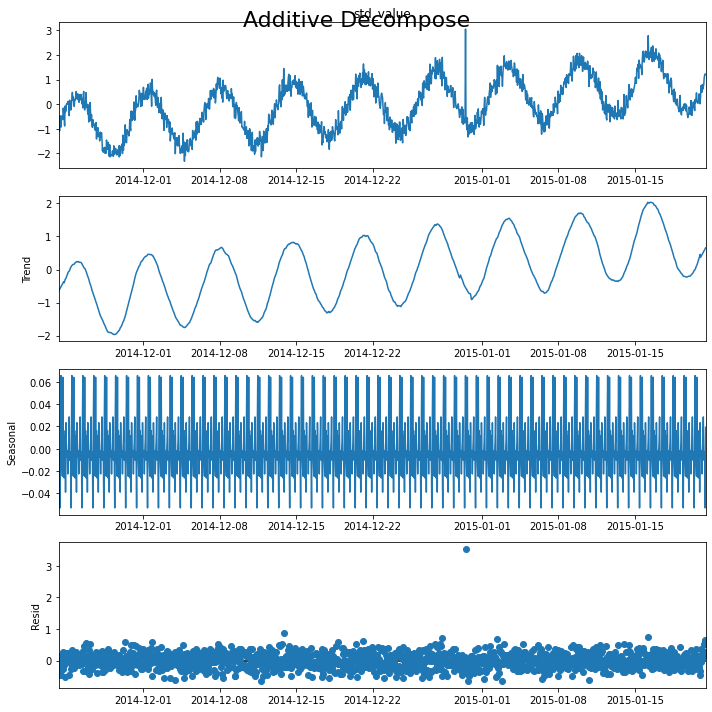


 80%|████████  | 80/100 [01:24<00:21,  1.07s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 1
                           value  is_anomaly  std_value
timestamp                                              
2014-12-30 12:00:00  4749.512233           1   3.054031
Detected outliers: 24
Outliers:
               timestamp     resid
60   2014-11-25 19:00:00  0.544487
69   2014-11-26 04:00:00  0.508661
146  2014-11-29 09:00:00  0.584630
205  2014-12-01 20:00:00  0.592068
349  2014-12-07 20:00:00  0.512985
491  2014-12-13 18:00:00  0.537922
494  2014-12-13 21:00:00  0.862443
614  2014-12-18 21:00:00  0.577672
652  2014-12-20 11:00:00  0.522099
669  2014-12-21 04:00:00  0.610723
827  2014-12-27 18:00:00  0.530103
836  2014-12-28 03:00:00  0.521304
842  2014-12-28 09:00:00  0.716404
893  2014-12-30 12:00:00  3.533404
963  2015-01-02 10:00:00  0.671506
978  2015-01-03 01:00:00  0.520863
1019 2015-01-04 18:00:00  0.527582
1241 2015-01-14 00:00:00  0.517555
1252 2015-01-14 11:00:00  0.506539
1294 2015-01-16 05:00:00  0.743587
1417 2015-01

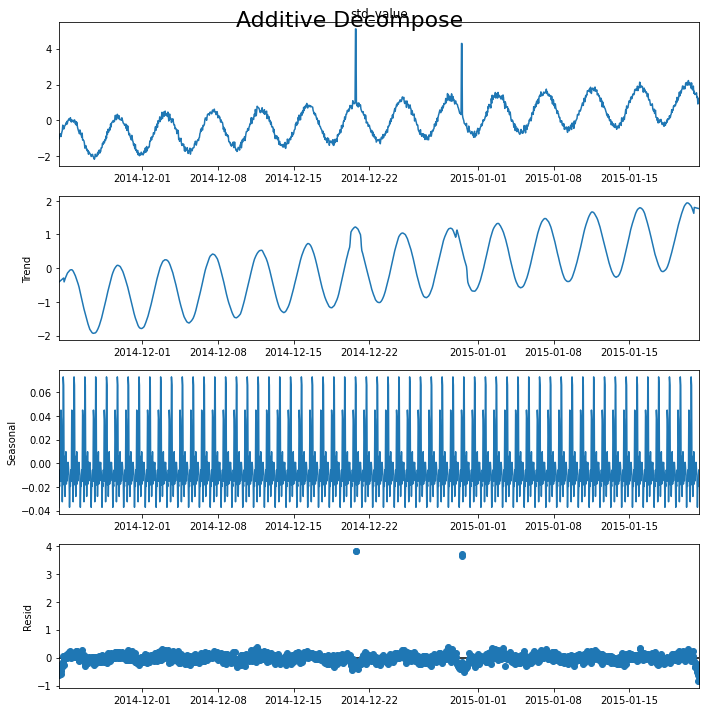


 81%|████████  | 81/100 [01:25<00:20,  1.06s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 4
                           value  is_anomaly  std_value
timestamp                                              
2014-12-20 17:00:00  8056.267028           1   5.100373
2014-12-20 18:00:00  8056.267028           1   5.100373
2014-12-30 12:00:00  6995.828286           1   4.287849
2014-12-30 13:00:00  6995.828286           1   4.287849
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  3.805289
659 2014-12-20 18:00:00  3.820420
893 2014-12-30 12:00:00  3.626537
894 2014-12-30 13:00:00  3.694080
--------------------
Mean: 110.688388, StandardDeviation: 1004.712332
               timestamp       value  is_anomaly
0    2014-11-23 07:00:00  -94.438119           0
1    2014-11-23 08:00:00   65.206727           0
2    2014-11-23 09:00:00  -51.409349           0
3    2014-11-23 10:00:00  352.899591           0
4    2014-11-23 11:00:00  198.930979           0
...                  ...         ...         .

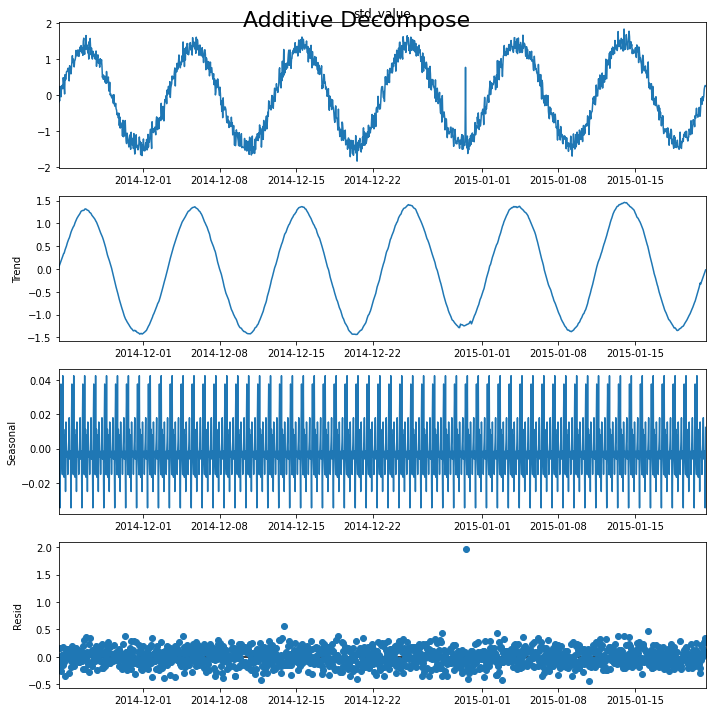


 82%|████████▏ | 82/100 [01:26<00:18,  1.05s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 1
                          value  is_anomaly  std_value
timestamp                                             
2014-12-30 12:00:00  884.662693           1   0.770344
Detected outliers: 2
Outliers:
              timestamp     resid
494 2014-12-13 21:00:00  0.553079
893 2014-12-30 12:00:00  1.964553
--------------------
Mean: 718.816759, StandardDeviation: 1066.877174
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   -37.249650           0
1    2014-11-23 08:00:00    96.708895           0
2    2014-11-23 09:00:00   118.777788           0
3    2014-11-23 10:00:00   350.712533           0
4    2014-11-23 11:00:00   356.259486           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  1701.825808           0
1417 2015-01-21 08:00:00  1682.957812           0
1418 2015-01-21 09:00:00  1613.668049           0
1419 2015-01-21 10:00:00  1530.738129           0
1420 2015-01-21 11:00:00  142

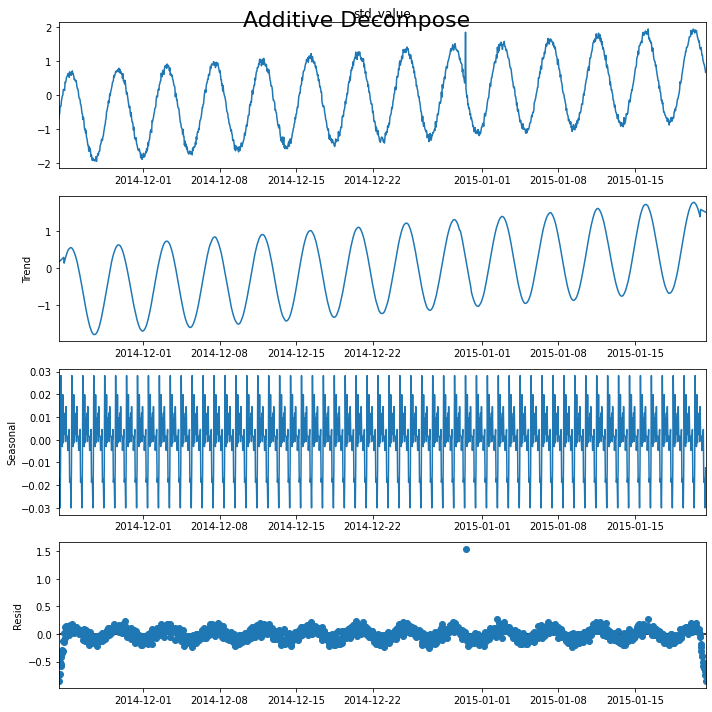


 83%|████████▎ | 83/100 [01:27<00:17,  1.04s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 1
                           value  is_anomaly  std_value
timestamp                                              
2014-12-30 12:00:00  2694.949687           1   1.852259
Detected outliers: 1
Outliers:
              timestamp     resid
893 2014-12-30 12:00:00  1.542453
--------------------
Mean: 1922.216751, StandardDeviation: 1465.779085
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   -54.392175           0
1    2014-11-23 08:00:00    68.393431           0
2    2014-11-23 09:00:00    24.655299           0
3    2014-11-23 10:00:00   294.781422           0
4    2014-11-23 11:00:00   228.356210           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  3897.564124           0
1417 2015-01-21 08:00:00  3946.470911           0
1418 2015-01-21 09:00:00  3921.333053           0
1419 2015-01-21 10:00:00  3876.632454           0
1420 2015-01-21 11:00:00  3805.181508           0

[1421 ro

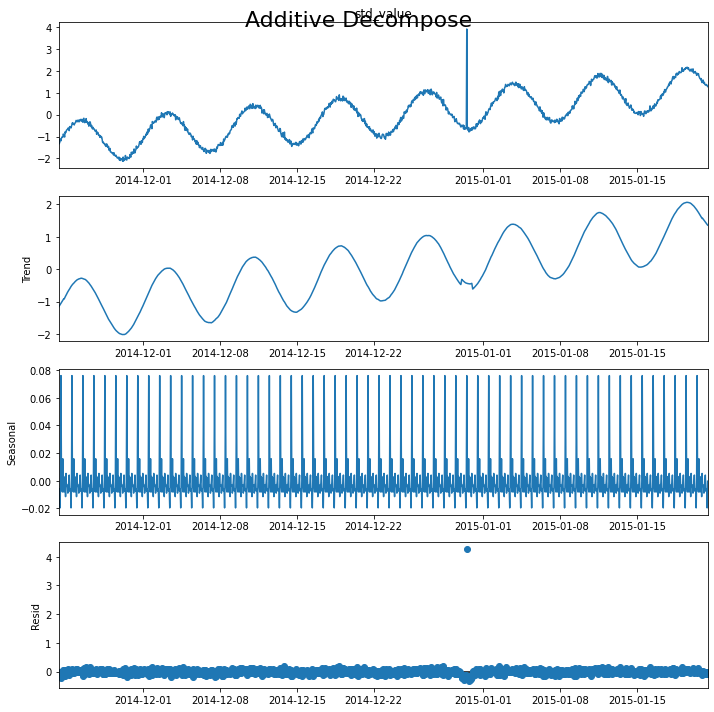


 84%|████████▍ | 84/100 [01:28<00:16,  1.04s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 1
                           value  is_anomaly  std_value
timestamp                                              
2014-12-30 12:00:00  7660.907073           1   3.915113
Detected outliers: 1
Outliers:
              timestamp     resid
893 2014-12-30 12:00:00  4.272283
--------------------
Mean: 15071.243554, StandardDeviation: 8998.690990
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00    640.999679           0
1    2014-11-23 08:00:00    -90.528068           0
2    2014-11-23 09:00:00    771.336286           0
3    2014-11-23 10:00:00    791.897883           0
4    2014-11-23 11:00:00    419.421134           0
...                  ...           ...         ...
1416 2015-01-21 07:00:00  29925.519117           0
1417 2015-01-21 08:00:00  28345.333133           0
1418 2015-01-21 09:00:00  29767.656950           0
1419 2015-01-21 10:00:00  30499.610657           0
1420 2015-01-21 11:00:00  29932.416867         

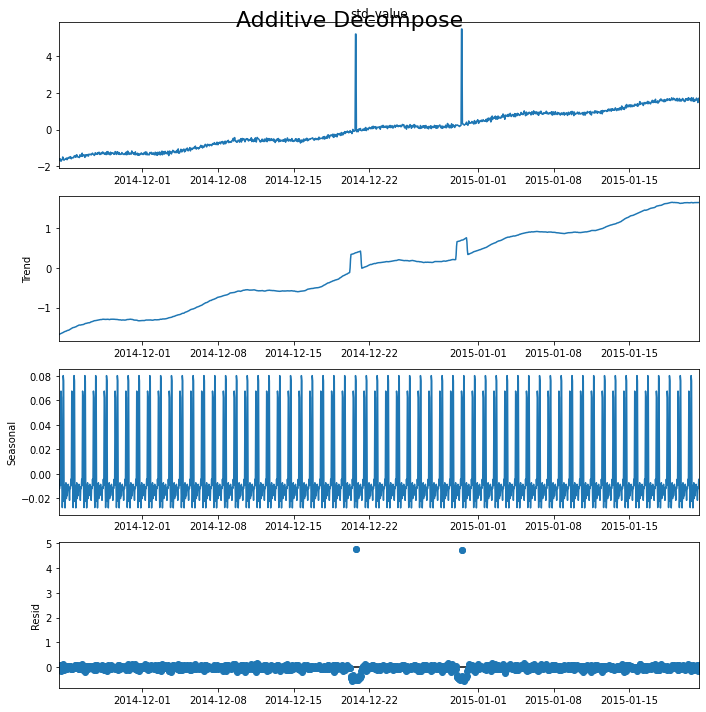


 85%|████████▌ | 85/100 [01:29<00:15,  1.04s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 4
                            value  is_anomaly  std_value
timestamp                                               
2014-12-20 17:00:00  61998.921404           1   5.214945
2014-12-20 18:00:00  61998.921404           1   5.214945
2014-12-30 12:00:00  64477.228828           1   5.490352
2014-12-30 13:00:00  64477.228828           1   5.490352
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  4.758547
659 2014-12-20 18:00:00  4.761013
893 2014-12-30 12:00:00  4.729836
894 2014-12-30 13:00:00  4.732728
--------------------
Mean: 11272.001575, StandardDeviation: 6995.543247
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00    458.788450           0
1    2014-11-23 08:00:00    -18.504074           0
2    2014-11-23 09:00:00    643.135392           0
3    2014-11-23 10:00:00    703.090210           0
4    2014-11-23 11:00:00    481.678563           0
...                  ...  

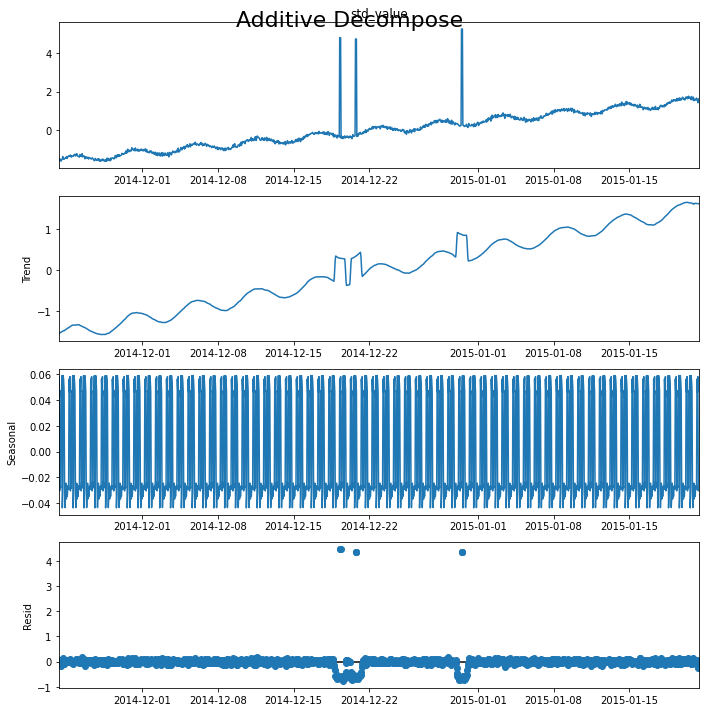


 86%|████████▌ | 86/100 [01:30<00:14,  1.06s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 9
                            value  is_anomaly  std_value
timestamp                                               
2014-12-19 06:00:00  44876.111260           1   4.803645
2014-12-19 07:00:00  44876.111260           1   4.803645
2014-12-19 08:00:00  44876.111260           1   4.803645
2014-12-20 17:00:00  44396.821024           1   4.735132
2014-12-20 18:00:00  44396.821024           1   4.735132
2014-12-20 19:00:00  44396.821024           1   4.735132
2014-12-30 12:00:00  48045.479149           1   5.256701
2014-12-30 13:00:00  48045.479149           1   5.256701
2014-12-30 14:00:00  48045.479149           1   5.256701
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  4.454777
624 2014-12-19 07:00:00  4.470032
625 2014-12-19 08:00:00  4.461186
658 2014-12-20 17:00:00  4.339065
659 2014-12-20 18:00:00  4.337664
660 2014-12-20 19:00:00  4.339593
893 2014-12-30 12:00:00  4.339371
894 2014-12-30 13

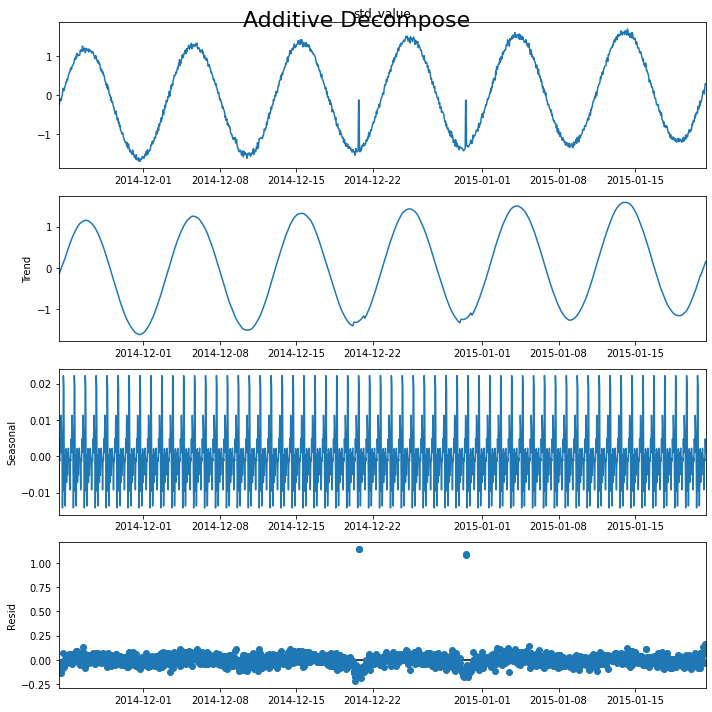


 87%|████████▋ | 87/100 [01:31<00:13,  1.05s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 4
                          value  is_anomaly  std_value
timestamp                                             
2014-12-20 17:00:00  140.244145           1  -0.124858
2014-12-20 18:00:00  140.244145           1  -0.124858
2014-12-30 12:00:00  134.430414           1  -0.130792
2014-12-30 13:00:00  134.430414           1  -0.130792
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  1.144246
659 2014-12-20 18:00:00  1.141995
893 2014-12-30 12:00:00  1.086840
894 2014-12-30 13:00:00  1.085649
--------------------
Mean: 7282.327986, StandardDeviation: 4298.843109
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00   -122.097268           0
1    2014-11-23 08:00:00     86.791975           0
2    2014-11-23 09:00:00    -90.326707           0
3    2014-11-23 10:00:00    460.520779           0
4    2014-11-23 11:00:00    231.335134           0
...                  ...           ... 

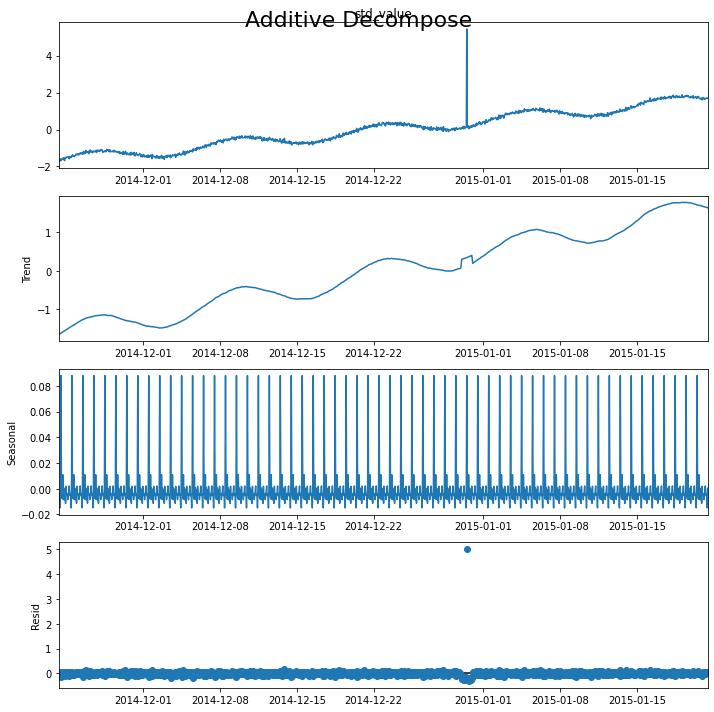


 88%|████████▊ | 88/100 [01:32<00:12,  1.03s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 1
                            value  is_anomaly  std_value
timestamp                                               
2014-12-30 12:00:00  30692.054083           1   5.445587
Detected outliers: 1
Outliers:
              timestamp     resid
893 2014-12-30 12:00:00  5.013185
--------------------
Mean: 7759.722960, StandardDeviation: 4605.211318
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00    214.160410           0
1    2014-11-23 08:00:00     52.704556           0
2    2014-11-23 09:00:00    413.431028           0
3    2014-11-23 10:00:00    497.704475           0
4    2014-11-23 11:00:00    452.220472           0
...                  ...           ...         ...
1416 2015-01-21 07:00:00  15740.289585           0
1417 2015-01-21 08:00:00  15153.441463           0
1418 2015-01-21 09:00:00  15550.243734           0
1419 2015-01-21 10:00:00  15720.084135           0
1420 2015-01-21 11:00:00  15463.636646       

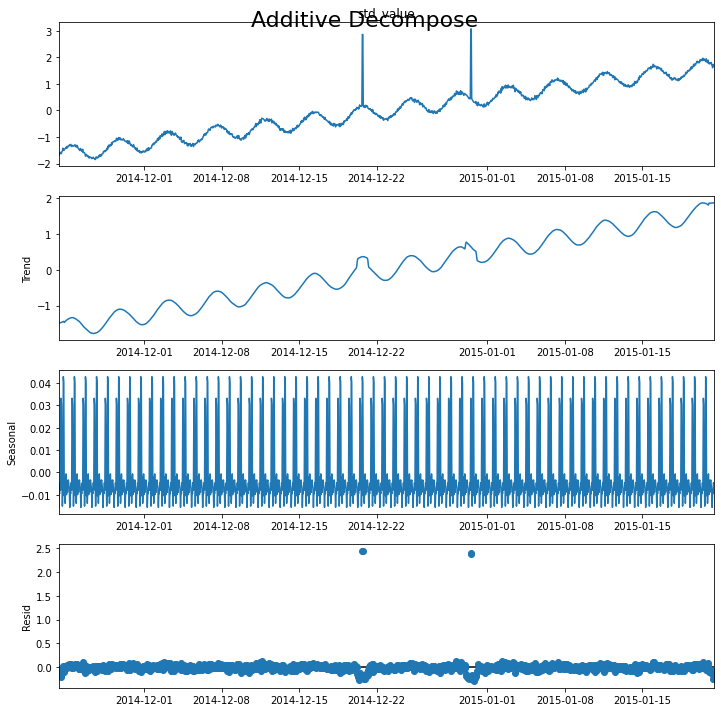


 89%|████████▉ | 89/100 [01:33<00:11,  1.02s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 4
                            value  is_anomaly  std_value
timestamp                                               
2014-12-20 17:00:00  20933.121675           1   2.860542
2014-12-20 18:00:00  20933.121675           1   2.860542
2014-12-30 12:00:00  21890.413264           1   3.068413
2014-12-30 13:00:00  21890.413264           1   3.068413
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  2.449250
659 2014-12-20 18:00:00  2.452510
893 2014-12-30 12:00:00  2.385978
894 2014-12-30 13:00:00  2.404010
--------------------
Mean: 9260.052047, StandardDeviation: 5432.702685
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00   -175.593664           0
1    2014-11-23 08:00:00    164.793093           0
2    2014-11-23 09:00:00    -45.758379           0
3    2014-11-23 10:00:00    781.599526           0
4    2014-11-23 11:00:00    495.365852           0
...                  ...   

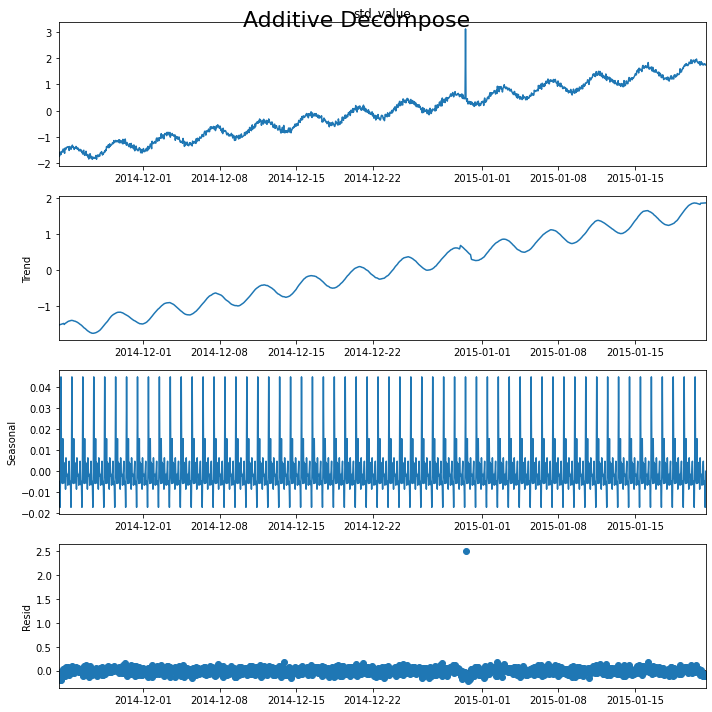


 90%|█████████ | 90/100 [01:34<00:10,  1.01s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 1
                            value  is_anomaly  std_value
timestamp                                               
2014-12-30 12:00:00  26151.794914           1   3.109271
Detected outliers: 1
Outliers:
              timestamp     resid
893 2014-12-30 12:00:00  2.506382
--------------------
Processing index: 90 of 100
Mean: 5334.901872, StandardDeviation: 3432.132309
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00    677.940893           0
1    2014-11-23 08:00:00    -93.584734           0
2    2014-11-23 09:00:00    857.961277           0
3    2014-11-23 10:00:00    899.410177           0
4    2014-11-23 11:00:00    515.417384           0
...                  ...           ...         ...
1416 2015-01-21 07:00:00  10851.720278           0
1417 2015-01-21 08:00:00   9093.416508           0
1418 2015-01-21 09:00:00  10581.842259           0
1419 2015-01-21 10:00:00  11323.399484           0
1420 2015-01-21 1

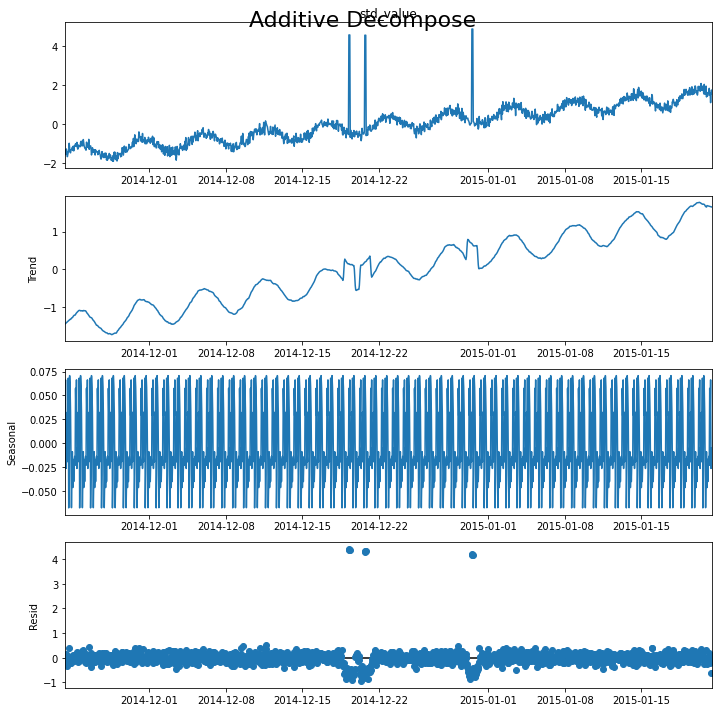


 91%|█████████ | 91/100 [01:35<00:09,  1.02s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 9
                            value  is_anomaly  std_value
timestamp                                               
2014-12-19 06:00:00  21057.786852           1   4.581084
2014-12-19 07:00:00  21057.786852           1   4.581084
2014-12-19 08:00:00  21057.786852           1   4.581084
2014-12-20 17:00:00  21012.156506           1   4.567789
2014-12-20 18:00:00  21012.156506           1   4.567789
2014-12-20 19:00:00  21012.156506           1   4.567789
2014-12-30 12:00:00  22106.473333           1   4.886633
2014-12-30 13:00:00  22106.473333           1   4.886633
2014-12-30 14:00:00  22106.473333           1   4.886633
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  4.371079
624 2014-12-19 07:00:00  4.412580
625 2014-12-19 08:00:00  4.383229
658 2014-12-20 17:00:00  4.302594
659 2014-12-20 18:00:00  4.309125
660 2014-12-20 19:00:00  4.326478
893 2014-12-30 12:00:00  4.170161
894 2014-12-30 13

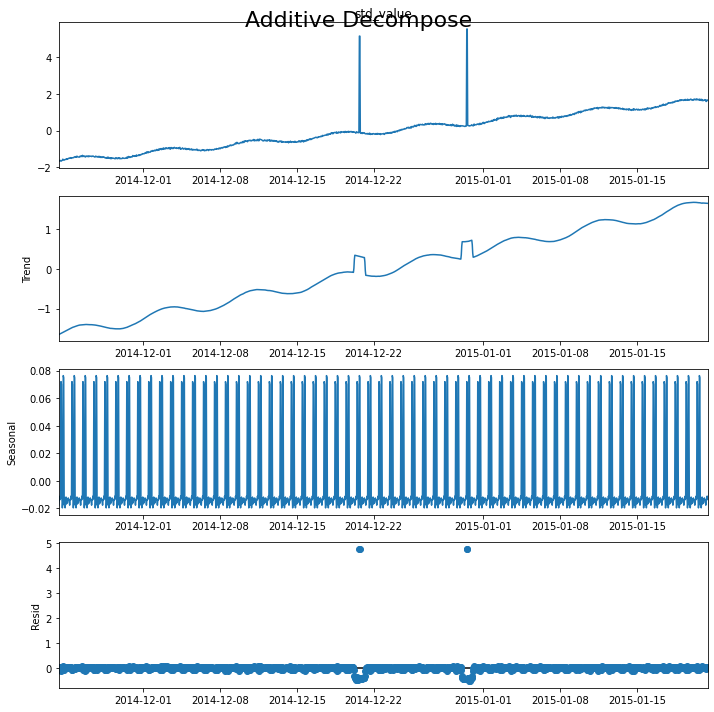


 92%|█████████▏| 92/100 [01:36<00:08,  1.04s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 4
                            value  is_anomaly  std_value
timestamp                                               
2014-12-20 17:00:00  62523.840007           1   5.133387
2014-12-20 18:00:00  62523.840007           1   5.133387
2014-12-30 12:00:00  66062.998024           1   5.518660
2014-12-30 13:00:00  66062.998024           1   5.518660
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  4.736917
659 2014-12-20 18:00:00  4.742197
893 2014-12-30 12:00:00  4.751705
894 2014-12-30 13:00:00  4.752863
--------------------
Mean: 68.708294, StandardDeviation: 984.090053
               timestamp       value  is_anomaly
0    2014-11-23 07:00:00  102.389668           0
1    2014-11-23 08:00:00   10.919611           0
2    2014-11-23 09:00:00  182.286204           0
3    2014-11-23 10:00:00  214.814822           0
4    2014-11-23 11:00:00  182.431083           0
...                  ...         ...      

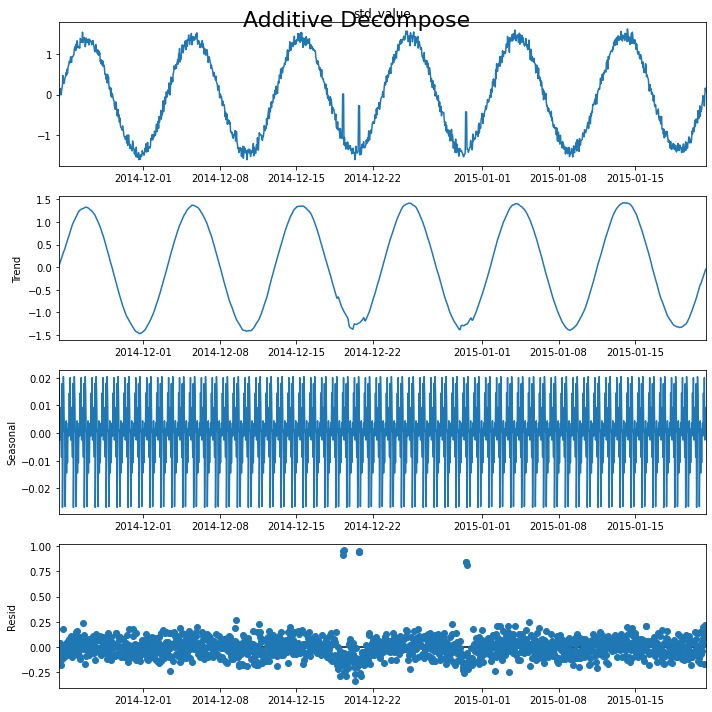


 93%|█████████▎| 93/100 [01:37<00:07,  1.04s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 9
                          value  is_anomaly  std_value
timestamp                                             
2014-12-19 06:00:00   81.907262           1   0.013412
2014-12-19 07:00:00   81.907262           1   0.013412
2014-12-19 08:00:00   81.907262           1   0.013412
2014-12-20 17:00:00 -200.412605           1  -0.273472
2014-12-20 18:00:00 -200.412605           1  -0.273472
2014-12-20 19:00:00 -200.412605           1  -0.273472
2014-12-30 12:00:00 -350.861078           1  -0.426353
2014-12-30 13:00:00 -350.861078           1  -0.426353
2014-12-30 14:00:00 -350.861078           1  -0.426353
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  0.915958
624 2014-12-19 07:00:00  0.956065
625 2014-12-19 08:00:00  0.957762
658 2014-12-20 17:00:00  0.943694
659 2014-12-20 18:00:00  0.947189
660 2014-12-20 19:00:00  0.955691
893 2014-12-30 12:00:00  0.842431
894 2014-12-30 13:00:00  0.846480
895 2

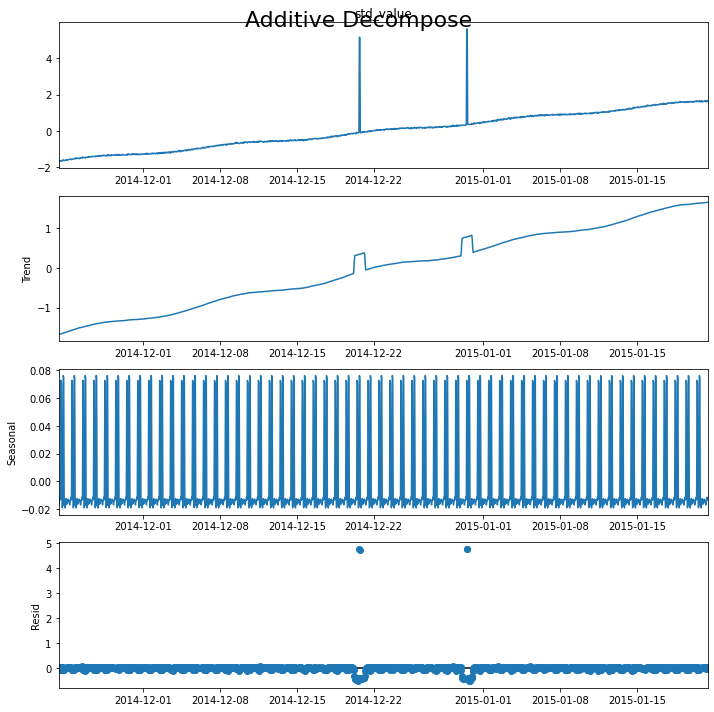


 94%|█████████▍| 94/100 [01:38<00:06,  1.04s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 4
                             value  is_anomaly  std_value
timestamp                                                
2014-12-20 17:00:00  120384.144301           1   5.157234
2014-12-20 18:00:00  120384.144301           1   5.157234
2014-12-30 12:00:00  128420.057623           1   5.613527
2014-12-30 13:00:00  128420.057623           1   5.613527
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  4.743414
659 2014-12-20 18:00:00  4.742174
893 2014-12-30 12:00:00  4.766111
894 2014-12-30 13:00:00  4.765214
--------------------
Mean: 1607.222200, StandardDeviation: 1324.676696
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   256.096341           0
1    2014-11-23 08:00:00    -5.350374           0
2    2014-11-23 09:00:00   385.403805           0
3    2014-11-23 10:00:00   431.587446           0
4    2014-11-23 11:00:00   316.622499           0
...                  ...   

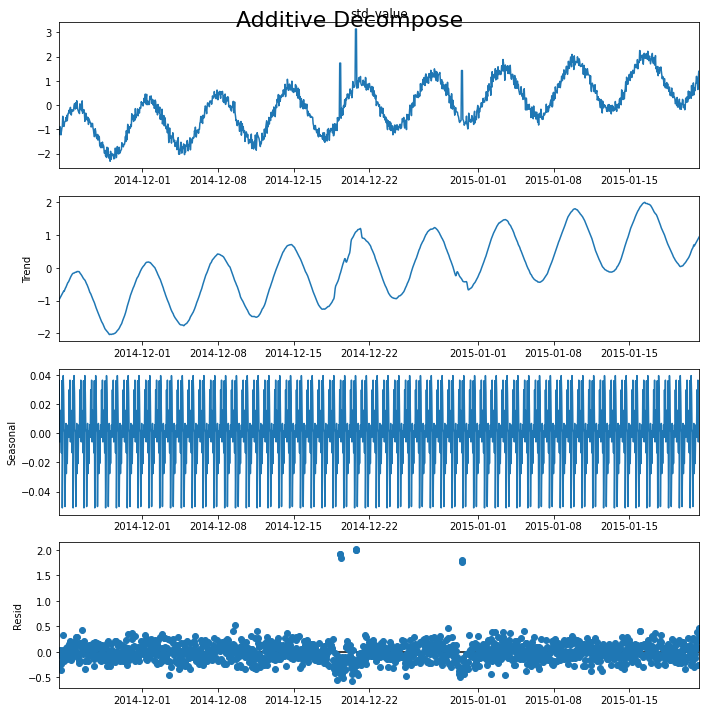


 95%|█████████▌| 95/100 [01:39<00:05,  1.04s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 9
                           value  is_anomaly  std_value
timestamp                                              
2014-12-19 06:00:00  3897.820150           1   1.729175
2014-12-19 07:00:00  3897.820150           1   1.729175
2014-12-19 08:00:00  3897.820150           1   1.729175
2014-12-20 17:00:00  5758.265973           1   3.133628
2014-12-20 18:00:00  5758.265973           1   3.133628
2014-12-20 19:00:00  5758.265973           1   3.133628
2014-12-30 12:00:00  3493.343719           1   1.423835
2014-12-30 13:00:00  3493.343719           1   1.423835
2014-12-30 14:00:00  3493.343719           1   1.423835
Detected outliers: 10
Outliers:
              timestamp     resid
390 2014-12-09 13:00:00  0.527601
623 2014-12-19 06:00:00  1.922157
624 2014-12-19 07:00:00  1.912750
625 2014-12-19 08:00:00  1.832528
658 2014-12-20 17:00:00  2.005452
659 2014-12-20 18:00:00  2.005576
660 2014-12-20 19:00:00  2.017938
893 2014-12-30 12:00:00  1.

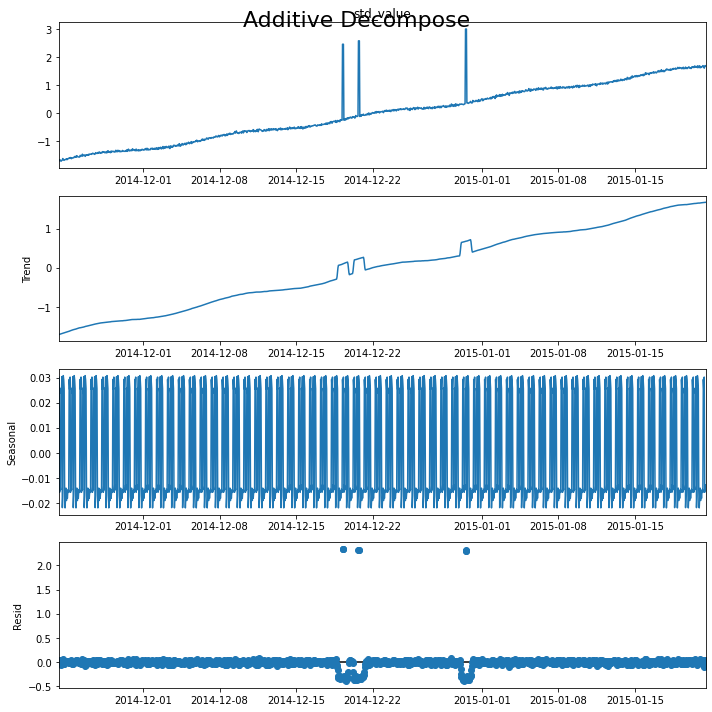


 96%|█████████▌| 96/100 [01:40<00:04,  1.04s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 9
                            value  is_anomaly  std_value
timestamp                                               
2014-12-19 06:00:00  75978.316449           1   2.462040
2014-12-19 07:00:00  75978.316449           1   2.462040
2014-12-19 08:00:00  75978.316449           1   2.462040
2014-12-20 17:00:00  78179.272273           1   2.582976
2014-12-20 18:00:00  78179.272273           1   2.582976
2014-12-20 19:00:00  78179.272273           1   2.582976
2014-12-30 12:00:00  85883.748857           1   3.006316
2014-12-30 13:00:00  85883.748857           1   3.006316
2014-12-30 14:00:00  85883.748857           1   3.006316
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  2.338564
624 2014-12-19 07:00:00  2.338881
625 2014-12-19 08:00:00  2.329610
658 2014-12-20 17:00:00  2.322031
659 2014-12-20 18:00:00  2.321229
660 2014-12-20 19:00:00  2.322042
893 2014-12-30 12:00:00  2.306172
894 2014-12-30 13

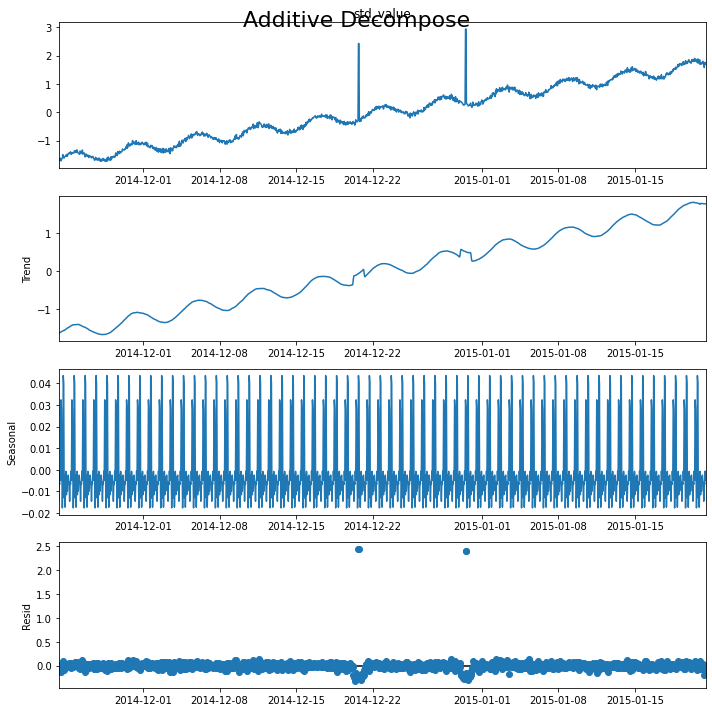


 97%|█████████▋| 97/100 [01:41<00:03,  1.03s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 4
                            value  is_anomaly  std_value
timestamp                                               
2014-12-20 17:00:00  26360.700612           1   2.423693
2014-12-20 18:00:00  26360.700612           1   2.423693
2014-12-30 12:00:00  29626.623067           1   2.935572
2014-12-30 13:00:00  29626.623067           1   2.935572
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  2.444009
659 2014-12-20 18:00:00  2.441041
893 2014-12-30 12:00:00  2.391470
894 2014-12-30 13:00:00  2.401846
--------------------
Mean: 24127.274833, StandardDeviation: 13995.205958
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00    161.207269           0
1    2014-11-23 08:00:00     62.222465           0
2    2014-11-23 09:00:00    290.993857           0
3    2014-11-23 10:00:00    346.689493           0
4    2014-11-23 11:00:00    321.509781           0
...                  ... 

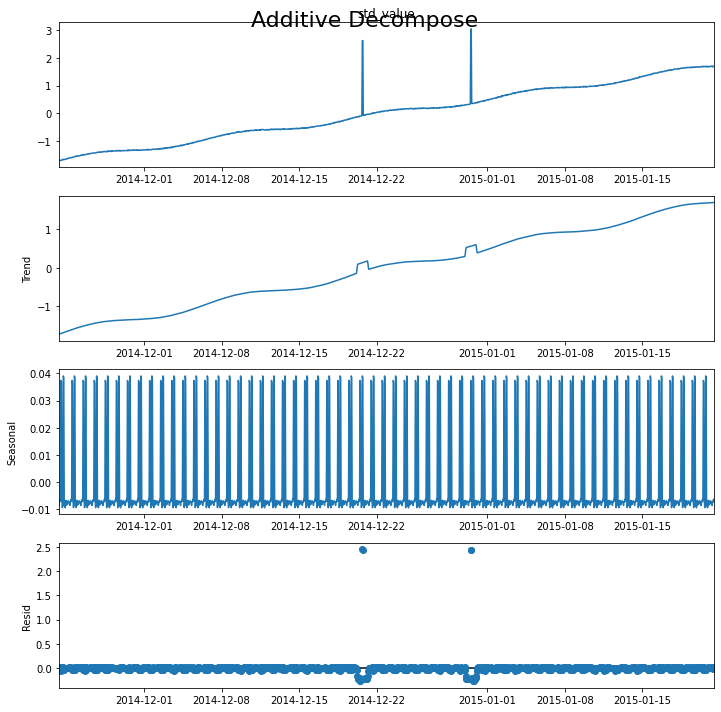


 98%|█████████▊| 98/100 [01:42<00:02,  1.05s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 4
                            value  is_anomaly  std_value
timestamp                                               
2014-12-20 17:00:00  60829.210260           1   2.622465
2014-12-20 18:00:00  60829.210260           1   2.622465
2014-12-30 12:00:00  66715.645056           1   3.043068
2014-12-30 13:00:00  66715.645056           1   3.043068
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  2.446297
659 2014-12-20 18:00:00  2.443243
893 2014-12-30 12:00:00  2.442789
894 2014-12-30 13:00:00  2.440352
--------------------
Mean: 956.270534, StandardDeviation: 1118.566136
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   166.780675           0
1    2014-11-23 08:00:00    15.668229           0
2    2014-11-23 09:00:00   289.591259           0
3    2014-11-23 10:00:00   338.881930           0
4    2014-11-23 11:00:00   283.053269           0
...                  ...          

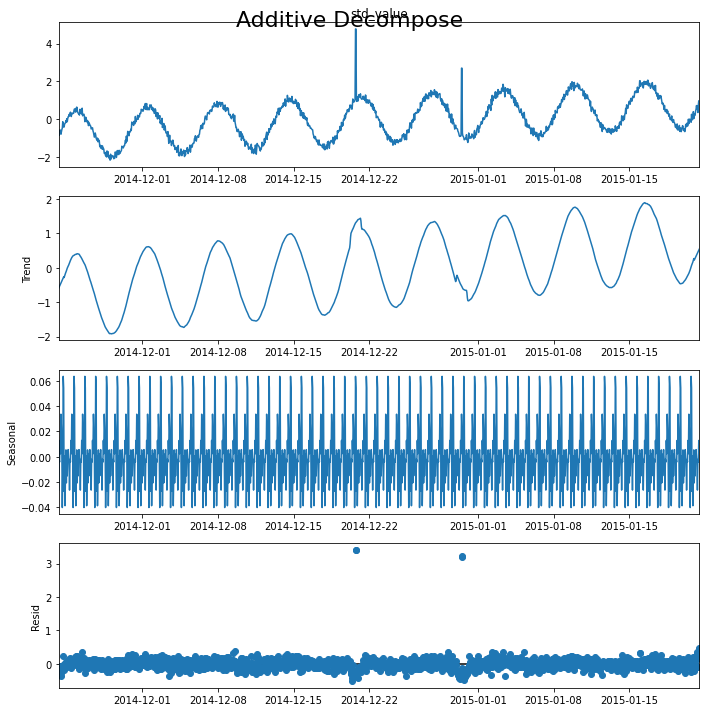


 99%|█████████▉| 99/100 [01:43<00:01,  1.05s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 4
                           value  is_anomaly  std_value
timestamp                                              
2014-12-20 17:00:00  6292.132401           1   4.770269
2014-12-20 18:00:00  6292.132401           1   4.770269
2014-12-30 12:00:00  3980.446956           1   2.703619
2014-12-30 13:00:00  3980.446956           1   2.703619
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  3.402556
659 2014-12-20 18:00:00  3.395093
893 2014-12-30 12:00:00  3.195482
894 2014-12-30 13:00:00  3.232765
--------------------
Mean: 18212.607413, StandardDeviation: 10619.940943
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00   -181.874566           0
1    2014-11-23 08:00:00    158.200876           0
2    2014-11-23 09:00:00   -107.295997           0
3    2014-11-23 10:00:00    769.114909           0
4    2014-11-23 11:00:00    421.770693           0
...                  ...       

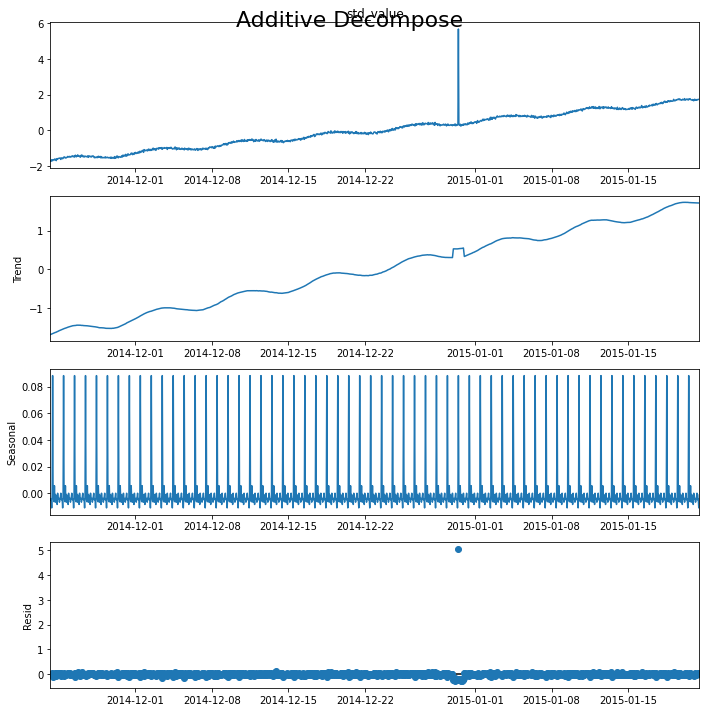


100%|██████████| 100/100 [01:44<00:00,  1.05s/it]



File: A2Benchmark
threshold:0.5
Actual Outliers: 1
                            value  is_anomaly  std_value
timestamp                                               
2014-12-30 12:00:00  78542.938225           1   5.680854
Detected outliers: 1
Outliers:
              timestamp    resid
893 2014-12-30 12:00:00  5.06255
--------------------
STL Additive decomposition of Yahoo S5 A2 Benchmark processing complete. Time taken:0:01:44.755448
[0.10126582278481014, 1.0, 0.25, 0.2285714285714286, 0.4186046511627907, 0.34782608695652173, 1.0, 1.0, 0.27692307692307694, 0.8571428571428571, 0.021276595744680854, 0.23076923076923078, 1.0, 1.0, 1.0, 0.8571428571428571, 1.0, 0.9, 1.0, 0.8571428571428571, 0.8, 0.33333333333333337, 0.01234567901234568, 1.0, 1.0, 0.012903225806451613, 1.0, 1.0, 0.375, 1.0, 1.0, 1.0, 1.0, 1.0, 0.4, 1.0, 1.0, 0.11594202898550725, 0.6666666666666666, 1.0, 0.038461538461538464, 0.782608695652174, 0.06666666666666667, 1.0, 0.0136986301369863, 1.0, 0.25, 1.0, 1.0, 1.0, 1.0, 1

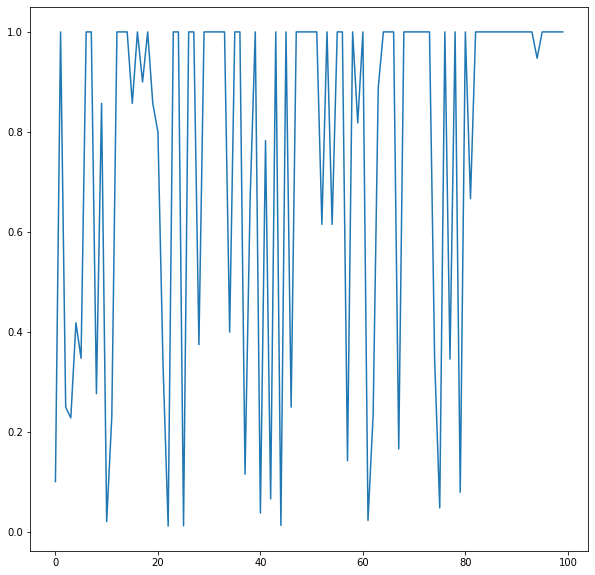

In [ ]:
from tqdm import tqdm
start_time = datetime.now() 
f1_plot = []
recall_plot = []
precision_plot = []

for index,file in enumerate(tqdm(all_csv)):
    if index%10 == 0:
        print(f'Processing index: {index} of {len(all_csv)}')
#     if index > 30:
#         break
    fname = file.split("/")[5].replace('\\','').split(".")[0]
    df = pd.read_csv(file)
    df['timestamp'] = pd.to_datetime(df['timestamp'],unit='s')
    df_indexed = df.set_index('timestamp')
    
    # prepare data for standardization
    values = df_indexed.copy()
    values = values.drop(columns=['is_anomaly'],axis=1)
    #values = values.reshape((len(values), 1))
    
    # train the standardization
    scaler2 = StandardScaler()
    scaler2 = scaler2.fit(values)
    print('Mean: %f, StandardDeviation: %f' % (scaler2.mean_, sqrt(scaler2.var_)))
    # standardize the dataset
    standardaized = scaler2.transform(values)
    
    #jugaad, change so that standardized is used from here on.
    # for i in range(len(df)):
    #     df_indexed['value'].iloc[i] = standardaized[i]
    df_indexed['std_value'] = standardaized
        
    print(df)
    result_add = seasonal_decompose(df_indexed['std_value'], model='additive', extrapolate_trend='freq')
    # Plot
    #plt.rcParams.update({'figure.figsize': (10,10)})
    #result_add.plot().suptitle('Additive Decompose', fontsize=22)
    #plt.savefig("/content/drive/My Drive/Colab Notebooks/tImeSeries-files/STLoutput/A2Benchmark_" + fname +"add_STL")
    #print("\n\n\nA2Benchmark_" + fname +"add_STL")
    #plt.show()
    
    threshold=0.3
    residualdf = result_add.resid
    residualdf = residualdf.reset_index()
    
    outliers = residualdf[residualdf.resid > threshold]
    not_outliers = residualdf.reset_index().merge(outliers, how = 'outer' ,indicator=True).loc[lambda x : x['_merge']=='left_only']
    anomalies = df_indexed.join(outliers.set_index('timestamp'),on='timestamp',how='inner')
    not_anomalies = df_indexed.join(not_outliers.set_index('timestamp'),on='timestamp',how='inner')
    #not_outliers = residualdf[residualdf < threshold]
    
    p = df_indexed.loc[df_indexed['is_anomaly'] == 1]
    
    n = df_indexed.loc[df_indexed['is_anomaly'] == 0]
    
    truepositives = anomalies.loc[anomalies['is_anomaly'] == 1]
    
    falsepositives = anomalies.loc[anomalies['is_anomaly'] == 0]
    
    truenegatives = not_anomalies.loc[not_anomalies['is_anomaly'] == 0]
    
    falsenegatives = not_anomalies.loc[not_anomalies['is_anomaly'] == 1]
    
    #Traditional FPR and TPR formmulae
    #tpr = truepositives.count()/(truepositives.count() + falsenegatives.count())
    #fpr = falsepositives.count()/(falsepositives.count() + truenegatives.count())
    
    #IDEAL Paper based TRP/FPR rates
    fpr = len(falsepositives)/len(n)
    tpr = len(truepositives)/len(p)
    fnr = 1-tpr
    tnr = 1-fpr
    
    # precision = len(truepositives)/(len(truepositives) + len(falsepositives))
    # recall = len(truepositives)/(len(truepositives) + len(falsenegatives))
    
    # f1 = 2 * (precision * recall)/(precision + recall)
    # f1_plot.append(f1)
    precision, recall,f1 = calc_stats(truepositives,falsepositives,truenegatives,falsenegatives)
    f1_plot.append(f1)
    precision_plot.append(precision)
    recall_plot.append(recall)
    
    with open("/content/drive/My Drive/Colab Notebooks/tImeSeries-files/STLoutput/"+ fname + ".txt", 'w') as file:
        file.write(f"\n\nFile: {fname}")
        file.write("\nthreshold: 500")
        file.write("\nOutliers:\n")
        file.write(outliers.to_csv())
        
        file.write("\n\n\n Statistics:")
        file.write(f"\ntrue positives:{len(truepositives)}")
        file.write(f"\nfalse positives:{len(falsepositives)}")
        file.write(f"\ntrue negatives:{len(truenegatives)}")
        file.write(f"\nfalse negatives:{len(falsenegatives)}")
        file.write(f"\nFPR:{fpr}")
        file.write(f"\nTPR:{tpr}")
        file.write(f"\nFNR:{fnr}")
        file.write(f"\nTNR:{tnr}")
        
        file.write(f"\nPrecision:{precision}")
        file.write(f"\nREcall:{recall}")
        file.write(f"\nF1:{f1}")
        
        
    print(f"\n\nFile: {fname}")
    print(f"threshold:{threshold}")
    print("Actual Outliers:", len(p))
    print(p)
    print("Detected outliers:", len(outliers))
    print("Outliers:")
    print(outliers)
    print("--------------------")
end_time=datetime.now()
print(f"STL Additive decomposition of Yahoo S5 A2 Benchmark processing complete. Time taken:{end_time-start_time}")
print(f1_plot)
plt.plot(f1_plot)

In [ ]:
import numpy as np 
np.mean(f1_plot),np.mean(precision_plot),np.mean(recall_plot)

(0.7615574683059201, 0.7251870075201022, 1.0)

In [ ]:
recall_plot

[1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0]

## new API standardized

In [ ]:
from tqdm import tqdm
start_time = datetime.now() 
f1_plot = []
for index,file in enumerate(tqdm(all_csv)):
    if index%10 == 0:
        print(f'Processing index: {index} of {len(all_csv)}')
#     if index > 30:
#         break
    fname = file.split("/")[6].replace('\\','').split(".")[0]
    df = pd.read_csv(file)
    df['timestamp'] = pd.to_datetime(df['timestamp'],unit='s')
    df_indexed = df.set_index('timestamp')
    
    # prepare data for standardization
    values = df_indexed.copy()
    values = values.drop(columns=['is_anomaly'],axis=1)
    #values = values.reshape((len(values), 1))
    
    # train the standardization
    scaler2 = StandardScaler()
    scaler2 = scaler2.fit(values)
    print('Mean: %f, StandardDeviation: %f' % (scaler2.mean_, sqrt(scaler2.var_)))
    # standardize the dataset
    standardaized = scaler2.transform(values)
    
    #jugaad, change so that standardized is used from here on.
    # for i in range(len(df)):
    #     df_indexed['value'].iloc[i] = standardaized[i]
    df_indexed['std_val'] = standardaized
        
    print(df)
    result_add = statsmodels.tsa.seasonal.STL(df_indexed['std_val']).fit(inner_iter=10,outer_iter=20)
    # Plot
    #plt.rcParams.update({'figure.figsize': (10,10)})
    result_add.plot().suptitle('Additive Decompose', fontsize=22)
    plt.savefig("/content/drive/My Drive/Colab Notebooks/tImeSeries-files/STLoutput/A2Benchmark_newAPI_" + fname +"add_STL")
    print("\n\n\nA2Benchmark_" + fname +"add_STL")
    plt.show()
    threshold=0.5
    residualdf = result_add.resid
    residualdf = residualdf.reset_index()
    
    outliers = residualdf[residualdf.resid > threshold]
    not_outliers = residualdf.reset_index().merge(outliers, how = 'outer' ,indicator=True).loc[lambda x : x['_merge']=='left_only']
    anomalies = df_indexed.join(outliers.set_index('timestamp'),on='timestamp',how='inner')
    not_anomalies = df_indexed.join(not_outliers.set_index('timestamp'),on='timestamp',how='inner')
    #not_outliers = residualdf[residualdf < threshold]
    
    p = df_indexed.loc[df_indexed['is_anomaly'] == 1]
    
    n = df_indexed.loc[df_indexed['is_anomaly'] == 0]
    
    truepositives = anomalies.loc[anomalies['is_anomaly'] == 1]
    
    falsepositives = anomalies.loc[anomalies['is_anomaly'] == 0]
    
    truenegatives = not_anomalies.loc[not_anomalies['is_anomaly'] == 0]
    
    falsenegatives = not_anomalies.loc[not_anomalies['is_anomaly'] == 1]
    
    #Traditional FPR and TPR formmulae
    #tpr = truepositives.count()/(truepositives.count() + falsenegatives.count())
    #fpr = falsepositives.count()/(falsepositives.count() + truenegatives.count())
    
    #IDEAL Paper based TRP/FPR rates
    fpr = len(falsepositives)/len(n)
    tpr = len(truepositives)/len(p)
    fnr = 1-tpr
    tnr = 1-fpr
    
    precision = len(truepositives)/(len(truepositives) + len(falsepositives))
    recall = len(truepositives)/(len(truepositives) + len(falsenegatives))
    
    f1 = 2 * (precision * recall)/(precision + recall)
    f1_plot.append(f1)
    
    with open("/content/drive/My Drive/Colab Notebooks/tImeSeries-files/STLoutput/"+ fname + "_newAPI.txt", 'w') as file:
        file.write(f"\n\nFile: {fname}")
        file.write("\nthreshold: 500")
        file.write("\nOutliers:\n")
        file.write(outliers.to_csv())
        
        file.write("\n\n\n Statistics:")
        file.write(f"\ntrue positives:{len(truepositives)}")
        file.write(f"\nfalse positives:{len(falsepositives)}")
        file.write(f"\ntrue negatives:{len(truenegatives)}")
        file.write(f"\nfalse negatives:{len(falsenegatives)}")
        file.write(f"\nFPR:{fpr}")
        file.write(f"\nTPR:{tpr}")
        file.write(f"\nFNR:{fnr}")
        file.write(f"\nTNR:{tnr}")
        
        file.write(f"\nPrecision:{precision}")
        file.write(f"\nREcall:{recall}")
        file.write(f"\nF1:{f1}")
        
        
    print(f"\n\nFile: {fname}")
    print(f"threshold:{threshold}")
    print("Actual Outliers:", len(p))
    print(p)
    print("Detected outliers:", len(outliers))
    print("Outliers:")
    print(outliers)
    print("--------------------")
end_time=datetime.now()
print(f"STL Additive decomposition of Yahoo S5 A2 Benchmark processing complete. Time taken:{end_time-start_time}")
print(f1_plot)
plt.plot(f1_plot)

In [ ]:
print(sum(f1_plot)/len(f1_plot))

# Standardizing and Normalizing the Values

### Stan + Norm - New API

  0%|          | 0/100 [00:00<?, ?it/s]

Processing index: 0 of 100
Mean: 1588.069123, StandardDeviation: 1364.684820
Min: -2.346424, Max: 2.546627



A2Benchmark_synthetic_40add_STL


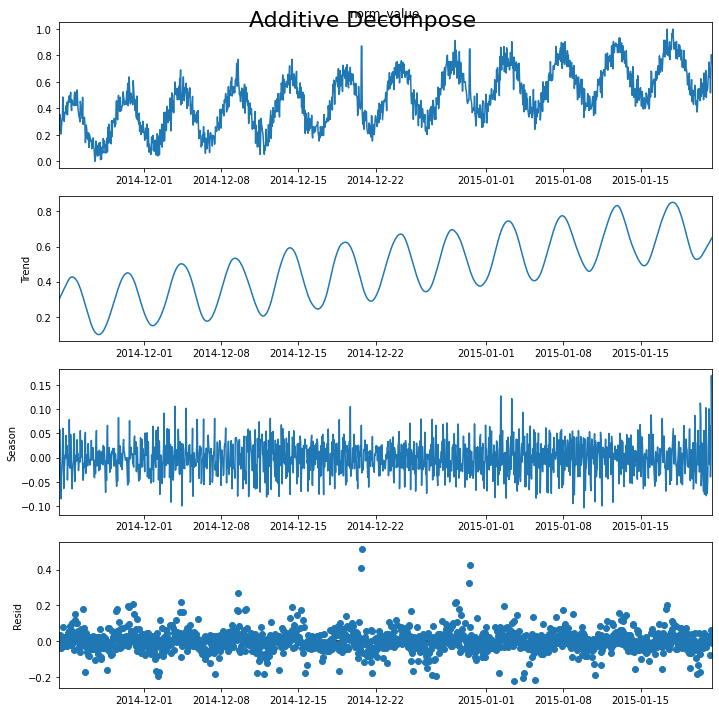

  1%|          | 1/100 [00:04<08:02,  4.88s/it]

Mean: 9558.249333, StandardDeviation: 5634.500670
Min: -1.784094, Max: 5.482078



A2Benchmark_synthetic_51add_STL


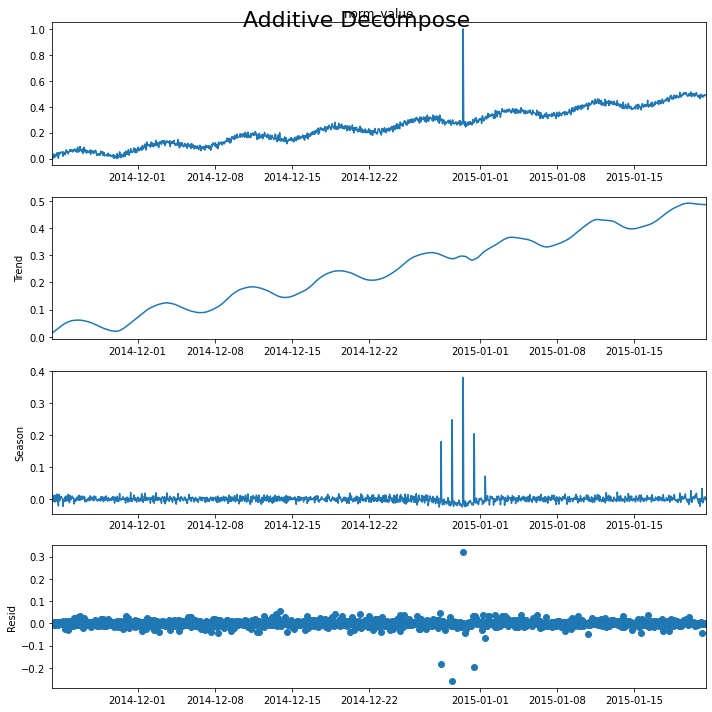

  2%|▏         | 2/100 [00:09<07:53,  4.83s/it]

Mean: 556.168299, StandardDeviation: 1032.250432
Min: -2.055898, Max: 2.720477



A2Benchmark_synthetic_75add_STL


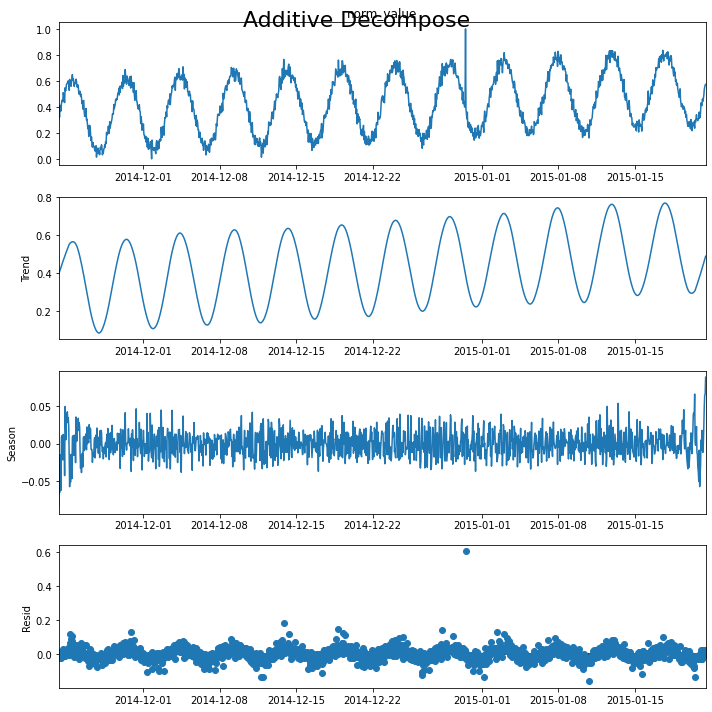

  3%|▎         | 3/100 [00:14<07:45,  4.80s/it]

Mean: 3493.558825, StandardDeviation: 2366.714471
Min: -2.238654, Max: 5.490880



A2Benchmark_synthetic_55add_STL


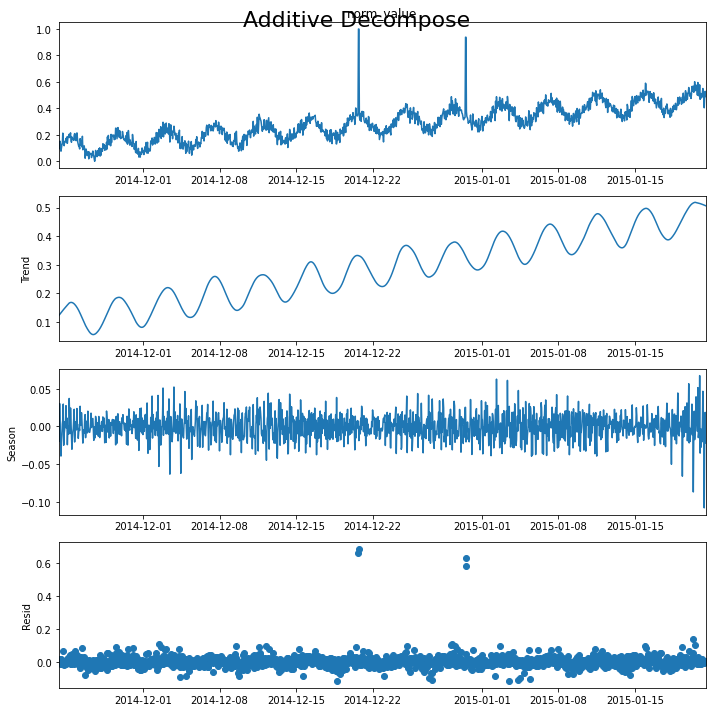

  4%|▍         | 4/100 [00:19<07:38,  4.78s/it]

Mean: 3513.971473, StandardDeviation: 2396.965434
Min: -2.222367, Max: 5.300077



A2Benchmark_synthetic_59add_STL


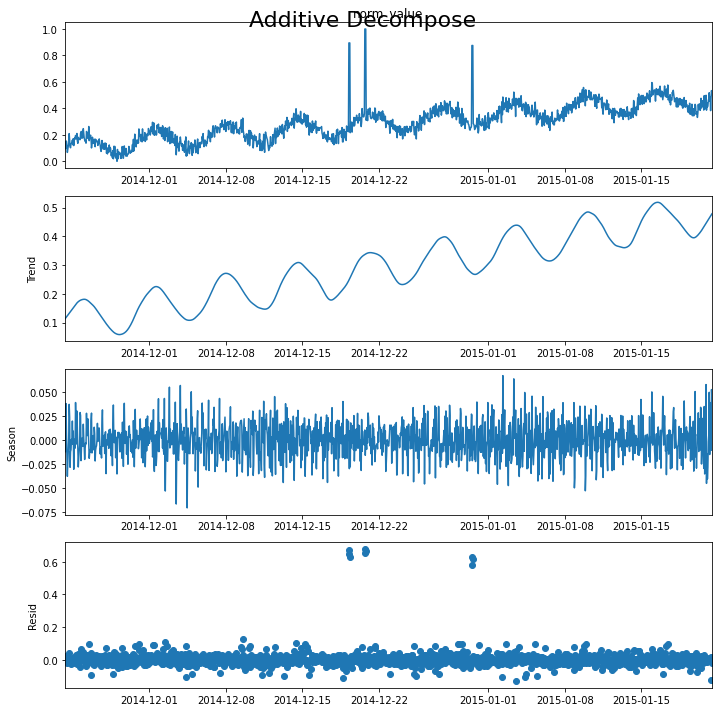

  5%|▌         | 5/100 [00:23<07:33,  4.78s/it]

Mean: 362.532163, StandardDeviation: 1021.057616
Min: -1.899586, Max: 2.290352



A2Benchmark_synthetic_19add_STL


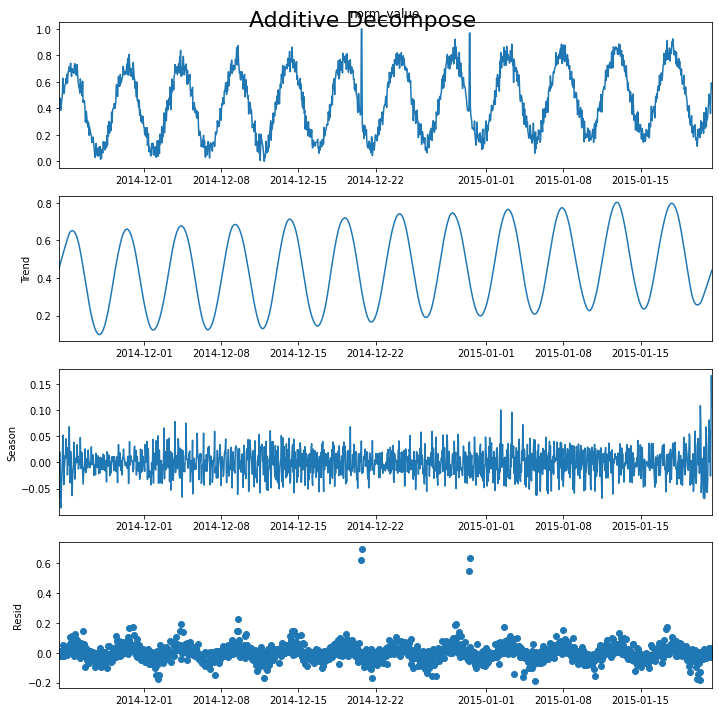

  6%|▌         | 6/100 [00:28<07:28,  4.77s/it]

Mean: 2596.446120, StandardDeviation: 1785.539102
Min: -2.153317, Max: 2.274279



A2Benchmark_synthetic_18add_STL


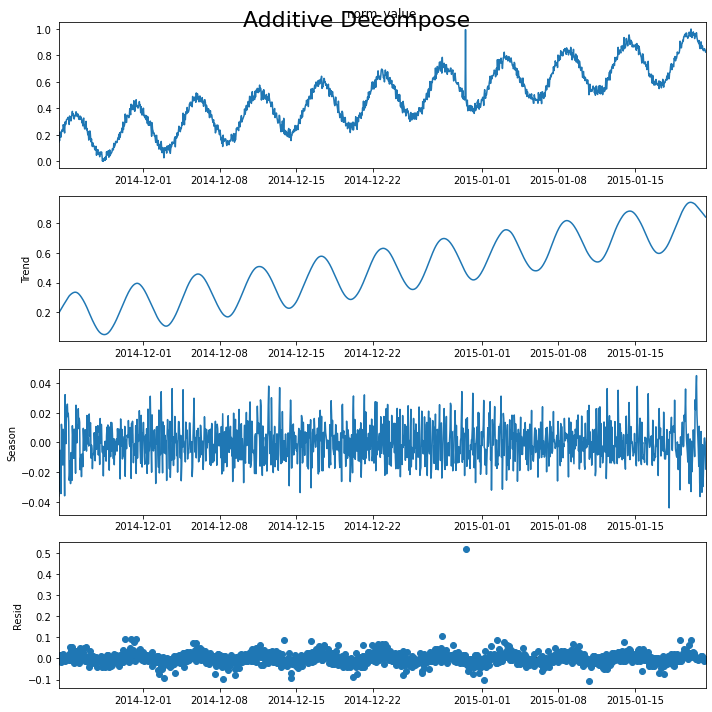

  7%|▋         | 7/100 [00:33<07:28,  4.82s/it]

Mean: 4471.669226, StandardDeviation: 2925.391670
Min: -1.809898, Max: 5.219308



A2Benchmark_synthetic_23add_STL


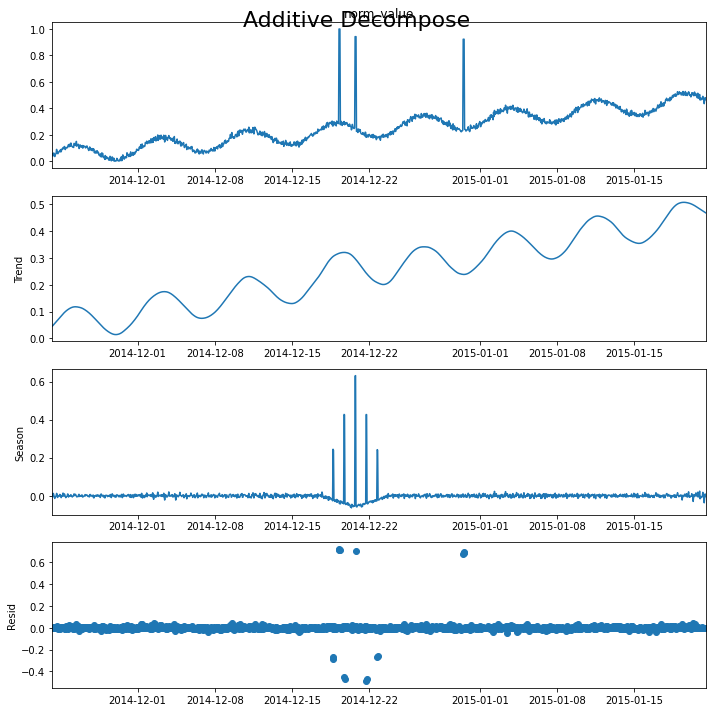

  8%|▊         | 8/100 [00:38<07:21,  4.80s/it]

Mean: 2231.122471, StandardDeviation: 1732.376858
Min: -2.238422, Max: 5.157476



A2Benchmark_synthetic_47add_STL


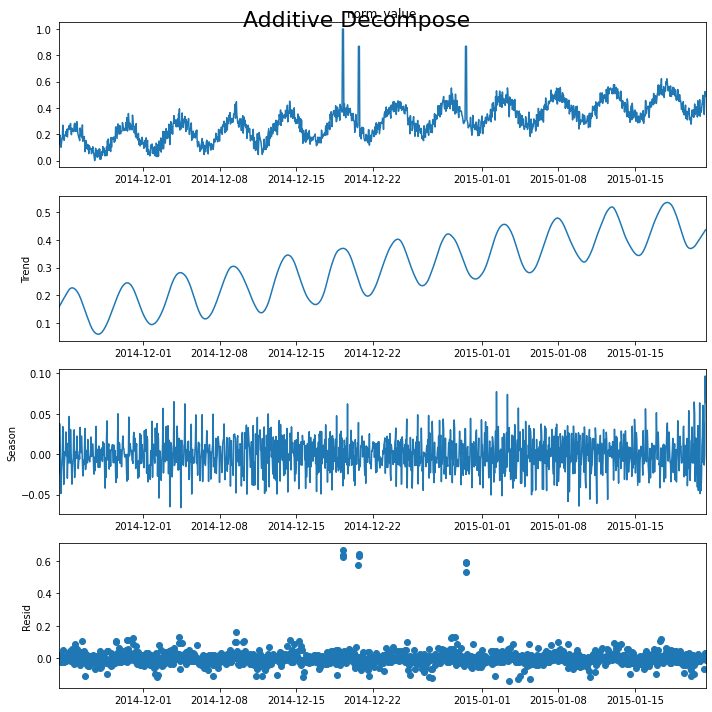

  9%|▉         | 9/100 [00:43<07:14,  4.78s/it]

Mean: 299.954448, StandardDeviation: 1024.294474
Min: -1.874314, Max: 3.814266



A2Benchmark_synthetic_17add_STL


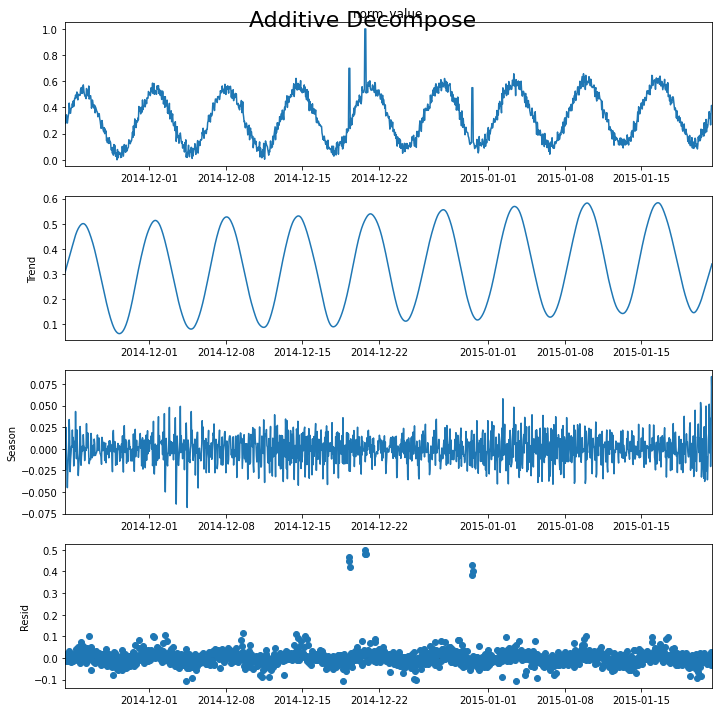

 10%|█         | 10/100 [00:47<07:09,  4.77s/it]

Processing index: 10 of 100
Mean: 634.296881, StandardDeviation: 1095.076584
Min: -2.281384, Max: 2.504105



A2Benchmark_synthetic_36add_STL


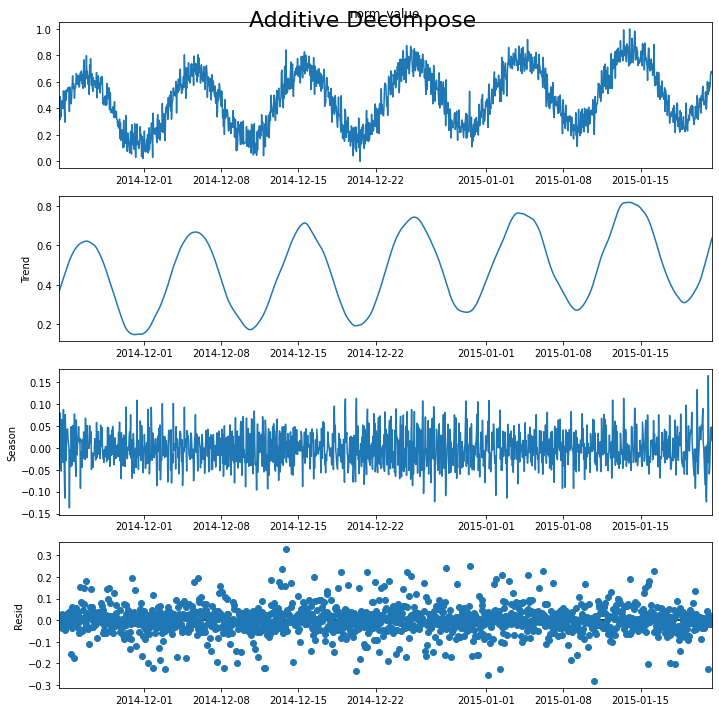

 11%|█         | 11/100 [00:52<07:05,  4.78s/it]

Mean: 2496.588623, StandardDeviation: 1712.264206
Min: -2.359719, Max: 2.556210



A2Benchmark_synthetic_50add_STL


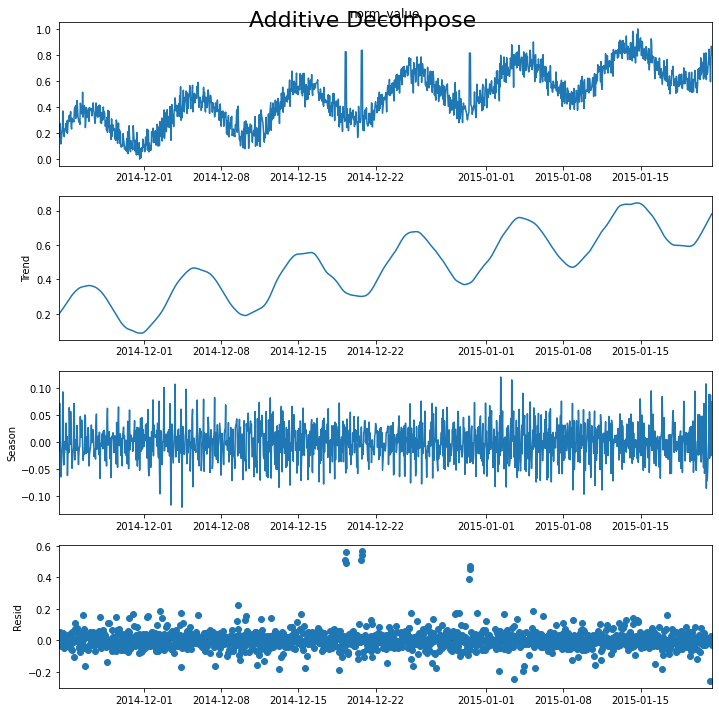

 12%|█▏        | 12/100 [00:57<06:59,  4.77s/it]

Mean: 3191.408691, StandardDeviation: 2074.503331
Min: -2.005573, Max: 2.544810



A2Benchmark_synthetic_16add_STL


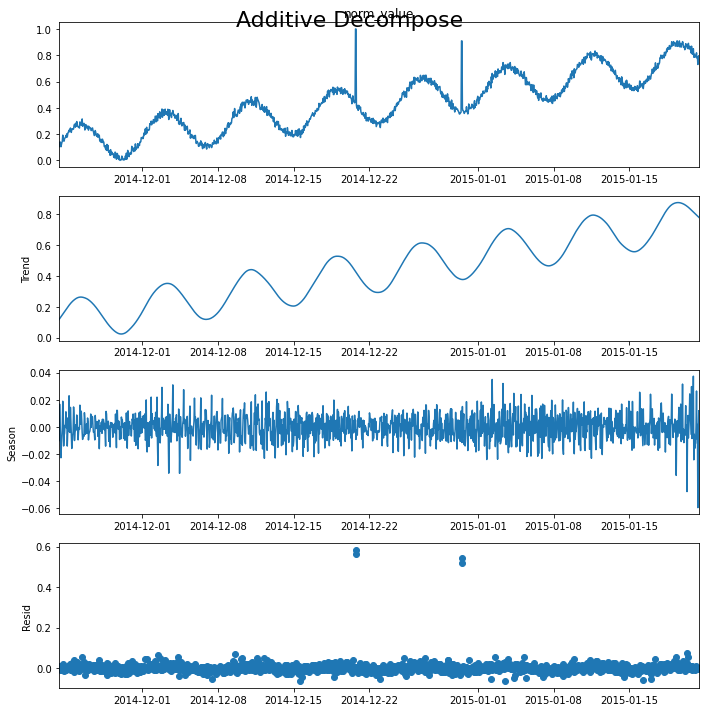

 13%|█▎        | 13/100 [01:02<06:56,  4.79s/it]

Mean: 13721.578066, StandardDeviation: 8515.530982
Min: -1.603435, Max: 5.261480



A2Benchmark_synthetic_65add_STL


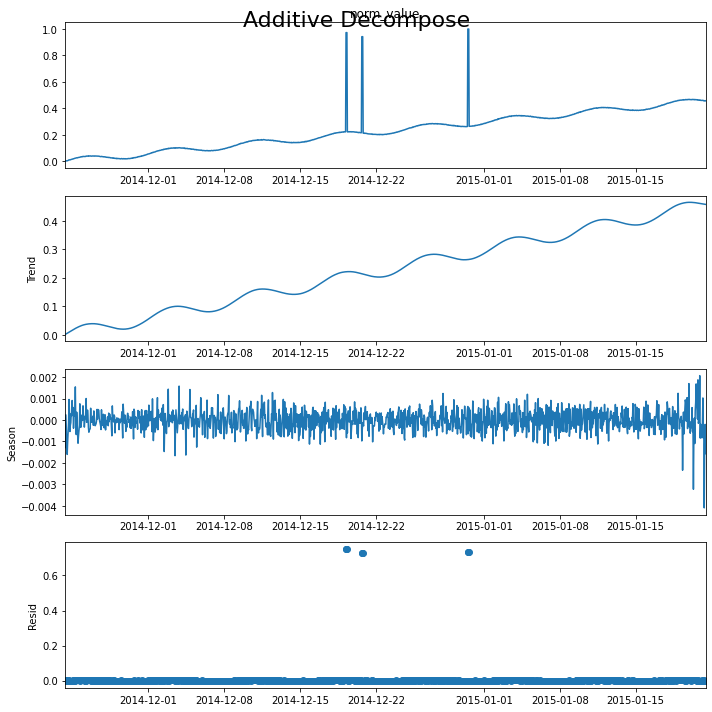

 14%|█▍        | 14/100 [01:06<06:49,  4.77s/it]

Mean: 5179.096630, StandardDeviation: 3173.156284
Min: -1.996127, Max: 5.291048



A2Benchmark_synthetic_39add_STL


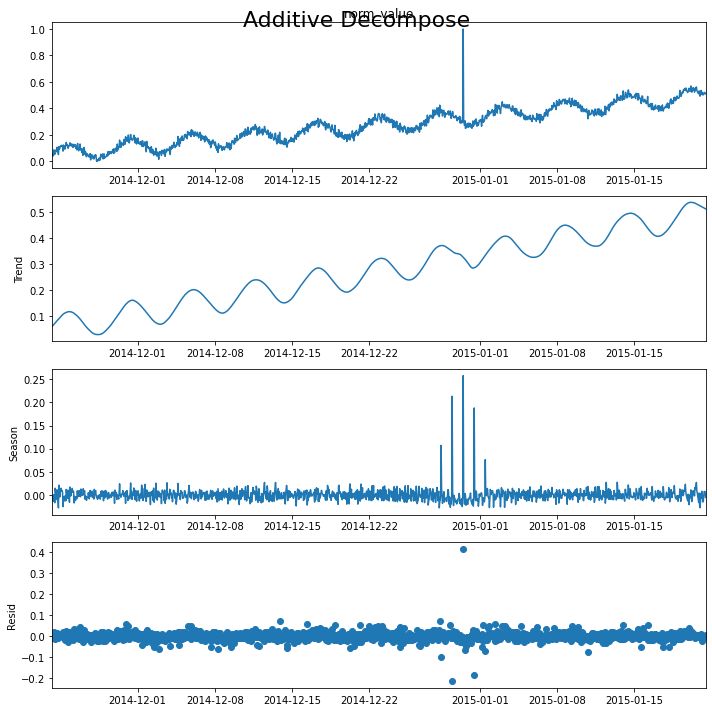

 15%|█▌        | 15/100 [01:11<06:43,  4.75s/it]

Mean: 3224.960580, StandardDeviation: 2265.218133
Min: -2.146796, Max: 5.254139



A2Benchmark_synthetic_41add_STL


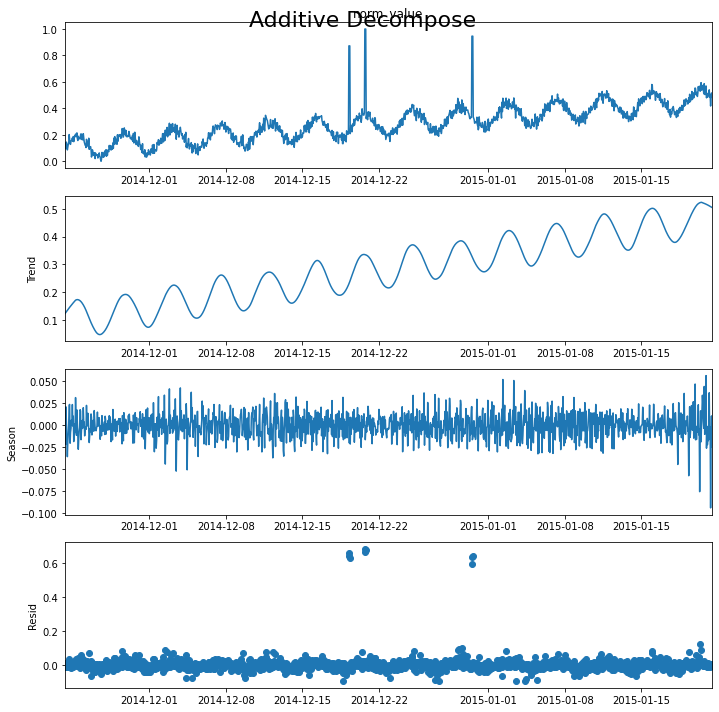

 16%|█▌        | 16/100 [01:16<06:38,  4.75s/it]

Mean: 801.573541, StandardDeviation: 1050.638599
Min: -2.070213, Max: 2.417565



A2Benchmark_synthetic_71add_STL


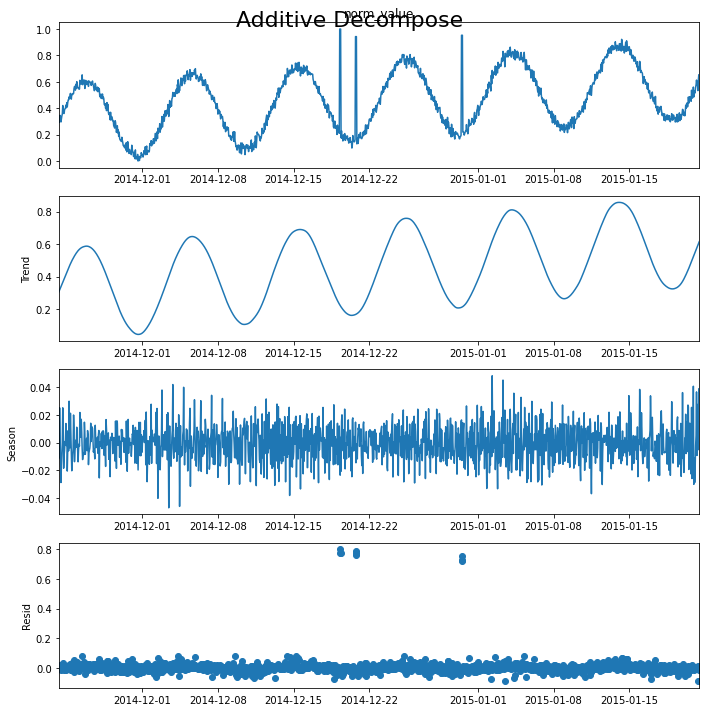

 17%|█▋        | 17/100 [01:21<06:34,  4.75s/it]

Mean: 2949.875475, StandardDeviation: 1884.576544
Min: -2.180257, Max: 2.270360



A2Benchmark_synthetic_92add_STL


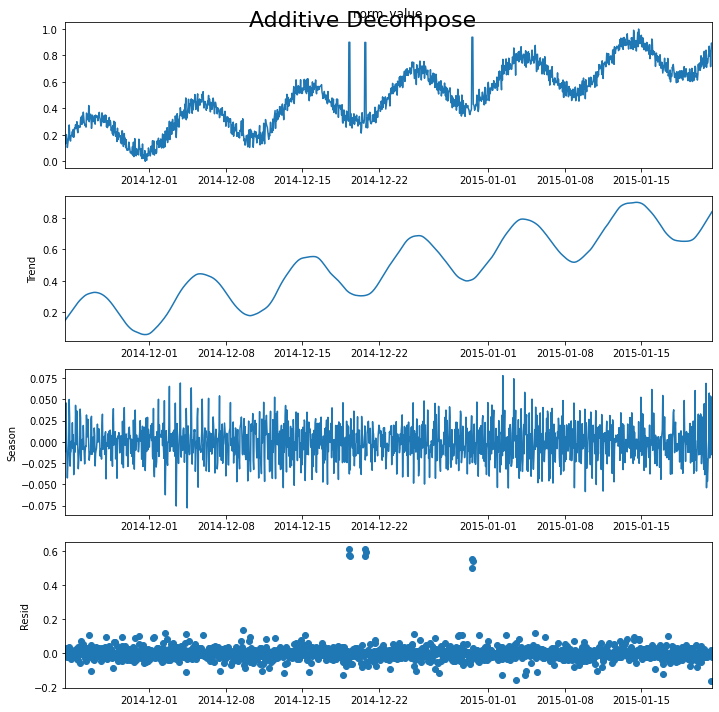

 18%|█▊        | 18/100 [01:25<06:29,  4.75s/it]

Mean: 9202.203480, StandardDeviation: 5383.176339
Min: -1.749755, Max: 2.818085



A2Benchmark_synthetic_28add_STL


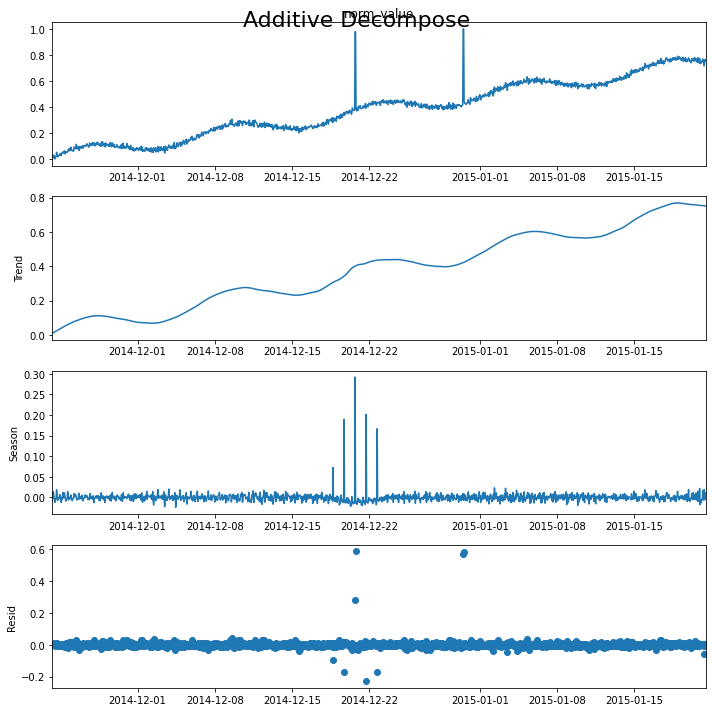

 19%|█▉        | 19/100 [01:30<06:26,  4.78s/it]

Mean: 2615.639684, StandardDeviation: 1883.715525
Min: -2.103062, Max: 5.262630



A2Benchmark_synthetic_89add_STL


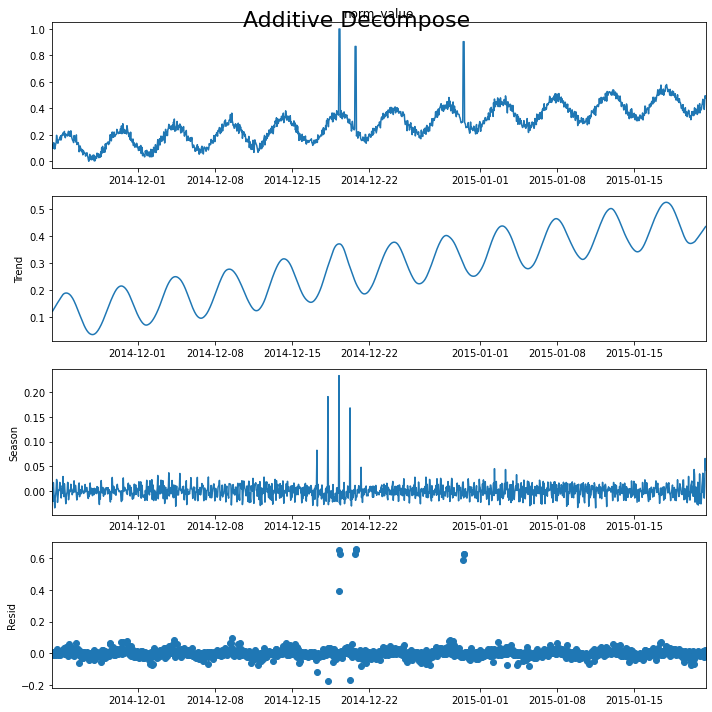

 20%|██        | 20/100 [01:35<06:21,  4.77s/it]

Processing index: 20 of 100
Mean: 2129.056749, StandardDeviation: 1517.746802
Min: -2.229442, Max: 4.007059



A2Benchmark_synthetic_85add_STL


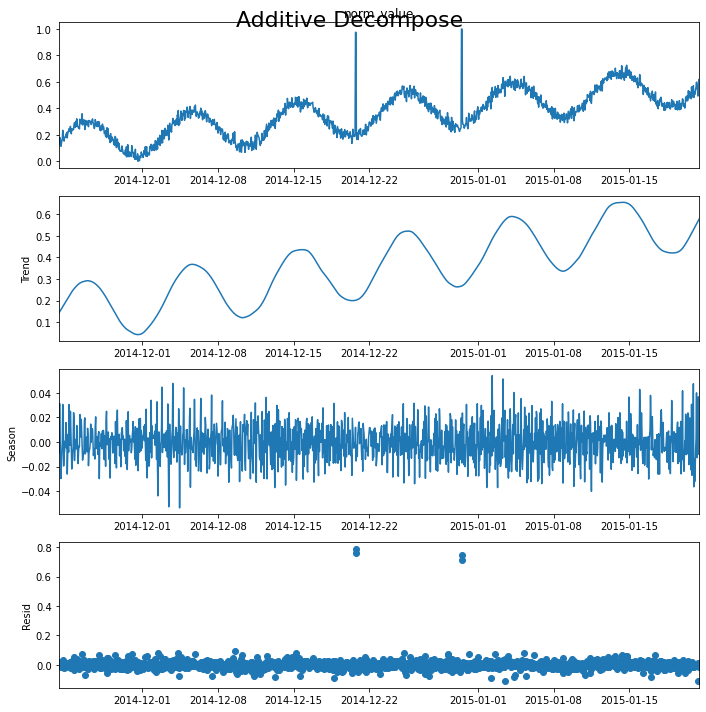

 21%|██        | 21/100 [01:40<06:16,  4.77s/it]

Mean: 4525.112368, StandardDeviation: 2816.829308
Min: -2.160249, Max: 2.920773



A2Benchmark_synthetic_48add_STL


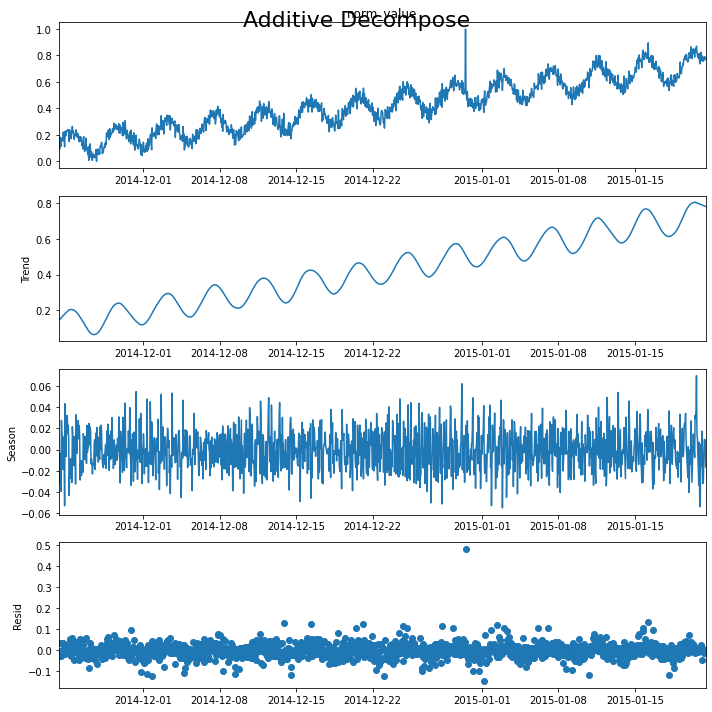

 22%|██▏       | 22/100 [01:44<06:12,  4.77s/it]

Mean: 1594.302942, StandardDeviation: 1417.078635
Min: -2.474116, Max: 3.287753



A2Benchmark_synthetic_57add_STL


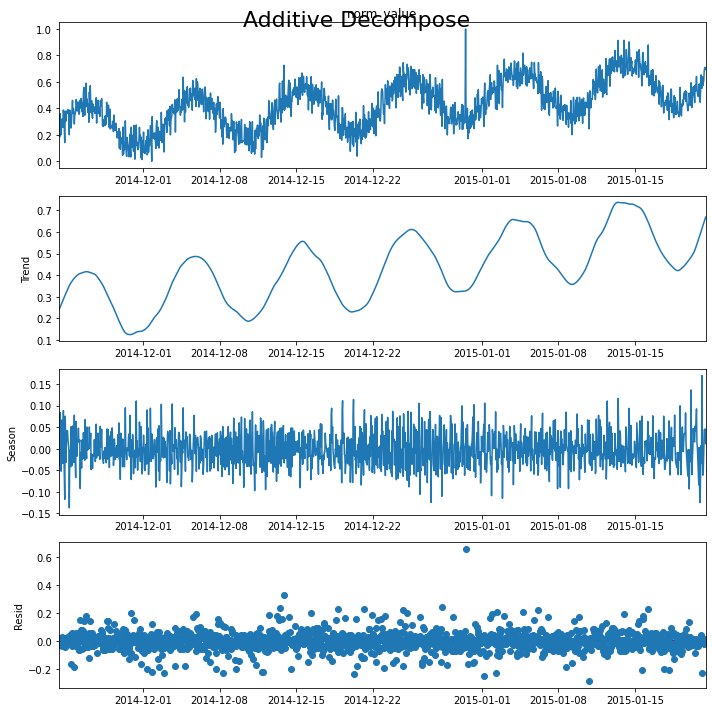

 23%|██▎       | 23/100 [01:49<06:07,  4.78s/it]

Mean: 7244.356891, StandardDeviation: 4338.899363
Min: -1.814104, Max: 3.057652



A2Benchmark_synthetic_62add_STL


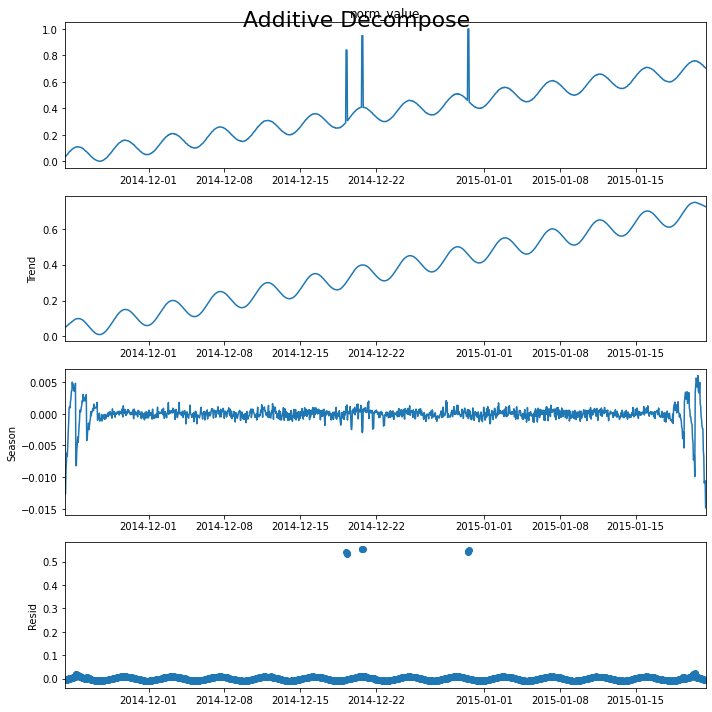

 24%|██▍       | 24/100 [01:54<06:01,  4.75s/it]

Mean: 3211.798426, StandardDeviation: 2136.444375
Min: -2.072741, Max: 4.771106



A2Benchmark_synthetic_25add_STL


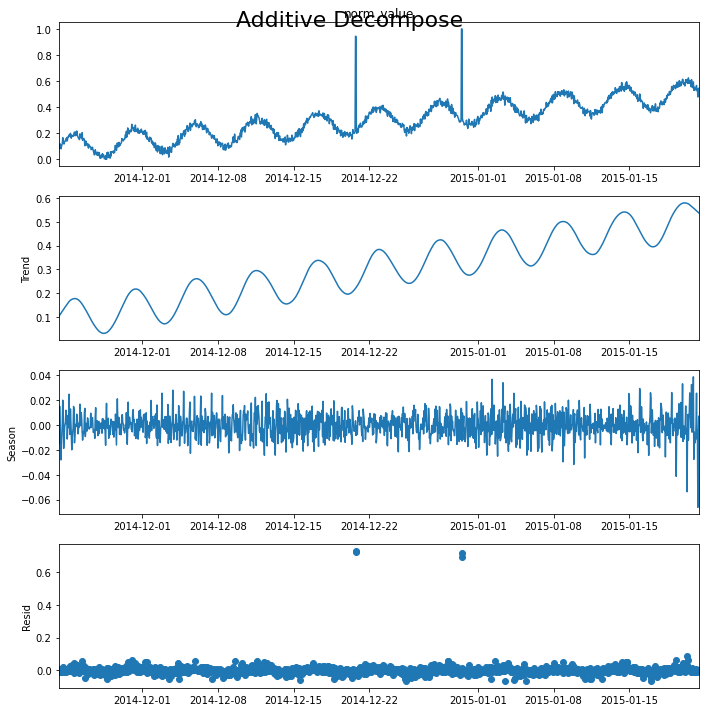

 25%|██▌       | 25/100 [01:59<05:58,  4.78s/it]

Mean: 1428.809330, StandardDeviation: 1357.598995
Min: -2.675936, Max: 2.530259



A2Benchmark_synthetic_54add_STL


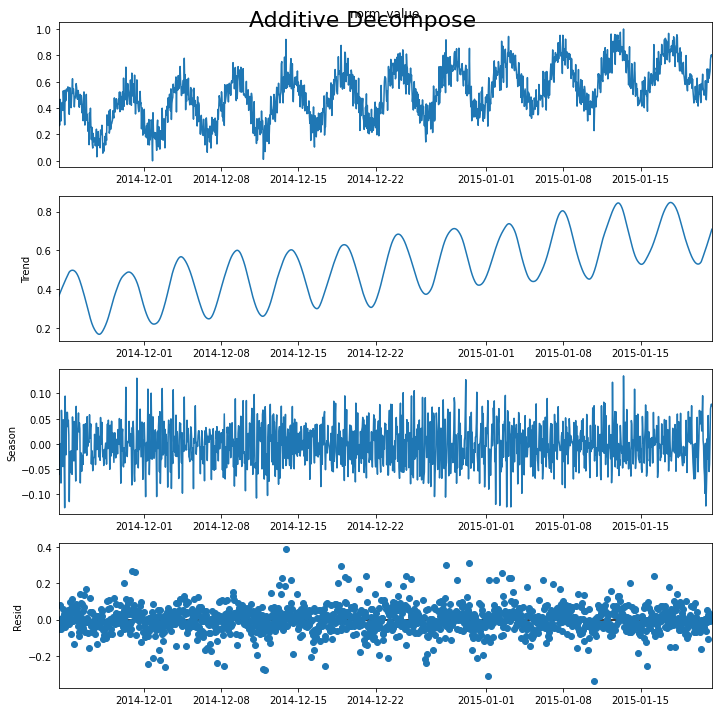

 26%|██▌       | 26/100 [02:04<05:53,  4.77s/it]

Mean: 14842.931340, StandardDeviation: 8603.286780
Min: -1.731659, Max: 2.985381



A2Benchmark_synthetic_72add_STL


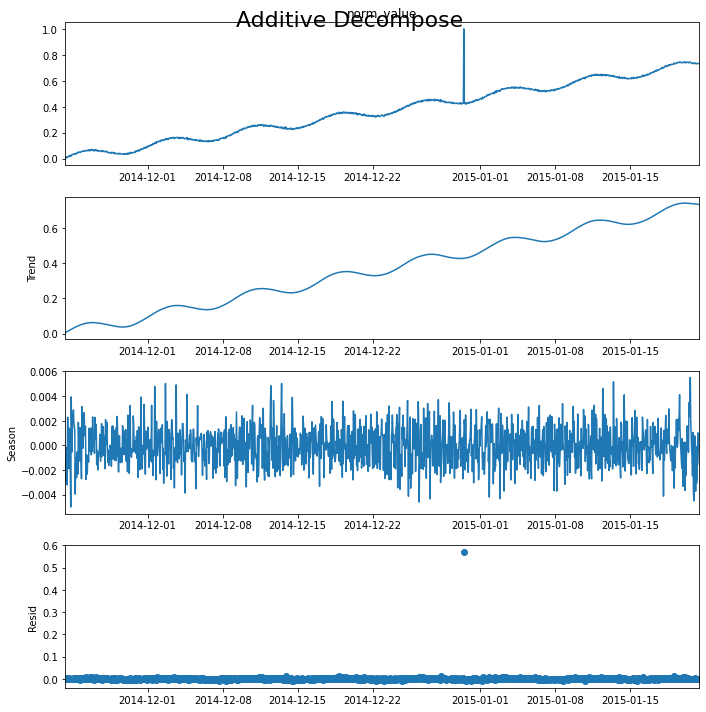

 27%|██▋       | 27/100 [02:08<05:47,  4.76s/it]

Mean: 7829.968809, StandardDeviation: 4650.424410
Min: -1.820052, Max: 5.763673



A2Benchmark_synthetic_69add_STL


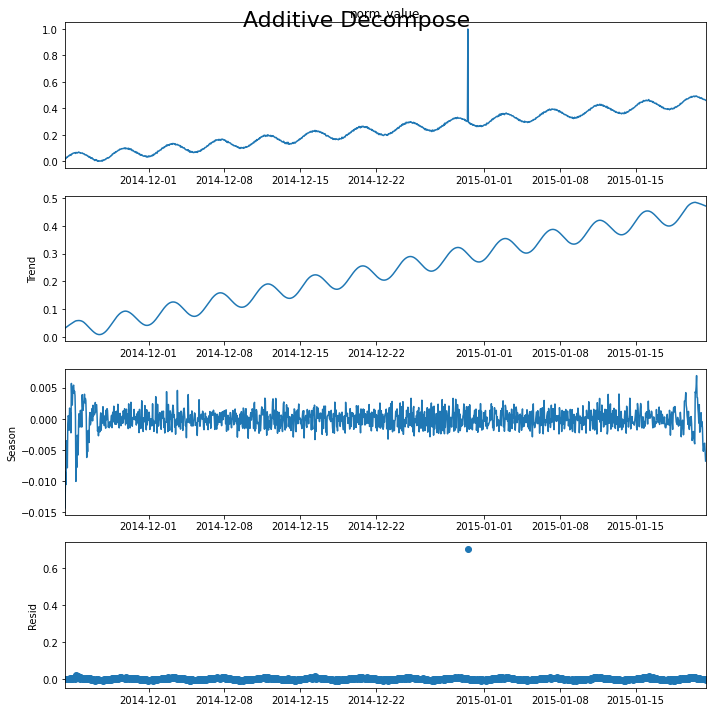

 28%|██▊       | 28/100 [02:13<05:41,  4.74s/it]

Mean: 677.021695, StandardDeviation: 1078.857833
Min: -2.050723, Max: 2.853780



A2Benchmark_synthetic_26add_STL


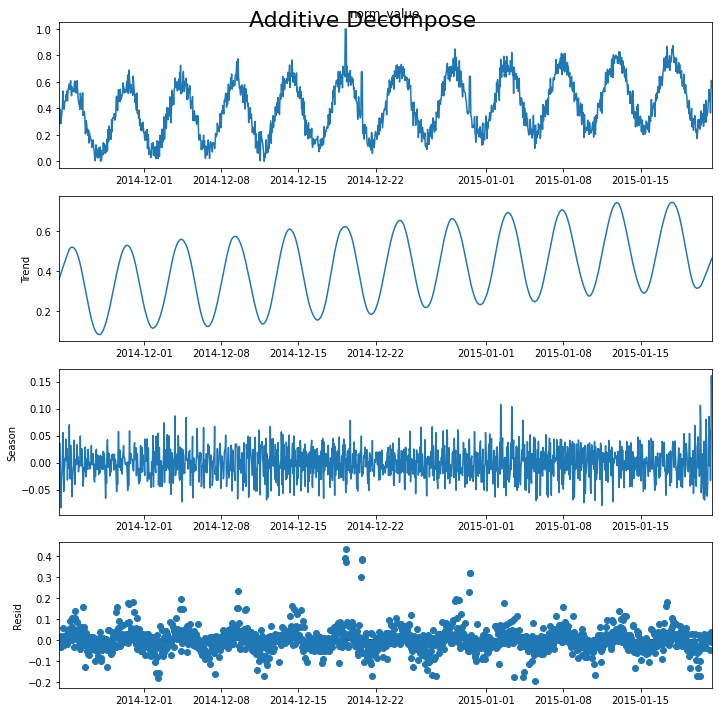

 29%|██▉       | 29/100 [02:18<05:37,  4.75s/it]

Mean: 1613.761107, StandardDeviation: 1381.918933
Min: -2.100161, Max: 3.767044



A2Benchmark_synthetic_11add_STL


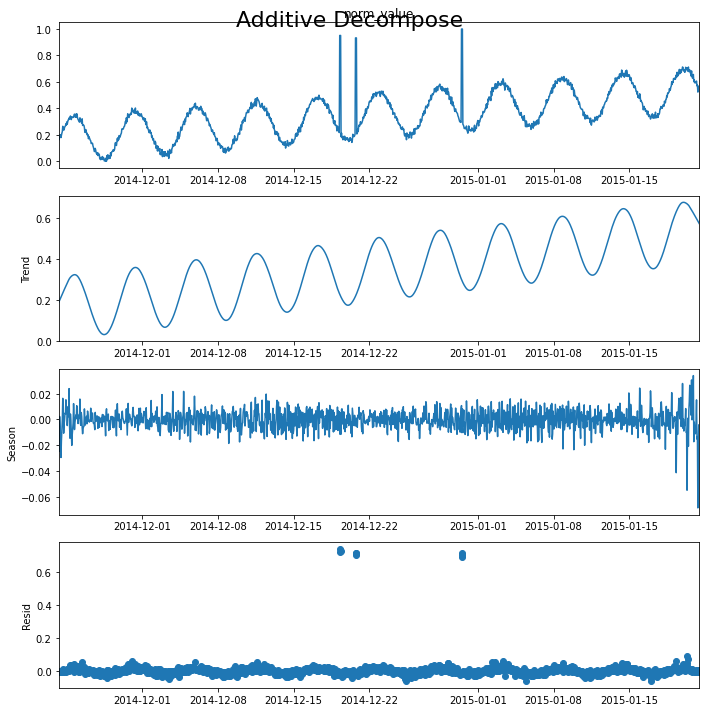

 30%|███       | 30/100 [02:22<05:31,  4.74s/it]

Processing index: 30 of 100
Mean: 7485.049903, StandardDeviation: 4477.502832
Min: -1.782663, Max: 2.742542



A2Benchmark_synthetic_44add_STL


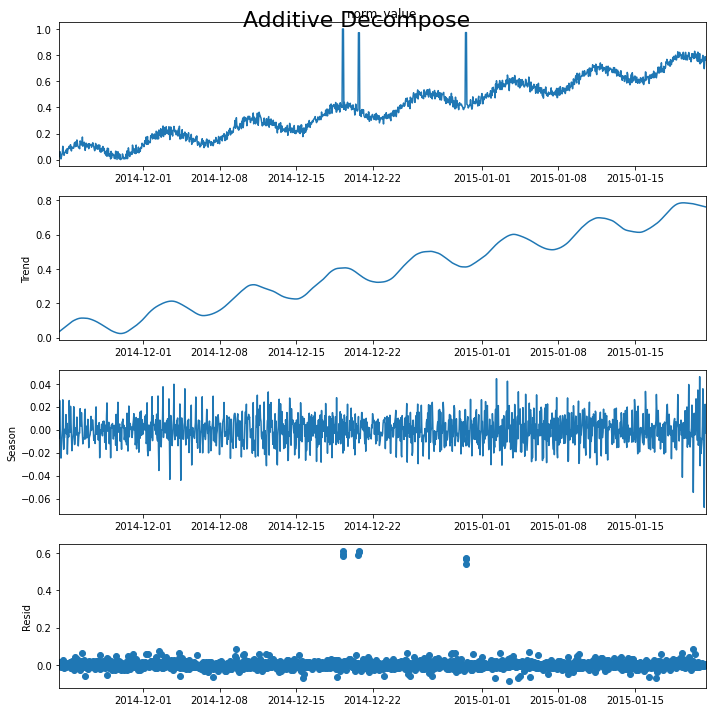

 31%|███       | 31/100 [02:27<05:29,  4.77s/it]

Mean: 9094.309910, StandardDeviation: 5325.903612
Min: -1.730990, Max: 2.971187



A2Benchmark_synthetic_60add_STL


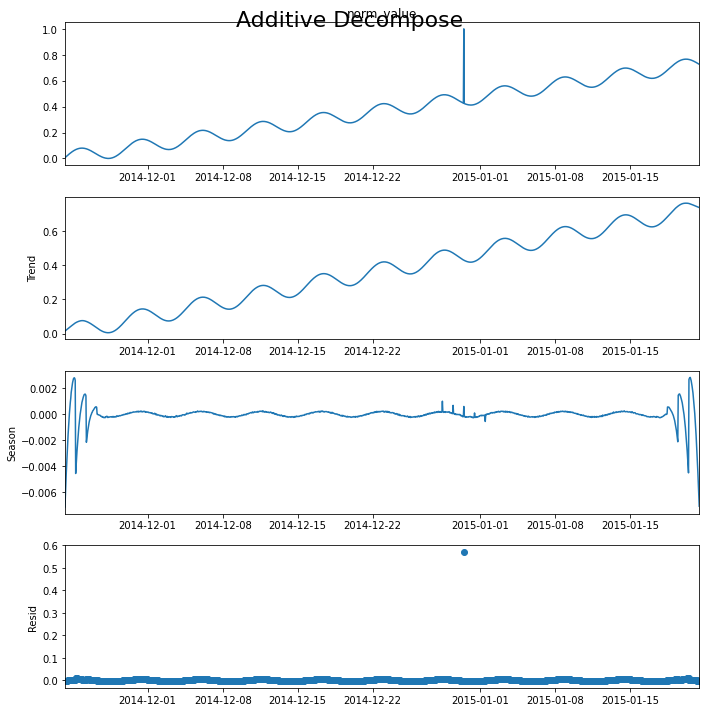

 32%|███▏      | 32/100 [02:32<05:23,  4.75s/it]

Mean: 2534.131404, StandardDeviation: 1760.471141
Min: -1.871038, Max: 5.056955



A2Benchmark_synthetic_7add_STL


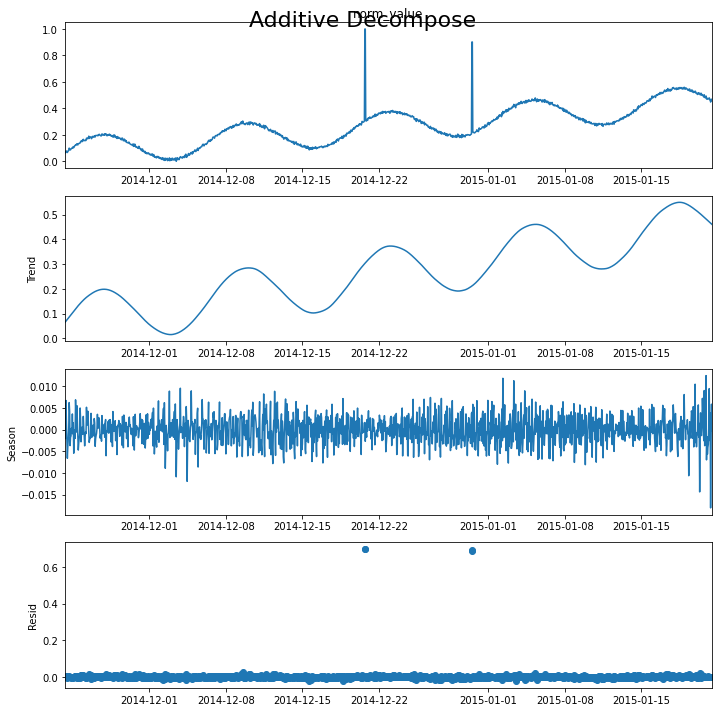

 33%|███▎      | 33/100 [02:37<05:18,  4.75s/it]

Mean: 9755.358345, StandardDeviation: 5869.980223
Min: -1.676154, Max: 5.508347



A2Benchmark_synthetic_67add_STL


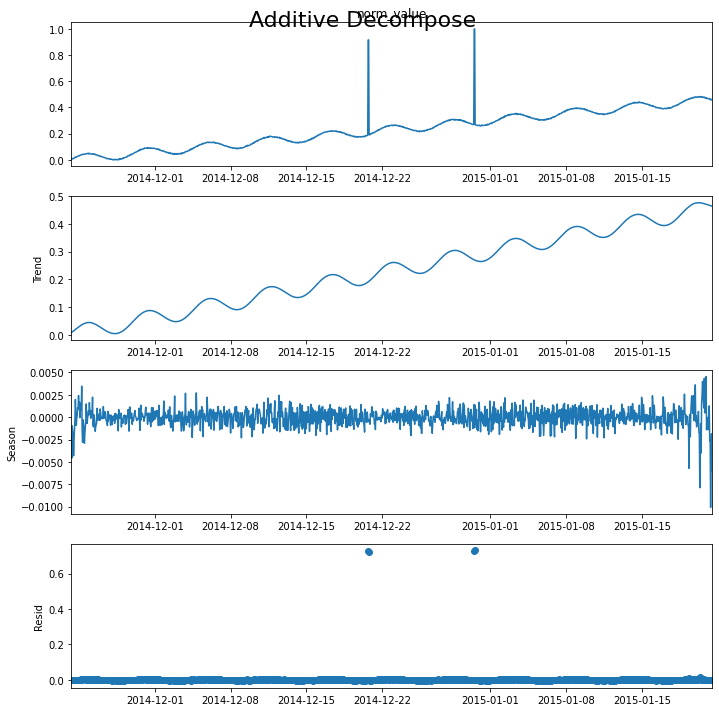

 34%|███▍      | 34/100 [02:41<05:12,  4.74s/it]

Mean: 691.874740, StandardDeviation: 1044.758674
Min: -2.070495, Max: 2.249834



A2Benchmark_synthetic_78add_STL


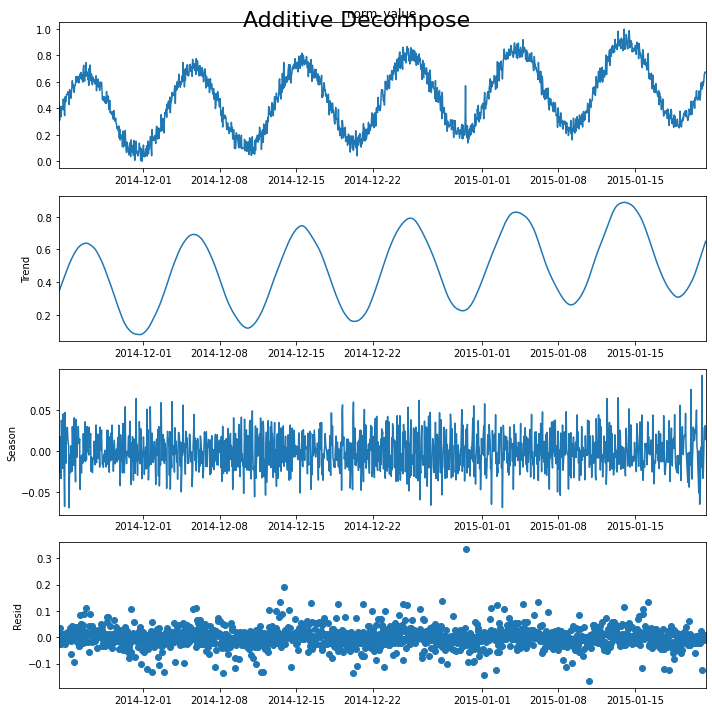

 35%|███▌      | 35/100 [02:46<05:08,  4.74s/it]

Mean: 11436.166506, StandardDeviation: 6711.247441
Min: -1.721342, Max: 5.658333



A2Benchmark_synthetic_81add_STL


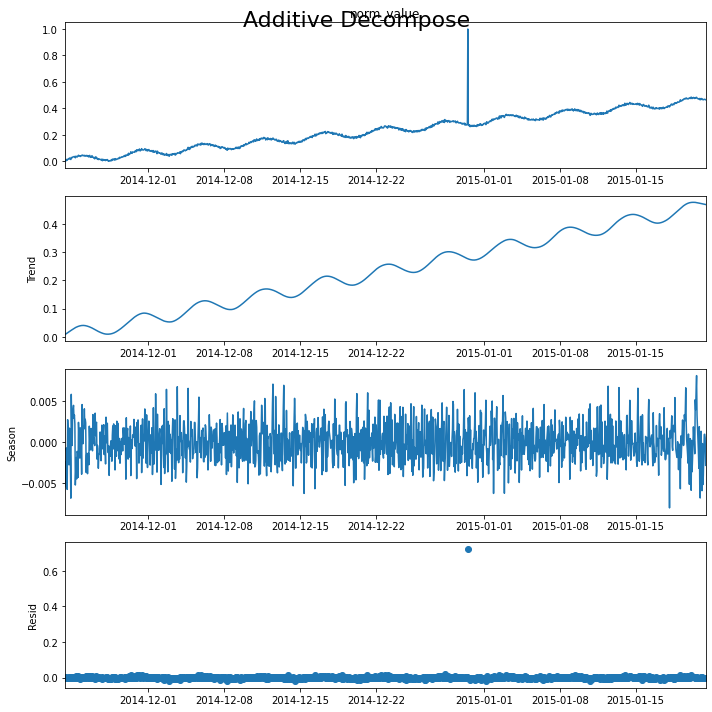

 36%|███▌      | 36/100 [02:51<05:02,  4.73s/it]

Mean: 22214.673041, StandardDeviation: 12919.228619
Min: -1.718605, Max: 5.740462



A2Benchmark_synthetic_63add_STL


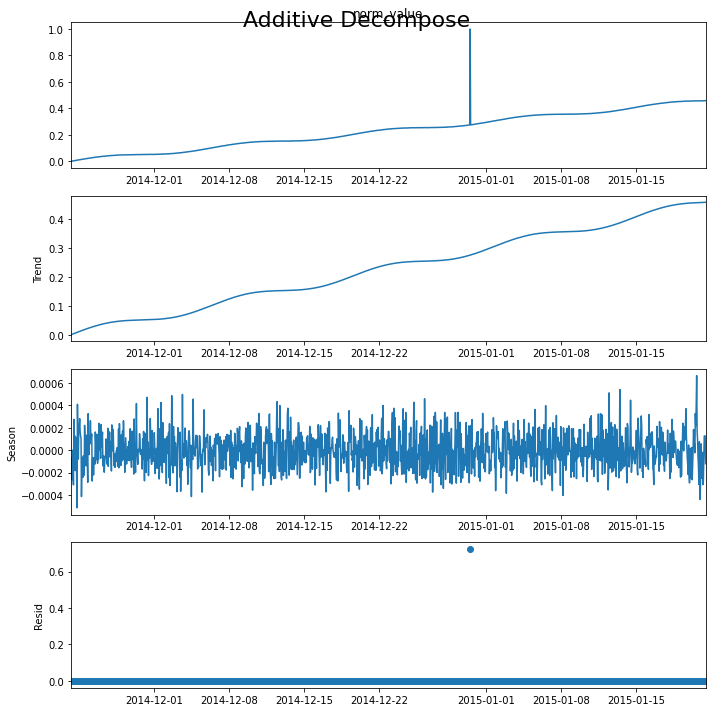

 37%|███▋      | 37/100 [02:56<05:00,  4.77s/it]

Mean: 1844.380800, StandardDeviation: 1439.541406
Min: -2.391366, Max: 3.683752



A2Benchmark_synthetic_43add_STL


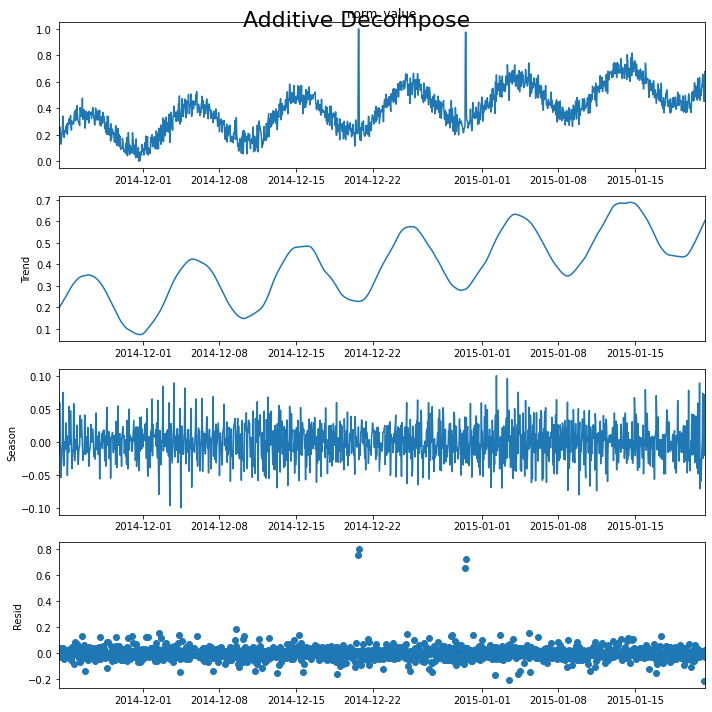

 38%|███▊      | 38/100 [03:01<04:56,  4.78s/it]

Mean: 2873.685166, StandardDeviation: 1957.027297
Min: -2.271168, Max: 3.175623



A2Benchmark_synthetic_34add_STL


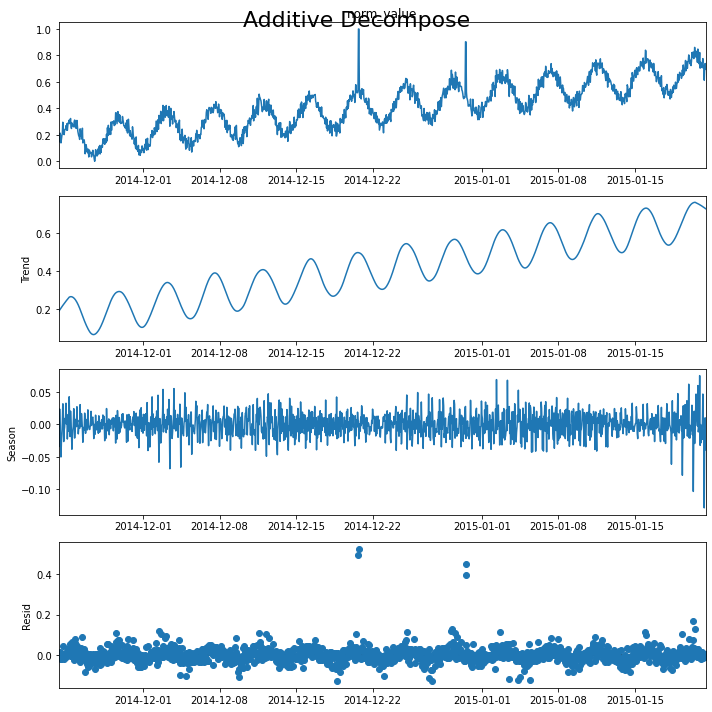

 39%|███▉      | 39/100 [03:05<04:50,  4.76s/it]

Mean: 8016.500290, StandardDeviation: 5055.484515
Min: -1.754061, Max: 5.342319



A2Benchmark_synthetic_83add_STL


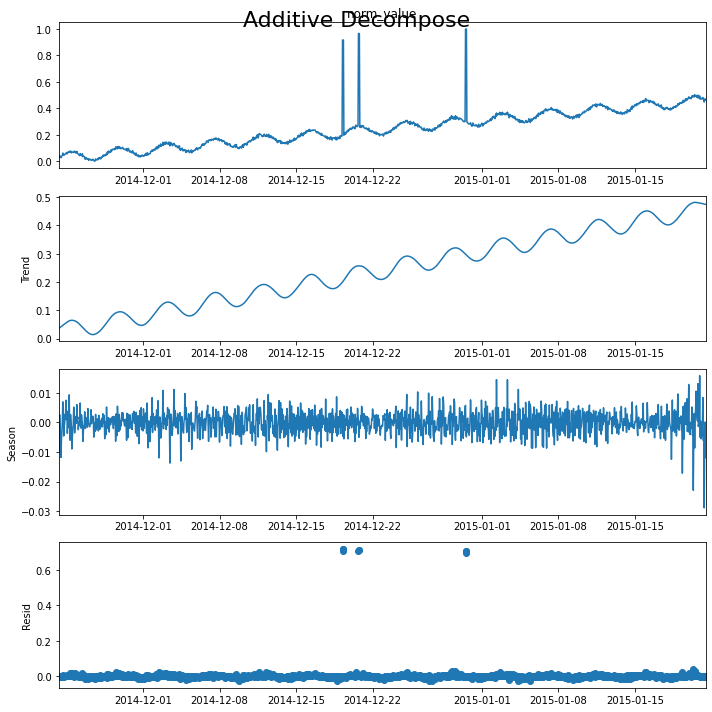

 40%|████      | 40/100 [03:10<04:45,  4.76s/it]

Processing index: 40 of 100
Mean: 1698.695896, StandardDeviation: 1393.114383
Min: -2.450880, Max: 2.317711



A2Benchmark_synthetic_96add_STL


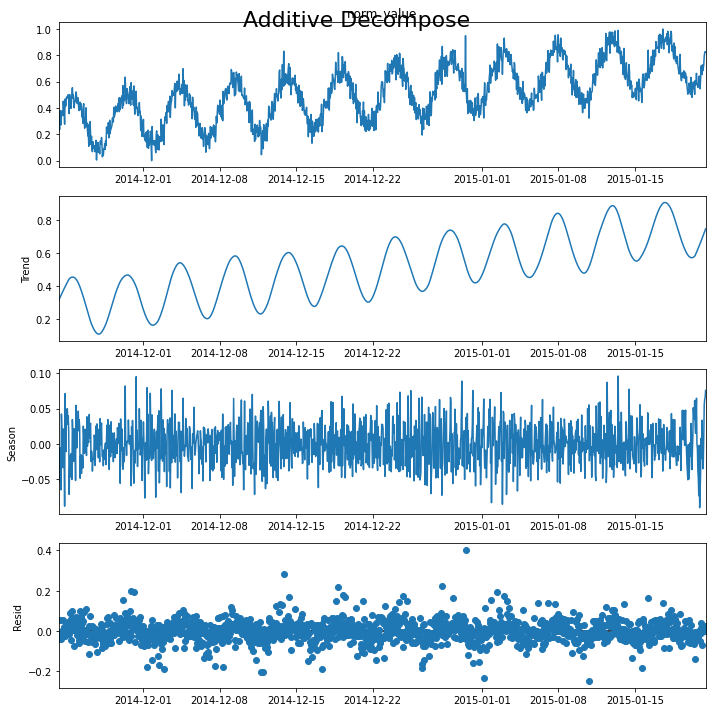

 41%|████      | 41/100 [03:15<04:41,  4.77s/it]

Mean: 554.177127, StandardDeviation: 1030.296873
Min: -1.887090, Max: 2.816559



A2Benchmark_synthetic_68add_STL


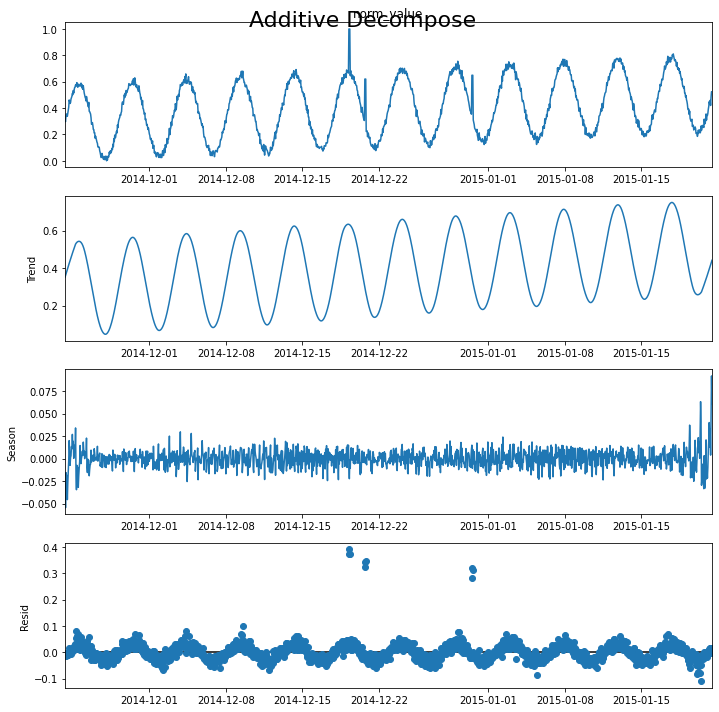

 42%|████▏     | 42/100 [03:20<04:36,  4.77s/it]

Mean: 281.561558, StandardDeviation: 1014.996111
Min: -2.091231, Max: 2.411893



A2Benchmark_synthetic_24add_STL


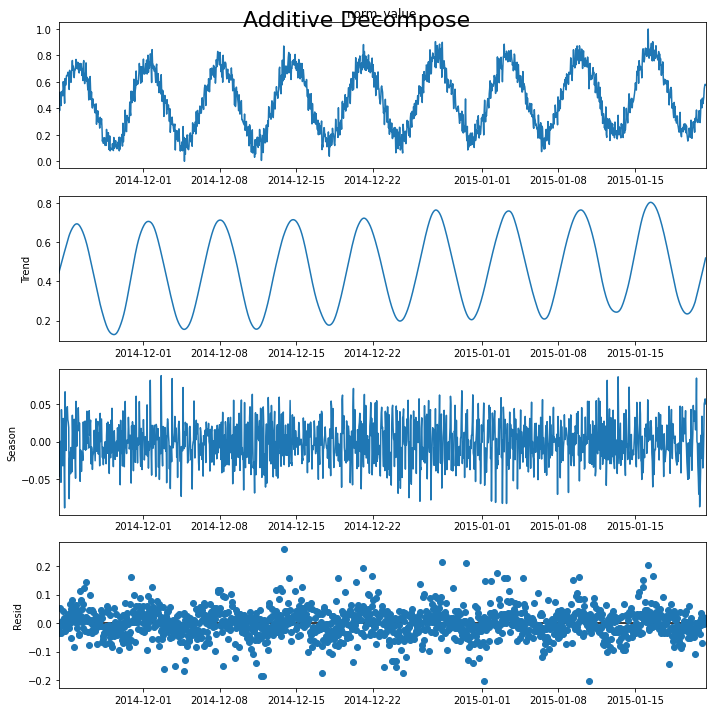

 43%|████▎     | 43/100 [03:25<04:34,  4.81s/it]

Mean: 11410.899789, StandardDeviation: 7069.718250
Min: -1.657583, Max: 5.200080



A2Benchmark_synthetic_35add_STL


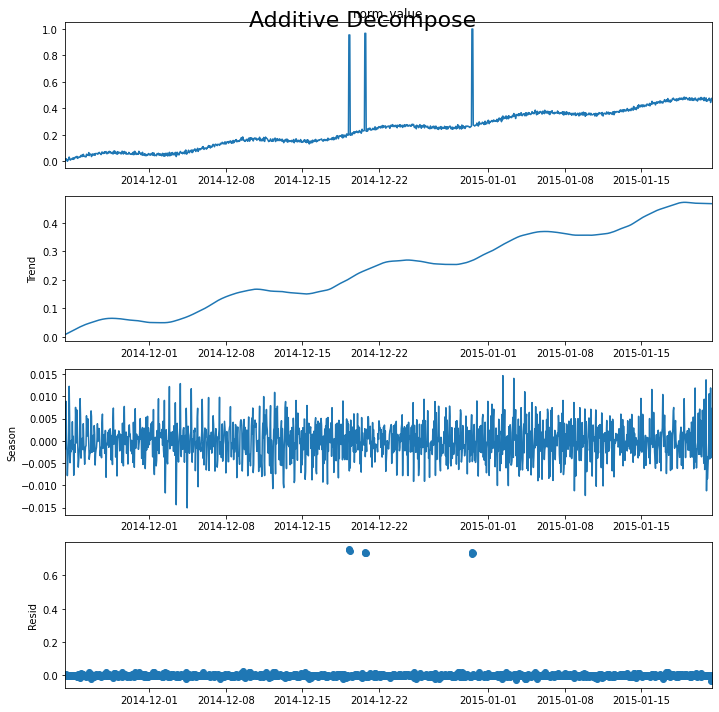

 44%|████▍     | 44/100 [03:29<04:27,  4.78s/it]

Mean: 993.259043, StandardDeviation: 1187.711162
Min: -2.557390, Max: 3.198009



A2Benchmark_synthetic_45add_STL


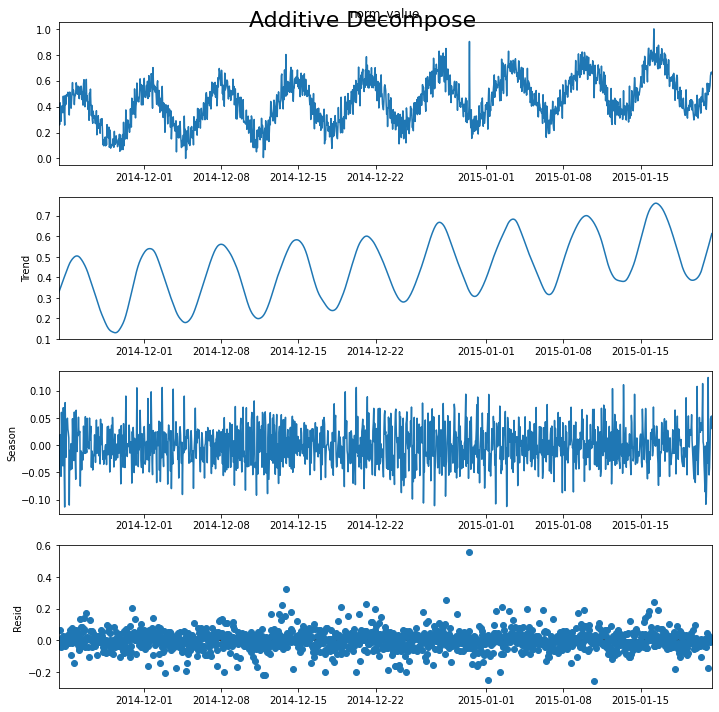

 45%|████▌     | 45/100 [03:34<04:22,  4.77s/it]

Mean: 100.510082, StandardDeviation: 994.197252
Min: -1.659742, Max: 2.403750



A2Benchmark_synthetic_10add_STL


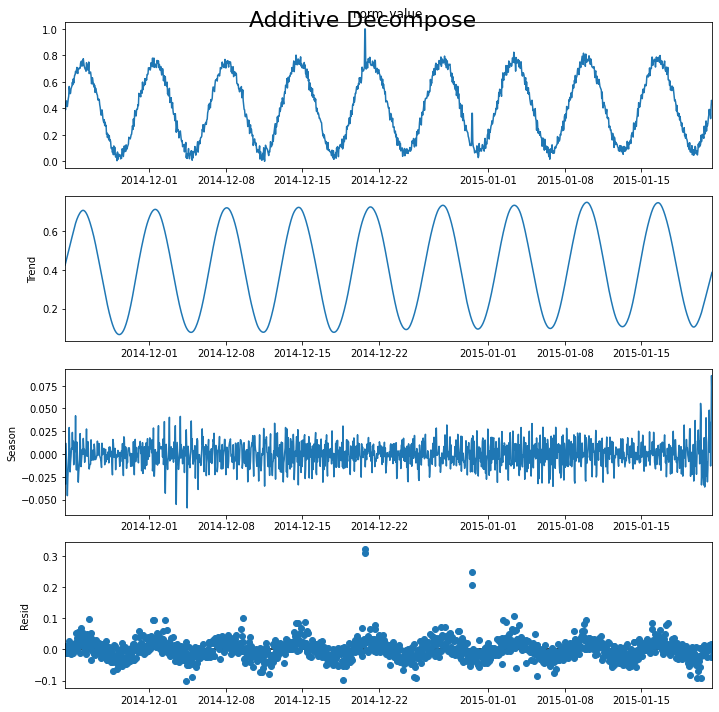

 46%|████▌     | 46/100 [03:39<04:17,  4.76s/it]

Mean: 70.366661, StandardDeviation: 994.123425
Min: -1.797100, Max: 1.696277



A2Benchmark_synthetic_12add_STL


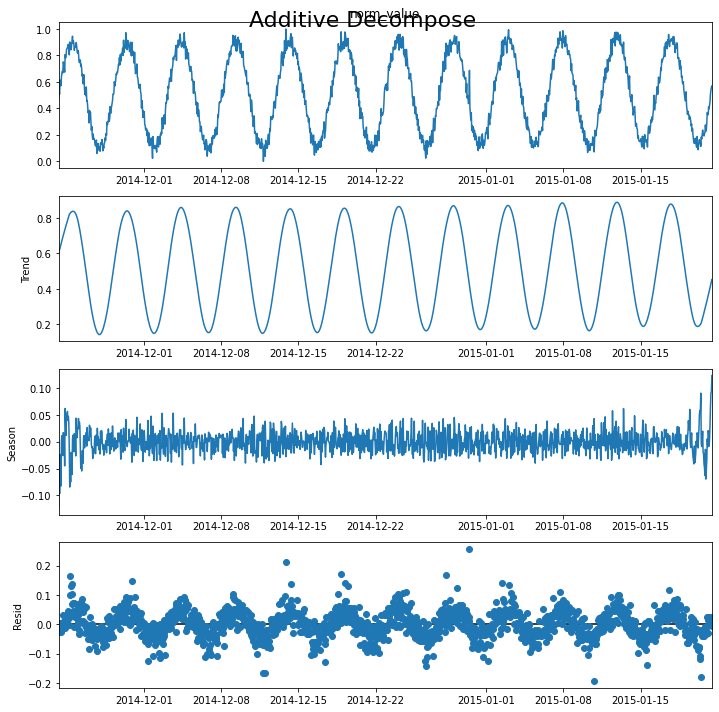

 47%|████▋     | 47/100 [03:43<04:11,  4.75s/it]

Mean: 1995.674055, StandardDeviation: 1534.256092
Min: -2.258836, Max: 3.156465



A2Benchmark_synthetic_20add_STL


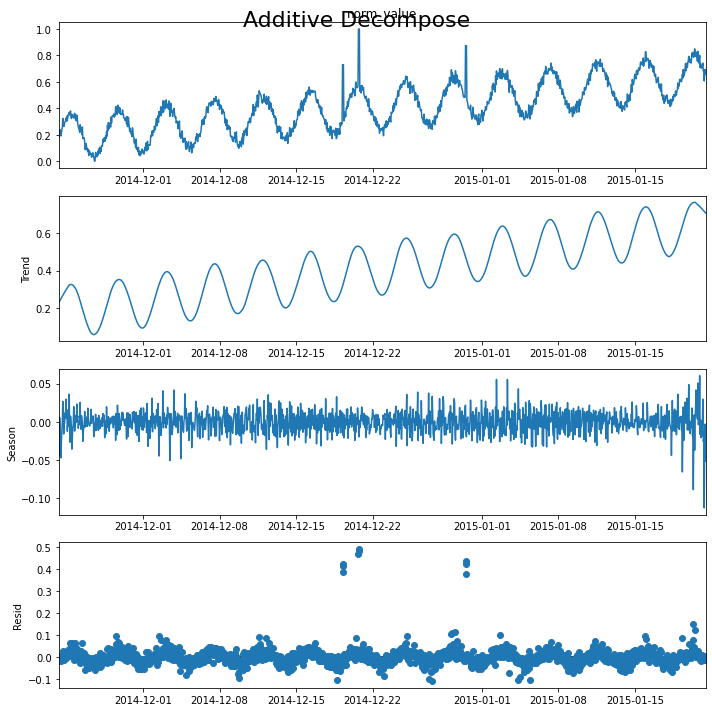

 48%|████▊     | 48/100 [03:48<04:06,  4.75s/it]

Mean: 26401.054954, StandardDeviation: 16295.078570
Min: -1.617448, Max: 5.363630



A2Benchmark_synthetic_77add_STL


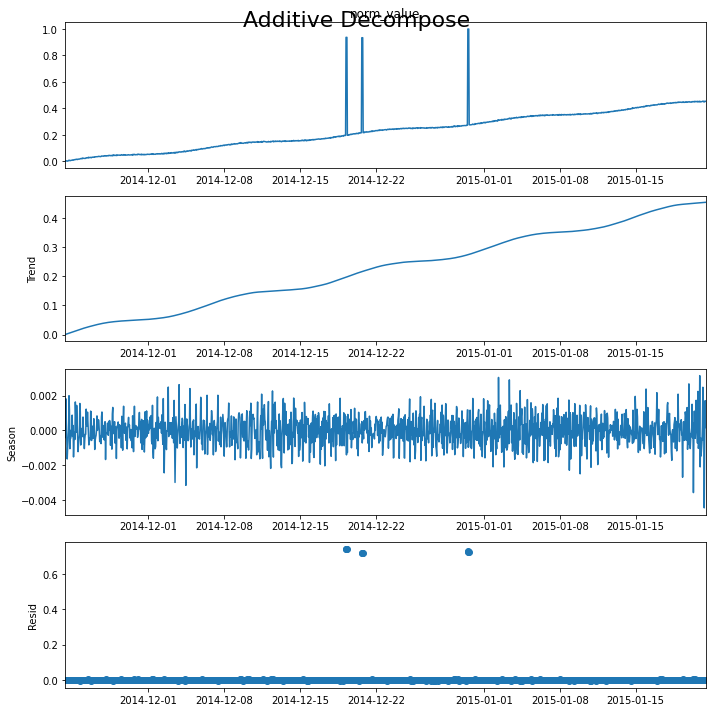

 49%|████▉     | 49/100 [03:53<04:03,  4.78s/it]

Mean: 8984.042125, StandardDeviation: 5305.100902
Min: -1.804378, Max: 2.709658



A2Benchmark_synthetic_58add_STL


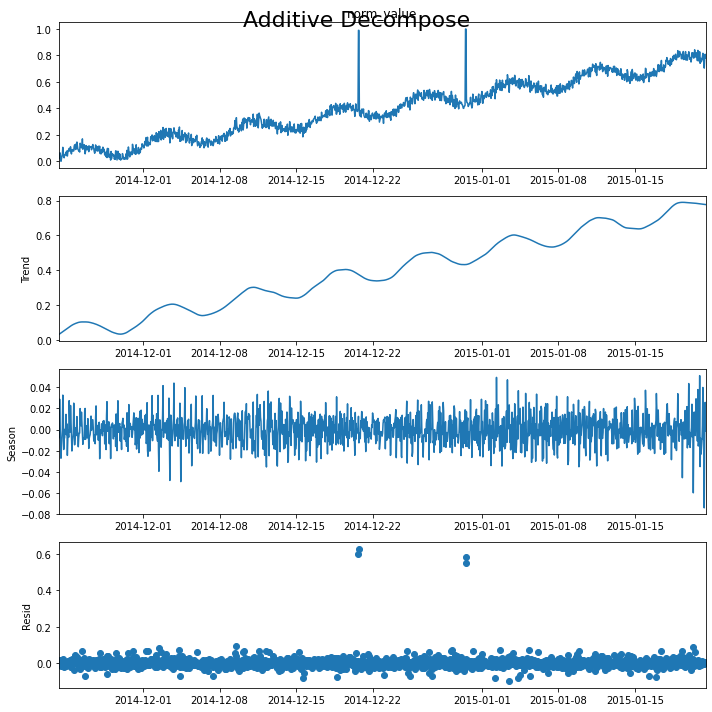

 50%|█████     | 50/100 [03:58<03:58,  4.76s/it]

Processing index: 50 of 100
Mean: 2841.957725, StandardDeviation: 1929.904148
Min: -2.218414, Max: 5.229278



A2Benchmark_synthetic_27add_STL


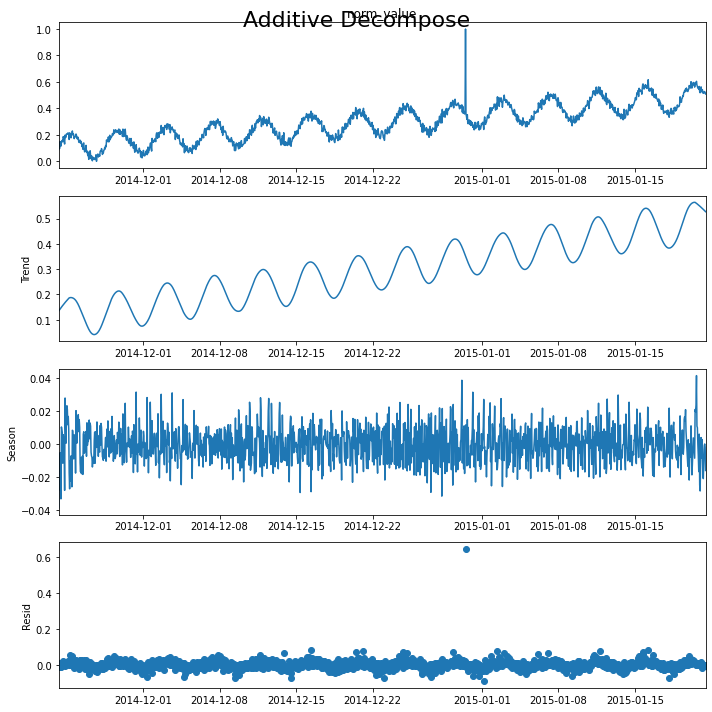

 51%|█████     | 51/100 [04:03<03:53,  4.76s/it]

Mean: 5950.417354, StandardDeviation: 3552.981132
Min: -1.901443, Max: 2.638754



A2Benchmark_synthetic_30add_STL


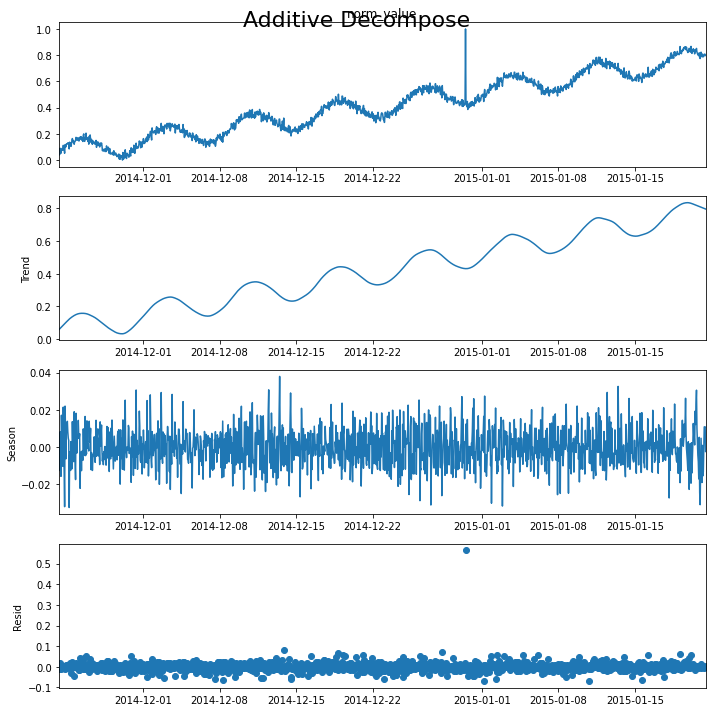

 52%|█████▏    | 52/100 [04:07<03:48,  4.75s/it]

Mean: 1800.062459, StandardDeviation: 1407.250292
Min: -2.238807, Max: 2.370529



A2Benchmark_synthetic_82add_STL


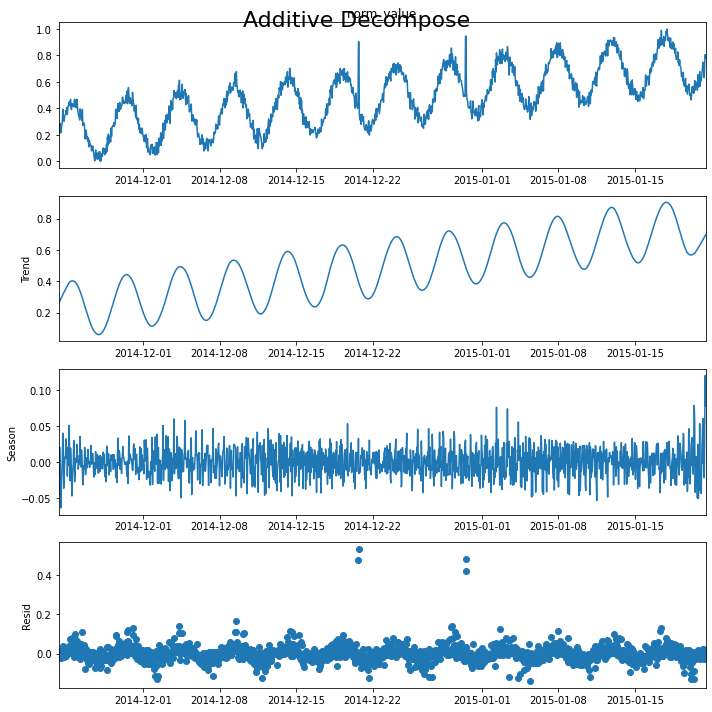

 53%|█████▎    | 53/100 [04:12<03:43,  4.75s/it]

Mean: 17255.105564, StandardDeviation: 10042.787001
Min: -1.742229, Max: 2.950290



A2Benchmark_synthetic_100add_STL


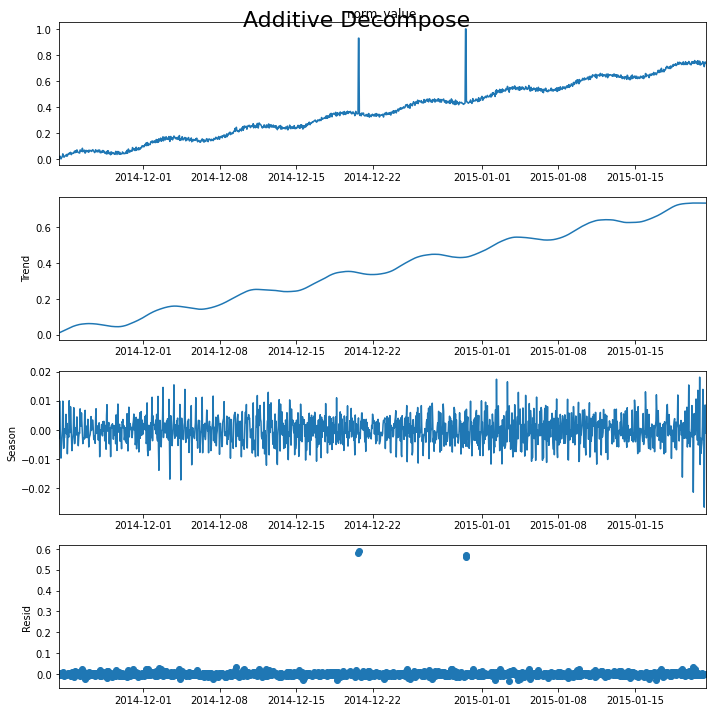

 54%|█████▍    | 54/100 [04:17<03:37,  4.74s/it]

Mean: 72.285228, StandardDeviation: 991.387749
Min: -1.476015, Max: 1.727900



A2Benchmark_synthetic_61add_STL


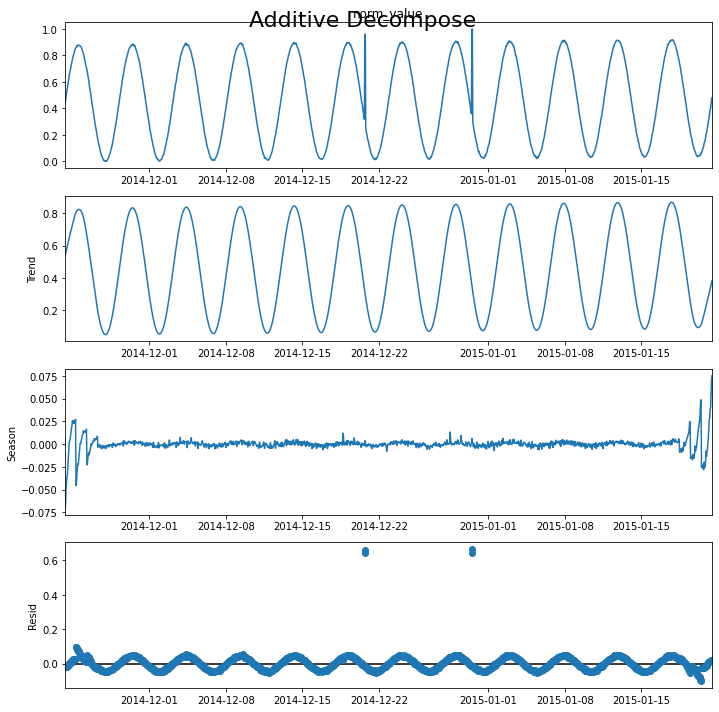

 55%|█████▌    | 55/100 [04:22<03:35,  4.79s/it]

Mean: 7896.721220, StandardDeviation: 4822.223562
Min: -1.856412, Max: 5.539767



A2Benchmark_synthetic_97add_STL


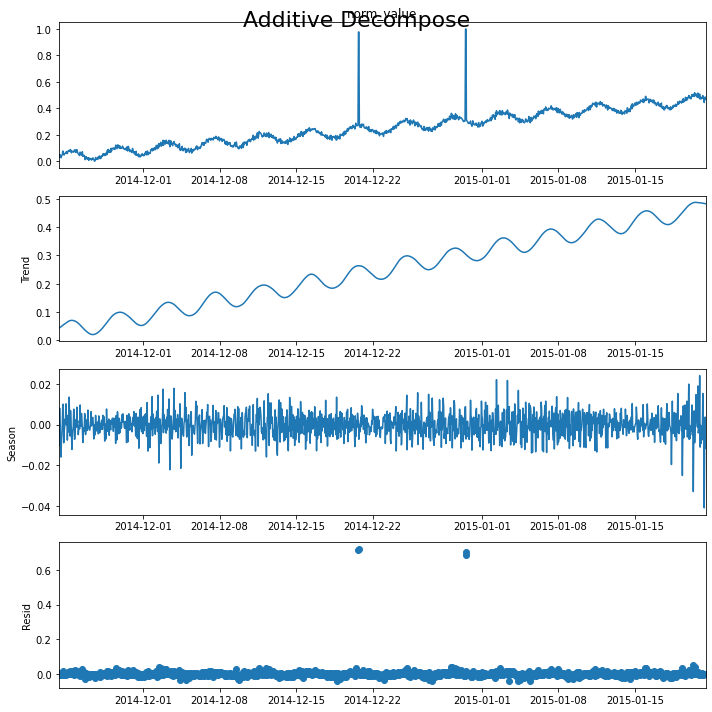

 56%|█████▌    | 56/100 [04:26<03:30,  4.79s/it]

Mean: 3878.769478, StandardDeviation: 2453.291769
Min: -2.073035, Max: 2.426199



A2Benchmark_synthetic_32add_STL


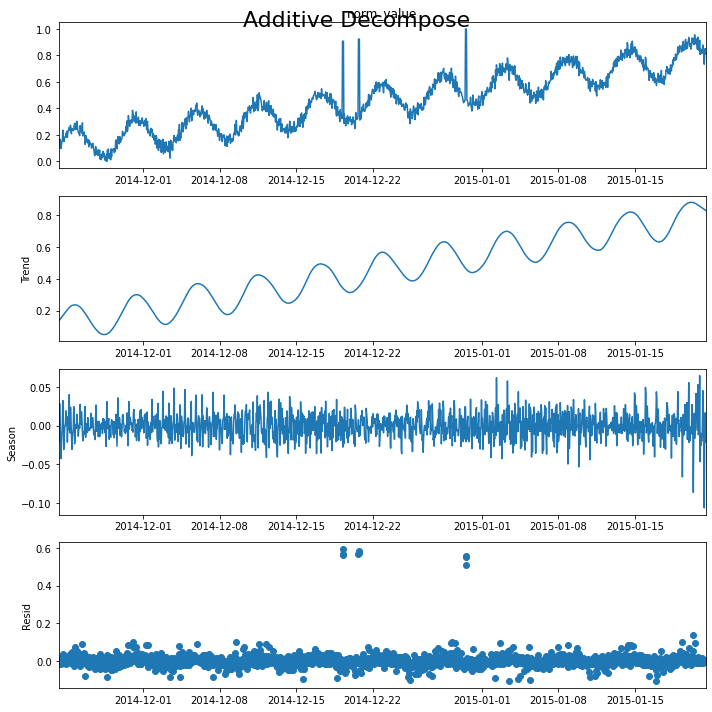

 57%|█████▋    | 57/100 [04:31<03:24,  4.77s/it]

Mean: 2685.056514, StandardDeviation: 1851.148139
Min: -2.433699, Max: 3.212436



A2Benchmark_synthetic_52add_STL


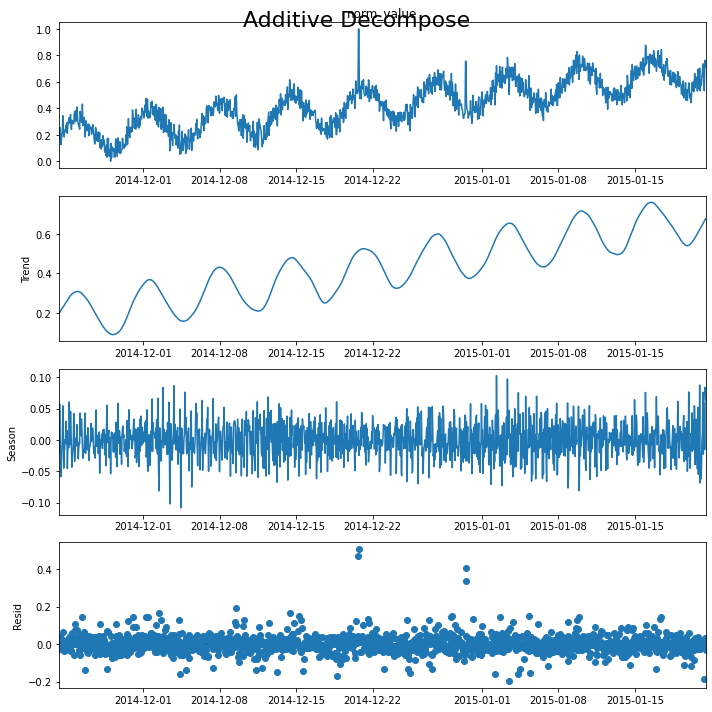

 58%|█████▊    | 58/100 [04:36<03:19,  4.76s/it]

Mean: 16138.431827, StandardDeviation: 9461.186154
Min: -1.709588, Max: 2.911057



A2Benchmark_synthetic_86add_STL


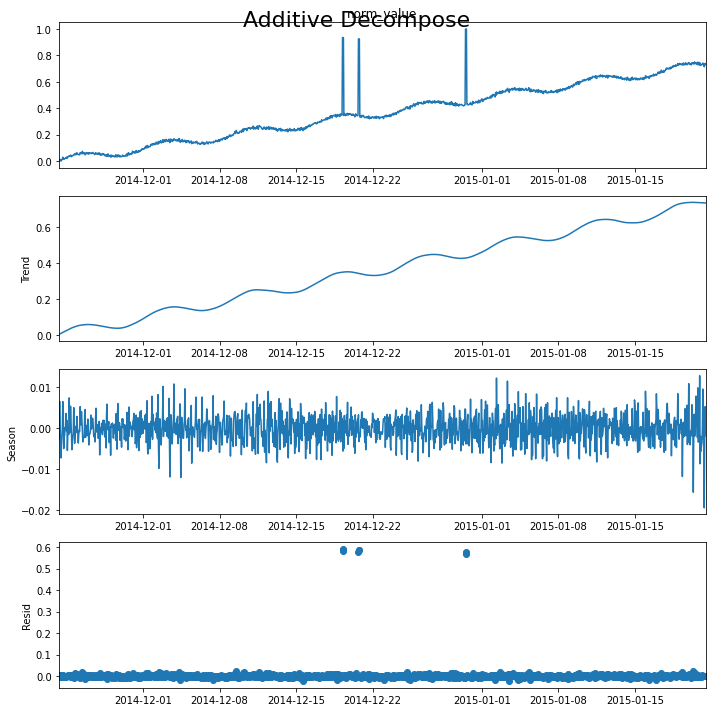

 59%|█████▉    | 59/100 [04:41<03:14,  4.75s/it]

Mean: 37.124113, StandardDeviation: 1004.944051
Min: -1.509902, Max: 3.422280



A2Benchmark_synthetic_5add_STL


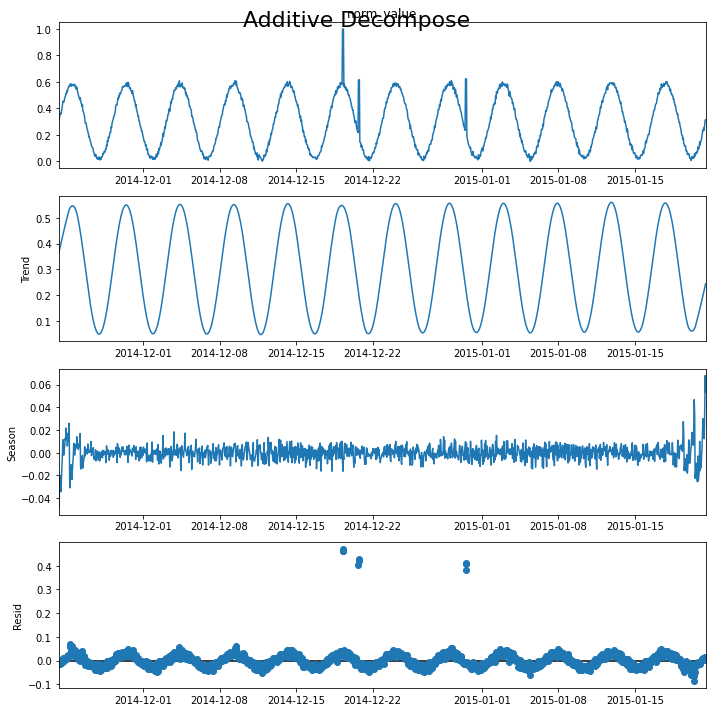

 60%|██████    | 60/100 [04:45<03:09,  4.74s/it]

Processing index: 60 of 100
Mean: 4883.689181, StandardDeviation: 3002.178684
Min: -2.037034, Max: 2.547446



A2Benchmark_synthetic_46add_STL


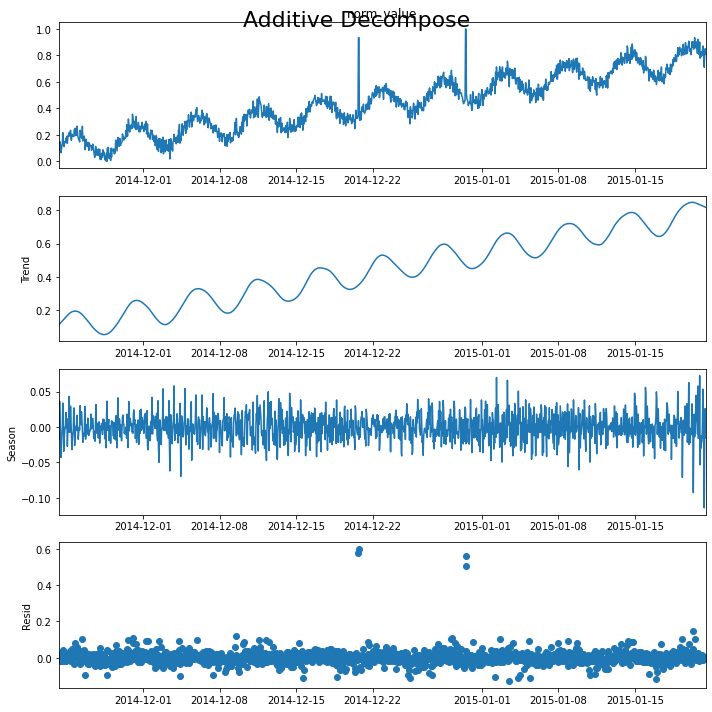

 61%|██████    | 61/100 [04:50<03:06,  4.77s/it]

Mean: 533.967462, StandardDeviation: 1069.884522
Min: -2.420956, Max: 2.540857



A2Benchmark_synthetic_33add_STL


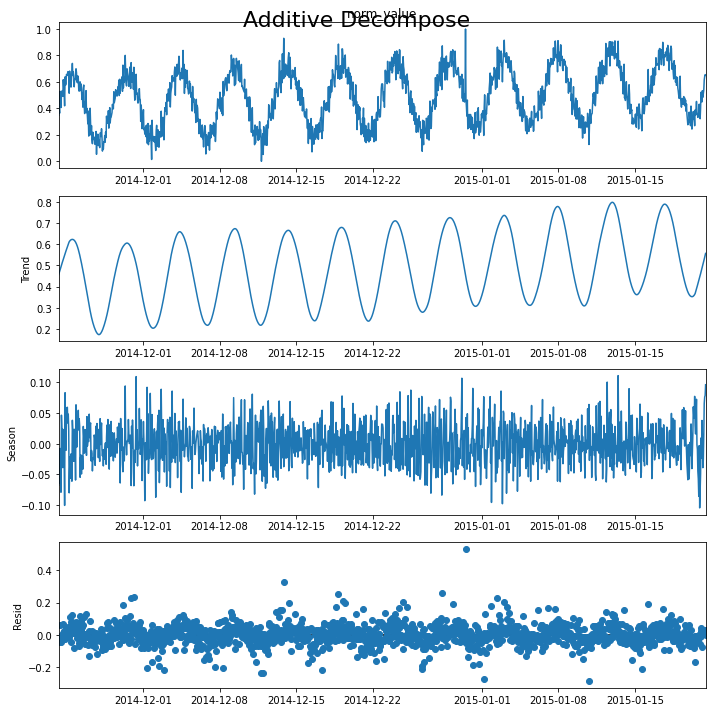

 62%|██████▏   | 62/100 [04:55<03:01,  4.78s/it]

Mean: 1442.278105, StandardDeviation: 1306.683693
Min: -2.471475, Max: 3.160169



A2Benchmark_synthetic_38add_STL


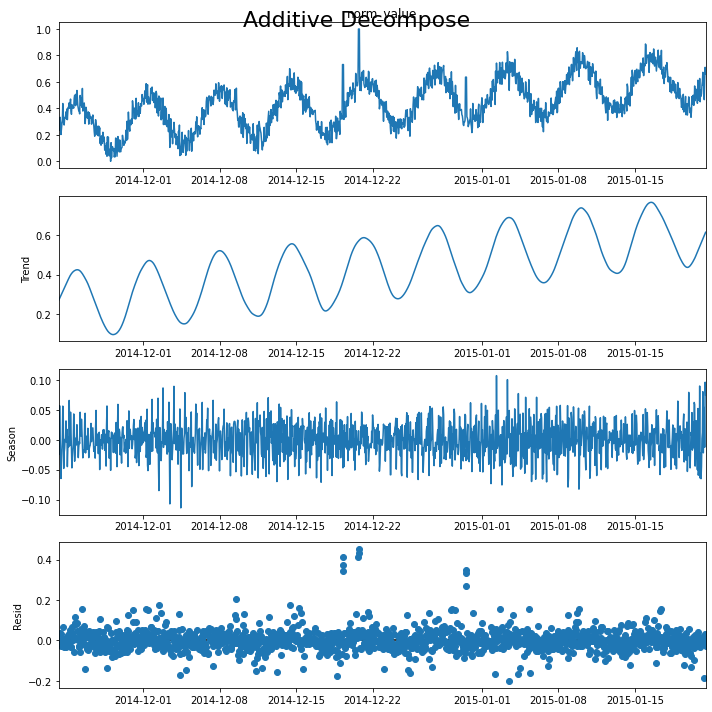

 63%|██████▎   | 63/100 [05:00<02:56,  4.77s/it]

Mean: 3183.865172, StandardDeviation: 2051.585692
Min: -2.252858, Max: 3.147495



A2Benchmark_synthetic_94add_STL


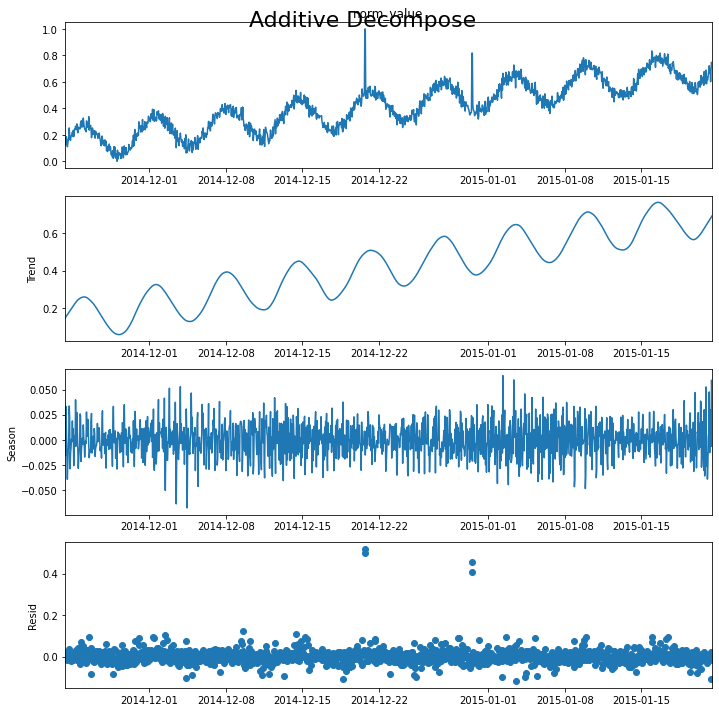

 64%|██████▍   | 64/100 [05:04<02:51,  4.76s/it]

Mean: 10261.456181, StandardDeviation: 6043.947087
Min: -1.711077, Max: 2.911748



A2Benchmark_synthetic_74add_STL


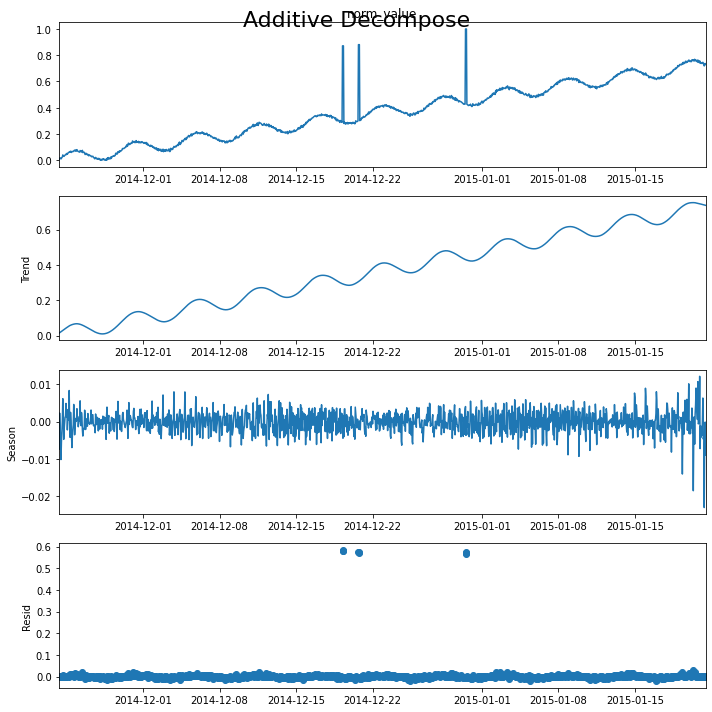

 65%|██████▌   | 65/100 [05:09<02:46,  4.75s/it]

Mean: 486.384558, StandardDeviation: 1024.391457
Min: -1.780355, Max: 2.673989



A2Benchmark_synthetic_2add_STL


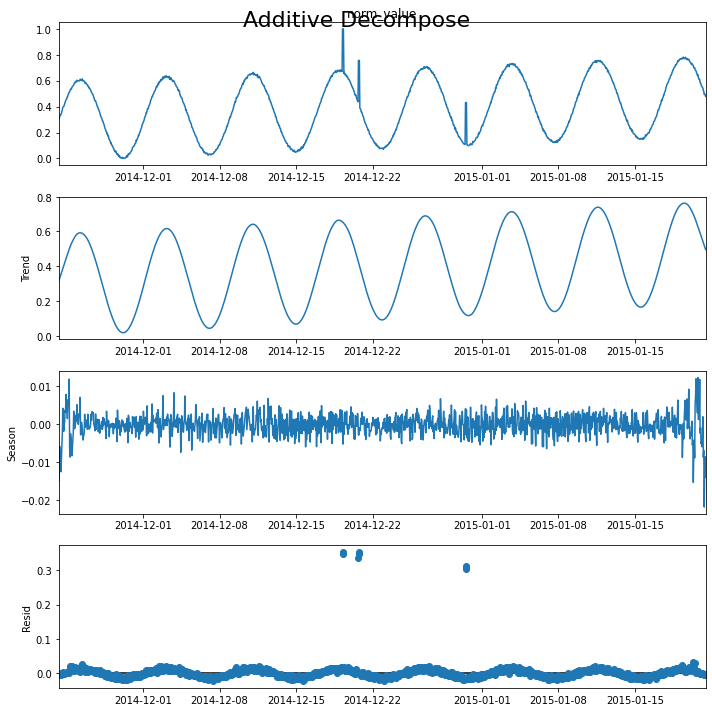

 66%|██████▌   | 66/100 [05:14<02:40,  4.73s/it]

Mean: 197.655971, StandardDeviation: 986.855883
Min: -1.682384, Max: 1.742540



A2Benchmark_synthetic_66add_STL


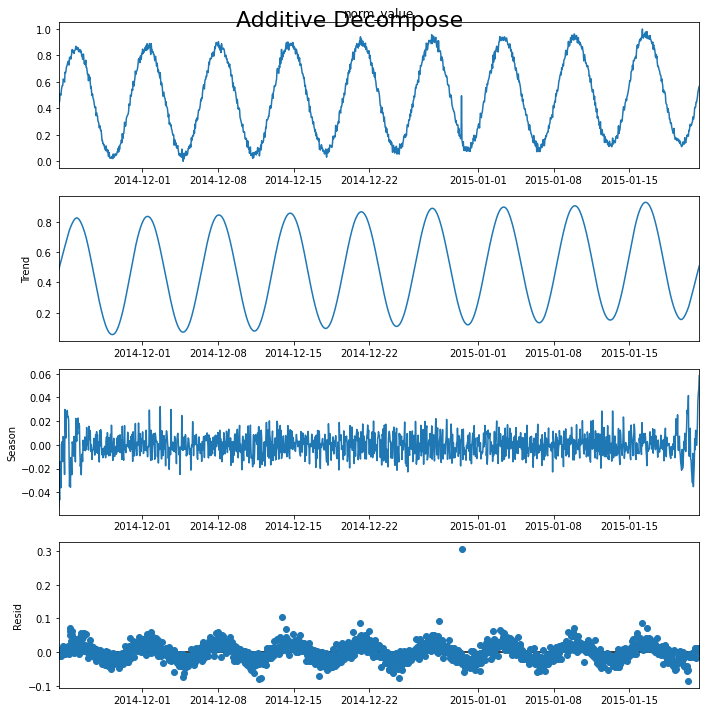

 67%|██████▋   | 67/100 [05:19<02:37,  4.77s/it]

Mean: 959.394771, StandardDeviation: 1155.849408
Min: -2.341582, Max: 4.810664



A2Benchmark_synthetic_31add_STL


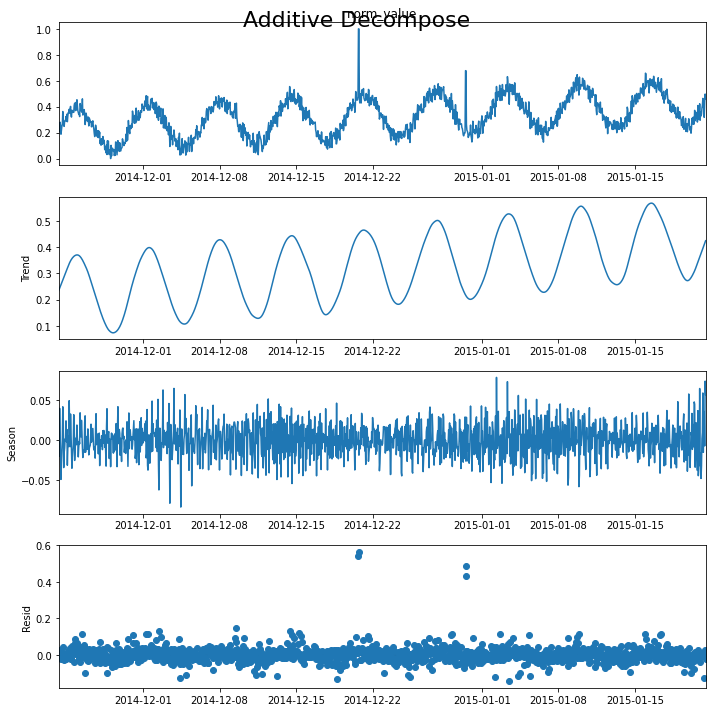

 68%|██████▊   | 68/100 [05:23<02:32,  4.76s/it]

Mean: 6.368346, StandardDeviation: 987.420584
Min: -1.445592, Max: 1.428514



A2Benchmark_synthetic_1add_STL


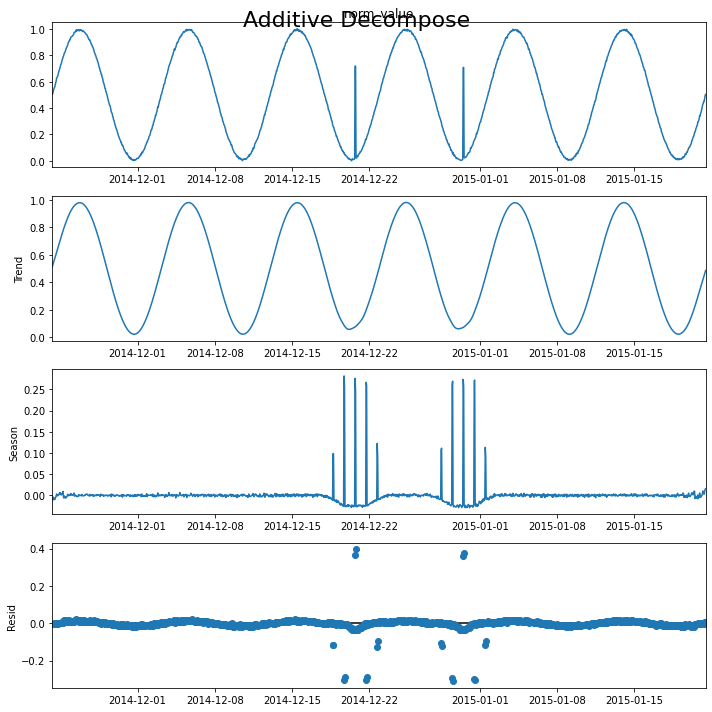

 69%|██████▉   | 69/100 [05:28<02:27,  4.74s/it]

Mean: 16835.838156, StandardDeviation: 9846.453856
Min: -1.769230, Max: 2.897896



A2Benchmark_synthetic_56add_STL


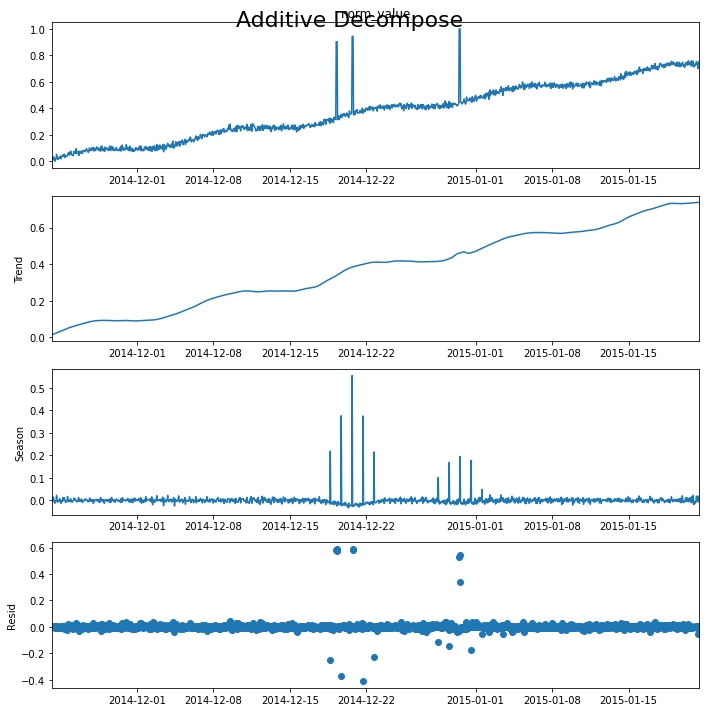

 70%|███████   | 70/100 [05:33<02:21,  4.73s/it]

Processing index: 70 of 100
Mean: 632.735854, StandardDeviation: 1043.469684
Min: -1.899869, Max: 1.855907



A2Benchmark_synthetic_4add_STL


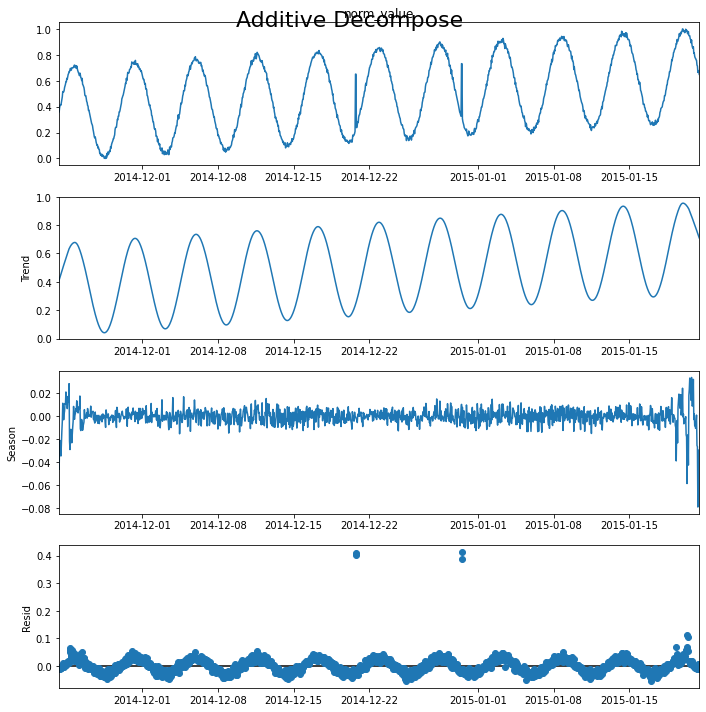

 71%|███████   | 71/100 [05:38<02:17,  4.73s/it]

Mean: 14015.791325, StandardDeviation: 8113.068457
Min: -1.764559, Max: 2.965268



A2Benchmark_synthetic_42add_STL


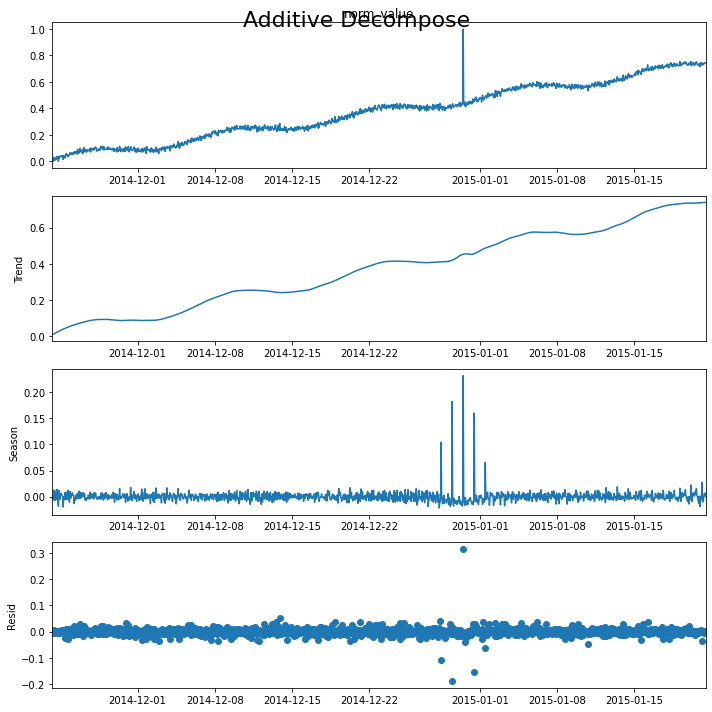

 72%|███████▏  | 72/100 [05:42<02:12,  4.73s/it]

Mean: 28683.962627, StandardDeviation: 16557.612808
Min: -1.739066, Max: 3.080009



A2Benchmark_synthetic_84add_STL


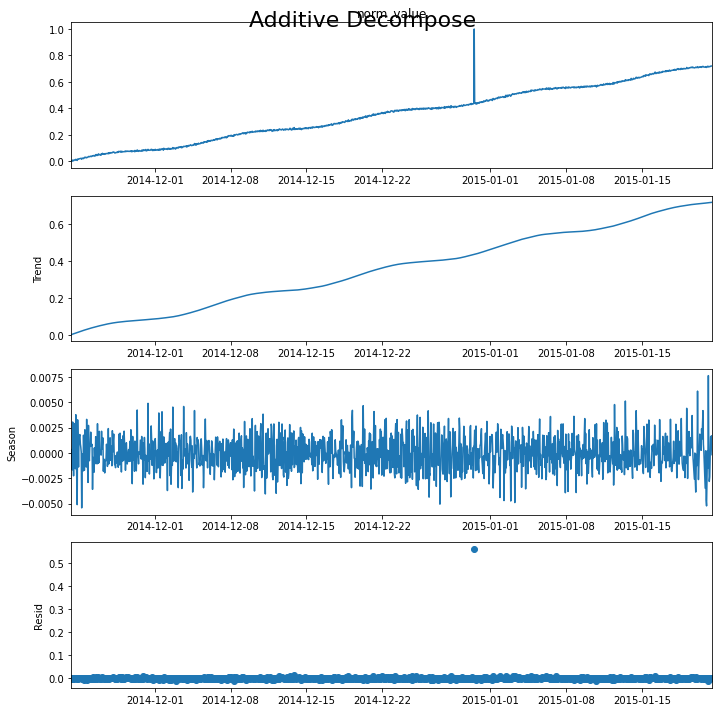

 73%|███████▎  | 73/100 [05:47<02:08,  4.77s/it]

Mean: 4873.417218, StandardDeviation: 2960.351286
Min: -1.701976, Max: 2.722561



A2Benchmark_synthetic_14add_STL


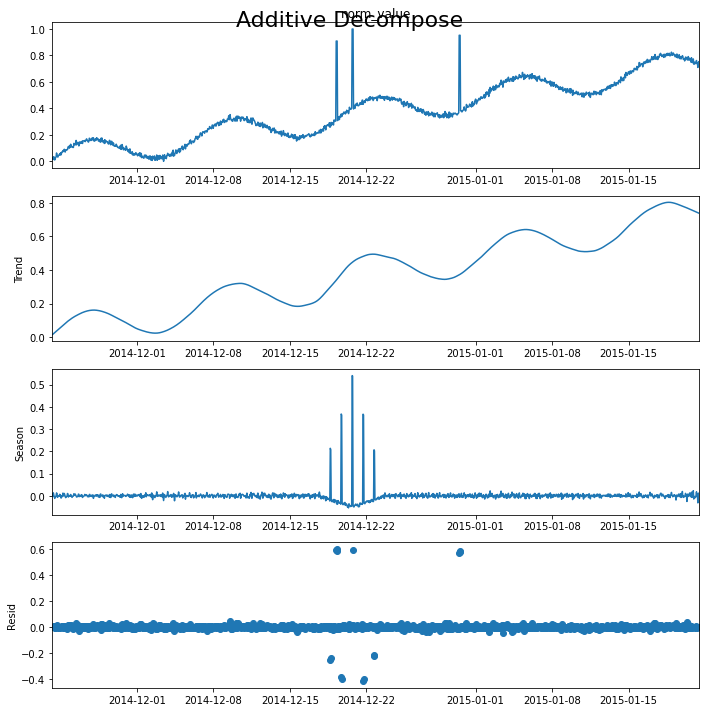

 74%|███████▍  | 74/100 [05:52<02:03,  4.75s/it]

Mean: 480.352675, StandardDeviation: 1013.895439
Min: -2.067220, Max: 2.150073



A2Benchmark_synthetic_22add_STL


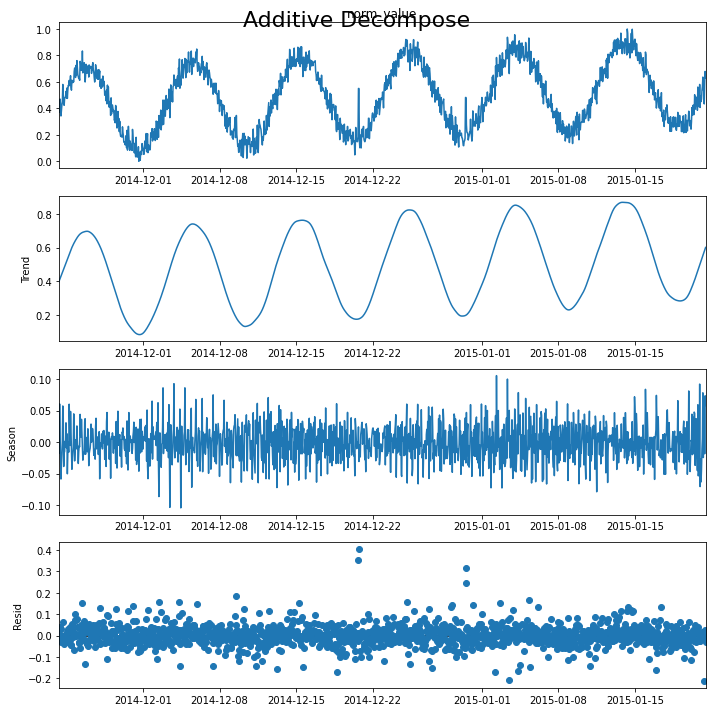

 75%|███████▌  | 75/100 [05:57<01:58,  4.75s/it]

Mean: 1899.806116, StandardDeviation: 1455.974788
Min: -2.312383, Max: 3.802306



A2Benchmark_synthetic_99add_STL


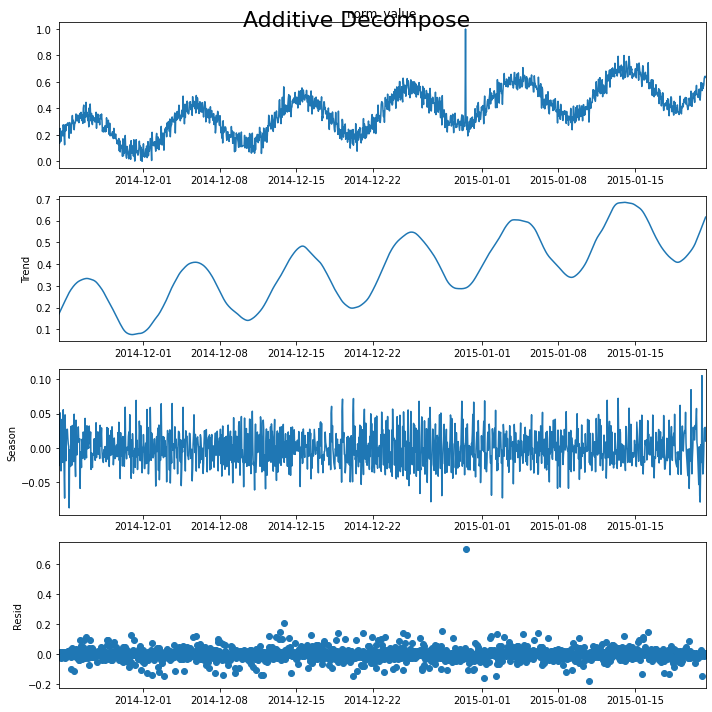

 76%|███████▌  | 76/100 [06:01<01:54,  4.75s/it]

Mean: 6556.232773, StandardDeviation: 4013.701672
Min: -1.779668, Max: 5.148342



A2Benchmark_synthetic_37add_STL


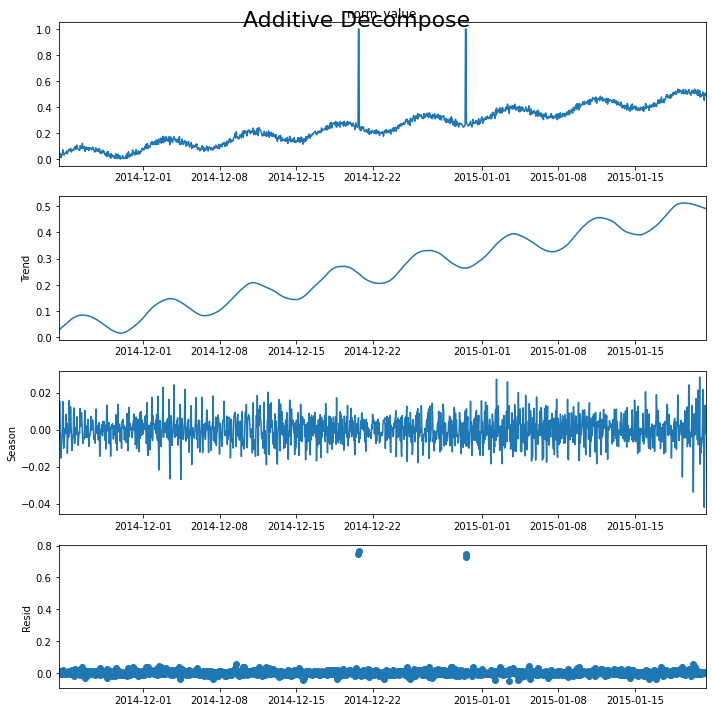

 77%|███████▋  | 77/100 [06:06<01:49,  4.75s/it]

Mean: 853.154308, StandardDeviation: 1095.773774
Min: -2.269723, Max: 2.506368



A2Benchmark_synthetic_29add_STL


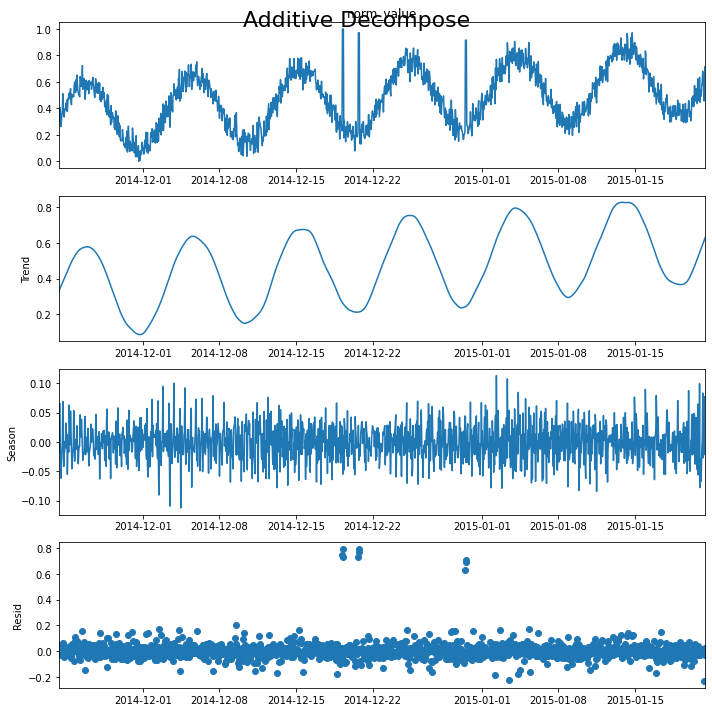

 78%|███████▊  | 78/100 [06:11<01:44,  4.75s/it]

Mean: 5.536843, StandardDeviation: 989.172534
Min: -1.490849, Max: 1.486739



A2Benchmark_synthetic_3add_STL


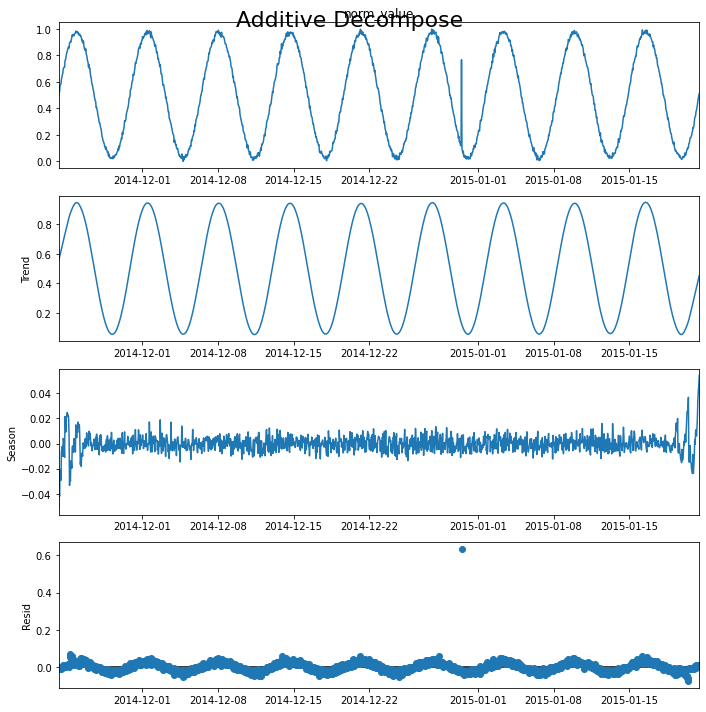

 79%|███████▉  | 79/100 [06:16<01:40,  4.78s/it]

Mean: 1157.094306, StandardDeviation: 1176.287387
Min: -2.317849, Max: 3.054031



A2Benchmark_synthetic_87add_STL


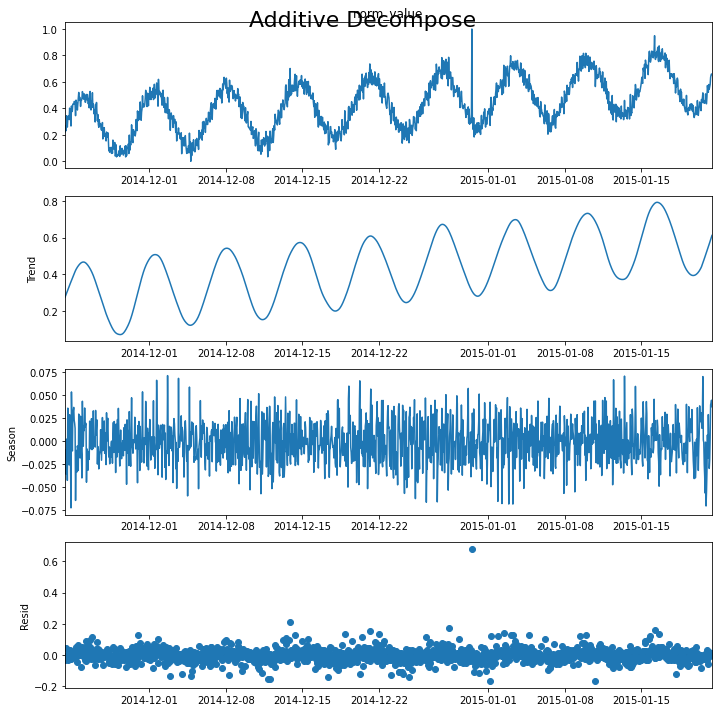

 80%|████████  | 80/100 [06:20<01:35,  4.77s/it]

Processing index: 80 of 100
Mean: 1399.681750, StandardDeviation: 1305.117440
Min: -2.172598, Max: 5.100373



A2Benchmark_synthetic_13add_STL


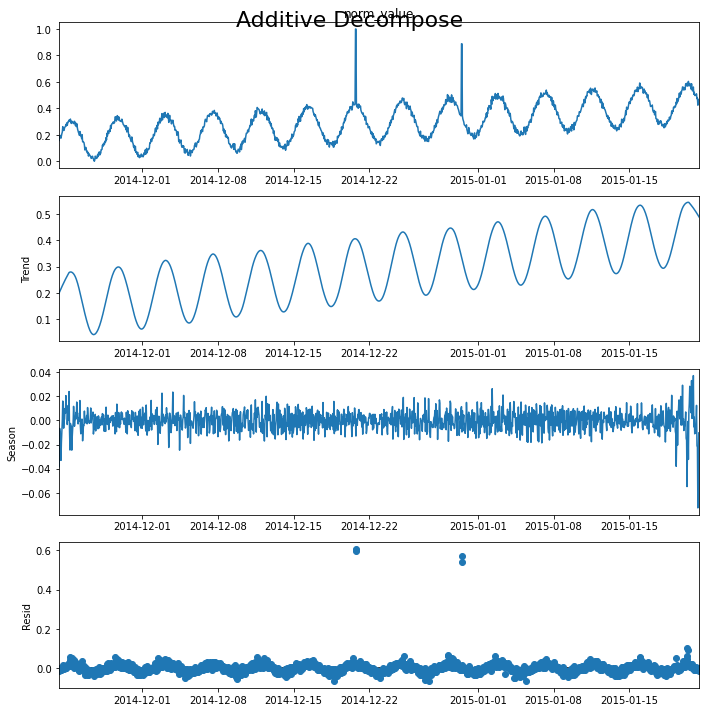

 81%|████████  | 81/100 [06:25<01:30,  4.77s/it]

Mean: 110.688388, StandardDeviation: 1004.712332
Min: -1.834789, Max: 1.834789



A2Benchmark_synthetic_15add_STL


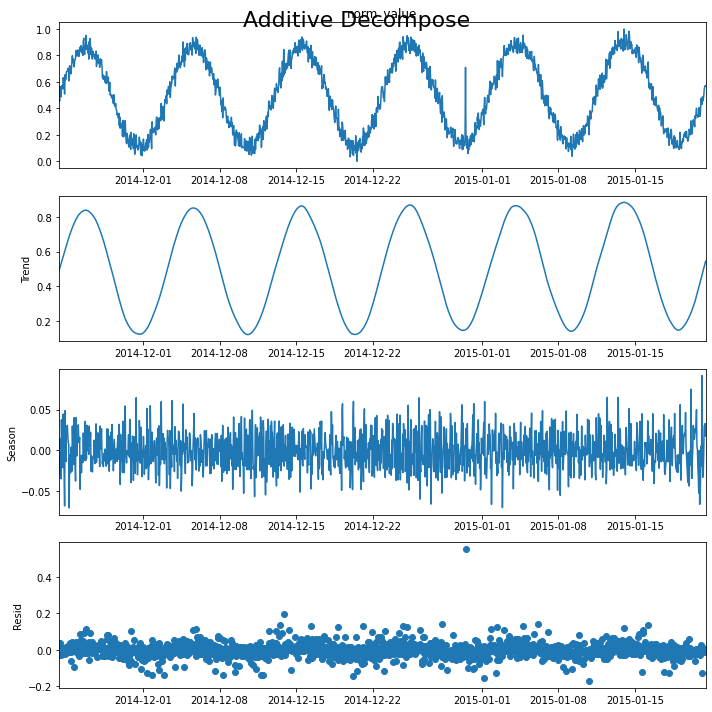

 82%|████████▏ | 82/100 [06:30<01:25,  4.76s/it]

Mean: 718.816759, StandardDeviation: 1066.877174
Min: -1.957838, Max: 1.947027



A2Benchmark_synthetic_6add_STL


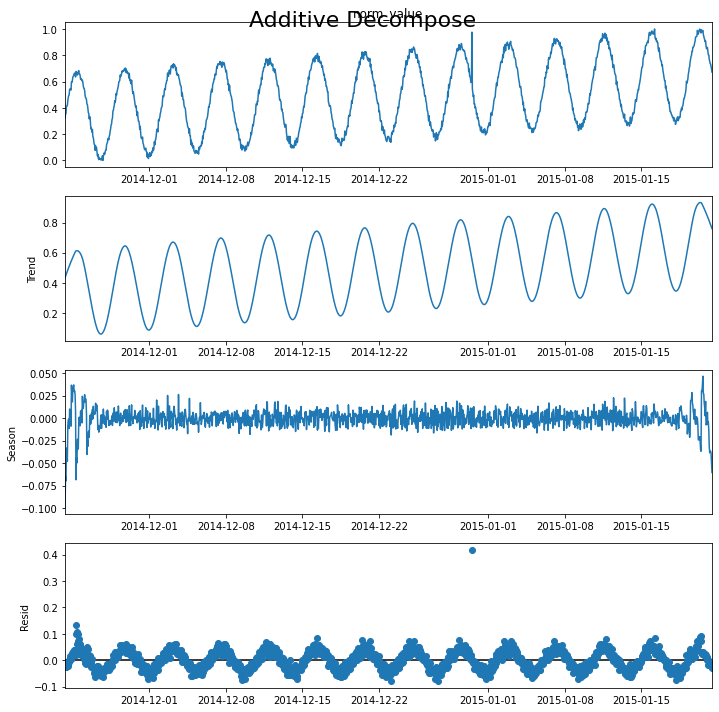

 83%|████████▎ | 83/100 [06:35<01:20,  4.76s/it]

Mean: 1922.216751, StandardDeviation: 1465.779085
Min: -2.131705, Max: 3.915113



A2Benchmark_synthetic_9add_STL


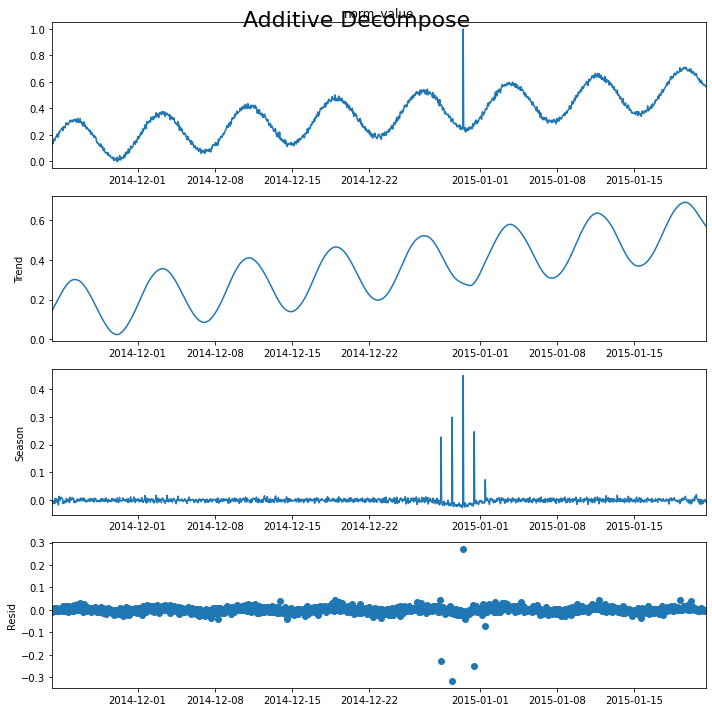

 84%|████████▍ | 84/100 [06:39<01:15,  4.74s/it]

Mean: 15071.243554, StandardDeviation: 8998.690990
Min: -1.729460, Max: 5.490352



A2Benchmark_synthetic_49add_STL


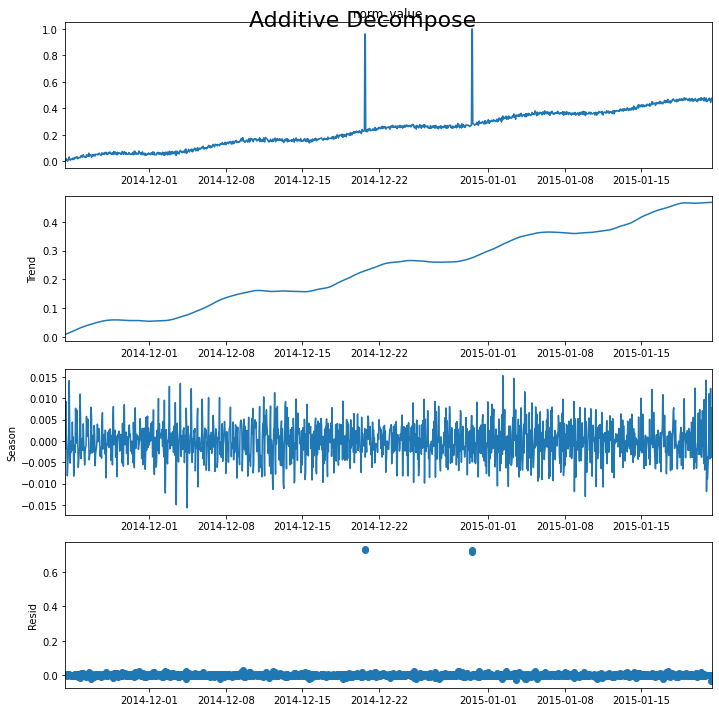

 85%|████████▌ | 85/100 [06:44<01:11,  4.78s/it]

Mean: 11272.001575, StandardDeviation: 6995.543247
Min: -1.634254, Max: 5.256701



A2Benchmark_synthetic_95add_STL


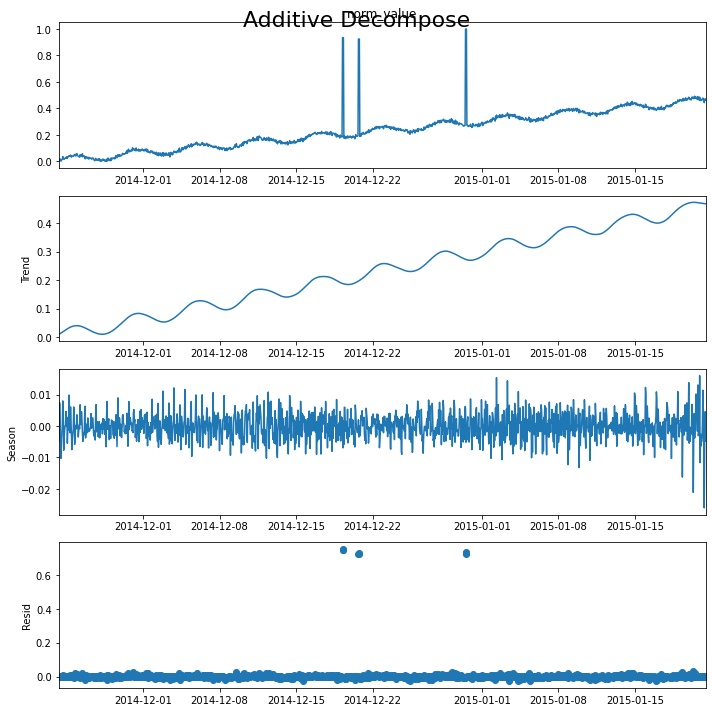

 86%|████████▌ | 86/100 [06:49<01:06,  4.76s/it]

Mean: 262.571053, StandardDeviation: 979.725799
Min: -1.693491, Max: 1.693387



A2Benchmark_synthetic_64add_STL


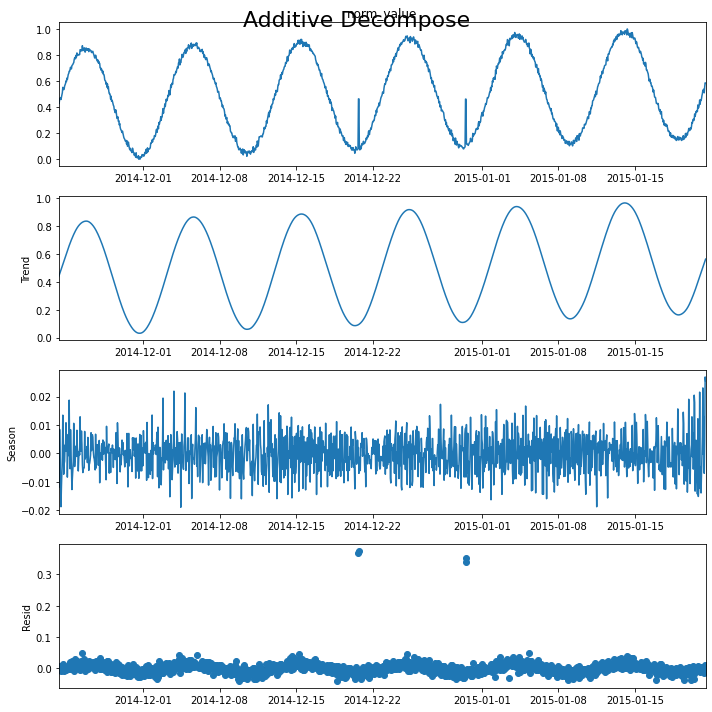

 87%|████████▋ | 87/100 [06:54<01:01,  4.76s/it]

Mean: 7282.327986, StandardDeviation: 4298.843109
Min: -1.722423, Max: 5.445587



A2Benchmark_synthetic_21add_STL


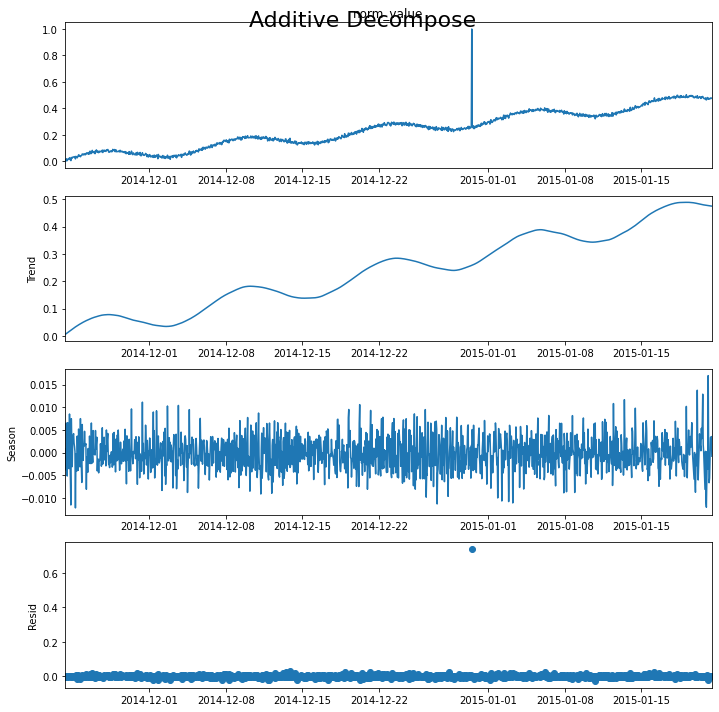

 88%|████████▊ | 88/100 [06:59<00:57,  4.76s/it]

Mean: 7759.722960, StandardDeviation: 4605.211318
Min: -1.851199, Max: 3.068413



A2Benchmark_synthetic_76add_STL


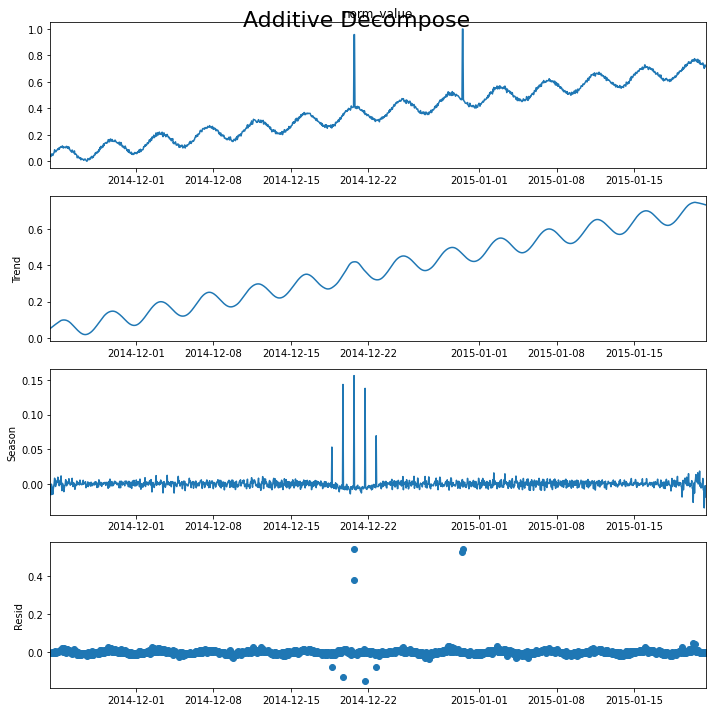

 89%|████████▉ | 89/100 [07:03<00:52,  4.74s/it]

Mean: 9260.052047, StandardDeviation: 5432.702685
Min: -1.841708, Max: 3.109271



A2Benchmark_synthetic_90add_STL


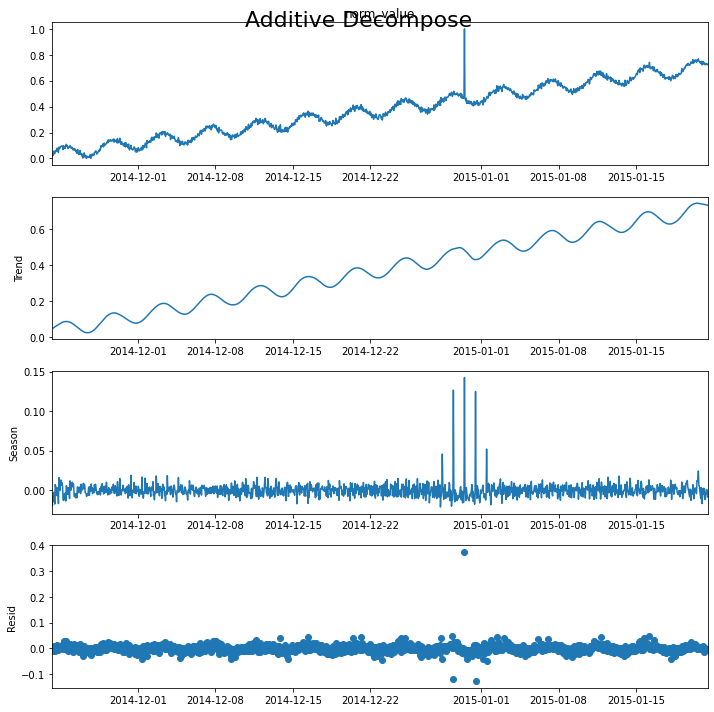

 90%|█████████ | 90/100 [07:08<00:47,  4.73s/it]

Processing index: 90 of 100
Mean: 5334.901872, StandardDeviation: 3432.132309
Min: -1.923329, Max: 4.886633



A2Benchmark_synthetic_53add_STL


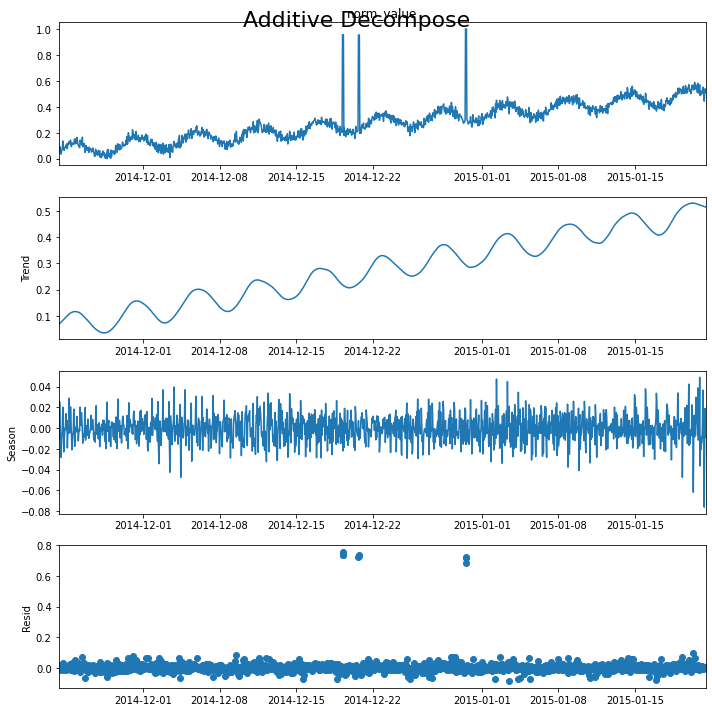

 91%|█████████ | 91/100 [07:13<00:42,  4.77s/it]

Mean: 15368.062661, StandardDeviation: 9186.095179
Min: -1.670049, Max: 5.518660



A2Benchmark_synthetic_79add_STL


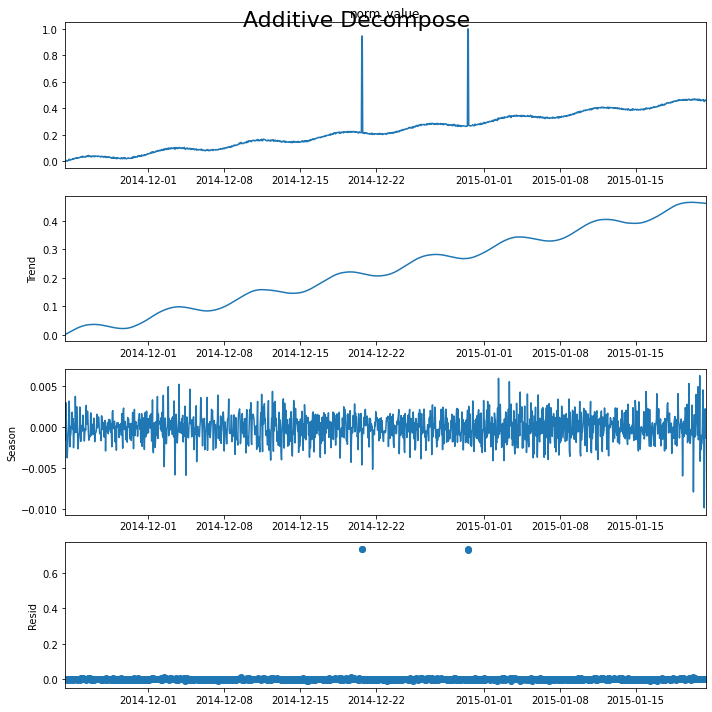

 92%|█████████▏| 92/100 [07:18<00:38,  4.75s/it]

Mean: 68.708294, StandardDeviation: 984.090053
Min: -1.601978, Max: 1.611892



A2Benchmark_synthetic_8add_STL


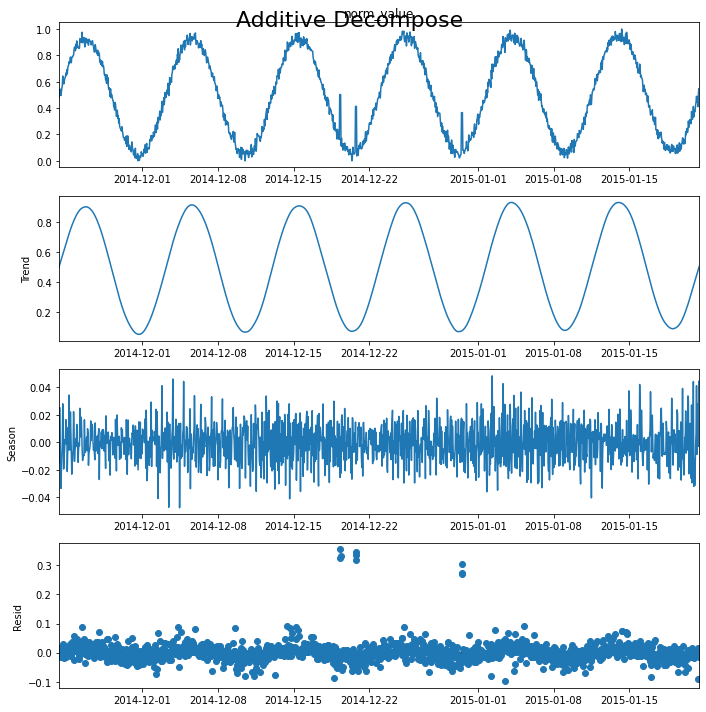

 93%|█████████▎| 93/100 [07:22<00:33,  4.76s/it]

Mean: 29558.600651, StandardDeviation: 17611.290616
Min: -1.683687, Max: 5.613527



A2Benchmark_synthetic_91add_STL


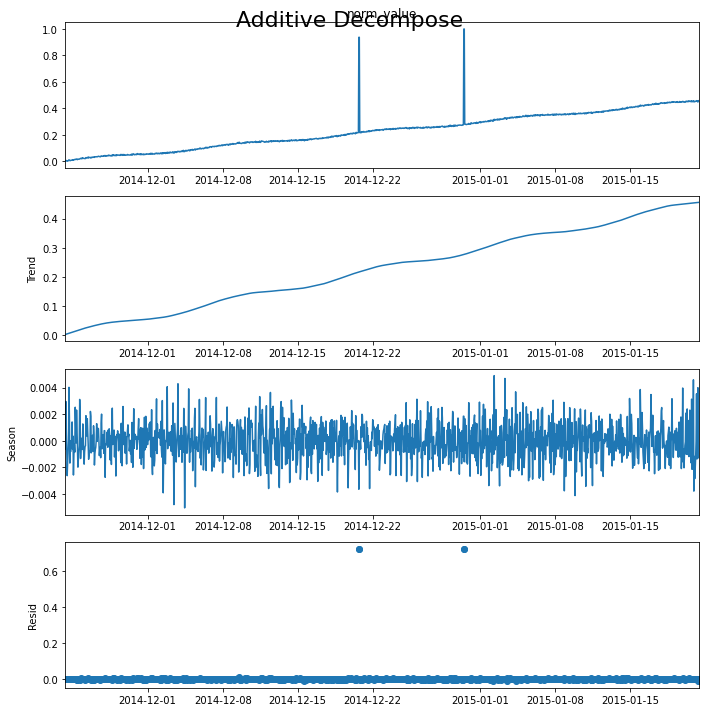

 94%|█████████▍| 94/100 [07:27<00:28,  4.75s/it]

Mean: 1607.222200, StandardDeviation: 1324.676696
Min: -2.314719, Max: 3.133628



A2Benchmark_synthetic_80add_STL


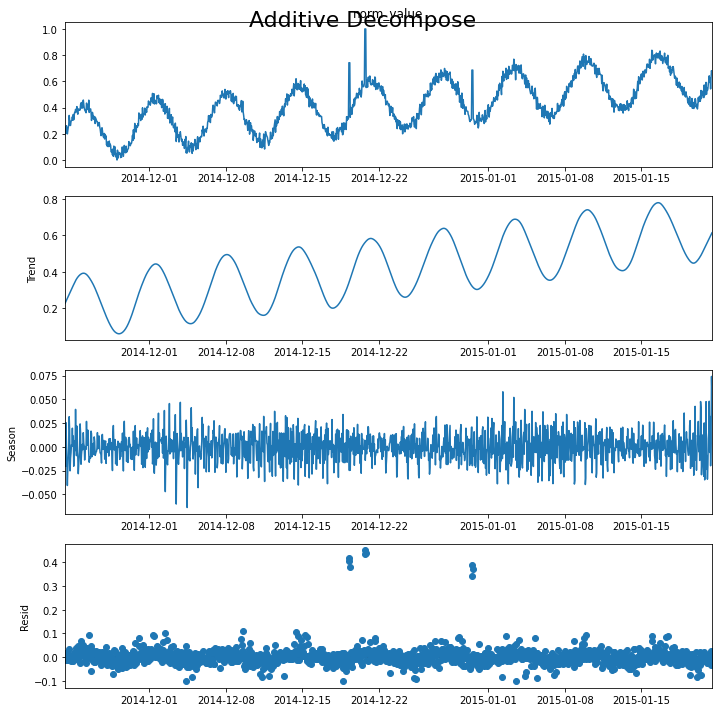

 95%|█████████▌| 95/100 [07:32<00:23,  4.75s/it]

Mean: 31170.980497, StandardDeviation: 18199.274453
Min: -1.723083, Max: 3.006316



A2Benchmark_synthetic_98add_STL


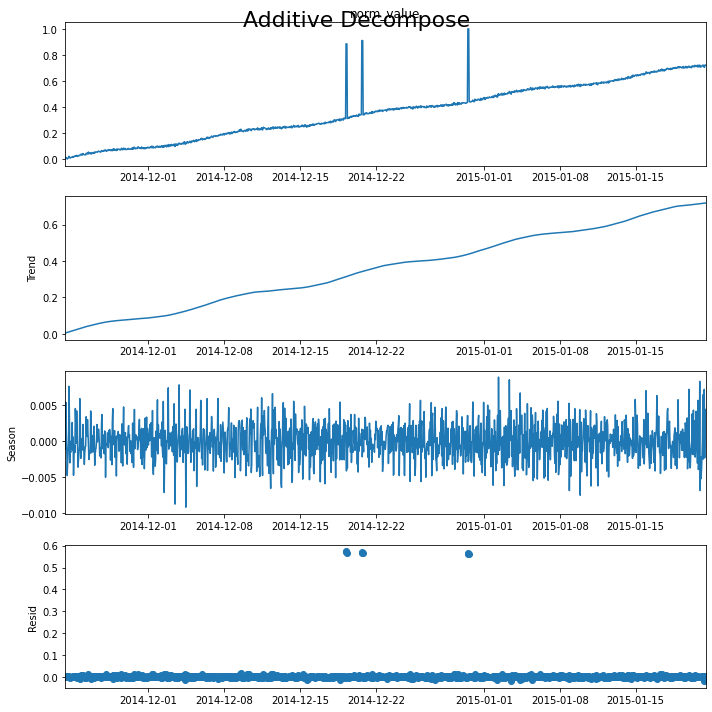

 96%|█████████▌| 96/100 [07:36<00:18,  4.74s/it]

Mean: 10896.892199, StandardDeviation: 6380.266954
Min: -1.725443, Max: 2.935572



A2Benchmark_synthetic_88add_STL


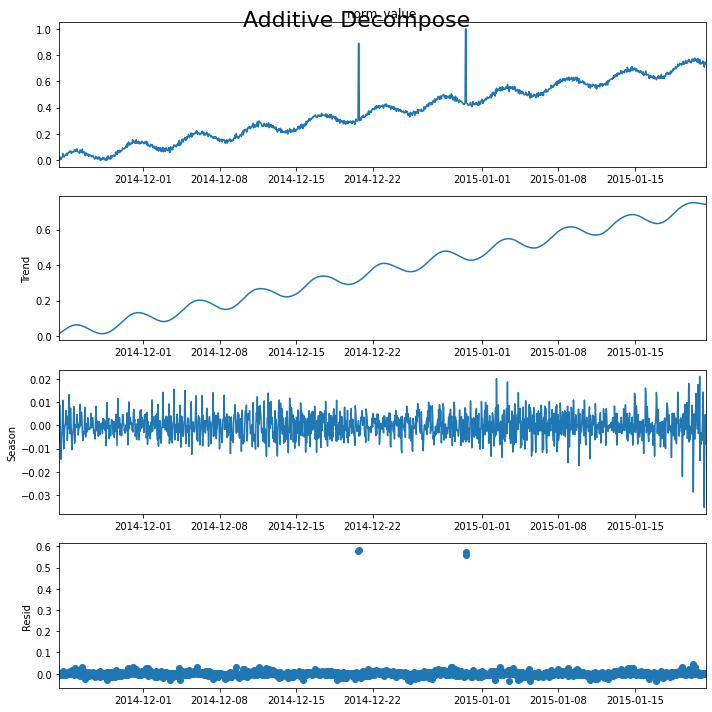

 97%|█████████▋| 97/100 [07:41<00:14,  4.77s/it]

Mean: 24127.274833, StandardDeviation: 13995.205958
Min: -1.719521, Max: 3.043068



A2Benchmark_synthetic_70add_STL


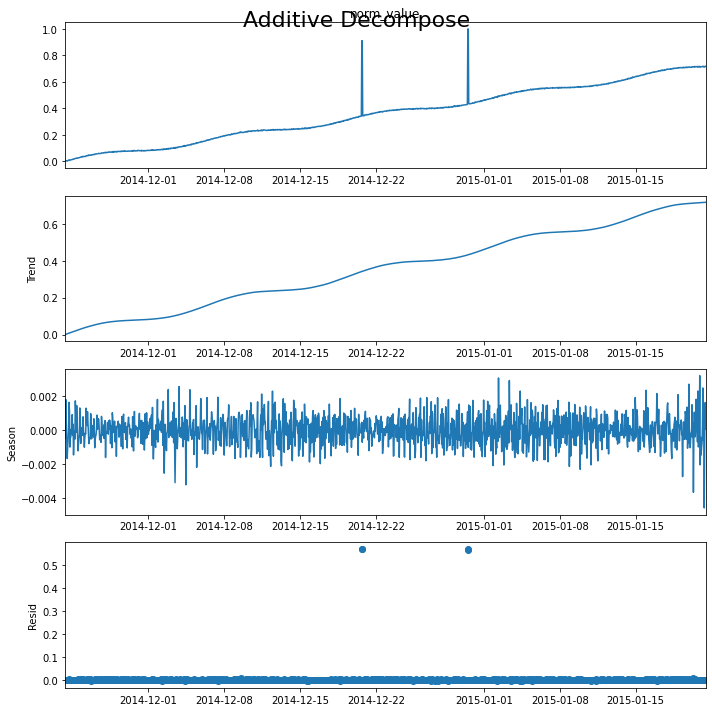

 98%|█████████▊| 98/100 [07:46<00:09,  4.76s/it]

Mean: 956.270534, StandardDeviation: 1118.566136
Min: -2.147579, Max: 4.770269



A2Benchmark_synthetic_73add_STL


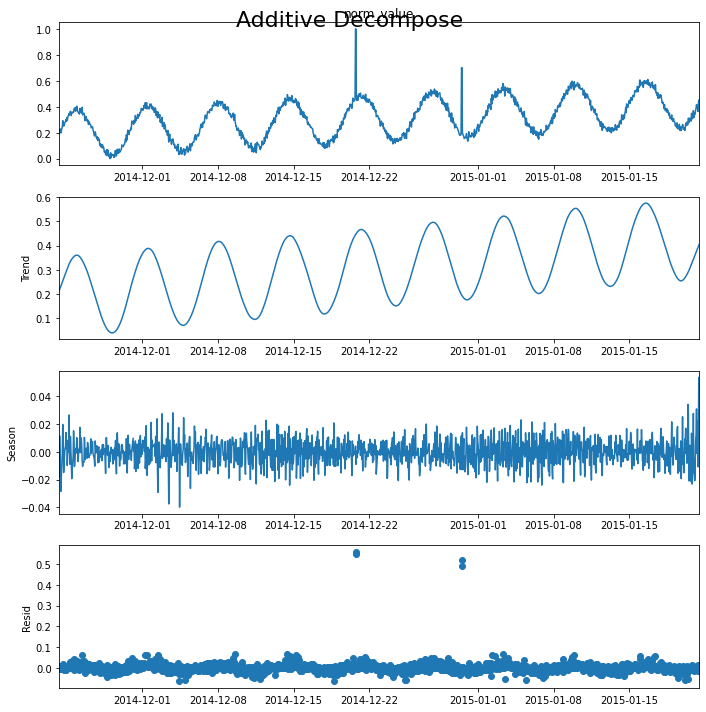

 99%|█████████▉| 99/100 [07:51<00:04,  4.75s/it]

Mean: 18212.607413, StandardDeviation: 10619.940943
Min: -1.732070, Max: 5.680854



A2Benchmark_synthetic_93add_STL


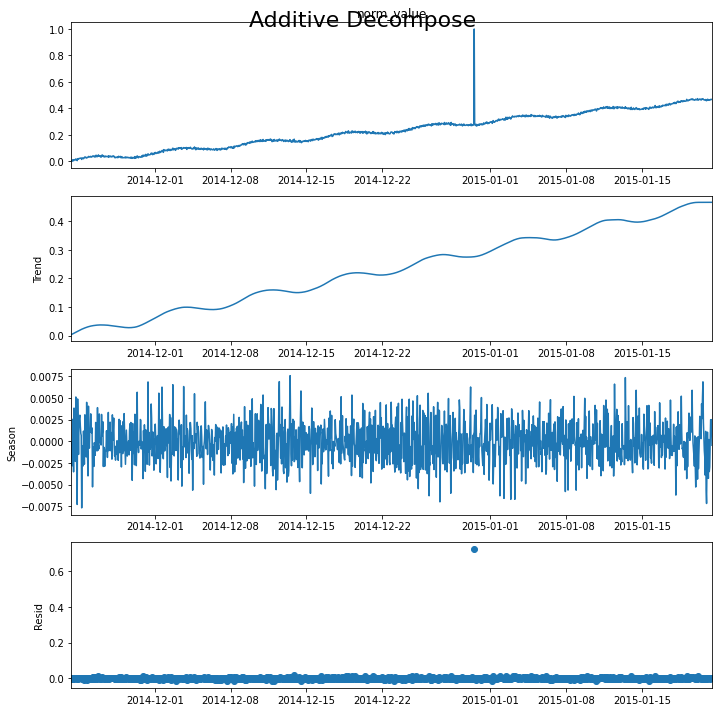

100%|██████████| 100/100 [07:56<00:00,  4.76s/it]

STL Additive decomposition of Yahoo S5 A2 Benchmark processing complete. Time taken:0:07:56.006528


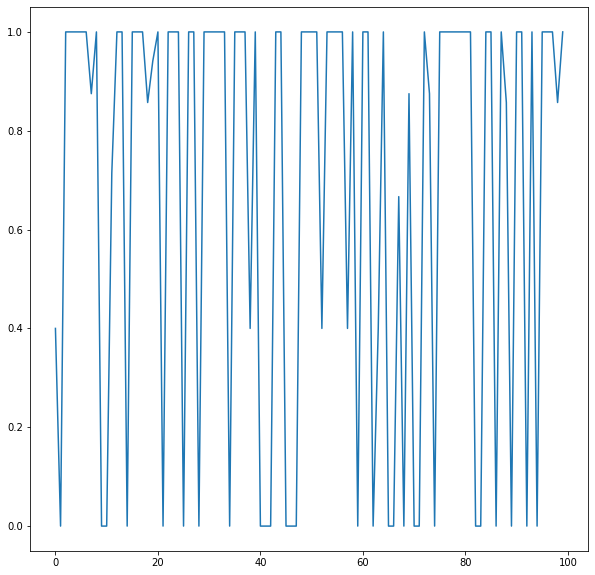

In [ ]:
from tqdm import tqdm
import numpy as np
start_time = datetime.now() 
STLf1_plot = []
STLprecision_plot = []
STLrecall_plot = []
for index,file in enumerate(tqdm(all_csv)):
    if index%10 == 0:
        print(f'Processing index: {index} of {len(all_csv)}')
#     if index > 30:
#         break
    fname = file.split("/")[6].replace('\\','').split(".")[0]
    df = pd.read_csv(file)
    df['timestamp'] = pd.to_datetime(df['timestamp'],unit='s')
    df_indexed = df.set_index('timestamp')
    
    # prepare data for standardization
    values = df_indexed.copy()
    values = values.drop(columns=['is_anomaly'],axis=1)
    #values = values.reshape((len(values), 1))
    
    # train the standardization
    scaler2 = StandardScaler()
    scaler2 = scaler2.fit(values)
    print('Mean: %f, StandardDeviation: %f' % (scaler2.mean_, sqrt(scaler2.var_)))
    # standardize the dataset
    standardaized = scaler2.transform(values)
    
    #jugaad, change so that standardized is used from here on.
    # for i in range(len(df)):
    #     df_indexed['value'].iloc[i] = standardaized[i]
    df_indexed['std_value'] = standardaized
        
    # print(df)
    # prepare data for normalization
    values = np.array(df_indexed['std_value'])
    values = values.reshape((len(values), 1))

    # train the normalization
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaler = scaler.fit(values)
    print('Min: %f, Max: %f' % (scaler.data_min_, scaler.data_max_))

    # normalize the dataset and print the first 5 rows
    normalized = scaler.transform(values)
    df['norm_value'] = normalized
    df_indexed['norm_value'] = normalized
    # print(df_indexed)

    result_add = statsmodels.tsa.seasonal.STL(df_indexed['norm_value']).fit(inner_iter=10,outer_iter=20)
    # Plot
    #plt.rcParams.update({'figure.figsize': (10,10)})
    result_add.plot().suptitle('Additive Decompose', fontsize=22)
    plt.savefig("/content/drive/My Drive/Colab Notebooks/tImeSeries-files/STLoutput/A2Benchmark_newAPI_" + fname +"add_STL")
    print("\n\n\nA2Benchmark_" + fname +"add_STL")
    plt.show()
    threshold=0.3
    residualdf = result_add.resid
    residualdf = residualdf.reset_index()
    
    outliers = residualdf[residualdf.resid > threshold]
    not_outliers = residualdf.reset_index().merge(outliers, how = 'outer' ,indicator=True).loc[lambda x : x['_merge']=='left_only']
    anomalies = df_indexed.join(outliers.set_index('timestamp'),on='timestamp',how='inner')
    not_anomalies = df_indexed.join(not_outliers.set_index('timestamp'),on='timestamp',how='inner')
    #not_outliers = residualdf[residualdf < threshold]
    
    p = df_indexed.loc[df_indexed['is_anomaly'] == 1]
    
    n = df_indexed.loc[df_indexed['is_anomaly'] == 0]
    
    truepositives = anomalies.loc[anomalies['is_anomaly'] == 1]
    
    falsepositives = anomalies.loc[anomalies['is_anomaly'] == 0]
    
    truenegatives = not_anomalies.loc[not_anomalies['is_anomaly'] == 0]
    
    falsenegatives = not_anomalies.loc[not_anomalies['is_anomaly'] == 1]
    
    #Traditional FPR and TPR formmulae
    #tpr = truepositives.count()/(truepositives.count() + falsenegatives.count())
    #fpr = falsepositives.count()/(falsepositives.count() + truenegatives.count())
    
    #IDEAL Paper based TRP/FPR rates
    fpr = len(falsepositives)/len(n)
    tpr = len(truepositives)/len(p)
    fnr = 1-tpr
    tnr = 1-fpr
    
    precision,recall,f1 = calc_stats(truepositives,falsepositives, truenegatives, falsenegatives)
    STLf1_plot.append(f1)
    STLprecision_plot.append(precision)
    STLrecall_plot.append(recall)
    
end_time=datetime.now()
print(f"STL Additive decomposition of Yahoo S5 A2 Benchmark processing complete. Time taken:{end_time-start_time}")
# print(f1_plot)
plt.plot(STLf1_plot)

In [ ]:
print(sum(f1_plot)/len(f1_plot))

0.4


### Changing Manual threshold to k std devs

Now that we have the standardized values of the TS applied, we change the value of the threshold from a static to a dynamically set value. First we try the k standard deviations method of deciding the threshold.

In [ ]:
from tqdm import tqdm
import numpy as np
start_time = datetime.now() 
f1_plot = []
for index,file in enumerate(tqdm(all_csv)):
    if index%10 == 0:
        print(f'Processing index: {index} of {len(all_csv)}')
#     if index > 30:
#         break
    fname = file.split("/")[6].replace('\\','').split(".")[0]
    df = pd.read_csv(file)
    df['timestamp'] = pd.to_datetime(df['timestamp'],unit='s')
    df_indexed = df.set_index('timestamp')
    
    # prepare data for standardization
    values = df_indexed.copy()
    values = values.drop(columns=['is_anomaly'],axis=1)
    #values = values.reshape((len(values), 1))
    
    # train the standardization
    scaler2 = StandardScaler()
    scaler2 = scaler2.fit(values)
    print('Mean: %f, StandardDeviation: %f' % (scaler2.mean_, sqrt(scaler2.var_)))
    # standardize the dataset
    standardaized = scaler2.transform(values)
    
    #jugaad, change so that standardized is used from here on.
    # for i in range(len(df)):
    #     df_indexed['value'].iloc[i] = standardaized[i]
    values['std_val'] = standardaized
        
    print(df)
    result_add = statsmodels.tsa.seasonal.STL(values['std_val']).fit(inner_iter=10,outer_iter=20)
    # Plot
    #plt.rcParams.update({'figure.figsize': (10,10)})
    result_add.plot().suptitle('Additive Decompose', fontsize=22)
    plt.savefig("/content/drive/My Drive/Colab Notebooks/tImeSeries-files/STLoutput/A2Benchmark_newAPI_" + fname +"add_STL")
    print("\n\n\nA2Benchmark_" + fname +"add_STL")
    plt.show()
    threshold=2*(np.std(values['std_val']))
    residualdf = result_add.resid
    residualdf = residualdf.reset_index()
    
    outliers = residualdf[residualdf.resid > threshold]
    not_outliers = residualdf.reset_index().merge(outliers, how = 'outer' ,indicator=True).loc[lambda x : x['_merge']=='left_only']
    anomalies = df_indexed.join(outliers.set_index('timestamp'),on='timestamp',how='inner')
    not_anomalies = df_indexed.join(not_outliers.set_index('timestamp'),on='timestamp',how='inner')
    #not_outliers = residualdf[residualdf < threshold]
    
    p = df_indexed.loc[df_indexed['is_anomaly'] == 1]
    
    n = df_indexed.loc[df_indexed['is_anomaly'] == 0]
    
    truepositives = anomalies.loc[anomalies['is_anomaly'] == 1]
    
    falsepositives = anomalies.loc[anomalies['is_anomaly'] == 0]
    
    truenegatives = not_anomalies.loc[not_anomalies['is_anomaly'] == 0]
    
    falsenegatives = not_anomalies.loc[not_anomalies['is_anomaly'] == 1]
    
    #Traditional FPR and TPR formmulae
    #tpr = truepositives.count()/(truepositives.count() + falsenegatives.count())
    #fpr = falsepositives.count()/(falsepositives.count() + truenegatives.count())
    
    #IDEAL Paper based TRP/FPR rates
    fpr = len(falsepositives)/len(n)
    tpr = len(truepositives)/len(p)
    fnr = 1-tpr
    tnr = 1-fpr
    
    precision = len(truepositives)/(len(truepositives) + len(falsepositives))
    recall = len(truepositives)/(len(truepositives) + len(falsenegatives))
    
    f1 = 2 * (precision * recall)/(precision + recall)
    f1_plot.append(f1)
    
    with open("/content/drive/My Drive/Colab Notebooks/tImeSeries-files/STLoutput/"+ fname + "_newAPI.txt", 'w') as file:
        file.write(f"\n\nFile: {fname}")
        file.write("\nthreshold: 500")
        file.write("\nOutliers:\n")
        file.write(outliers.to_csv())
        
        file.write("\n\n\n Statistics:")
        file.write(f"\ntrue positives:{len(truepositives)}")
        file.write(f"\nfalse positives:{len(falsepositives)}")
        file.write(f"\ntrue negatives:{len(truenegatives)}")
        file.write(f"\nfalse negatives:{len(falsenegatives)}")
        file.write(f"\nFPR:{fpr}")
        file.write(f"\nTPR:{tpr}")
        file.write(f"\nFNR:{fnr}")
        file.write(f"\nTNR:{tnr}")
        
        file.write(f"\nPrecision:{precision}")
        file.write(f"\nREcall:{recall}")
        file.write(f"\nF1:{f1}")
        
        
    print(f"\n\nFile: {fname}")
    print(f"threshold:{threshold}")
    print("Actual Outliers:", len(p))
    print(p)
    print("Detected outliers:", len(outliers))
    print("Outliers:")
    print(outliers)
    print("--------------------")
end_time=datetime.now()
print(f"STL Additive decomposition of Yahoo S5 A2 Benchmark processing complete. Time taken:{end_time-start_time}")
print(f1_plot)
plt.plot(f1_plot)

  0%|          | 0/100 [00:00<?, ?it/s]

Processing index: 0 of 100
Mean: 1588.069123, StandardDeviation: 1364.684820
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   508.681619           0
1    2014-11-23 08:00:00   -52.044324           0
2    2014-11-23 09:00:00   688.353631           0
3    2014-11-23 10:00:00   741.258885           0
4    2014-11-23 11:00:00   472.570612           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  3049.616790           0
1417 2015-01-21 08:00:00  1840.013232           0
1418 2015-01-21 09:00:00  3083.214258           0
1419 2015-01-21 10:00:00  3763.025910           0
1420 2015-01-21 11:00:00  3382.041463           0

[1421 rows x 3 columns]


/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/seasonal.py:291: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(len(series), 1)
  1%|          | 1/100 [00:02<04:48,  2.92s/it]




A2Benchmark_synthetic_40add_STL


File: synthetic_40
threshold:1.9999999999999996
Actual Outliers: 4
                           value  is_anomaly
timestamp                                   
2014-12-20 17:00:00  4205.406804           1
2014-12-20 18:00:00  4205.406804           1
2014-12-30 12:00:00  4055.339210           1
2014-12-30 13:00:00  4055.339210           1
Detected outliers: 2
Outliers:
              timestamp     resid
659 2014-12-20 18:00:00  2.523665
894 2014-12-30 13:00:00  2.076615
--------------------
Mean: 9558.249333, StandardDeviation: 5634.500670
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00   -306.778004           0
1    2014-11-23 08:00:00    166.973172           0
2    2014-11-23 09:00:00   -294.134401           0
3    2014-11-23 10:00:00   1007.698448           0
4    2014-11-23 11:00:00    420.373335           0
...                  ...           ...         ...
1416 2015-01-21 07:00:00  19125.220951           0
1417 2015-01-2

/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/seasonal.py:291: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(len(series), 1)
  2%|▏         | 2/100 [00:05<04:44,  2.91s/it]




A2Benchmark_synthetic_51add_STL


File: synthetic_51
threshold:1.9999999999999996
Actual Outliers: 1
                            value  is_anomaly
timestamp                                    
2014-12-30 12:00:00  40447.022399           1
Detected outliers: 1
Outliers:
              timestamp    resid
893 2014-12-30 12:00:00  2.34289
--------------------
Mean: 556.168299, StandardDeviation: 1032.250432
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   -93.812494           0
1    2014-11-23 08:00:00   103.595557           0
2    2014-11-23 09:00:00    24.559448           0
3    2014-11-23 10:00:00   466.082451           0
4    2014-11-23 11:00:00   348.780473           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00   824.045104           0
1417 2015-01-21 08:00:00  1051.258792           0
1418 2015-01-21 09:00:00  1156.487387           0
1419 2015-01-21 10:00:00  1229.842666           0
1420 2015-01-21 11:00:00  1259.104318    

/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/seasonal.py:291: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(len(series), 1)
  3%|▎         | 3/100 [00:09<05:05,  3.15s/it]




A2Benchmark_synthetic_75add_STL


File: synthetic_75
threshold:1.9999999999999991
Actual Outliers: 1
                           value  is_anomaly
timestamp                                   
2014-12-30 12:00:00  3364.381794           1
Detected outliers: 1
Outliers:
              timestamp     resid
893 2014-12-30 12:00:00  2.876387
--------------------
Mean: 3493.558825, StandardDeviation: 2366.714471
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   700.730093           0
1    2014-11-23 08:00:00   -86.491432           0
2    2014-11-23 09:00:00   914.105274           0
3    2014-11-23 10:00:00   970.021956           0
4    2014-11-23 11:00:00   584.018188           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  7433.275477           0
1417 2015-01-21 08:00:00  5590.802950           0
1418 2015-01-21 09:00:00  7116.892722           0
1419 2015-01-21 10:00:00  7867.679023           0
1420 2015-01-21 11:00:00  7160.276795    

/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/seasonal.py:291: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(len(series), 1)
  4%|▍         | 4/100 [00:12<04:56,  3.09s/it]




A2Benchmark_synthetic_55add_STL


File: synthetic_55
threshold:2.000000000000001
Actual Outliers: 4
                            value  is_anomaly
timestamp                                    
2014-12-20 17:00:00  16488.904916           1
2014-12-20 18:00:00  16488.904916           1
2014-12-30 12:00:00  15354.072990           1
2014-12-30 13:00:00  15354.072990           1
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  5.111137
659 2014-12-20 18:00:00  5.312183
893 2014-12-30 12:00:00  4.492891
894 2014-12-30 13:00:00  4.873574
--------------------
Mean: 3513.971473, StandardDeviation: 2396.965434
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   751.268840           0
1    2014-11-23 08:00:00  -127.340728           0
2    2014-11-23 09:00:00   911.886503           0
3    2014-11-23 10:00:00   938.316196           0
4    2014-11-23 11:00:00   491.434301           0
...                  ...          ...         ...

/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/seasonal.py:291: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(len(series), 1)
  5%|▌         | 5/100 [00:15<04:48,  3.04s/it]




A2Benchmark_synthetic_59add_STL


File: synthetic_59
threshold:1.9999999999999973
Actual Outliers: 9
                            value  is_anomaly
timestamp                                    
2014-12-19 06:00:00  14321.055903           1
2014-12-19 07:00:00  14321.055903           1
2014-12-19 08:00:00  14321.055903           1
2014-12-20 17:00:00  16218.073649           1
2014-12-20 18:00:00  16218.073649           1
2014-12-20 19:00:00  16218.073649           1
2014-12-30 12:00:00  13972.268474           1
2014-12-30 13:00:00  13972.268474           1
2014-12-30 14:00:00  13972.268474           1
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  4.884483
624 2014-12-19 07:00:00  5.072863
625 2014-12-19 08:00:00  4.751965
658 2014-12-20 17:00:00  4.910784
659 2014-12-20 18:00:00  5.102379
660 2014-12-20 19:00:00  5.001061
893 2014-12-30 12:00:00  4.348562
894 2014-12-30 13:00:00  4.713744
895 2014-12-30 14:00:00  4.638980
-------------------

/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/seasonal.py:291: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(len(series), 1)
  6%|▌         | 6/100 [00:18<04:44,  3.03s/it]




A2Benchmark_synthetic_19add_STL


File: synthetic_19
threshold:1.9999999999999982
Actual Outliers: 4
                           value  is_anomaly
timestamp                                   
2014-12-20 17:00:00  2701.113338           1
2014-12-20 18:00:00  2701.113338           1
2014-12-30 12:00:00  2570.985949           1
2014-12-30 13:00:00  2570.985949           1
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  2.584735
659 2014-12-20 18:00:00  2.907059
893 2014-12-30 12:00:00  2.292515
894 2014-12-30 13:00:00  2.640115
--------------------
Mean: 2596.446120, StandardDeviation: 1785.539102
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00  -109.796772           0
1    2014-11-23 08:00:00   105.443021           0
2    2014-11-23 09:00:00   -10.573313           0
3    2014-11-23 10:00:00   497.612830           0
4    2014-11-23 11:00:00   336.279685           0
...                  ...          ...         ...
1416

/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/seasonal.py:291: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(len(series), 1)
  7%|▋         | 7/100 [00:21<04:38,  3.00s/it]




A2Benchmark_synthetic_18add_STL


File: synthetic_18
threshold:2.0
Actual Outliers: 1
                           value  is_anomaly
timestamp                                   
2014-12-30 12:00:00  6622.489879           1
Detected outliers: 1
Outliers:
              timestamp     resid
893 2014-12-30 12:00:00  2.302637
--------------------
Mean: 4471.669226, StandardDeviation: 2925.391670
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   297.829102           0
1    2014-11-23 08:00:00   -16.734937           0
2    2014-11-23 09:00:00   418.295754           0
3    2014-11-23 10:00:00   457.428204           0
4    2014-11-23 11:00:00   311.510876           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  8910.889559           0
1417 2015-01-21 08:00:00  8130.658688           0
1418 2015-01-21 09:00:00  8762.876253           0
1419 2015-01-21 10:00:00  9070.204621           0
1420 2015-01-21 11:00:00  8766.279151           0

[1421

/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/seasonal.py:291: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(len(series), 1)
  8%|▊         | 8/100 [00:24<04:32,  2.96s/it]




A2Benchmark_synthetic_23add_STL


File: synthetic_23
threshold:1.999999999999998
Actual Outliers: 9
                            value  is_anomaly
timestamp                                    
2014-12-19 06:00:00  19740.188389           1
2014-12-19 07:00:00  19740.188389           1
2014-12-19 08:00:00  19740.188389           1
2014-12-20 17:00:00  18553.830928           1
2014-12-20 18:00:00  18553.830928           1
2014-12-20 19:00:00  18553.830928           1
2014-12-30 12:00:00  18153.623148           1
2014-12-30 13:00:00  18153.623148           1
2014-12-30 14:00:00  18153.623148           1
Detected outliers: 7
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  5.023280
624 2014-12-19 07:00:00  5.087574
625 2014-12-19 08:00:00  4.993774
660 2014-12-20 19:00:00  4.934300
893 2014-12-30 12:00:00  4.749280
894 2014-12-30 13:00:00  4.862360
895 2014-12-30 14:00:00  4.829381
--------------------
Mean: 2231.122471, StandardDeviation: 1732.376858
               ti

/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/seasonal.py:291: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(len(series), 1)
  9%|▉         | 9/100 [00:27<04:28,  2.96s/it]




A2Benchmark_synthetic_47add_STL


File: synthetic_47
threshold:2.0000000000000004
Actual Outliers: 9
                            value  is_anomaly
timestamp                                    
2014-12-19 06:00:00  11165.814595           1
2014-12-19 07:00:00  11165.814595           1
2014-12-19 08:00:00  11165.814595           1
2014-12-20 17:00:00   9480.120535           1
2014-12-20 18:00:00   9480.120535           1
2014-12-20 19:00:00   9480.120535           1
2014-12-30 12:00:00   9484.057504           1
2014-12-30 13:00:00   9484.057504           1
2014-12-30 14:00:00   9484.057504           1
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  4.722321
624 2014-12-19 07:00:00  4.955847
625 2014-12-19 08:00:00  4.615486
658 2014-12-20 17:00:00  4.262028
659 2014-12-20 18:00:00  4.735147
660 2014-12-20 19:00:00  4.675769
893 2014-12-30 12:00:00  3.943608
894 2014-12-30 13:00:00  4.388874
895 2014-12-30 14:00:00  4.347670
-------------------

/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/seasonal.py:291: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(len(series), 1)
 10%|█         | 10/100 [00:30<04:26,  2.96s/it]




A2Benchmark_synthetic_17add_STL


File: synthetic_17
threshold:2.000000000000001
Actual Outliers: 9
                           value  is_anomaly
timestamp                                   
2014-12-19 06:00:00  2455.065872           1
2014-12-19 07:00:00  2455.065872           1
2014-12-19 08:00:00  2455.065872           1
2014-12-20 17:00:00  4206.886469           1
2014-12-20 18:00:00  4206.886469           1
2014-12-20 19:00:00  4206.886469           1
2014-12-30 12:00:00  1591.137711           1
2014-12-30 13:00:00  1591.137711           1
2014-12-30 14:00:00  1591.137711           1
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  2.555494
624 2014-12-19 07:00:00  2.648645
625 2014-12-19 08:00:00  2.399108
658 2014-12-20 17:00:00  2.725094
659 2014-12-20 18:00:00  2.831401
660 2014-12-20 19:00:00  2.747222
893 2014-12-30 12:00:00  2.184479
894 2014-12-30 13:00:00  2.451841
895 2014-12-30 14:00:00  2.297614
--------------------
Processing

/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/seasonal.py:291: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(len(series), 1)





A2Benchmark_synthetic_36add_STL


ZeroDivisionError: ignored

In [ ]:
print(sum(f1_plot)/len(f1_plot))

0.6455953436269912


In [ ]:
residualdf.mean()

0.0008207124598037187

In [ ]:
residualdf.std()

0.3302331716379146

In [ ]:
upper_threshold = residualdf.mean() + residualdf.std()
lower_threshold = residualdf.mean() - residualdf.std()
upper_threshold, lower_threshold

## A1 Folder - real Yahoo server traffic dataset

In [ ]:
a1_csv = glob.glob(f'../data/yahoo/dataset/ydata-labeled-time-series-anomalies-v1_0/A1Benchmark/**/*.csv', recursive=True)
start_time = datetime.now() 
print(f'Loaded the paths of {len(a1_csv)} files from disk. Begin processing at: {start_time}')
for index,file in enumerate(a1_csv):
    if index%10 == 0:
        print(f'Processing index: {index} of {len(a1_csv)}')
    if index > 50:
         break
    fname = file.split("/")[5].replace('\\','').split(".")[0]
    df = pd.read_csv(file)
    df['timestamp'] = pd.to_datetime(df['timestamp'],unit='s')
    df_indexed = df.set_index('timestamp')
    result_add = seasonal_decompose(df_indexed['value'], model='additive', extrapolate_trend='freq')
    # Plot
    plt.rcParams.update({'figure.figsize': (10,10)})
    result_add.plot().suptitle('Additive Decompose', fontsize=22)
    plt.savefig("./STLoutput/A1Benchmark_" + fname +"_add_STL")
    print("\n\n\nA1Benchmark_" + fname +"_add_STL")
    plt.show()
    threshold=500
    residualdf = result_add.resid
    outliers = residualdf[residualdf > threshold]
    with open("./STLoutput/"+ fname + ".txt", 'w') as file:
        file.write(f"\n\nFile: {fname}")
        file.write("\nthreshold: 500")
        file.write("\nOutliers:\n")
        file.write(outliers.to_csv())
        
        
    print(f"\n\nFile: {fname}")
    print("threshold: 500")
    print("Outliers:")
    print(outliers)
end_time=datetime.now()
print(f"STL Additive decomposition of Yahoo S5 A1 Benchmark processing complete. Time taken:{end_time-start_time}")

## A3 Folder - Synthetic data with outliers specified

In [ ]:
a3_csv = glob.glob(f'../data/yahoo/dataset/ydata-labeled-time-series-anomalies-v1_0/A3Benchmark/A3Benchmark-TS*.csv', recursive=True)
start_time = datetime.now() 
for index,file in enumerate(a3_csv):
    if index%10 == 0:
        print(f'Processing index: {index} of {len(a3_csv)}')
    if index > 50:
         break
    fname = file.split("/")[5].replace('\\','').split(".")[0]
    df = pd.read_csv(file)
    df['timestamp'] = pd.to_datetime(df['timestamp'],unit='s')
    df_indexed = df.set_index('timestamp')
    result_add = seasonal_decompose(df_indexed['value'], model='additive', extrapolate_trend='freq')
    # Plot
    plt.rcParams.update({'figure.figsize': (10,10)})
    result_add.plot().suptitle('Additive Decompose', fontsize=22)
    plt.savefig("./STLoutput/A3Benchmark_" + fname +"_add_STL")
    print("\n\n\nA3Benchmark_" + fname +"_add_STL")
    plt.show()
    threshold=500
    residualdf = result_add.resid
    outliers = residualdf[residualdf > threshold]
    with open("./STLoutput/"+ fname + ".txt", 'w') as file:
        file.write(f"\n\nFile: {fname}")
        file.write("\nthreshold: 500")
        file.write("\nOutliers:\n")
        file.write(outliers.to_csv())
        
        
    print(f"\n\nFile: {fname}")
    print("threshold: 500")
    print("Outliers:")
    print(outliers)
end_time=datetime.now()
print(f"STL Additive decomposition of Yahoo S5 A3 Benchmark processing complete. Time taken:{end_time-start_time}")

## A4 Folder - Synthetic data with outliers, changepoints and seasonalities.

In [ ]:
a4_csv = glob.glob(f'../data/yahoo/dataset/ydata-labeled-time-series-anomalies-v1_0/A3Benchmark/A4Benchmark-TS*.csv', recursive=True)
start_time = datetime.now() 
for index,file in enumerate(all_csv):
    if index%10 == 0:
        print(f'Processing index: {index} of {len(all_csv)}')
    if index > 50:
         break
    fname = file.split("/")[5].replace('\\','').split(".")[0]
    df = pd.read_csv(file)
    df['timestamp'] = pd.to_datetime(df['timestamp'],unit='s')
    df_indexed = df.set_index('timestamp')
    result_add = seasonal_decompose(df_indexed['value'], model='additive', extrapolate_trend='freq')
    # Plot
    plt.rcParams.update({'figure.figsize': (10,10)})
    result_add.plot().suptitle('Additive Decompose', fontsize=22)
    plt.savefig("./STLoutput/A4Benchmark_" + fname +"_add_STL")
    print("\n\n\nA4Benchmark_" + fname +"_add_STL")
    plt.show()
    threshold=500
    residualdf = result_add.resid
    outliers = residualdf[residualdf > threshold]
    with open("./STLoutput/"+ fname + ".txt", 'w') as file:
        file.write(f"\n\nFile: {fname}")
        file.write("\nthreshold: 500")
        file.write("\nOutliers:\n")
        file.write(outliers.to_csv())
        
        
    print(f"\n\nFile: {fname}")
    print("threshold: 500")
    print("Outliers:")
    print(outliers)
end_time=datetime.now()
print(f"STL Additive decomposition of Yahoo S5 A4 Benchmark processing complete. Time taken:{end_time-start_time}")

# Extracting useful features from Time-Series

it is possible to use and derive various features from time-series. we can use these features to compare time series and post-comparison: we can detect any anomalous records/subsequences.

![Image of Features](./img/features.png)

References 78 and 79 deal with this: 78 offers a comparison between time series using a combination of PCA on the abovementioned features and then uses a multidimensional outlier detection 

to be able to incorporate these features, we must first extract them. acc to the authors of [78], their code included on open source R package on CRAM to automatically extract all the abovementioned features. We can use this library in python via the rpy2 package 

In [ ]:
import rpy2
import rpy2.robjects as robjects
import rpy2.robjects.packages as rpackages
from rpy2.robjects.packages import importr
from rpy2.robjects import r, pandas2ri
import rpy2.robjects as ro
from rpy2.robjects.conversion import localconverter

/usr/local/lib/python3.6/dist-packages/rpy2/robjects/pandas2ri.py:14: FutureWarning: pandas.core.index is deprecated and will be removed in a future version.  The public classes are available in the top-level namespace.
  from pandas.core.index import Index as PandasIndex
/usr/local/lib/python3.6/dist-packages/rpy2/robjects/pandas2ri.py:34: UserWarning: pandas >= 1.0 is not supported.
  warnings.warn('pandas >= 1.0 is not supported.')


In [ ]:
import rpy2
import rpy2.robjects.packages as rpackages
from rpy2.robjects.packages import importr
from rpy2.robjects import r, pandas2ri
import rpy2.robjects as ro
from rpy2.robjects.conversion import localconverter

def extract_features(timeseries):
    try:
        oddstream=importr('oddstream')
    except:
        ro.r(f'install.packages("oddstream")')
        oddstream = importr('oddstream')

    #r_timeseries = pandas2ri.py2ri(timeseries)
    with localconverter(ro.default_converter + pandas2ri.converter):
        for col in timeseries.columns.values:
            timeseries[col]=timeseries[col].astype(str) 
        #r_timeseries = ro.conversion.py2rpy(timeseries)
        features=oddstream.extract_tsfeatures(timeseries)
        #features= ro.conversion.rpy2py(features)
        return features
    return []


In [ ]:
df_indexed

NameError: ignored

In [ ]:
features = extract_features(df_indexed)
print(features)

This matrix contains all the needed values except Season, Peak, Trough, and Trend. We can try to get these 

In [ ]:
type(features)

In [ ]:
tsfeatures1  = pandas2ri.ri2py(features)
tsfeatures1

In the above array, the first row contains the values for the value column, and the second for the is_anomaly column

In [ ]:
type(pandas2ri.ri2py(features))

In [ ]:
tsfeatures1[0,0]

In [ ]:
result_add